# OpenMIC-2018 baseline model tutorial

This notebook demonstrates how to replicate a simplified version of the baseline modeling experiment in [(Humphrey, Durand, and McFee, 2018)](http://ismir2018.ircam.fr/doc/pdfs/203_Paper.pdf).

First, make sure you [download the dataset](https://zenodo.org/record/1432913#.W6dPeJNKjOR)!

We'll load in the pre-computed [VGGish features](https://github.com/tensorflow/models/tree/master/research/audioset) and labels, and fit a [RandomForest](http://scikit-learn.org/stable/modules/generated/sklearn.ensemble.RandomForestClassifier.html) model for each of the 20 instrument classes using the pre-defined train-test splits provided in the repository.

We'll then evaluate the models we fit, and show how to apply them to new audio signals.

This notebook is not meant to demonstrate state-of-the-art performance on instrument recognition.  Rather, we hope that it can serve as a starting point for building your own instrument detectors without too much effort!

In [ ]:
from google.colab import drive
drive.mount('/content/gdrive')

Mounted at /content/gdrive


In [ ]:
# These dependencies are necessary for loading the data
import json
import os
import numpy as np
import pandas as pd

from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report

# Be sure to set this after downloading the dataset!
#DATA_ROOT = '<update me!>'
DATA_ROOT = '/content/gdrive/MyDrive/MASTER/TFM/openmic-2018/'

if not os.path.exists(DATA_ROOT):
    raise ValueError('Did you forget to set `DATA_ROOT`?')

In [ ]:
!pwd

/content


In [ ]:
!dir

gdrive	sample_data


In [ ]:
%cd /content

/content


## Loading the data

The openmic data is provided in a python-friendly format as `openmic-2018.npz`.

You can load it as follows:

In [ ]:
OPENMIC = np.load(os.path.join(DATA_ROOT, 'openmic-2018.npz'),allow_pickle=True)

In [ ]:
# What's included?
print(list(OPENMIC.keys()))

['X', 'Y_true', 'Y_mask', 'sample_key']


### What's included in the data?

- `X`: 20000 * 10 * 128 array of VGGish features
    - First index (0..19999) corresponds to the sample key
    - Second index (0..9) corresponds to the time within the clip (each time slice is 960 ms long)
    - Third index (0..127) corresponds to the VGGish features at each point in the 10sec clip
    - Example `X[40, 8]` is the 128-dimensional feature vector for the 9th time slice in the 41st example
- `Y_true`: 20000 * 20 array of *true* label probabilities
    - First index corresponds to sample key, as above
    - Second index corresponds to the label class (accordion, ..., voice)
    - Example: `Y[40, 4]` indicates the confidence that example #41 contains the 5th instrument
- `Y_mask`: 20000 * 20 binary mask values
    - First index corresponds to sample key
    - Second index corresponds to the label class
    - Example: `Y[40, 4]` indicates whether or not we have observations for the 5th instrument for example #41
- `sample_key`: 20000 array of sample key strings
    - Example: `sample_key[40]` is the sample key for example #41

In [ ]:
#X = OPENMIC['X']
#Y_true = OPENMIC['Y_true']
#Y_mask = OPENMIC['Y_mask'] 
#sample_key = OPENMIC['sample_key']
#OPENMIC['sample_key']

In [ ]:
# It will be easier to use if we make direct variable names for everything
X, Y_true, Y_mask, sample_key = OPENMIC['X'], OPENMIC['Y_true'], OPENMIC['Y_mask'], OPENMIC['sample_key']

In [ ]:
X.shape

(20000, 10, 128)

In [ ]:
# Features for the 9th time slice of 81st example
X[80, 8]

array([192,  30, 176, 126, 208,  85,  84,  95,  69, 234,  99, 118, 166,
       150, 106,  68, 165, 156, 146, 206,  75, 210, 131,  49,  61, 218,
        92, 152, 121, 167,  62, 166, 167, 237,  22, 168, 165, 137, 178,
       132, 196,  96,  54, 166, 169, 132,  59,  27,  46, 123,  89,  47,
        58, 116,  48, 188, 157,  28,  44, 252, 248, 100,  28, 154, 147,
       148, 204, 104,  95,  67, 109, 147, 204, 146, 196, 222,  90, 255,
        94, 171,  53, 133, 202, 152,  35,  55, 231, 255,  62, 227, 168,
       192,  87, 144, 130, 255,   0,   0, 163,  75, 255, 135, 216,  68,
         0, 199,   0, 193, 254, 114,  12, 255,   0,  74, 165,   0, 201,
       246,   0, 127, 211, 218, 164,  57, 238, 176, 158, 255])

In [ ]:
Y_true[1]

array([0.5    , 0.5    , 0.5    , 0.5    , 0.5    , 0.5    , 0.5    ,
       0.5    , 0.5    , 0.5    , 0.5    , 0.5    , 0.5    , 0.14705,
       0.5    , 0.5    , 0.     , 0.5    , 0.5    , 1.     ])

In [ ]:
Y_mask[32]

array([False, False,  True, False, False, False, False, False, False,
       False, False, False, False, False,  True, False, False, False,
       False, False])

In [ ]:
sample_key.shape

(20000,)

In [ ]:
sample_key[40]

'000385_249600'

In [ ]:
OPENMIC

### Load the class map

For convenience, we provide a simple JSON object that maps class indices to names.


In [ ]:
with open(os.path.join(DATA_ROOT, 'class-map.json'), 'r') as f:
    class_map = json.load(f)

In [ ]:
class_map

{'accordion': 0,
 'banjo': 1,
 'bass': 2,
 'cello': 3,
 'clarinet': 4,
 'cymbals': 5,
 'drums': 6,
 'flute': 7,
 'guitar': 8,
 'mallet_percussion': 9,
 'mandolin': 10,
 'organ': 11,
 'piano': 12,
 'saxophone': 13,
 'synthesizer': 14,
 'trombone': 15,
 'trumpet': 16,
 'ukulele': 17,
 'violin': 18,
 'voice': 19}

---

## Loading the train-test splits

OpenMIC-2018 comes with a pre-defined train-test split.  Great care was taken to ensure that this split is approximately balanced and artists are not represented in both sides of the split, so please use it!

This is done by sample key, not row number, so you will need to go through the `sample_key` array to slice the data.

In [ ]:
# Let's split the data into the training and test set
# We use squeeze=True here to return a single array for each, rather than a full DataFrame

split_train = pd.read_csv(os.path.join(DATA_ROOT, 'partitions/split01_train.csv'), 
                          header=None, squeeze=True)
split_test = pd.read_csv(os.path.join(DATA_ROOT, 'partitions/split01_test.csv'), 
                         header=None, squeeze=True)

In [ ]:
# These two tables contain the sample keys for training and testing examples
# Let's see the keys for the first five training example
split_train.head(5)

0      000046_3840
1    000135_483840
2    000139_119040
3    000141_153600
4     000144_30720
Name: 0, dtype: object

In [ ]:
# How many train and test examples do we have?  About 75%/25%
print('# Train: {},  # Test: {}'.format(len(split_train), len(split_test)))

# Train: 14915,  # Test: 5085



These sample key maps are easier to use as sets, so let's make them sets!

In [ ]:
train_set = set(split_train)
test_set = set(split_test)

### Split the data

Now that we have the sample keys for the training and testing examples, we need to partition the data arrays (`X`, `Y_true`, `Y_mask`).

This is a little delicate to get right.

In [ ]:
# These loops go through all sample keys, and save their row numbers
# to either idx_train or idx_test
#
# This will be useful in the next step for slicing the array data
idx_train, idx_test = [], []

for idx, n in enumerate(sample_key):
    if n in train_set:
        idx_train.append(idx)
    elif n in test_set:
        idx_test.append(idx)
    else:
        # This should never happen, but better safe than sorry.
        raise RuntimeError('Unknown sample key={}! Abort!'.format(sample_key[n]))
        
# Finally, cast the idx_* arrays to numpy structures
idx_train = np.asarray(idx_train)
idx_test = np.asarray(idx_test)

In [ ]:
# Finally, we use the split indices to partition the features, labels, and masks
X_train = X[idx_train]
X_test = X[idx_test]

Y_true_train = Y_true[idx_train]
Y_true_test = Y_true[idx_test]

Y_mask_train = Y_mask[idx_train]
Y_mask_test = Y_mask[idx_test]

In [ ]:
# Print out the sliced shapes as a sanity check
print(X_train.shape)
print(X_test.shape)

print(Y_true_train.shape)
print(Y_true_test.shape)

(14915, 10, 128)
(5085, 10, 128)
(14915, 20)
(5085, 20)


In [ ]:
# WE CAN CHECK THE NUMBER OF LABELED SAMPLES FOR EACH INSTRUMENT: Accordion: index 0, Banjo: index 1, etc.
summ_train = 0
summ_test = 0
for i in range(0,20):
  summ_train = summ_train + len(Y_true_train[Y_mask_train[:,i],i]);
  summ_test = summ_test + len(Y_true_test[Y_mask_test[:,i],i]);
  len_0 = len(Y_true_test[Y_mask_test[:,i],i][Y_true_test[Y_mask_test[:,i],i]<0.5])
  len_1 = len(Y_true_test[Y_mask_test[:,i],i][Y_true_test[Y_mask_test[:,i],i]>0.5])
  keys = [k for k, v in class_map.items() if v == i]
  print("TRAIN: ", len(Y_true_train[Y_mask_train[:,i],i]), "   TEST: ", len(Y_true_test[Y_mask_test[:,i],i]), " (0:", len_0, "/ 1:", len_1, ") ",keys)
print(" ########### TOTAL ########### TRAIN: ", summ_train, "   TEST: ", summ_test)

TRAIN:  1533    TEST:  538  (0: 423 / 1: 115 )  ['accordion']
TRAIN:  1740    TEST:  478  (0: 338 / 1: 140 )  ['banjo']
TRAIN:  1425    TEST:  463  (0: 329 / 1: 134 )  ['bass']
TRAIN:  1464    TEST:  485  (0: 259 / 1: 226 )  ['cello']
TRAIN:  1745    TEST:  640  (0: 503 / 1: 137 )  ['clarinet']
TRAIN:  1299    TEST:  436  (0: 139 / 1: 297 )  ['cymbals']
TRAIN:  1323    TEST:  424  (0: 146 / 1: 278 )  ['drums']
TRAIN:  1522    TEST:  562  (0: 387 / 1: 175 )  ['flute']
TRAIN:  1214    TEST:  436  (0: 150 / 1: 286 )  ['guitar']
TRAIN:  1324    TEST:  478  (0: 267 / 1: 211 )  ['mallet_percussion']
TRAIN:  1837    TEST:  627  (0: 434 / 1: 193 )  ['mandolin']
TRAIN:  1459    TEST:  431  (0: 310 / 1: 121 )  ['organ']
TRAIN:  1305    TEST:  415  (0: 130 / 1: 285 )  ['piano']
TRAIN:  1736    TEST:  629  (0: 324 / 1: 305 )  ['saxophone']
TRAIN:  1222    TEST:  380  (0: 112 / 1: 268 )  ['synthesizer']
TRAIN:  2040    TEST:  720  (0: 492 / 1: 228 )  ['trombone']
TRAIN:  2131    TEST:  785  (0: 467

### Load model results

In [ ]:
# Load previous results
regression_results = np.load('/content/gdrive/MyDrive/MASTER/TFM/regression_results.npy',allow_pickle='TRUE').item()
regression_results_10s = np.load('/content/gdrive/MyDrive/MASTER/TFM/regression_results_10s.npy',allow_pickle='TRUE').item()
classification_accuracy_results = np.load('/content/gdrive/MyDrive/MASTER/TFM/classification_accuracy_results.npy',allow_pickle='TRUE').item()
classification_accuracy_results_10s = np.load('/content/gdrive/MyDrive/MASTER/TFM/classification_accuracy_results_10s.npy',allow_pickle='TRUE').item()

classification_f1_results = np.load('/content/gdrive/MyDrive/MASTER/TFM/classification_f1_results.npy',allow_pickle='TRUE').item()
classification_f1_results_10s = np.load('/content/gdrive/MyDrive/MASTER/TFM/classification_f1_results_10s.npy',allow_pickle='TRUE').item()
CNN_results = np.load('/content/gdrive/MyDrive/MASTER/TFM/CNN_results.npy',allow_pickle='TRUE').item()
attention_results = np.load('/content/gdrive/MyDrive/MASTER/TFM/attention_results.npy',allow_pickle='TRUE').item()
attention_pruebas_results = np.load('/content/gdrive/MyDrive/MASTER/TFM/attention_pruebas_results.npy',allow_pickle='TRUE').item()
RF_results = np.load('/content/gdrive/MyDrive/MASTER/TFM/RF_results.npy',allow_pickle='TRUE').item()

CNN_f1_thresholding_results = np.load('/content/gdrive/MyDrive/MASTER/TFM/CNN_f1_thresholding_results.npy',allow_pickle='TRUE').item()
CNN_thresholding_results = np.load('/content/gdrive/MyDrive/MASTER/TFM/CNN_thresholding_results.npy',allow_pickle='TRUE').item()
CNN_f1_results = np.load('/content/gdrive/MyDrive/MASTER/TFM/CNN_f1_results.npy',allow_pickle='TRUE').item()
CNN_oversample_results = np.load('/content/gdrive/MyDrive/MASTER/TFM/CNN_oversample_results.npy',allow_pickle='TRUE').item()
CNN_undersample_results = np.load('/content/gdrive/MyDrive/MASTER/TFM/CNN_undersample_results.npy',allow_pickle='TRUE').item()
CNN_reg_results = np.load('/content/gdrive/MyDrive/MASTER/TFM/CNN_reg_results.npy',allow_pickle='TRUE').item()

recurrent_simpleRNN_results = np.load('/content/gdrive/MyDrive/MASTER/TFM/recurrent_simpleRNN_results.npy',allow_pickle='TRUE').item()
recurrent_LSTM_results = np.load('/content/gdrive/MyDrive/MASTER/TFM/recurrent_LSTM_results.npy',allow_pickle='TRUE').item()

### Auxiliary functions

In [ ]:
#  Returns indices of the labels "Y_true_train_inst" to create balanced dataset for that instrument through oversampling
def get_balanced_indeces_oversample(Y_true_train_inst):
  import pandas as pd

  df = pd.DataFrame(np.round(Y_true_train_inst), columns=['Y_true_train_inst'])
  df['index_col'] = df.index

  # Create indexes of number of classes 1 and 0
  index_1 = df[df['Y_true_train_inst'] == 1]['index_col'].values
  index_0 = df[df['Y_true_train_inst'] == 0]['index_col'].values

  print("Before, class 1: ",len(index_1))
  print("Before, class 0: ",len(index_0))

  # Divide by class
  df_class_0 = df[df['Y_true_train_inst'] == 0]
  df_class_1 = df[df['Y_true_train_inst'] == 1]

  # More 1s than 0s
  if len(index_1) > len(index_0):
    df_class_0_over = df_class_0.sample(len(index_1), replace=True)
    df_test_over = pd.concat([df_class_0_over, df_class_1], axis=0)
  # More 0s than 1s
  elif len(index_0) > len(index_1):
    df_class_1_over = df_class_1.sample(len(index_0), replace=True)
    df_test_over = pd.concat([df_class_0, df_class_1_over], axis=0)

  print("After oversampling, class 1: ",len(df_test_over[df_test_over['Y_true_train_inst'] == 1]['index_col'].values))
  print("After oversampling, class 0: ",len(df_test_over[df_test_over['Y_true_train_inst'] == 0]['index_col'].values))

  balanced_indeces = df_test_over.sort_values('index_col').index_col
  return balanced_indeces.values

#  Returns indices of the labels "Y_true_train_inst" to create balanced dataset for that instrument through undersampling
def get_balanced_indeces_undersample(Y_true_train_inst):
  import pandas as pd

  df = pd.DataFrame(np.round(Y_true_train_inst), columns=['Y_true_train_inst'])
  df['index_col'] = df.index

  # Create indexes of number of classes 1 and 0
  index_1 = df[df['Y_true_train_inst'] == 1]['index_col'].values
  index_0 = df[df['Y_true_train_inst'] == 0]['index_col'].values

  print("Before, class 1: ",len(index_1))
  print("Before, class 0: ",len(index_0))

  # Divide by class
  df_class_0 = df[df['Y_true_train_inst'] == 0]
  df_class_1 = df[df['Y_true_train_inst'] == 1]

  # More 1s than 0s
  if len(index_1) > len(index_0):
    df_class_1_under = df_class_1.sample(len(index_0))
    df_test_under = pd.concat([df_class_1_under, df_class_0], axis=0)
  # More 0s than 1s
  elif len(index_0) > len(index_1):
    df_class_0_under = df_class_0.sample(len(index_1))
    df_test_under = pd.concat([df_class_0_under, df_class_1], axis=0)

  print("After downsampling, class 1: ",len(df_test_under[df_test_under['Y_true_train_inst'] == 1]['index_col'].values))
  print("After downsampling, class 0: ",len(df_test_under[df_test_under['Y_true_train_inst'] == 0]['index_col'].values))

  balanced_indeces = df_test_under.sort_values('index_col').index_col
  return balanced_indeces.values

# Some definitions of auxiliary functions

#Prints some input-output expamples
def print1(X_train_inst_sklearn_norm,Y_true_train_inst,X_test_inst_sklearn,Y_true_test_inst,X_test_inst_sklearn_norm):
    print("X_train for ", instrument, "::: ",X_train_inst_sklearn[1]/max(X_train_inst_sklearn[1]))
    print("Y_train for ", instrument, "::: ",Y_true_train_inst[1])
    
    print("X_train_inst_sklearn_norm: ", X_train_inst_sklearn_norm.shape, "   Y_true_train_inst:", Y_true_train_inst.shape)
    print("X_test_inst_sklearn: ", X_test_inst_sklearn.shape, "   Y_true_test_inst:", Y_true_test_inst.shape)
    print("X_test_inst_sklearn_norm: ", X_test_inst_sklearn_norm.shape, "   Y_true_test_inst:", Y_true_test_inst.shape)

#Prints some prediction examples as well as the classification report and confusion matrix
def print2(instrument,Y_true_train_inst,Y_pred_train,Y_true_test_inst,Y_pred_test):
    print()
    print("Ejemplo de predicciones: ", instrument)
    print("True label train: ", np.array(Y_true_train_inst[0:10]).round(2))
    print("Predicted  train:  ", (Y_pred_train[0:10].T).round(2))
    print("True label test: ", np.array(Y_true_test_inst[0:10]).round(2))
    print("Predicted  test:  ", (Y_pred_test[0:10].T).round(2))
    #print("Pred_norm:  ", Y_pred_test_norm[0:10].T)
    
    Y_true_train_inst = Y_true_train_inst.round()
    Y_pred_train = Y_pred_train.round()
    Y_true_test_inst = Y_true_test_inst.round()
    Y_pred_test = Y_pred_test.round()

    print('-' * 52)
    print(instrument)
    print('\tTRAIN')
    print(classification_report(Y_true_train_inst, Y_pred_train))
    print('\tTEST')
    print(classification_report(Y_true_test_inst, Y_pred_test))

    #Confusion Matrix
    cm = confusion_matrix(Y_true_test_inst, Y_pred_test)
    plt.figure(figsize=(4,4))
    sns.heatmap(cm, annot=True,  fmt='d', cmap=plt.cm.Blues, cbar=False)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.show()

def compute_optimal_accuracy_threshold(y_true, y_pred, instrument):
  from sklearn.metrics import accuracy_score
  optimal_acc_threshold = []
  y_true_ = y_true > 0.5
  acc_values = []
  threshold = np.linspace(0,1,50)
  for threshold_ in threshold:
    y_pred_ = y_pred > threshold_
    acc_values.append(accuracy_score(y_true_, y_pred_))

  optimal_acc_threshold.append(threshold[acc_values.index(np.max(acc_values))])
  print("Optimal Train Accuracy:",np.max(acc_values).round(3), " with threshold ", threshold[acc_values.index(np.max(acc_values))].round(2))

  """
  plt.figure()
  plt.plot(threshold,acc_values)
  plt.title(instrument)
  """  
  return threshold[acc_values.index(np.max(acc_values))]


def compute_f1(results,threshold):
  from sklearn.metrics import f1_score
  f1_values = []
  for t in range(0,4):
    result = results[keys[0]][t]
    y_true = result["Y_true_test"] > 0.5
    y_pred = result["Y_pred_test"][0] > threshold
    f1_values.append(f1_score(y_true, y_pred, zero_division=1))
  print("F1 (TEST):",np.max(f1_values).round(3), " with threshold ", threshold.round(2), " ", keys[0]) 
  return f1_values


def compute_optimal_f1_threshold(y_true, y_pred, instrument):
  from sklearn.metrics import f1_score
  optimal_f1_threshold = []
  #y_true_ = y_true > 0.5
  f1_values = []
  threshold = np.linspace(0,1,50)
  for threshold_ in threshold:
    y_pred_ = y_pred > threshold_
    f1_values.append(f1_score(y_true, y_pred_, zero_division=1))

  optimal_f1_threshold.append(threshold[f1_values.index(np.max(f1_values))])
  print("Optimal Train F1:",np.max(f1_values).round(3), " with threshold ", threshold[f1_values.index(np.max(f1_values))].round(2))

  """plt.figure()
  plt.plot(threshold,acc_values)
  plt.title(instrument)"""
    
  return threshold[f1_values.index(np.max(f1_values))]




'\ncompute_optimal_accuracy_threshold(regression_results)\ncompute_optimal_f1_threshold(regression_results)\n'

#### Auxiliary functions

In [ ]:
# Some definitions of auxiliary functions

def compute_metrics(results):
  AP = []
  acc = []
  F1 = []

  for instrument in class_map:
    AP_ = []
    acc_ = []
    F1_ = []
    for i in range(0,4):
      AP_.append(results[instrument][i]["AP"])
      F1_.append(results[instrument][i]["F1"][0])
      acc_.append(results[instrument][i]["Accuracy"][0])
    AP.append(np.mean(AP_))
    F1.append(np.mean(F1_))
    acc.append(np.mean(acc_))
  
  print("mAP:", np.mean(AP))
  print("F1: ",np.mean(F1))
  print("Acc:",np.mean(acc))


def compute_metrics_1result(results):
  AP = []
  acc = []
  F1 = []
  
  for instrument in class_map:
    AP.append(results[instrument]["AP"])
    F1.append(results[instrument]["F1"][0])
    acc.append(results[instrument]["Accuracy"][0])
  print("mAP:", np.mean(AP))
  print("F1: ",np.mean(F1))
  print("Acc:",np.mean(acc))


#Prints some input-output expamples
def print1(X_train_inst_sklearn_norm,Y_true_train_inst,X_test_inst_sklearn,Y_true_test_inst,X_test_inst_sklearn_norm):
    print("X_train for ", instrument, "::: ",X_train_inst_sklearn[1]/max(X_train_inst_sklearn[1]))
    print("Y_train for ", instrument, "::: ",Y_true_train_inst[1])
    
    print("X_train_inst_sklearn_norm: ", X_train_inst_sklearn_norm.shape, "   Y_true_train_inst:", Y_true_train_inst.shape)
    print("X_test_inst_sklearn: ", X_test_inst_sklearn.shape, "   Y_true_test_inst:", Y_true_test_inst.shape)
    print("X_test_inst_sklearn_norm: ", X_test_inst_sklearn_norm.shape, "   Y_true_test_inst:", Y_true_test_inst.shape)

#Prints some prediction examples as well as the classification report and confusion matrix
def print2(instrument,Y_true_train_inst,Y_pred_train,Y_true_test_inst,Y_pred_test):
    print()
    print("Ejemplo de predicciones: ", instrument)
    print("True label train: ", np.array(Y_true_train_inst[0:10]).round(2))
    print("Predicted  train:  ", (Y_pred_train[0:10].T).round(2))
    print("True label test: ", np.array(Y_true_test_inst[0:10]).round(2))
    print("Predicted  test:  ", (Y_pred_test[0:10].T).round(2))
    #print("Pred_norm:  ", Y_pred_test_norm[0:10].T)
    
    Y_true_train_inst = Y_true_train_inst.round()
    Y_pred_train = Y_pred_train.round()
    Y_true_test_inst = Y_true_test_inst.round()
    Y_pred_test = Y_pred_test.round()

    print('-' * 52)
    print(instrument)
    print('\tTRAIN')
    print(classification_report(Y_true_train_inst, Y_pred_train))
    print('\tTEST')
    print(classification_report(Y_true_test_inst, Y_pred_test))

    #Confusion Matrix
    cm = confusion_matrix(Y_true_test_inst, Y_pred_test)
    plt.figure(figsize=(4,4))
    sns.heatmap(cm, annot=True,  fmt='d', cmap=plt.cm.Blues, cbar=False)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.show()

def plot_mean_error():
    fig,axes = plt.subplots(nrows=5,ncols=4,sharex=True,sharey=True,figsize=(30,30))
    fig.suptitle('Model Mean Error',size=16)
    i=0
    print("Metric: MEAN ERROR (Not squared)")
    for x in range(5):
        for y in range(4):
            keys = [k for k, v in class_map.items() if v == i]
            #axes[x,y].set_title(generated_audio_labels[i])
            axes[x,y].set_title(keys)
            #axes[x,y].plot(generated_audio_waves[i])
            history = histories[keys[0]]
            print("#",keys[0])
            print('Train Mean Error : ',np.round(np.sqrt(history.history['mse'][-1]),2))
            print('Test  Mean Error : ',np.round(np.sqrt(history.history['val_mse'][-1]),2))
            print()

            # Plot the accuracy curves
            #axes[x,y].plot(history.history['mse'],'bo')
            #axes[x,y].plot(history.history['val_mse'],'rX')

            axes[x,y].plot(np.sqrt(history.history['mse']),'bo')
            axes[x,y].plot(np.sqrt(history.history['val_mse']),'rX')

            #axes[x,y].xlabel(np.round(history.history['accuracy'][-1],2))


            #axes[x,y].get_xaxis().set_visible(False)
            #axes[x,y].get_yaxis().set_visible(False)
            i+=1

def print_confussion_matrix(model_results):
  #20 x 20 confusion matrix
  conf_matrix = np.zeros((Y_true_test.shape[1],Y_true_test.shape[1]))

  for instrument in class_map:
      
      # Map the instrument name to its column number
      inst_num = class_map[instrument]

      keys = [k for k, v in class_map.items() if v == inst_num]
      result = model_results[keys[0]]
      Y_pred_test_inst = result["Y_pred_test"][0].round()
      
      count = 0
      
      for i in range(0,Y_true_test.shape[0]):

        if Y_true_test[i,inst_num] != 0.5:

          if Y_true_test[i,inst_num].round() == Y_pred_test_inst[count]:
            #print("ACIERTO")
            #conf_matrix[inst_num,inst_num] += 1
            continue
          else:
            #print("FALLO")
            conf_matrix[inst_num,inst_num] += 1
            for m in range(0,20):
              if (m != inst_num) and (Y_true_test[i,m] > 0.5):
                conf_matrix[inst_num,m] += 1

          
          count += 1  

  import seaborn as sn
  import pandas as pd
  import matplotlib.pyplot as plt

  #conf_matrix = track_errors_multilabel()

  df_cm = pd.DataFrame(conf_matrix, class_map.keys(), class_map.keys())
  plt.figure(figsize=(10,10))
  #sn.set(font_scale=1.4) # for label size
  sn.heatmap(df_cm, annot=True, annot_kws={"size": 16}, fmt='g', cmap=plt.cm.Blues, cbar=False) # font size
  #cmap=plt.cm.Blues,

  plt.show()


#In this function, we try to create a confusion matrix for each instrument.
#When only "---------Error---------" is printed it means a false negative error, that means that the model predicted 0 when in reality, the instrument was present.
#The most informative errors are the false positive ones, that means that the model predicted 1 when in reality the instrument was not present. With this error we can investigate which other instruments on the clip can provoque this
def track_errors_singlelabel():
  total = 0
  aciertos_total = 0;
  conf_matrix = np.zeros((Y_true_test.shape[1],Y_true_test.shape[1]))
  # We go through all 20 instruments
  for j in range(0,Y_true_test.shape[1]):
    keys = [k for k, v in class_map.items() if v == j]
    #print(keys)
    aciertos_inst = 0
    error_inst = 0
    total_inst = 0
    # Taking all samples of each instrument
    for i in range(0,Y_true_test.shape[0]):
    
      if Y_true_test[i][j] != 0.5:
        total += 1
        total_inst += 1
        #print("True: ", Y_true_test[i][j], "  Predicted: ", Y_pred_test[i][j].round())
        if Y_true_test[i][j].round() == Y_pred_test[i][j].round():
          #print("YES!!")
          aciertos_total += 1
          aciertos_inst += 1
          conf_matrix[j,j] += 1
        else:
          #print("---------Error---------")
          error_inst += 1
          #if Y_pred_test[i][j].round() == 1:

          #print("True: ", Y_true_test[i][j], "  Predicted: ", Y_pred_test[i][j].round())
          
          # We search for other instruments present in that sample
          for m in range(0,Y_true_test.shape[1]):
            if Y_true_test[i][m] != 0.5:
              if Y_true_test[i][m] > 0.5:
                keyss = [ks for ks, vv in class_map.items() if vv == m]
                #print(Y_true_test[i][m], keyss)
                conf_matrix[j,m] += 1


    
    print("##########---------Instancias: ", total_inst, "Aciertos: ", aciertos_inst, "Errores: ", error_inst, keys, "##########---------")
    print("##########---------Accuracy: ", aciertos_inst/total_inst, keys, "##########---------")

  print("Mean Accuracy: ", aciertos_total/total)
  #print(conf_matrix)
  return conf_matrix


---
# Fit the models

Now, we'll iterate over all the instrument classes, and fit a separate `RandomForest` model for each one.

For each instrument, the steps are as follows:

1. Find the subset of training (and testing) data that have been annotated for the current instrument
2. Simplify the features to have one observation point per clip, instead of one point per time slice within each clip
3. Initialize a classifier
4. Fit the classifier to the training data
5. Evaluate the classifier on the test data and print a report


## **1- FEED FORWARD NETWORK**

### **Regression**

#### Code

In [ ]:
def compute_optimal_accuracy_threshold(y_true, y_pred, instrument):
  from sklearn.metrics import accuracy_score
  optimal_acc_threshold = []
  y_true_ = y_true > 0.5
  acc_values = []
  threshold = np.linspace(0,1,50)
  for threshold_ in threshold:
    y_pred_ = y_pred > threshold_
    acc_values.append(accuracy_score(y_true_, y_pred_))

  optimal_acc_threshold.append(threshold[acc_values.index(np.max(acc_values))])
  print("Optimal Train Accuracy:",np.max(acc_values).round(3), " with threshold ", threshold[acc_values.index(np.max(acc_values))].round(2))

  plt.figure()
  plt.plot(threshold,acc_values)
  plt.title(instrument)
    
  return threshold[acc_values.index(np.max(acc_values))]

def compute_f1(results,threshold):
  from sklearn.metrics import f1_score
  f1_values = []
  for t in range(0,4):
    result = results[keys[0]][t]
    y_true = result["Y_true_test"] > 0.5
    y_pred = result["Y_pred_test"][0] > threshold
    f1_values.append(f1_score(y_true, y_pred, zero_division=1))
  print("F1 (TEST):",np.max(f1_values).round(3), " with threshold ", threshold.round(2), " ", keys[0]) 
  return f1_values


def compute_optimal_f1_threshold(y_true, y_pred, instrument):
  from sklearn.metrics import f1_score
  optimal_f1_threshold = []
  y_true_ = y_true > 0.5
  f1_values = []
  threshold = np.linspace(0,1,50)
  for threshold_ in threshold:
    y_pred_ = y_pred > threshold_
    f1_values.append(f1_score(y_true, y_pred, zero_division=1))

  optimal_f1_threshold.append(threshold[f1_values.index(np.max(f1_values))])
  print("Optimal Train F1:",np.max(f1_values).round(3), " with threshold ", threshold[f1_values.index(np.max(f1_values))].round(2))

  """plt.figure()
  plt.plot(threshold,acc_values)
  plt.title(instrument)"""
    
  return threshold[f1_values.index(np.max(f1_values))]


'\ncompute_optimal_accuracy_threshold(regression_results)\ncompute_optimal_f1_threshold(regression_results)\n'

In [ ]:
def compute_f1_score(results):
  
  from sklearn.metrics import f1_score
  from sklearn.metrics import accuracy_score
  from sklearn.metrics import average_precision_score
  AP_values = []
  experiments = 4

  for x in range(20):

    keys = [k for k, v in class_map.items() if v == x]
    
    for t in range(0,experiments):
      result = regression_results[keys[0]][t]

      y_true = result["Y_true_test"] > 0.5
      print("AP ", average_precision_score(y_true, result["Y_pred_test"][0]).round(3), keys[0])
      AP_values.append(average_precision_score(y_true, result["Y_pred_test"][0]).round(3))
      f1_values = []
      acc_values = []
      threshold = np.linspace(0,1,30)
      for threshold_ in threshold:
        y_pred = result["Y_pred_test"][0] > threshold_
        f1_values.append(f1_score(y_true, y_pred, average='macro', zero_division=1))
        acc_values.append(accuracy_score(y_true, y_pred))
      #print("F1 values: ", f1_values)
      #print("Accuracy: ", acc_values)
      #print()

      plt.figure()
      plt.plot(threshold,f1_values)
      plt.plot(threshold,acc_values)
      plt.title(keys[0])

      print("Optimal Accuracy:",np.max(acc_values).round(3), " with threshold ", threshold[acc_values.index(np.max(acc_values))].round(2), " ", keys[0])
      print("Optimal F1:",np.max(f1_values).round(3), " with threshold ", threshold[f1_values.index(np.max(f1_values))].round(2), " ", keys[0])
      print()
  print("mAP ", np.mean(AP_values))

AP  0.618 accordion
Optimal Accuracy: 0.836  with threshold  0.52   accordion
Optimal F1: 0.71  with threshold  0.38   accordion

AP  0.655 banjo
Optimal Accuracy: 0.78  with threshold  0.48   banjo
Optimal F1: 0.739  with threshold  0.41   banjo

AP  0.74 bass
Optimal Accuracy: 0.827  with threshold  0.52   bass
Optimal F1: 0.776  with threshold  0.45   bass

AP  0.842 cello
Optimal Accuracy: 0.779  with threshold  0.55   cello
Optimal F1: 0.774  with threshold  0.52   cello

AP  0.402 clarinet
Optimal Accuracy: 0.791  with threshold  0.48   clarinet
Optimal F1: 0.623  with threshold  0.34   clarinet

AP  0.977 cymbals
Optimal Accuracy: 0.94  with threshold  0.55   cymbals
Optimal F1: 0.929  with threshold  0.55   cymbals

AP  0.979 drums
Optimal Accuracy: 0.913  with threshold  0.55   drums
Optimal F1: 0.901  with threshold  0.55   drums

AP  0.601 flute
Optimal Accuracy: 0.737  with threshold  0.52   flute
Optimal F1: 0.68  with threshold  0.38   flute

AP  0.996 guitar
Optimal Accu

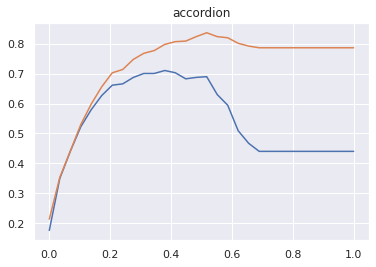

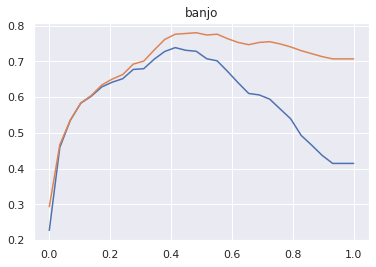

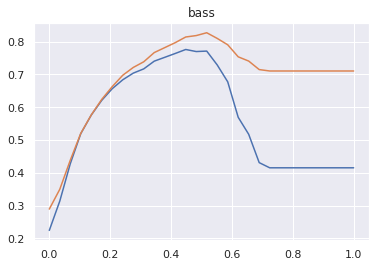

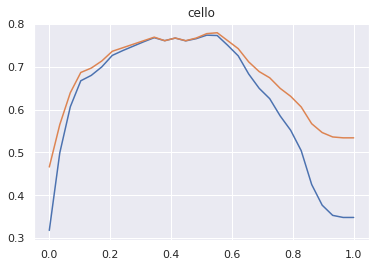

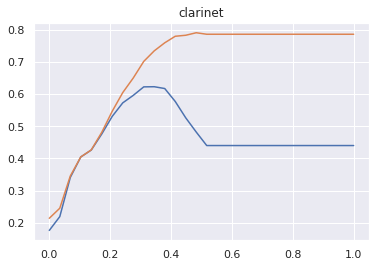

...

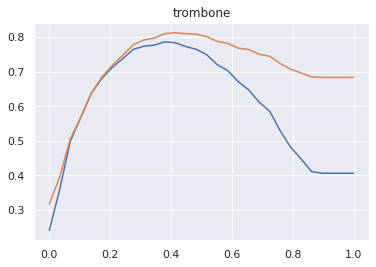

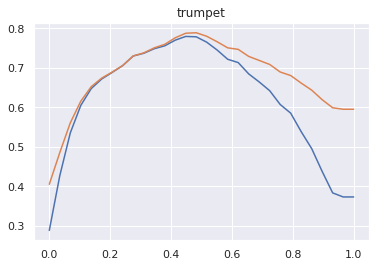

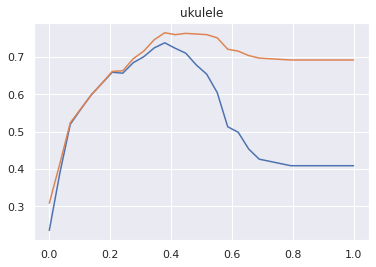

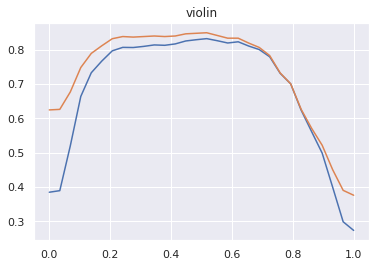

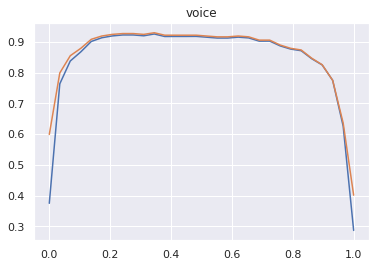

In [ ]:
from sklearn.metrics import f1_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import average_precision_score
AP_values = []
for x in range(20):

  keys = [k for k, v in class_map.items() if v == x]
  result = CNN_results[keys[0]]

  y_true = result["Y_true_test"] > 0.5
  print("AP ", average_precision_score(y_true, result["Y_pred_test"][0]).round(3), keys[0])
  AP_values.append(average_precision_score(y_true, result["Y_pred_test"][0]).round(3))
  f1_values = []
  acc_values = []
  threshold = np.linspace(0,1,30)
  for threshold_ in threshold:
    y_pred = result["Y_pred_test"][0] > threshold_
    f1_values.append(f1_score(y_true, y_pred, average='macro', zero_division=1))
    acc_values.append(accuracy_score(y_true, y_pred))
  #print("F1 values: ", f1_values)
  #print("Accuracy: ", acc_values)
  #print()

  plt.figure()
  plt.plot(threshold,f1_values)
  plt.plot(threshold,acc_values)
  plt.title(keys[0])

  print("Optimal Accuracy:",np.max(acc_values).round(3), " with threshold ", threshold[acc_values.index(np.max(acc_values))].round(2), " ", keys[0])
  print("Optimal F1:",np.max(f1_values).round(3), " with threshold ", threshold[f1_values.index(np.max(f1_values))].round(2), " ", keys[0])
  print()
print("mAP ", np.mean(AP_values))

Model: "sequential_6"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_18 (Dense)            (None, 128)               16512     
                                                                 
 dropout_12 (Dropout)        (None, 128)               0         
                                                                 
 dense_19 (Dense)            (None, 32)                4128      
                                                                 
 dropout_13 (Dropout)        (None, 32)                0         
                                                                 
 dense_20 (Dense)            (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
48/48 [==============================] - 0s 1ms/st

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


 dropout_55 (Dropout)        (None, 32)                0         
                                                                 
 dense_83 (Dense)            (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
55/55 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.777  with threshold  0.43
20/20 [==============================] - 0s 1ms/step
Accuracy (TEST): 0.792  with threshold  0.42   clarinet
Model: "sequential_28"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_84 (Dense)            (None, 128)               16512     
                                                                 
 dropout_56 (Dropout)        (None, 128)               0         
                                 

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


 dropout_57 (Dropout)        (None, 32)                0         
                                                                 
 dense_86 (Dense)            (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
55/55 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.778  with threshold  0.41
20/20 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.786  with threshold  0.41   clarinet
Model: "sequential_29"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_87 (Dense)            (None, 128)               16512     
                                                                 
 dropout_58 (Dropout)        (None, 128)               0         
                                 

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


55/55 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.774  with threshold  0.41
20/20 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.791  with threshold  0.41   clarinet
Model: "sequential_30"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_90 (Dense)            (None, 128)               16512     
                                                                 
 dropout_60 (Dropout)        (None, 128)               0         
                                                                 
 dense_91 (Dense)            (None, 32)                4128      
                                                                 
 dropout_61 (Dropout)        (None, 32)                0         


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


                                                                 
 dense_92 (Dense)            (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
55/55 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.781  with threshold  0.45
20/20 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.8  with threshold  0.42   clarinet


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Model: "sequential_31"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_93 (Dense)            (None, 128)               16512     
                                                                 
 dropout_62 (Dropout)        (None, 128)               0         
                                                                 
 dense_94 (Dense)            (None, 32)                4128      
                                                                 
 dropout_63 (Dropout)        (None, 32)                0         
                                                                 
 dense_95 (Dense)            (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
41/41 [==============================] - 0s 2ms/s

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


41/41 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.922  with threshold  0.47
14/14 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.938  with threshold  0.45   cymbals
Model: "sequential_33"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_99 (Dense)            (None, 128)               16512     
                                                                 
 dropout_66 (Dropout)        (None, 128)               0         
                                                                 
 dense_100 (Dense)           (None, 32)                4128      
                                                                 
 dropout_67 (Dropout)        (None, 32)                0         
                                                                 
 dense_101 (Dense)           (None, 1)                 33        
                                      

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


41/41 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.922  with threshold  0.39
14/14 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.936  with threshold  0.43   cymbals
Model: "sequential_34"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_102 (Dense)           (None, 128)               16512     
                                                                 
 dropout_68 (Dropout)        (None, 128)               0         
                                                                 
 dense_103 (Dense)           (None, 32)                4128      
                                                                 
 dropout_69 (Dropout)        (None, 32)                0         
                                                                 
 dense_104 (Dense)           (None, 1)                 33        
                                      

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


41/41 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.925  with threshold  0.43
14/14 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.936  with threshold  0.43   cymbals
Model: "sequential_35"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_105 (Dense)           (None, 128)               16512     
                                                                 
 dropout_70 (Dropout)        (None, 128)               0         
                                                                 
 dense_106 (Dense)           (None, 32)                4128      
                                                                 
 dropout_71 (Dropout)        (None, 32)                0         
                                                                 
 dense_107 (Dense)           (None, 1)                 33        
                                      

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


41/41 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.921  with threshold  0.39
14/14 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.94  with threshold  0.42   cymbals


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Model: "sequential_36"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_108 (Dense)           (None, 128)               16512     
                                                                 
 dropout_72 (Dropout)        (None, 128)               0         
                                                                 
 dense_109 (Dense)           (None, 32)                4128      
                                                                 
 dropout_73 (Dropout)        (None, 32)                0         
                                                                 
 dense_110 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
42/42 [==============================] - 0s 2ms/s

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


42/42 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.947  with threshold  0.39
14/14 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.908  with threshold  0.38   drums
Model: "sequential_38"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_114 (Dense)           (None, 128)               16512     
                                                                 
 dropout_76 (Dropout)        (None, 128)               0         


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


                                                                 
 dense_115 (Dense)           (None, 32)                4128      
                                                                 
 dropout_77 (Dropout)        (None, 32)                0         
                                                                 
 dense_116 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
42/42 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.945  with threshold  0.37
14/14 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.91  with threshold  0.37   drums
Model: "sequential_39"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_117 (Dense)           (None, 1

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


 dropout_79 (Dropout)        (None, 32)                0         
                                                                 
 dense_119 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
42/42 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.945  with threshold  0.33
14/14 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.908  with threshold  0.36   drums
Model: "sequential_40"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_120 (Dense)           (None, 128)               16512     
                                                                 
 dropout_80 (Dropout)        (None, 128)               0         
                                    

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
42/42 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.944  with threshold  0.41
14/14 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.91  with threshold  0.37   drums


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Model: "sequential_41"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_123 (Dense)           (None, 128)               16512     
                                                                 
 dropout_82 (Dropout)        (None, 128)               0         
                                                                 
 dense_124 (Dense)           (None, 32)                4128      
                                                                 
 dropout_83 (Dropout)        (None, 32)                0         
                                                                 
 dense_125 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
48/48 [==============================] - 0s 2ms/s

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_126 (Dense)           (None, 128)               16512     
                                                                 
 dropout_84 (Dropout)        (None, 128)               0         
                                                                 
 dense_127 (Dense)           (None, 32)                4128      
                                                                 
 dropout_85 (Dropout)        (None, 32)                0         
                                                                 
 dense_128 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
48/48 [==============================] - 0s 2ms/step
Optimal Train Accur

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Model: "sequential_43"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_129 (Dense)           (None, 128)               16512     
                                                                 
 dropout_86 (Dropout)        (None, 128)               0         
                                                                 
 dense_130 (Dense)           (None, 32)                4128      
                                                                 
 dropout_87 (Dropout)        (None, 32)                0         
                                                                 
 dense_131 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
48/48 [==============================] - 0s 2ms/s

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
48/48 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.742  with threshold  0.49
18/18 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.726  with threshold  0.51   flute
Model: "sequential_45"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_135 (Dense)           (None, 128)               16512     
                                                                 
 dropout_90 (Dropout)        (None, 128)               0         
                                                                 
 dense_136 (Dense)           (None, 32)                4128      
                                                                 


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


 dropout_91 (Dropout)        (None, 32)                0         
                                                                 
 dense_137 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
48/48 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.751  with threshold  0.53
18/18 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.74  with threshold  0.51   flute
Model: "sequential_46"


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_138 (Dense)           (None, 128)               16512     
                                                                 
 dropout_92 (Dropout)        (None, 128)               0         
                                                                 
 dense_139 (Dense)           (None, 32)                4128      
                                                                 
 dropout_93 (Dropout)        (None, 32)                0         
                                                                 
 dense_140 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
38/38 [==============================] - 0s 1ms/step
Optimal Train Accur

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


38/38 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.958  with threshold  0.37
14/14 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.963  with threshold  0.4   guitar
Model: "sequential_48"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_144 (Dense)           (None, 128)               16512     
                                                                 
 dropout_96 (Dropout)        (None, 128)               0         
                                                                 
 dense_145 (Dense)           (None, 32)                4128      
                                                                 
 dropout_97 (Dropout)        (None, 32)                0         


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


                                                                 
 dense_146 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
38/38 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.958  with threshold  0.47
14/14 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.961  with threshold  0.42   guitar
Model: "sequential_49"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_147 (Dense)           (None, 128)               16512     


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


                                                                 
 dropout_98 (Dropout)        (None, 128)               0         
                                                                 
 dense_148 (Dense)           (None, 32)                4128      
                                                                 
 dropout_99 (Dropout)        (None, 32)                0         
                                                                 
 dense_149 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
38/38 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.959  with threshold  0.43
14/14 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.956  with threshold  0.42   guitar
Model: "sequential_50"
___________________________________

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


38/38 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.96  with threshold  0.41
14/14 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.959  with threshold  0.42   guitar


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Model: "sequential_51"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_153 (Dense)           (None, 128)               16512     
                                                                 
 dropout_102 (Dropout)       (None, 128)               0         
                                                                 
 dense_154 (Dense)           (None, 32)                4128      
                                                                 
 dropout_103 (Dropout)       (None, 32)                0         
                                                                 
 dense_155 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
42/42 [==============================] - 0s 2ms/s

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


42/42 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.823  with threshold  0.55
15/15 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.772  with threshold  0.56   mallet_percussion
Model: "sequential_53"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_159 (Dense)           (None, 128)               16512     
                                                                 
 dropout_106 (Dropout)       (None, 128)               0         
                                                                 
 dense_160 (Dense)           (None, 32)                4128      
                                                                 
 dropout_107 (Dropout)       (None, 32)                0         
                                                                 
 dense_161 (Dense)           (None, 1)                 33        
                            

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


42/42 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.821  with threshold  0.61
15/15 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.782  with threshold  0.58   mallet_percussion
Model: "sequential_54"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_162 (Dense)           (None, 128)               16512     
                                                                 
 dropout_108 (Dropout)       (None, 128)               0         
                                                                 
 dense_163 (Dense)           (None, 32)                4128      
                                                                 
 dropout_109 (Dropout)       (None, 32)                0         
                                                                 


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


 dense_164 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
42/42 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.822  with threshold  0.55
15/15 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.78  with threshold  0.57   mallet_percussion
Model: "sequential_55"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_165 (Dense)           (None, 128)               16512     
                                                                 
 dropout_110 (Dropout)       (None, 128)               0         
                                                                 
 dense_166 (Dense)           (None, 32)                4128      


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


                                                                 
 dropout_111 (Dropout)       (None, 32)                0         
                                                                 
 dense_167 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
42/42 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.822  with threshold  0.57
15/15 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.78  with threshold  0.57   mallet_percussion


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Model: "sequential_56"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_168 (Dense)           (None, 128)               16512     
                                                                 
 dropout_112 (Dropout)       (None, 128)               0         
                                                                 
 dense_169 (Dense)           (None, 32)                4128      
                                                                 
 dropout_113 (Dropout)       (None, 32)                0         
                                                                 
 dense_170 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
58/58 [==============================] - 0s 1ms/s

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Non-trainable params: 0
_________________________________________________________________
58/58 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.774  with threshold  0.55
20/20 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.754  with threshold  0.54   mandolin
Model: "sequential_58"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_174 (Dense)           (None, 128)               16512     
                                                                 
 dropout_116 (Dropout)       (None, 128)               0         


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


                                                                 
 dense_175 (Dense)           (None, 32)                4128      
                                                                 
 dropout_117 (Dropout)       (None, 32)                0         
                                                                 
 dense_176 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
58/58 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.771  with threshold  0.57
20/20 [==============================] - 0s 1ms/step
Accuracy (TEST): 0.75  with threshold  0.55   mandolin
Model: "sequential_59"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_177 (Dense)           (None

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


58/58 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.769  with threshold  0.57
20/20 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.753  with threshold  0.56   mandolin
Model: "sequential_60"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_180 (Dense)           (None, 128)               16512     
                                                                 
 dropout_120 (Dropout)       (None, 128)               0         
                                                                 
 dense_181 (Dense)           (None, 32)                4128      
                                                                 
 dropout_121 (Dropout)       (None, 32)                0         
                                                                 
 dense_182 (Dense)           (None, 1)                 33        
                                     

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


58/58 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.771  with threshold  0.53
20/20 [==============================] - 0s 1ms/step
Accuracy (TEST): 0.75  with threshold  0.55   mandolin


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Model: "sequential_61"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_183 (Dense)           (None, 128)               16512     
                                                                 
 dropout_122 (Dropout)       (None, 128)               0         
                                                                 
 dense_184 (Dense)           (None, 32)                4128      
                                                                 
 dropout_123 (Dropout)       (None, 32)                0         
                                                                 
 dense_185 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
46/46 [==============================] - 0s 2ms/s

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


 dropout_125 (Dropout)       (None, 32)                0         
                                                                 
 dense_188 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
46/46 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.838  with threshold  0.45
14/14 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.766  with threshold  0.49   organ
Model: "sequential_63"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_189 (Dense)           (None, 128)               16512     
                                                                 
 dropout_126 (Dropout)       (None, 128)               0         


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


                                                                 
 dense_190 (Dense)           (None, 32)                4128      
                                                                 
 dropout_127 (Dropout)       (None, 32)                0         
                                                                 
 dense_191 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
46/46 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.841  with threshold  0.55
14/14 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.768  with threshold  0.51   organ
Model: "sequential_64"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_192 (Dense)           (None, 

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
46/46 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.84  with threshold  0.55
14/14 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.766  with threshold  0.52   organ
Model: "sequential_65"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_195 (Dense)           (None, 128)               16512     
                                                                 
 dropout_130 (Dropout)       (None, 128)               0         
                                                                 
 dense_196 (Dense)           (None, 32)                4128      
                                                                 
 dropout_131 (Dropout)       (None, 3

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


46/46 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.837  with threshold  0.51
14/14 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.759  with threshold  0.52   organ
Model: "sequential_66"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_198 (Dense)           (None, 128)               16512     
                                                                 
 dropout_132 (Dropout)       (None, 128)               0         
                                                                 
 dense_199 (Dense)           (None, 32)                4128      
                                                                 
 dropout_133 (Dropout)       (None, 32)                0         
                                                                 
 dense_200 (Dense)           (None, 1)                 33        
                                        

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


41/41 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.969  with threshold  0.33
13/13 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.949  with threshold  0.33   piano
Model: "sequential_67"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_201 (Dense)           (None, 128)               16512     
                                                                 
 dropout_134 (Dropout)       (None, 128)               0         
                                                                 
 dense_202 (Dense)           (None, 32)                4128      
                                                                 
 dropout_135 (Dropout)       (None, 32)                0         
                                                                 
 dense_203 (Dense)           (None, 1)                 33        
                                        

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


41/41 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.969  with threshold  0.27
13/13 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.945  with threshold  0.3   piano
Model: "sequential_68"


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_204 (Dense)           (None, 128)               16512     
                                                                 
 dropout_136 (Dropout)       (None, 128)               0         
                                                                 
 dense_205 (Dense)           (None, 32)                4128      
                                                                 
 dropout_137 (Dropout)       (None, 32)                0         
                                                                 
 dense_206 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
41/41 [==============================] - 0s 2ms/step
Optimal Train Accur

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


 Layer (type)                Output Shape              Param #   
 dense_207 (Dense)           (None, 128)               16512     
                                                                 
 dropout_138 (Dropout)       (None, 128)               0         
                                                                 
 dense_208 (Dense)           (None, 32)                4128      
                                                                 
 dropout_139 (Dropout)       (None, 32)                0         
                                                                 
 dense_209 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
41/41 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.97  with threshold  0.33
13/13 [===========================

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


41/41 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.97  with threshold  0.35
13/13 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.942  with threshold  0.33   piano


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Model: "sequential_71"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_213 (Dense)           (None, 128)               16512     
                                                                 
 dropout_142 (Dropout)       (None, 128)               0         
                                                                 
 dense_214 (Dense)           (None, 32)                4128      
                                                                 
 dropout_143 (Dropout)       (None, 32)                0         
                                                                 
 dense_215 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
55/55 [==============================] - 0s 1ms/s

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


 dense_217 (Dense)           (None, 32)                4128      
                                                                 
 dropout_145 (Dropout)       (None, 32)                0         
                                                                 
 dense_218 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
55/55 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.786  with threshold  0.47
20/20 [==============================] - 0s 1ms/step
Accuracy (TEST): 0.809  with threshold  0.49   saxophone


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Model: "sequential_73"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_219 (Dense)           (None, 128)               16512     
                                                                 
 dropout_146 (Dropout)       (None, 128)               0         
                                                                 
 dense_220 (Dense)           (None, 32)                4128      
                                                                 
 dropout_147 (Dropout)       (None, 32)                0         
                                                                 
 dense_221 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
55/55 [==============================] - 0s 1ms/s

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


                                                                 
 dense_223 (Dense)           (None, 32)                4128      
                                                                 
 dropout_149 (Dropout)       (None, 32)                0         
                                                                 
 dense_224 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
55/55 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.782  with threshold  0.51
20/20 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.816  with threshold  0.51   saxophone
Model: "sequential_75"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


 dense_225 (Dense)           (None, 128)               16512     
                                                                 
 dropout_150 (Dropout)       (None, 128)               0         
                                                                 
 dense_226 (Dense)           (None, 32)                4128      
                                                                 
 dropout_151 (Dropout)       (None, 32)                0         
                                                                 
 dense_227 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
55/55 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.777  with threshold  0.45
20/20 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.811  with threshold  0.5   

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_228 (Dense)           (None, 128)               16512     
                                                                 
 dropout_152 (Dropout)       (None, 128)               0         
                                                                 
 dense_229 (Dense)           (None, 32)                4128      
                                                                 
 dropout_153 (Dropout)       (None, 32)                0         
                                                                 
 dense_230 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
39/39 [==============================] - 0s 2ms/step
Optimal Train Accur

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


39/39 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.953  with threshold  0.45
12/12 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.958  with threshold  0.49   synthesizer
Model: "sequential_78"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_234 (Dense)           (None, 128)               16512     
                                                                 


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


 dropout_156 (Dropout)       (None, 128)               0         
                                                                 
 dense_235 (Dense)           (None, 32)                4128      
                                                                 
 dropout_157 (Dropout)       (None, 32)                0         
                                                                 
 dense_236 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
39/39 [==============================] - 1s 2ms/step
Optimal Train Accuracy: 0.953  with threshold  0.41
12/12 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.955  with threshold  0.46   synthesizer
Model: "sequential_79"
_________________________________________________________________
 Layer (type)                O

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


39/39 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.953  with threshold  0.51
12/12 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.953  with threshold  0.47   synthesizer
Model: "sequential_80"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_240 (Dense)           (None, 128)               16512     
                                                                 
 dropout_160 (Dropout)       (None, 128)               0         
                                                                 
 dense_241 (Dense)           (None, 32)                4128      
                                                                 
 dropout_161 (Dropout)       (None, 32)                0         
                                                                 
 dense_242 (Dense)           (None, 1)                 33        
                                  

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
39/39 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.953  with threshold  0.53
12/12 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.958  with threshold  0.49   synthesizer


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Model: "sequential_81"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_243 (Dense)           (None, 128)               16512     
                                                                 
 dropout_162 (Dropout)       (None, 128)               0         
                                                                 
 dense_244 (Dense)           (None, 32)                4128      
                                                                 
 dropout_163 (Dropout)       (None, 32)                0         
                                                                 
 dense_245 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
64/64 [==============================] - 0s 2ms/s

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


 dense_246 (Dense)           (None, 128)               16512     
                                                                 
 dropout_164 (Dropout)       (None, 128)               0         
                                                                 
 dense_247 (Dense)           (None, 32)                4128      
                                                                 
 dropout_165 (Dropout)       (None, 32)                0         
                                                                 
 dense_248 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
64/64 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.812  with threshold  0.55
23/23 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.815  with threshold  0.53  

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


 Layer (type)                Output Shape              Param #   
 dense_249 (Dense)           (None, 128)               16512     
                                                                 
 dropout_166 (Dropout)       (None, 128)               0         
                                                                 
 dense_250 (Dense)           (None, 32)                4128      
                                                                 
 dropout_167 (Dropout)       (None, 32)                0         
                                                                 
 dense_251 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
64/64 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.813  with threshold  0.55
23/23 [==========================

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


 dropout_169 (Dropout)       (None, 32)                0         
                                                                 
 dense_254 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
64/64 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.813  with threshold  0.51
23/23 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.814  with threshold  0.53   trombone
Model: "sequential_85"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_255 (Dense)           (None, 128)               16512     
                                                                 
 dropout_170 (Dropout)       (None, 128)               0         
                                 

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
64/64 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.809  with threshold  0.47
23/23 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.803  with threshold  0.52   trombone
Model: "sequential_86"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_258 (Dense)           (None, 128)               16512     
                                                                 
 dropout_172 (Dropout)       (None, 128)               0         
                                                                 
 dense_259 (Dense)           (None, 32)                4128      
                                                                 
 dropout_173 (Dropout)       (None, 32)                0         


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


                                                                 
 dense_260 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
67/67 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.805  with threshold  0.57
25/25 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.792  with threshold  0.57   trumpet
Model: "sequential_87"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


 dense_261 (Dense)           (None, 128)               16512     
                                                                 
 dropout_174 (Dropout)       (None, 128)               0         
                                                                 
 dense_262 (Dense)           (None, 32)                4128      
                                                                 
 dropout_175 (Dropout)       (None, 32)                0         
                                                                 
 dense_263 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
67/67 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.802  with threshold  0.55
25/25 [==============================] - 0s 1ms/step
Accuracy (TEST): 0.791  with threshold  0.56  

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


 dense_266 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
67/67 [==============================] - 0s 3ms/step
Optimal Train Accuracy: 0.8  with threshold  0.53
25/25 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.781  with threshold  0.55   trumpet


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Model: "sequential_89"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_267 (Dense)           (None, 128)               16512     
                                                                 
 dropout_178 (Dropout)       (None, 128)               0         
                                                                 
 dense_268 (Dense)           (None, 32)                4128      
                                                                 
 dropout_179 (Dropout)       (None, 32)                0         
                                                                 
 dense_269 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
67/67 [==============================] - 0s 1ms/s

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Model: "sequential_90"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_270 (Dense)           (None, 128)               16512     
                                                                 
 dropout_180 (Dropout)       (None, 128)               0         
                                                                 
 dense_271 (Dense)           (None, 32)                4128      
                                                                 
 dropout_181 (Dropout)       (None, 32)                0         
                                                                 
 dense_272 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
67/67 [==============================] - 0s 1ms/s

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Model: "sequential_91"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_273 (Dense)           (None, 128)               16512     
                                                                 
 dropout_182 (Dropout)       (None, 128)               0         
                                                                 
 dense_274 (Dense)           (None, 32)                4128      
                                                                 
 dropout_183 (Dropout)       (None, 32)                0         
                                                                 
 dense_275 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
58/58 [==============================] - 0s 1ms/s

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


_________________________________________________________________
58/58 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.787  with threshold  0.47
19/19 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.776  with threshold  0.48   ukulele
Model: "sequential_93"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_279 (Dense)           (None, 128)               16512     


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


                                                                 
 dropout_186 (Dropout)       (None, 128)               0         
                                                                 
 dense_280 (Dense)           (None, 32)                4128      
                                                                 
 dropout_187 (Dropout)       (None, 32)                0         
                                                                 
 dense_281 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
58/58 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.788  with threshold  0.51
19/19 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.785  with threshold  0.49   ukulele
Model: "sequential_94"
__________________________________

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


 dropout_189 (Dropout)       (None, 32)                0         
                                                                 
 dense_284 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
58/58 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.789  with threshold  0.53
19/19 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.783  with threshold  0.5   ukulele
Model: "sequential_95"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_285 (Dense)           (None, 128)               16512     
                                                                 
 dropout_190 (Dropout)       (None, 128)               0         


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


                                                                 
 dense_286 (Dense)           (None, 32)                4128      
                                                                 
 dropout_191 (Dropout)       (None, 32)                0         
                                                                 
 dense_287 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
58/58 [==============================] - 0s 1ms/step
Optimal Train Accuracy: 0.789  with threshold  0.47
19/19 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.773  with threshold  0.49   ukulele
Model: "sequential_96"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_288 (Dense)           (None

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
44/44 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.83  with threshold  0.53
20/20 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.838  with threshold  0.53   violin
Model: "sequential_97"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_291 (Dense)           (None, 128)               16512     
                                                                 
 dropout_194 (Dropout)       (None, 128)               0         
                                                                 
 dense_292 (Dense)           (None, 32)                4128      
                                                                 
 dropout_195 (Dropout)       (None, 

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


44/44 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.83  with threshold  0.53
20/20 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.84  with threshold  0.53   violin
Model: "sequential_98"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_294 (Dense)           (None, 128)               16512     
                                                                 
 dropout_196 (Dropout)       (None, 128)               0         
                                                                 
 dense_295 (Dense)           (None, 32)                4128      
                                                                 
 dropout_197 (Dropout)       (None, 32)                0         
                                                                 
 dense_296 (Dense)           (None, 1)                 33        
                                         

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
44/44 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.833  with threshold  0.55
20/20 [==============================] - 0s 1ms/step
Accuracy (TEST): 0.838  with threshold  0.54   violin
Model: "sequential_99"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_297 (Dense)           (None, 128)               16512     
                                                                 
 dropout_198 (Dropout)       (None, 128)               0         
                                                                 
 dense_298 (Dense)           (None, 32)                4128      
                                                                 
 dropout_199 (Dropout)       (None, 32)                0         
                                                        

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


44/44 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.827  with threshold  0.51
20/20 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.84  with threshold  0.53   violin
Model: "sequential_100"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_300 (Dense)           (None, 128)               16512     
                                                                 
 dropout_200 (Dropout)       (None, 128)               0         
                                                                 
 dense_301 (Dense)           (None, 32)                4128      
                                                                 
 dropout_201 (Dropout)       (None, 32)                0         


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


                                                                 
 dense_302 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
44/44 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.831  with threshold  0.51
20/20 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.827  with threshold  0.53   violin
Model: "sequential_101"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_303 (Dense)           (None, 128)               16512     
                                                                 
 dropout_202 (Dropout)       (None, 128)               0         
                                                                 
 dense_304 (Dense)           (None

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


                                                                 
 dense_305 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
38/38 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.934  with threshold  0.53
12/12 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.917  with threshold  0.53   voice
Model: "sequential_102"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_306 (Dense)           (None, 128)               16512     
                                                                 
 dropout_204 (Dropout)       (None, 128)               0         
                                                                 
 dense_307 (Dense)           (None,

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


38/38 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.935  with threshold  0.51
12/12 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.917  with threshold  0.52   voice
Model: "sequential_103"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_309 (Dense)           (None, 128)               16512     
                                                                 
 dropout_206 (Dropout)       (None, 128)               0         
                                                                 
 dense_310 (Dense)           (None, 32)                4128      
                                                                 
 dropout_207 (Dropout)       (None, 32)                0         
                                                                 
 dense_311 (Dense)           (None, 1)                 33        
                                       

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


38/38 [==============================] - 0s 2ms/step
Optimal Train Accuracy: 0.934  with threshold  0.39
12/12 [==============================] - 0s 2ms/step
Accuracy (TEST): 0.92  with threshold  0.48   voice
Model: "sequential_104"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


 dense_312 (Dense)           (None, 128)               16512     
                                                                 
 dropout_208 (Dropout)       (None, 128)               0         
                                                                 
 dense_313 (Dense)           (None, 32)                4128      
                                                                 
 dropout_209 (Dropout)       (None, 32)                0         
                                                                 
 dense_314 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________________________________________________________________
38/38 [==============================] - 1s 8ms/step
Optimal Train Accuracy: 0.934  with threshold  0.39


<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


12/12 [==============================] - 0s 7ms/step
Accuracy (TEST): 0.92  with threshold  0.45   voice
Model: "sequential_105"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_315 (Dense)           (None, 128)               16512     
                                                                 
 dropout_210 (Dropout)       (None, 128)               0         
                                                                 
 dense_316 (Dense)           (None, 32)                4128      
                                                                 
 dropout_211 (Dropout)       (None, 32)                0         
                                                                 
 dense_317 (Dense)           (None, 1)                 33        
                                                                 
Total params: 20,673
Trainable params: 20,673
Non-trainable params: 0
_________

<ipython-input-45-b291ab8d7a0c>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure()


12/12 [==============================] - 0s 3ms/step
Accuracy (TEST): 0.925  with threshold  0.44   voice


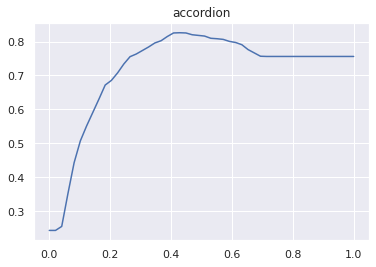

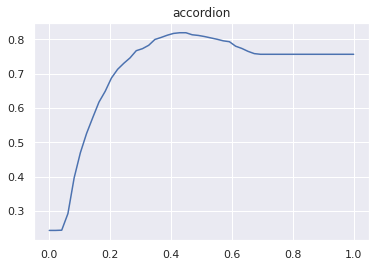

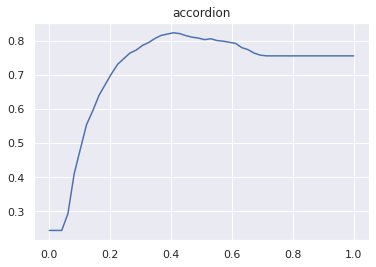

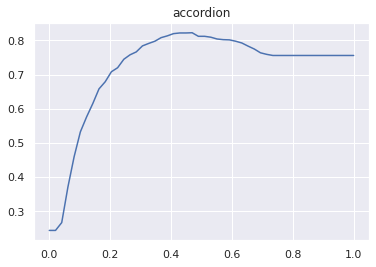

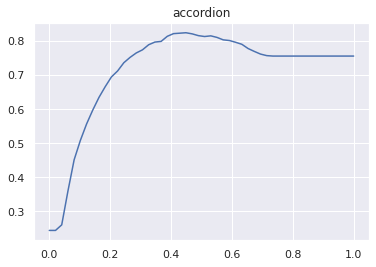

...

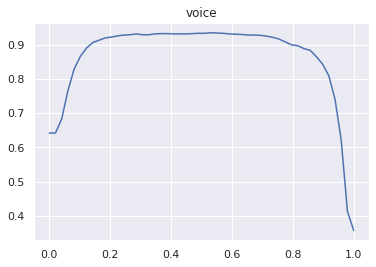

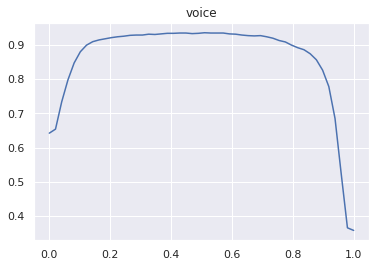

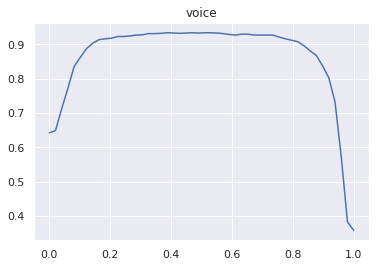

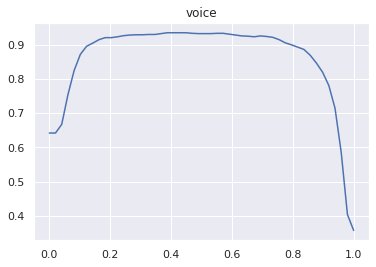

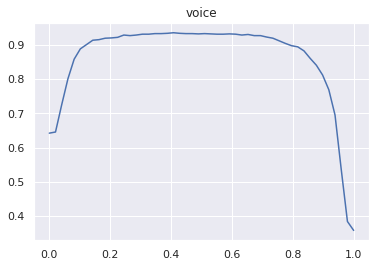

In [ ]:
## REGRESSION with optimal thresholding
from tensorflow import keras
#import tf.keras.Sequential
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.models import Model
from keras.optimizers import gradient_descent_v2
#from keras.optimizers import SGD
#from tensorflow.keras.optimizers import SGD
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import average_precision_score
%matplotlib inline

# This dictionary will include the classifiers for each model
models = dict()
histories = dict()
#regression_results = dict()
regression_results = dict()
#regression_results_balanced_oversampling = dict()

# We repeat the training/test several times to get well-rounded results
n_realizations = 5

# We'll iterate over all istrument classes, and fit a model for each one
# After training, we'll print a classification report for each instrument
for instrument in class_map:
    
    # A list where we are going to store results of that instrument
    instrument_result_list = []
    
    # A list where we are going to store the threshold that maximizes accuracy for that instrument
    optimal_threshold_list = []

    # Map the instrument name to its column number
    inst_num = class_map[instrument]
    #if inst_num != 0:
    #  continue
    # Several train/test realizations
    for n_realizations_ in range(0,n_realizations):

      # Step 1: sub-sample the data
      
      # First, we need to select down to the data for which we have annotations
      # This is what the mask arrays are for
      train_inst = Y_mask_train[:, inst_num]
      test_inst = Y_mask_test[:, inst_num]
      
      # Here, we're using the Y_mask_train array to slice out only the training examples
      # for which we have annotations for the given class
      X_train_inst = X_train[train_inst]
      
      # Step 3: simplify the data by averaging over time  XXXXXXX1
      
      # Instead of having time-varying features, we'll summarize each track by its mean feature vector over time
      X_train_inst_sklearn = np.mean(X_train_inst, axis=1)
      
      # Again, we slice the labels to the annotated examples XXXXXXX2
      # We thresold the label likelihoods at 0.5 to get binary labels
      #Y_true_train_inst = Y_true_train[train_inst, inst_num] >= 0.5
      Y_true_train_inst = Y_true_train[train_inst, inst_num] 
      
      # Repeat the above slicing and dicing but for the test set XXXXXXX2
      X_test_inst = X_test[test_inst]
      X_test_inst_sklearn = np.mean(X_test_inst, axis=1)
      #Y_true_test_inst = Y_true_test[test_inst, inst_num] >= 0.5
      Y_true_test_inst = Y_true_test[test_inst, inst_num]

      """
      #balanced_indices = get_balanced_indeces_undersample(Y_true_train_inst)
      balanced_indices = get_balanced_indeces_oversample(Y_true_train_inst)
      
      # Downsample most common class
      Y_true_train_inst = Y_true_train_inst[balanced_indices] 
      X_train_inst = X_train_inst[balanced_indices] 
      """

      # Step 3.
      # Initialize a new classifier
      model = Sequential()
      model.add(Dense(128, activation='relu', input_dim=X_train_inst_sklearn.shape[1]))
      model.add(Dropout(0.3))
      model.add(Dense(32, activation='relu'))
      model.add(Dropout(0.3))
      model.add(Dense(1, activation='sigmoid'))
      model.summary()

      ### Normalize input data for the Feed Forward Network
      X_train_inst_sklearn_norm = preprocessing.normalize(X_train_inst_sklearn)
      X_test_inst_sklearn_norm = preprocessing.normalize(X_test_inst_sklearn)

      #print1(X_train_inst_sklearn_norm,Y_true_train_inst,X_test_inst_sklearn,Y_true_test_inst,X_test_inst_sklearn_norm)

      sgd = gradient_descent_v2.SGD(learning_rate=0.01, decay=1e-6, momentum=0.9, nesterov=True)

      model.compile(loss='mse',
                    optimizer=sgd,
                    metrics=['mse'])
      
      # Step 4.
      history = model.fit(X_train_inst_sklearn_norm, Y_true_train_inst,
          epochs=200,
          batch_size=128,
          #validation_data=(X_test_inst_sklearn_norm, Y_true_test_inst),
          verbose=0)


      # Step 5.
      # Finally, we'll evaluate the model on both train and test
      Y_pred_train = model.predict(X_train_inst_sklearn_norm)

      # Compute the optimal threshold for the training data
      threshold = compute_optimal_accuracy_threshold(Y_true_train_inst, Y_pred_train, instrument)
      optimal_threshold_list.append(threshold)

      # For the testing data we are going to use the threshold mean over all previous training experiments.
      Y_pred_test = model.predict(X_test_inst_sklearn_norm)
      y_true_ = Y_true_test_inst > 0.5
      threshold = np.mean(optimal_threshold_list)
      y_pred_ = Y_pred_test > threshold
      print("Accuracy (TEST):",accuracy_score(y_true_, y_pred_).round(3), " with threshold ", threshold.round(2), " ", instrument)


      #print("Y_pred_test = ", Y_pred_test)
      #Y_pred_test_norm = preprocessing.normalize(Y_pred_test)
      
      #print2(instrument,Y_true_train_inst,Y_pred_train,Y_true_test_inst,Y_pred_test)

      # Store the classifier in our dictionary
      models[instrument] = model
      histories[instrument] = history
      results = dict()
      results["Y_true_train"] = Y_true_train_inst
      results["Y_pred_train"] = (Y_pred_train).T
      results["Y_true_test"] = Y_true_test_inst
      results["Y_pred_test"] = (Y_pred_test).T
      # Store test accuracy with format [ Accuracy, threshold_accuracy ]
      results["Accuracy"] = [accuracy_score(y_true_, y_pred_).round(3), threshold.round(2)]
      # Store test f1 with format [ F1, threshold_accuracy ]
      results["F1"] = [f1_score(y_true_, y_pred_, zero_division=1).round(3), threshold.round(2)]
      results["AP"] = average_precision_score(y_true_, y_pred_).round(3)
      instrument_result_list.append(results)
      if n_realizations_ == n_realizations-1:
        regression_results[instrument] = instrument_result_list


Regression using:



*   Features: Average VGG vector over the 10 seconds clip
*   Training: Original label probabilities [0,1]
*   Optimization Metric: MSE







In [ ]:
## REGRESSION
from tensorflow import keras
#import tf.keras.Sequential
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.models import Model
from keras.optimizers import gradient_descent_v2
#from keras.optimizers import SGD
#from tensorflow.keras.optimizers import SGD
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

# This dictionary will include the classifiers for each model
models = dict()
histories = dict()
regression_results = dict()


# We'll iterate over all istrument classes, and fit a model for each one
# After training, we'll print a classification report for each instrument
for instrument in class_map:
    
    # Map the instrument name to its column number
    inst_num = class_map[instrument]
        
    # Step 1: sub-sample the data
    
    # First, we need to select down to the data for which we have annotations
    # This is what the mask arrays are for
    train_inst = Y_mask_train[:, inst_num]
    test_inst = Y_mask_test[:, inst_num]
    
    # Here, we're using the Y_mask_train array to slice out only the training examples
    # for which we have annotations for the given class
    X_train_inst = X_train[train_inst]
    
    # Step 3: simplify the data by averaging over time  XXXXXXX1
    
    # Instead of having time-varying features, we'll summarize each track by its mean feature vector over time
    X_train_inst_sklearn = np.mean(X_train_inst, axis=1)
    
    # Again, we slice the labels to the annotated examples XXXXXXX2
    # We thresold the label likelihoods at 0.5 to get binary labels
    #Y_true_train_inst = Y_true_train[train_inst, inst_num] >= 0.5
    Y_true_train_inst = Y_true_train[train_inst, inst_num] 
    
    # Repeat the above slicing and dicing but for the test set XXXXXXX2
    X_test_inst = X_test[test_inst]
    X_test_inst_sklearn = np.mean(X_test_inst, axis=1)
    #Y_true_test_inst = Y_true_test[test_inst, inst_num] >= 0.5
    Y_true_test_inst = Y_true_test[test_inst, inst_num]

    """
    #balanced_indices = get_balanced_indeces_undersample(Y_true_train_inst)
    balanced_indices = get_balanced_indeces_oversample(Y_true_train_inst)
    
    # Downsample most common class
    Y_true_train_inst = Y_true_train_inst[balanced_indices] 
    X_train_inst = X_train_inst[balanced_indices] 
    """

    # Step 3.
    # Initialize a new classifier
    model = Sequential()
    model.add(Dense(128, activation='relu', input_dim=X_train_inst_sklearn.shape[1]))
    model.add(Dropout(0.5))
    model.add(Dense(32, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1, activation='sigmoid'))
    model.summary()

    ### Normalize input data for the Feed Forward Network
    X_train_inst_sklearn_norm = preprocessing.normalize(X_train_inst_sklearn)
    X_test_inst_sklearn_norm = preprocessing.normalize(X_test_inst_sklearn)

    #print1(X_train_inst_sklearn_norm,Y_true_train_inst,X_test_inst_sklearn,Y_true_test_inst,X_test_inst_sklearn_norm)

    sgd = gradient_descent_v2.SGD(learning_rate=0.01, decay=1e-6, momentum=0.9, nesterov=True)

    model.compile(loss='mse',
                  optimizer=sgd,
                  metrics=['mse'])
    
    # Step 4.
    history = model.fit(X_train_inst_sklearn_norm, Y_true_train_inst,
         epochs=200,
         batch_size=128,
         validation_data=(X_test_inst_sklearn_norm, Y_true_test_inst),
         verbose=1)


    # Step 5.
    # Finally, we'll evaluate the model on both train and test
    Y_pred_train = model.predict(X_train_inst_sklearn_norm)
    Y_pred_test = model.predict(X_test_inst_sklearn_norm)

    #Y_pred_test_norm = preprocessing.normalize(Y_pred_test)
    
    print2(instrument,Y_true_train_inst,Y_pred_train,Y_true_test_inst,Y_pred_test)

    # Store the classifier in our dictionary
    models[instrument] = model
    histories[instrument] = history
    results = dict()
    results["Y_true_train"] = Y_true_train_inst
    results["Y_pred_train"] = (Y_pred_train).T
    results["Y_true_test"] = Y_true_test_inst
    results["Y_pred_test"] = (Y_pred_test).T
    regression_results[instrument] = results

Regression using:

*   Features: COMPLETE VGG vector over the 10 seconds clip
*   Training: Original label probabilities [0,1]
*   Optimization Metric: MSE


In [ ]:
## REGRESSION using all 10 seconds!
from tensorflow import keras
#import tf.keras.Sequential
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.models import Model
from keras.optimizers import gradient_descent_v2
#from keras.optimizers import SGD
#from tensorflow.keras.optimizers import SGD
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

# This dictionary will include the classifiers for each model
models = dict()
histories = dict()
regression_results_10s = dict()

# We'll iterate over all istrument classes, and fit a model for each one
# After training, we'll print a classification report for each instrument
for instrument in class_map:
    
    # Map the instrument name to its column number
    inst_num = class_map[instrument]
        
    # Step 1: sub-sample the data
    
    # First, we need to select down to the data for which we have annotations
    # This is what the mask arrays are for
    train_inst = Y_mask_train[:, inst_num]
    test_inst = Y_mask_test[:, inst_num]
    
    # Here, we're using the Y_mask_train array to slice out only the training examples
    # for which we have annotations for the given class
    X_train_inst = X_train[train_inst]
    
    # Step 3: simplify the data by averaging over time  XXXXXXX1
    
    # Instead of having time-varying features, we'll summarize each track by its mean feature vector over time
    # X_train_inst_sklearn = np.mean(X_train_inst, axis=1)
    # Reshape the 10*128 VGG features to a 1280 elements vector
    X_train_inst_sklearn = X_train_inst.reshape((X_train_inst.shape[0],X_train_inst.shape[1]*X_train_inst.shape[2]))
    
    
    # Again, we slice the labels to the annotated examples XXXXXXX2
    # We thresold the label likelihoods at 0.5 to get binary labels
    #Y_true_train_inst = Y_true_train[train_inst, inst_num] >= 0.5
    Y_true_train_inst = Y_true_train[train_inst, inst_num] 
    
    # Repeat the above slicing and dicing but for the test set XXXXXXX2
    X_test_inst = X_test[test_inst]
    #X_test_inst_sklearn = np.mean(X_test_inst, axis=1)
    X_test_inst_sklearn = X_test_inst.reshape((X_test_inst.shape[0],X_test_inst.shape[1]*X_test_inst.shape[2]))
    #Y_true_test_inst = Y_true_test[test_inst, inst_num] >= 0.5
    Y_true_test_inst = Y_true_test[test_inst, inst_num]

    print(X_train_inst.shape)
    print(X_train_inst_sklearn.shape)

    # Step 3.
    # Initialize a new classifier
    model = Sequential()
    model.add(Dense(1280, activation='relu', input_dim=X_train_inst_sklearn.shape[1]))
    model.add(Dropout(0.5))
    model.add(Dense(120, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(32, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1, activation='sigmoid'))
    model.summary()

    ### Normalize input data for the Feed Forward Network
    X_train_inst_sklearn_norm = preprocessing.normalize(X_train_inst_sklearn)
    X_test_inst_sklearn_norm = preprocessing.normalize(X_test_inst_sklearn)

    print(X_train_inst_sklearn_norm.shape)

    print1(X_train_inst_sklearn_norm,Y_true_train_inst,X_test_inst_sklearn,Y_true_test_inst,X_test_inst_sklearn_norm)

    sgd = gradient_descent_v2.SGD(learning_rate=0.05, decay=1e-6, momentum=0.9, nesterov=True)

    model.compile(loss='mse',
                  optimizer=sgd,
                  metrics=['mse'])
    
    # Step 4.
    history = model.fit(X_train_inst_sklearn_norm, Y_true_train_inst,
         epochs=60,
         batch_size=128,
         validation_data=(X_test_inst_sklearn_norm, Y_true_test_inst),
         verbose=1)


    # Step 5.
    # Finally, we'll evaluate the model on both train and test
    Y_pred_train = model.predict(X_train_inst_sklearn_norm)
    Y_pred_test = model.predict(X_test_inst_sklearn_norm)

    #Y_pred_test_norm = preprocessing.normalize(Y_pred_test)
    
    print2(instrument,Y_true_train_inst,Y_pred_train,Y_true_test_inst,Y_pred_test)

    import seaborn as sns
    import matplotlib.pyplot as plt

    sns.set(style="darkgrid")

    sns.histplot( x=(Y_pred_test).T[0], color="red", label="Prediction", kde=True )
    sns.histplot( x=Y_true_test_inst, color="skyblue", label="True", kde=True)

    plt.legend() 
    plt.show()

    # Store the classifier in our dictionary
    models[instrument] = model
    histories[instrument] = history
    results = dict()
    results["Y_true_train"] = Y_true_train_inst
    results["Y_pred_train"] = (Y_pred_train).T
    results["Y_true_test"] = Y_true_test_inst
    results["Y_pred_test"] = (Y_pred_test).T
    regression_results_10s[instrument] = results

Metric: MEAN ERROR (Not squared)
# accordion
Train Mean Error :  0.31
Test  Mean Error :  0.3

# banjo
Train Mean Error :  0.3
Test  Mean Error :  0.33

# bass
Train Mean Error :  0.32
Test  Mean Error :  0.32

# cello
Train Mean Error :  0.32
Test  Mean Error :  0.32

# clarinet
Train Mean Error :  0.32
Test  Mean Error :  0.31

# cymbals
Train Mean Error :  0.23
Test  Mean Error :  0.22

# drums
Train Mean Error :  0.18
Test  Mean Error :  0.23

# flute
Train Mean Error :  0.34
Test  Mean Error :  0.35

# guitar
Train Mean Error :  0.18
Test  Mean Error :  0.16

# mallet_percussion
Train Mean Error :  0.31
Test  Mean Error :  0.33

# mandolin
Train Mean Error :  0.32
Test  Mean Error :  0.32

# organ
Train Mean Error :  0.28
Test  Mean Error :  0.35

# piano
Train Mean Error :  0.15
Test  Mean Error :  0.21

# saxophone
Train Mean Error :  0.32
Test  Mean Error :  0.32

# synthesizer
Train Mean Error :  0.18
Test  Mean Error :  0.18

# trombone
Train Mean Error :  0.31
Test  Mean Err

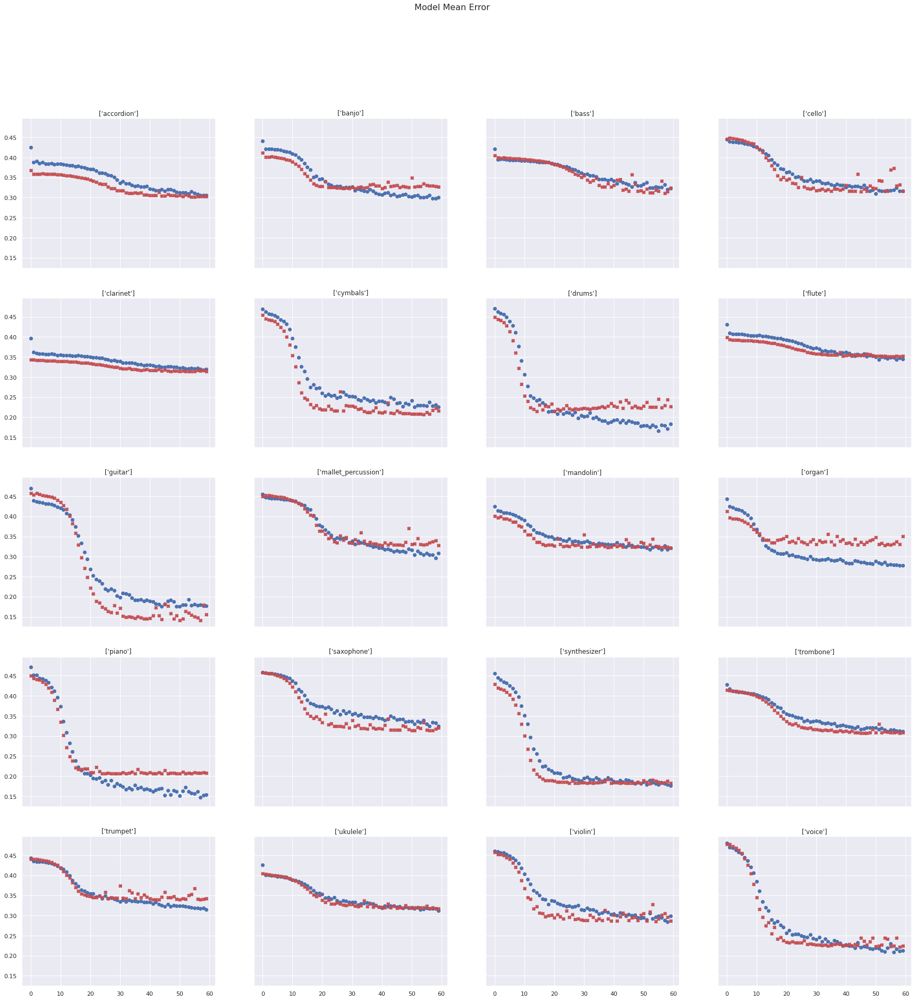

In [ ]:
plot_mean_error()

### **Classification**

#### Code

Epoch 1/200
12/12 [==============================] - 1s 24ms/step - loss: 0.6601 - accuracy: 0.7234 - val_loss: 0.6020 - val_accuracy: 0.7862
Epoch 2/200
12/12 [==============================] - 0s 8ms/step - loss: 0.5853 - accuracy: 0.7560 - val_loss: 0.5357 - val_accuracy: 0.7862
Epoch 3/200
12/12 [==============================] - 0s 7ms/step - loss: 0.5630 - accuracy: 0.7560 - val_loss: 0.5206 - val_accuracy: 0.7862
Epoch 4/200
12/12 [==============================] - 0s 7ms/step - loss: 0.5682 - accuracy: 0.7560 - val_loss: 0.5202 - val_accuracy: 0.7862
Epoch 5/200
12/12 [==============================] - 0s 15ms/step - loss: 0.5653 - accuracy: 0.7560 - val_loss: 0.5205 - val_accuracy: 0.7862
Epoch 6/200
12/12 [==============================] - 0s 11ms/step - loss: 0.5597 - accuracy: 0.7560 - val_loss: 0.5211 - val_accuracy: 0.7862
Epoch 7/200
12/12 [==============================] - 0s 8ms/step - loss: 0.5579 - accuracy: 0.7560 - val_loss: 0.5212 - val_accuracy: 0.7862
Epoch 8/20

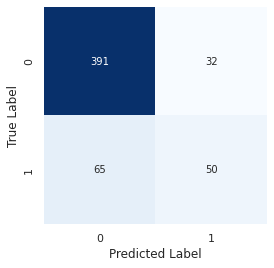


Ejemplo de predicciones:  accordion
True label:  [0 0 0 0 0 0 0 0 0 0]
Predicted:   [[0.09014605 0.31756452 0.00346557 0.00653565 0.0010938  0.35913044
  0.24063005 0.01982692 0.00212272 0.02264728]]
Epoch 1/200
12/12 [==============================] - 1s 24ms/step - loss: 0.6873 - accuracy: 0.5434 - val_loss: 0.6423 - val_accuracy: 0.7862
Epoch 2/200
12/12 [==============================] - 0s 9ms/step - loss: 0.6235 - accuracy: 0.7560 - val_loss: 0.5827 - val_accuracy: 0.7862
Epoch 3/200
12/12 [==============================] - 0s 8ms/step - loss: 0.5842 - accuracy: 0.7560 - val_loss: 0.5474 - val_accuracy: 0.7862
Epoch 4/200
12/12 [==============================] - 0s 9ms/step - loss: 0.5656 - accuracy: 0.7560 - val_loss: 0.5314 - val_accuracy: 0.7862
Epoch 5/200
12/12 [==============================] - 0s 9ms/step - loss: 0.5574 - accuracy: 0.7560 - val_loss: 0.5250 - val_accuracy: 0.7862
Epoch 6/200
12/12 [==============================] - 0s 8ms/step - loss: 0.5583 - accuracy: 0

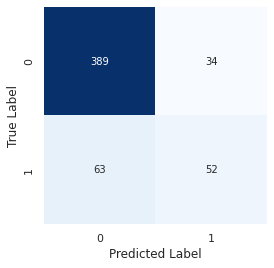


Ejemplo de predicciones:  accordion
True label:  [0 0 0 0 0 0 0 0 0 0]
Predicted:   [[0.13149707 0.39455473 0.01289605 0.01726926 0.00992549 0.30844012
  0.28714436 0.04030586 0.01169548 0.05023744]]
Epoch 1/200
12/12 [==============================] - 1s 17ms/step - loss: 0.6584 - accuracy: 0.7215 - val_loss: 0.6030 - val_accuracy: 0.7862
Epoch 2/200
12/12 [==============================] - 0s 6ms/step - loss: 0.5904 - accuracy: 0.7560 - val_loss: 0.5392 - val_accuracy: 0.7862
Epoch 3/200
12/12 [==============================] - 0s 6ms/step - loss: 0.5600 - accuracy: 0.7560 - val_loss: 0.5222 - val_accuracy: 0.7862
Epoch 4/200
12/12 [==============================] - 0s 7ms/step - loss: 0.5588 - accuracy: 0.7560 - val_loss: 0.5194 - val_accuracy: 0.7862
Epoch 5/200
12/12 [==============================] - 0s 6ms/step - loss: 0.5624 - accuracy: 0.7560 - val_loss: 0.5192 - val_accuracy: 0.7862
Epoch 6/200
12/12 [==============================] - 0s 7ms/step - loss: 0.5562 - accuracy: 0

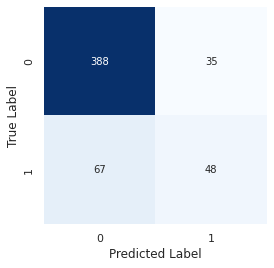


Ejemplo de predicciones:  accordion
True label:  [0 0 0 0 0 0 0 0 0 0]
Predicted:   [[0.15466298 0.4023466  0.00202278 0.00622202 0.0009084  0.3579904
  0.2685408  0.02773419 0.00165426 0.03028155]]
Epoch 1/200
12/12 [==============================] - 1s 17ms/step - loss: 0.6696 - accuracy: 0.7006 - val_loss: 0.6268 - val_accuracy: 0.7862
Epoch 2/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6081 - accuracy: 0.7560 - val_loss: 0.5569 - val_accuracy: 0.7862
Epoch 3/200
12/12 [==============================] - 0s 6ms/step - loss: 0.5729 - accuracy: 0.7560 - val_loss: 0.5302 - val_accuracy: 0.7862
Epoch 4/200
12/12 [==============================] - 0s 7ms/step - loss: 0.5589 - accuracy: 0.7560 - val_loss: 0.5226 - val_accuracy: 0.7862
Epoch 5/200
12/12 [==============================] - 0s 5ms/step - loss: 0.5606 - accuracy: 0.7560 - val_loss: 0.5211 - val_accuracy: 0.7862
Epoch 6/200
12/12 [==============================] - 0s 6ms/step - loss: 0.5644 - accuracy: 0.

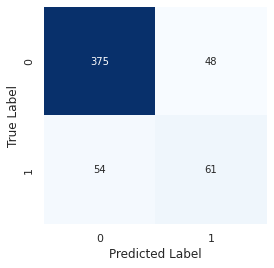


Ejemplo de predicciones:  accordion
True label:  [0 0 0 0 0 0 0 0 0 0]
Predicted:   [[0.14436339 0.45514163 0.00787431 0.01177253 0.003378   0.40008166
  0.35106692 0.03898884 0.00466188 0.04382353]]
Epoch 1/200
12/12 [==============================] - 1s 17ms/step - loss: 0.6598 - accuracy: 0.7032 - val_loss: 0.6064 - val_accuracy: 0.7862
Epoch 2/200
12/12 [==============================] - 0s 7ms/step - loss: 0.5880 - accuracy: 0.7560 - val_loss: 0.5420 - val_accuracy: 0.7862
Epoch 3/200
12/12 [==============================] - 0s 5ms/step - loss: 0.5678 - accuracy: 0.7560 - val_loss: 0.5227 - val_accuracy: 0.7862
Epoch 4/200
12/12 [==============================] - 0s 6ms/step - loss: 0.5540 - accuracy: 0.7560 - val_loss: 0.5197 - val_accuracy: 0.7862
Epoch 5/200
12/12 [==============================] - 0s 5ms/step - loss: 0.5584 - accuracy: 0.7560 - val_loss: 0.5201 - val_accuracy: 0.7862
Epoch 6/200
12/12 [==============================] - 0s 6ms/step - loss: 0.5545 - accuracy: 0

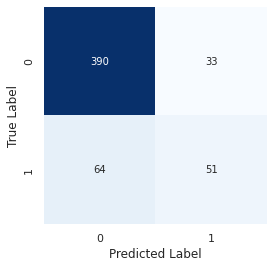


Ejemplo de predicciones:  accordion
True label:  [0 0 0 0 0 0 0 0 0 0]
Predicted:   [[0.11775685 0.38759756 0.00529158 0.00866918 0.00194389 0.34315675
  0.27720737 0.02847736 0.00395992 0.02841239]]
Epoch 1/200
14/14 [==============================] - 1s 14ms/step - loss: 0.6831 - accuracy: 0.5793 - val_loss: 0.6465 - val_accuracy: 0.7071
Epoch 2/200
14/14 [==============================] - 0s 5ms/step - loss: 0.6485 - accuracy: 0.6598 - val_loss: 0.6153 - val_accuracy: 0.7071
Epoch 3/200
14/14 [==============================] - 0s 5ms/step - loss: 0.6416 - accuracy: 0.6598 - val_loss: 0.6076 - val_accuracy: 0.7071
Epoch 4/200
14/14 [==============================] - 0s 6ms/step - loss: 0.6395 - accuracy: 0.6598 - val_loss: 0.6054 - val_accuracy: 0.7071
Epoch 5/200
14/14 [==============================] - 0s 5ms/step - loss: 0.6390 - accuracy: 0.6598 - val_loss: 0.6067 - val_accuracy: 0.7071
Epoch 6/200
14/14 [==============================] - 0s 5ms/step - loss: 0.6390 - accuracy: 0

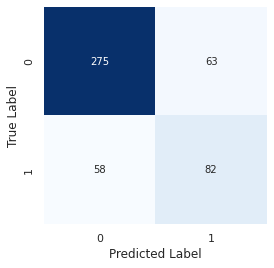


Ejemplo de predicciones:  banjo
True label:  [0 0 1 0 1 0 1 0 0 1]
Predicted:   [[0.15227541 0.00674725 0.5374503  0.25005943 0.01035945 0.1537455
  0.74324113 0.00103297 0.01354173 0.16071658]]
Epoch 1/200
14/14 [==============================] - 1s 68ms/step - loss: 0.6867 - accuracy: 0.5753 - val_loss: 0.6624 - val_accuracy: 0.7071
Epoch 2/200
14/14 [==============================] - 0s 6ms/step - loss: 0.6579 - accuracy: 0.6598 - val_loss: 0.6297 - val_accuracy: 0.7071
Epoch 3/200
14/14 [==============================] - 0s 6ms/step - loss: 0.6445 - accuracy: 0.6598 - val_loss: 0.6137 - val_accuracy: 0.7071
Epoch 4/200
14/14 [==============================] - 0s 6ms/step - loss: 0.6426 - accuracy: 0.6598 - val_loss: 0.6085 - val_accuracy: 0.7071
Epoch 5/200
14/14 [==============================] - 0s 6ms/step - loss: 0.6394 - accuracy: 0.6598 - val_loss: 0.6073 - val_accuracy: 0.7071
Epoch 6/200
14/14 [==============================] - 0s 6ms/step - loss: 0.6372 - accuracy: 0.6598

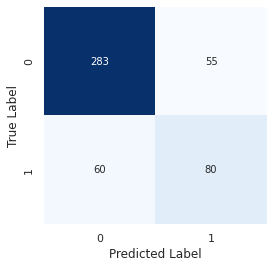


Ejemplo de predicciones:  banjo
True label:  [0 0 1 0 1 0 1 0 0 1]
Predicted:   [[0.09618484 0.00565676 0.6148082  0.23688218 0.01093908 0.16646199
  0.7060439  0.00107034 0.01241807 0.10391293]]
Epoch 1/200
14/14 [==============================] - 1s 16ms/step - loss: 0.6879 - accuracy: 0.5569 - val_loss: 0.6599 - val_accuracy: 0.7071
Epoch 2/200
14/14 [==============================] - 0s 5ms/step - loss: 0.6575 - accuracy: 0.6598 - val_loss: 0.6297 - val_accuracy: 0.7071
Epoch 3/200
14/14 [==============================] - 0s 6ms/step - loss: 0.6444 - accuracy: 0.6598 - val_loss: 0.6164 - val_accuracy: 0.7071
Epoch 4/200
14/14 [==============================] - 0s 6ms/step - loss: 0.6440 - accuracy: 0.6598 - val_loss: 0.6112 - val_accuracy: 0.7071
Epoch 5/200
14/14 [==============================] - 0s 6ms/step - loss: 0.6406 - accuracy: 0.6598 - val_loss: 0.6089 - val_accuracy: 0.7071
Epoch 6/200
14/14 [==============================] - 0s 6ms/step - loss: 0.6408 - accuracy: 0.659

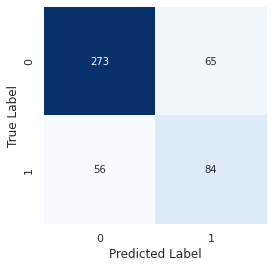


Ejemplo de predicciones:  banjo
True label:  [0 0 1 0 1 0 1 0 0 1]
Predicted:   [[0.18379572 0.01184029 0.5977693  0.35590848 0.01485534 0.2126957
  0.7330806  0.00305638 0.02299922 0.3005261 ]]
Epoch 1/200
14/14 [==============================] - 1s 23ms/step - loss: 0.6787 - accuracy: 0.6322 - val_loss: 0.6463 - val_accuracy: 0.7071
Epoch 2/200
14/14 [==============================] - 0s 9ms/step - loss: 0.6505 - accuracy: 0.6598 - val_loss: 0.6179 - val_accuracy: 0.7071
Epoch 3/200
14/14 [==============================] - 0s 8ms/step - loss: 0.6428 - accuracy: 0.6598 - val_loss: 0.6093 - val_accuracy: 0.7071
Epoch 4/200
14/14 [==============================] - 0s 8ms/step - loss: 0.6431 - accuracy: 0.6598 - val_loss: 0.6082 - val_accuracy: 0.7071
Epoch 5/200
14/14 [==============================] - 0s 7ms/step - loss: 0.6405 - accuracy: 0.6598 - val_loss: 0.6086 - val_accuracy: 0.7071
Epoch 6/200
14/14 [==============================] - 0s 8ms/step - loss: 0.6369 - accuracy: 0.6598

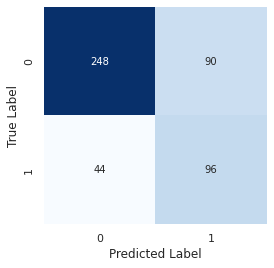


Ejemplo de predicciones:  banjo
True label:  [0 0 1 0 1 0 1 0 0 1]
Predicted:   [[0.33156735 0.00952066 0.6985461  0.34034362 0.01449745 0.27501854
  0.7996285  0.00105661 0.02116964 0.26696077]]
Epoch 1/200
14/14 [==============================] - 1s 17ms/step - loss: 0.6744 - accuracy: 0.6546 - val_loss: 0.6414 - val_accuracy: 0.7071
Epoch 2/200
14/14 [==============================] - 0s 7ms/step - loss: 0.6474 - accuracy: 0.6598 - val_loss: 0.6139 - val_accuracy: 0.7071
Epoch 3/200
14/14 [==============================] - 0s 6ms/step - loss: 0.6438 - accuracy: 0.6598 - val_loss: 0.6067 - val_accuracy: 0.7071
Epoch 4/200
14/14 [==============================] - 0s 6ms/step - loss: 0.6422 - accuracy: 0.6598 - val_loss: 0.6077 - val_accuracy: 0.7071
Epoch 5/200
14/14 [==============================] - 0s 6ms/step - loss: 0.6414 - accuracy: 0.6598 - val_loss: 0.6097 - val_accuracy: 0.7071
Epoch 6/200
14/14 [==============================] - 0s 6ms/step - loss: 0.6390 - accuracy: 0.659

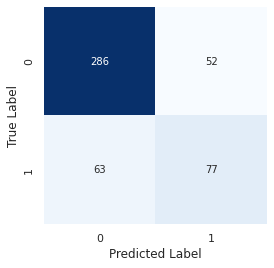


Ejemplo de predicciones:  banjo
True label:  [0 0 1 0 1 0 1 0 0 1]
Predicted:   [[1.03979945e-01 4.81019961e-03 4.70105737e-01 2.57763326e-01
  4.55625216e-03 1.40790999e-01 6.12450600e-01 4.38404444e-04
  8.14944692e-03 1.33150458e-01]]
Epoch 1/200
12/12 [==============================] - 1s 18ms/step - loss: 0.6750 - accuracy: 0.6730 - val_loss: 0.6473 - val_accuracy: 0.7106
Epoch 2/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6323 - accuracy: 0.7088 - val_loss: 0.6114 - val_accuracy: 0.7106
Epoch 3/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6126 - accuracy: 0.7088 - val_loss: 0.6019 - val_accuracy: 0.7106
Epoch 4/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6062 - accuracy: 0.7088 - val_loss: 0.6013 - val_accuracy: 0.7106
Epoch 5/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6061 - accuracy: 0.7088 - val_loss: 0.6010 - val_accuracy: 0.7106
Epoch 6/200
12/12 [==============================] - 0s

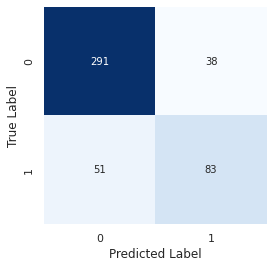


Ejemplo de predicciones:  bass
True label:  [1 1 0 1 1 0 1 0 0 0]
Predicted:   [[0.6714492  0.48037946 0.14827241 0.72442114 0.41162747 0.7438986
  0.7688243  0.06523237 0.02804596 0.01547129]]
Epoch 1/200
12/12 [==============================] - 1s 17ms/step - loss: 0.6822 - accuracy: 0.6042 - val_loss: 0.6486 - val_accuracy: 0.7106
Epoch 2/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6347 - accuracy: 0.7088 - val_loss: 0.6137 - val_accuracy: 0.7106
Epoch 3/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6115 - accuracy: 0.7088 - val_loss: 0.6023 - val_accuracy: 0.7106
Epoch 4/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6079 - accuracy: 0.7088 - val_loss: 0.6009 - val_accuracy: 0.7106
Epoch 5/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6061 - accuracy: 0.7088 - val_loss: 0.6004 - val_accuracy: 0.7106
Epoch 6/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6065 - accuracy: 0.7088 

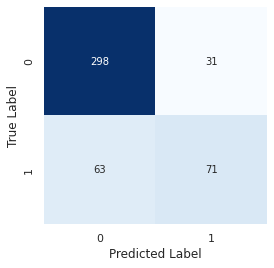


Ejemplo de predicciones:  bass
True label:  [1 1 0 1 1 0 1 0 0 0]
Predicted:   [[0.65184826 0.32951722 0.09625102 0.6857483  0.3806234  0.71155965
  0.7526935  0.05899746 0.03508466 0.01938671]]
Epoch 1/200
12/12 [==============================] - 1s 18ms/step - loss: 0.6807 - accuracy: 0.6056 - val_loss: 0.6463 - val_accuracy: 0.7106
Epoch 2/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6286 - accuracy: 0.7088 - val_loss: 0.6109 - val_accuracy: 0.7106
Epoch 3/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6137 - accuracy: 0.7088 - val_loss: 0.6026 - val_accuracy: 0.7106
Epoch 4/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6091 - accuracy: 0.7088 - val_loss: 0.6018 - val_accuracy: 0.7106
Epoch 5/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6072 - accuracy: 0.7088 - val_loss: 0.6015 - val_accuracy: 0.7106
Epoch 6/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6076 - accuracy: 0.7088

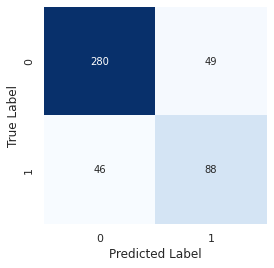


Ejemplo de predicciones:  bass
True label:  [1 1 0 1 1 0 1 0 0 0]
Predicted:   [[0.74172395 0.5406531  0.13265444 0.75615036 0.43817294 0.75863206
  0.8126467  0.09104087 0.04184818 0.02417268]]
Epoch 1/200
12/12 [==============================] - 1s 18ms/step - loss: 0.6755 - accuracy: 0.6470 - val_loss: 0.6474 - val_accuracy: 0.7106
Epoch 2/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6337 - accuracy: 0.7088 - val_loss: 0.6139 - val_accuracy: 0.7106
Epoch 3/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6107 - accuracy: 0.7088 - val_loss: 0.6031 - val_accuracy: 0.7106
Epoch 4/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6043 - accuracy: 0.7088 - val_loss: 0.6016 - val_accuracy: 0.7106
Epoch 5/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6088 - accuracy: 0.7088 - val_loss: 0.6012 - val_accuracy: 0.7106
Epoch 6/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6045 - accuracy: 0.7088

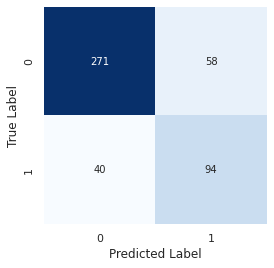


Ejemplo de predicciones:  bass
True label:  [1 1 0 1 1 0 1 0 0 0]
Predicted:   [[0.73535496 0.6124557  0.29529497 0.75896585 0.52974635 0.77773714
  0.82220846 0.1019329  0.05611348 0.0338209 ]]
Epoch 1/200
12/12 [==============================] - 1s 18ms/step - loss: 0.6764 - accuracy: 0.6182 - val_loss: 0.6376 - val_accuracy: 0.7106
Epoch 2/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6295 - accuracy: 0.7088 - val_loss: 0.6083 - val_accuracy: 0.7106
Epoch 3/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6068 - accuracy: 0.7088 - val_loss: 0.6021 - val_accuracy: 0.7106
Epoch 4/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6079 - accuracy: 0.7088 - val_loss: 0.6018 - val_accuracy: 0.7106
Epoch 5/200
12/12 [==============================] - 0s 5ms/step - loss: 0.6111 - accuracy: 0.7088 - val_loss: 0.6012 - val_accuracy: 0.7106
Epoch 6/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6103 - accuracy: 0.7088

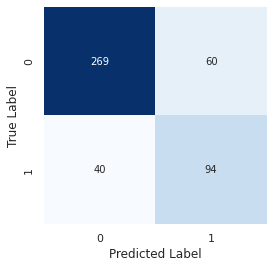


Ejemplo de predicciones:  bass
True label:  [1 1 0 1 1 0 1 0 0 0]
Predicted:   [[0.76200634 0.6588545  0.23474784 0.78819746 0.5122842  0.79621416
  0.84323984 0.10306841 0.04457314 0.02969068]]
Epoch 1/200
12/12 [==============================] - 1s 17ms/step - loss: 0.6882 - accuracy: 0.5745 - val_loss: 0.6911 - val_accuracy: 0.5340
Epoch 2/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6805 - accuracy: 0.5915 - val_loss: 0.6930 - val_accuracy: 0.5340
Epoch 3/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6750 - accuracy: 0.5915 - val_loss: 0.6942 - val_accuracy: 0.5340
Epoch 4/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6756 - accuracy: 0.5915 - val_loss: 0.6935 - val_accuracy: 0.5340
Epoch 5/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6752 - accuracy: 0.5915 - val_loss: 0.6929 - val_accuracy: 0.5340
Epoch 6/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6734 - accuracy: 0.5915

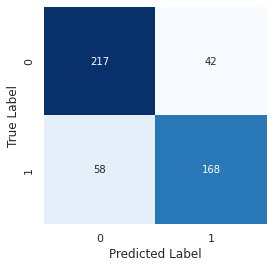


Ejemplo de predicciones:  cello
True label:  [0 0 0 1 0 0 0 0 0 0]
Predicted:   [[4.4686091e-03 4.2805388e-03 8.5594296e-01 3.0645269e-01 2.8777553e-04
  1.0657317e-04 4.9346210e-05 6.1871111e-01 7.0681723e-05 1.0820455e-01]]
Epoch 1/200
12/12 [==============================] - 1s 16ms/step - loss: 0.6920 - accuracy: 0.5191 - val_loss: 0.6913 - val_accuracy: 0.5340
Epoch 2/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6820 - accuracy: 0.5936 - val_loss: 0.6915 - val_accuracy: 0.5340
Epoch 3/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6768 - accuracy: 0.5915 - val_loss: 0.6941 - val_accuracy: 0.5340
Epoch 4/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6756 - accuracy: 0.5915 - val_loss: 0.6954 - val_accuracy: 0.5340
Epoch 5/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6751 - accuracy: 0.5915 - val_loss: 0.6946 - val_accuracy: 0.5340
Epoch 6/200
12/12 [==============================] - 0s 6ms/step - 

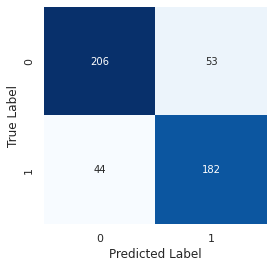


Ejemplo de predicciones:  cello
True label:  [0 0 0 1 0 0 0 0 0 0]
Predicted:   [[9.4148433e-03 8.3436966e-03 8.9030105e-01 4.0817076e-01 1.3267593e-03
  6.9275254e-04 5.1403686e-04 7.5157386e-01 6.7190954e-04 1.8046930e-01]]
Epoch 1/200
12/12 [==============================] - 1s 17ms/step - loss: 0.6891 - accuracy: 0.5369 - val_loss: 0.6901 - val_accuracy: 0.5340
Epoch 2/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6790 - accuracy: 0.5922 - val_loss: 0.6920 - val_accuracy: 0.5340
Epoch 3/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6770 - accuracy: 0.5915 - val_loss: 0.6932 - val_accuracy: 0.5340
Epoch 4/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6740 - accuracy: 0.5915 - val_loss: 0.6931 - val_accuracy: 0.5340
Epoch 5/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6723 - accuracy: 0.5915 - val_loss: 0.6919 - val_accuracy: 0.5340
Epoch 6/200
12/12 [==============================] - 0s 6ms/step - 

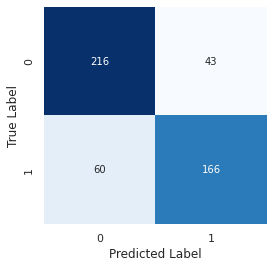


Ejemplo de predicciones:  cello
True label:  [0 0 0 1 0 0 0 0 0 0]
Predicted:   [[2.9932701e-03 3.6540593e-03 8.6844492e-01 3.9191404e-01 1.6295721e-04
  5.7852285e-05 3.4262346e-05 6.3308555e-01 4.3079857e-05 9.0331376e-02]]
Epoch 1/200
12/12 [==============================] - 1s 17ms/step - loss: 0.6877 - accuracy: 0.5656 - val_loss: 0.6900 - val_accuracy: 0.5340
Epoch 2/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6776 - accuracy: 0.5915 - val_loss: 0.6923 - val_accuracy: 0.5340
Epoch 3/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6754 - accuracy: 0.5915 - val_loss: 0.6944 - val_accuracy: 0.5340
Epoch 4/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6784 - accuracy: 0.5915 - val_loss: 0.6934 - val_accuracy: 0.5340
Epoch 5/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6757 - accuracy: 0.5915 - val_loss: 0.6910 - val_accuracy: 0.5340
Epoch 6/200
12/12 [==============================] - 0s 7ms/step - 

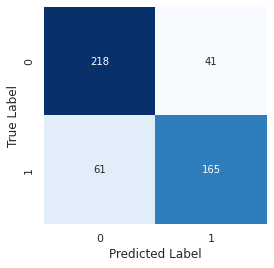


Ejemplo de predicciones:  cello
True label:  [0 0 0 1 0 0 0 0 0 0]
Predicted:   [[7.3677744e-03 7.6834974e-03 8.7779367e-01 2.9346970e-01 1.2095822e-03
  3.9887626e-04 3.0138512e-04 6.5462220e-01 3.9506532e-04 1.0464262e-01]]
Epoch 1/200
12/12 [==============================] - 1s 16ms/step - loss: 0.6861 - accuracy: 0.5758 - val_loss: 0.6916 - val_accuracy: 0.5340
Epoch 2/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6802 - accuracy: 0.5915 - val_loss: 0.6926 - val_accuracy: 0.5340
Epoch 3/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6778 - accuracy: 0.5915 - val_loss: 0.6924 - val_accuracy: 0.5340
Epoch 4/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6766 - accuracy: 0.5915 - val_loss: 0.6915 - val_accuracy: 0.5340
Epoch 5/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6730 - accuracy: 0.5915 - val_loss: 0.6917 - val_accuracy: 0.5340
Epoch 6/200
12/12 [==============================] - 0s 6ms/step - 

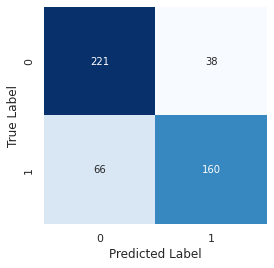


Ejemplo de predicciones:  cello
True label:  [0 0 0 1 0 0 0 0 0 0]
Predicted:   [[3.9774650e-03 4.8835771e-03 8.6423749e-01 2.3252234e-01 2.6002154e-04
  7.9804711e-05 5.8582769e-05 6.8981683e-01 6.5659267e-05 1.0923977e-01]]
Epoch 1/200
14/14 [==============================] - 1s 15ms/step - loss: 0.6558 - accuracy: 0.7072 - val_loss: 0.5916 - val_accuracy: 0.7859
Epoch 2/200
14/14 [==============================] - 0s 8ms/step - loss: 0.5681 - accuracy: 0.7731 - val_loss: 0.5293 - val_accuracy: 0.7859
Epoch 3/200
14/14 [==============================] - 0s 5ms/step - loss: 0.5465 - accuracy: 0.7731 - val_loss: 0.5193 - val_accuracy: 0.7859
Epoch 4/200
14/14 [==============================] - 0s 5ms/step - loss: 0.5428 - accuracy: 0.7731 - val_loss: 0.5190 - val_accuracy: 0.7859
Epoch 5/200
14/14 [==============================] - 0s 7ms/step - loss: 0.5393 - accuracy: 0.7731 - val_loss: 0.5192 - val_accuracy: 0.7859
Epoch 6/200
14/14 [==============================] - 0s 7ms/step - 

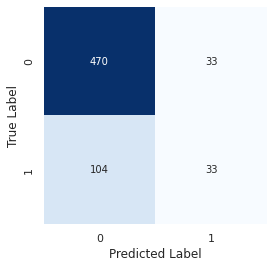


Ejemplo de predicciones:  clarinet
True label:  [1 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.57453436 0.20877431 0.31530795 0.09562701 0.37521198 0.00328635
  0.4681613  0.02039716 0.26198784 0.11979999]]
Epoch 1/200
14/14 [==============================] - 1s 52ms/step - loss: 0.6499 - accuracy: 0.7100 - val_loss: 0.5758 - val_accuracy: 0.7859
Epoch 2/200
14/14 [==============================] - 0s 5ms/step - loss: 0.5604 - accuracy: 0.7731 - val_loss: 0.5233 - val_accuracy: 0.7859
Epoch 3/200
14/14 [==============================] - 0s 6ms/step - loss: 0.5427 - accuracy: 0.7731 - val_loss: 0.5183 - val_accuracy: 0.7859
Epoch 4/200
14/14 [==============================] - 0s 6ms/step - loss: 0.5452 - accuracy: 0.7731 - val_loss: 0.5182 - val_accuracy: 0.7859
Epoch 5/200
14/14 [==============================] - 0s 5ms/step - loss: 0.5445 - accuracy: 0.7731 - val_loss: 0.5194 - val_accuracy: 0.7859
Epoch 6/200
14/14 [==============================] - 0s 5ms/step - loss: 0.5398 - accuracy: 0.

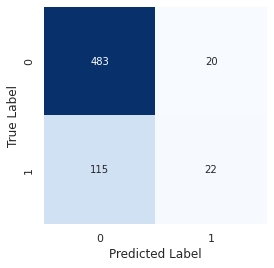


Ejemplo de predicciones:  clarinet
True label:  [1 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.5271108  0.1794709  0.28978875 0.09219455 0.3518661  0.00223826
  0.3990057  0.01278451 0.24870637 0.12176663]]
Epoch 1/200
14/14 [==============================] - 1s 14ms/step - loss: 0.6544 - accuracy: 0.7066 - val_loss: 0.5919 - val_accuracy: 0.7859
Epoch 2/200
14/14 [==============================] - 0s 6ms/step - loss: 0.5732 - accuracy: 0.7731 - val_loss: 0.5334 - val_accuracy: 0.7859
Epoch 3/200
14/14 [==============================] - 0s 7ms/step - loss: 0.5481 - accuracy: 0.7731 - val_loss: 0.5216 - val_accuracy: 0.7859
Epoch 4/200
14/14 [==============================] - 0s 6ms/step - loss: 0.5452 - accuracy: 0.7731 - val_loss: 0.5201 - val_accuracy: 0.7859
Epoch 5/200
14/14 [==============================] - 0s 6ms/step - loss: 0.5498 - accuracy: 0.7731 - val_loss: 0.5206 - val_accuracy: 0.7859
Epoch 6/200
14/14 [==============================] - 0s 7ms/step - loss: 0.5443 - accuracy: 0.

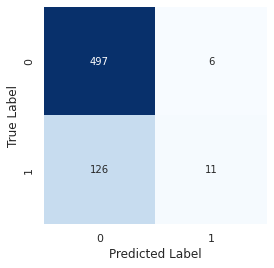


Ejemplo de predicciones:  clarinet
True label:  [1 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.5046193  0.26444563 0.2929221  0.12748419 0.37838838 0.00364698
  0.43958125 0.02151914 0.2336241  0.12070729]]
Epoch 1/200
14/14 [==============================] - 1s 16ms/step - loss: 0.6541 - accuracy: 0.6894 - val_loss: 0.5844 - val_accuracy: 0.7859
Epoch 2/200
14/14 [==============================] - 0s 5ms/step - loss: 0.5654 - accuracy: 0.7731 - val_loss: 0.5279 - val_accuracy: 0.7859
Epoch 3/200
14/14 [==============================] - 0s 6ms/step - loss: 0.5474 - accuracy: 0.7731 - val_loss: 0.5197 - val_accuracy: 0.7859
Epoch 4/200
14/14 [==============================] - 0s 6ms/step - loss: 0.5462 - accuracy: 0.7731 - val_loss: 0.5193 - val_accuracy: 0.7859
Epoch 5/200
14/14 [==============================] - 0s 5ms/step - loss: 0.5393 - accuracy: 0.7731 - val_loss: 0.5193 - val_accuracy: 0.7859
Epoch 6/200
14/14 [==============================] - 0s 6ms/step - loss: 0.5420 - accuracy: 0.

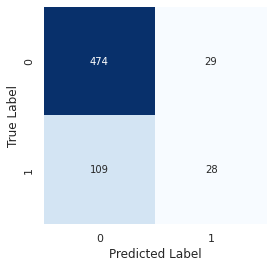


Ejemplo de predicciones:  clarinet
True label:  [1 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.58651406 0.17772089 0.25563502 0.10774526 0.3777305  0.00319936
  0.5068337  0.01913596 0.21431811 0.10923826]]
Epoch 1/200
14/14 [==============================] - 1s 14ms/step - loss: 0.6614 - accuracy: 0.6676 - val_loss: 0.5931 - val_accuracy: 0.7859
Epoch 2/200
14/14 [==============================] - 0s 5ms/step - loss: 0.5694 - accuracy: 0.7731 - val_loss: 0.5287 - val_accuracy: 0.7859
Epoch 3/200
14/14 [==============================] - 0s 7ms/step - loss: 0.5437 - accuracy: 0.7731 - val_loss: 0.5188 - val_accuracy: 0.7859
Epoch 4/200
14/14 [==============================] - 0s 7ms/step - loss: 0.5486 - accuracy: 0.7731 - val_loss: 0.5186 - val_accuracy: 0.7859
Epoch 5/200
14/14 [==============================] - 0s 7ms/step - loss: 0.5437 - accuracy: 0.7731 - val_loss: 0.5198 - val_accuracy: 0.7859
Epoch 6/200
14/14 [==============================] - 0s 7ms/step - loss: 0.5417 - accuracy: 0.

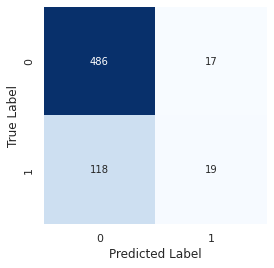


Ejemplo de predicciones:  clarinet
True label:  [1 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.5522183  0.1772873  0.22857521 0.11184716 0.31899965 0.00290913
  0.48055002 0.01538099 0.1961202  0.09278358]]
Epoch 1/200
11/11 [==============================] - 1s 19ms/step - loss: 0.6826 - accuracy: 0.6120 - val_loss: 0.6628 - val_accuracy: 0.6812
Epoch 2/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6650 - accuracy: 0.6266 - val_loss: 0.6394 - val_accuracy: 0.6812
Epoch 3/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6577 - accuracy: 0.6266 - val_loss: 0.6268 - val_accuracy: 0.6812
Epoch 4/200
11/11 [==============================] - 0s 11ms/step - loss: 0.6542 - accuracy: 0.6266 - val_loss: 0.6216 - val_accuracy: 0.6812
Epoch 5/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6513 - accuracy: 0.6266 - val_loss: 0.6186 - val_accuracy: 0.6812
Epoch 6/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6483 - accuracy: 0

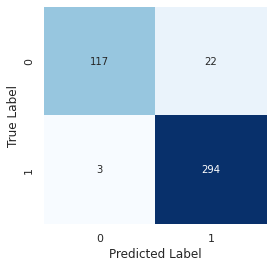


Ejemplo de predicciones:  cymbals
True label:  [1 1 1 1 1 0 1 0 0 0]
Predicted:   [[0.99207956 0.9959585  0.9644056  0.9955503  0.97728914 0.96271783
  0.99513006 0.02631208 0.00788461 0.02261038]]
Epoch 1/200
11/11 [==============================] - 1s 18ms/step - loss: 0.6889 - accuracy: 0.5558 - val_loss: 0.6678 - val_accuracy: 0.6812
Epoch 2/200
11/11 [==============================] - 0s 6ms/step - loss: 0.6696 - accuracy: 0.6266 - val_loss: 0.6426 - val_accuracy: 0.6812
Epoch 3/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6623 - accuracy: 0.6266 - val_loss: 0.6304 - val_accuracy: 0.6812
Epoch 4/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6535 - accuracy: 0.6266 - val_loss: 0.6232 - val_accuracy: 0.6812
Epoch 5/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6551 - accuracy: 0.6266 - val_loss: 0.6196 - val_accuracy: 0.6812
Epoch 6/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6518 - accuracy: 0.6

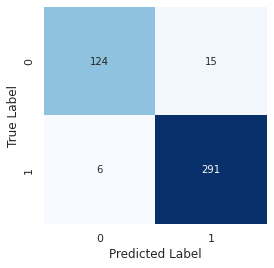


Ejemplo de predicciones:  cymbals
True label:  [1 1 1 1 1 0 1 0 0 0]
Predicted:   [[0.9891011  0.99508274 0.9651129  0.9953447  0.9750879  0.9610989
  0.9948295  0.01872194 0.00543017 0.01714647]]
Epoch 1/200
11/11 [==============================] - 1s 20ms/step - loss: 0.6829 - accuracy: 0.6120 - val_loss: 0.6568 - val_accuracy: 0.6812
Epoch 2/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6645 - accuracy: 0.6266 - val_loss: 0.6322 - val_accuracy: 0.6812
Epoch 3/200
11/11 [==============================] - 0s 6ms/step - loss: 0.6577 - accuracy: 0.6266 - val_loss: 0.6239 - val_accuracy: 0.6812
Epoch 4/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6524 - accuracy: 0.6266 - val_loss: 0.6214 - val_accuracy: 0.6812
Epoch 5/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6508 - accuracy: 0.6266 - val_loss: 0.6192 - val_accuracy: 0.6812
Epoch 6/200
11/11 [==============================] - 0s 6ms/step - loss: 0.6490 - accuracy: 0.62

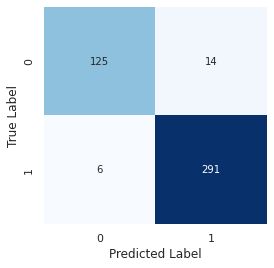


Ejemplo de predicciones:  cymbals
True label:  [1 1 1 1 1 0 1 0 0 0]
Predicted:   [[0.9905839  0.9939558  0.9679213  0.9946742  0.97609246 0.96245295
  0.9958305  0.01317356 0.00303009 0.01064988]]
Epoch 1/200
11/11 [==============================] - 1s 20ms/step - loss: 0.6898 - accuracy: 0.5396 - val_loss: 0.6628 - val_accuracy: 0.6812
Epoch 2/200
11/11 [==============================] - 0s 6ms/step - loss: 0.6687 - accuracy: 0.6266 - val_loss: 0.6359 - val_accuracy: 0.6812
Epoch 3/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6566 - accuracy: 0.6266 - val_loss: 0.6243 - val_accuracy: 0.6812
Epoch 4/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6531 - accuracy: 0.6266 - val_loss: 0.6206 - val_accuracy: 0.6812
Epoch 5/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6525 - accuracy: 0.6266 - val_loss: 0.6177 - val_accuracy: 0.6812
Epoch 6/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6472 - accuracy: 0.6

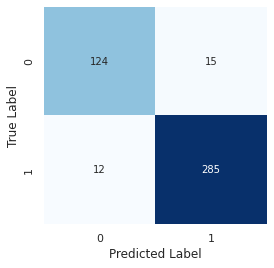


Ejemplo de predicciones:  cymbals
True label:  [1 1 1 1 1 0 1 0 0 0]
Predicted:   [[0.98817575 0.99061793 0.96835595 0.99179816 0.9764525  0.959161
  0.99128306 0.00840381 0.00143502 0.00640538]]
Epoch 1/200
11/11 [==============================] - 1s 18ms/step - loss: 0.6845 - accuracy: 0.5912 - val_loss: 0.6614 - val_accuracy: 0.6812
Epoch 2/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6689 - accuracy: 0.6266 - val_loss: 0.6406 - val_accuracy: 0.6812
Epoch 3/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6625 - accuracy: 0.6266 - val_loss: 0.6314 - val_accuracy: 0.6812
Epoch 4/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6597 - accuracy: 0.6266 - val_loss: 0.6291 - val_accuracy: 0.6812
Epoch 5/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6561 - accuracy: 0.6266 - val_loss: 0.6251 - val_accuracy: 0.6812
Epoch 6/200
11/11 [==============================] - 0s 6ms/step - loss: 0.6532 - accuracy: 0.626

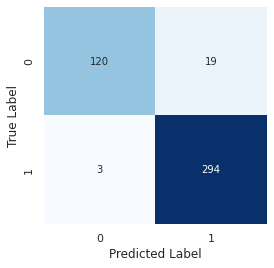


Ejemplo de predicciones:  cymbals
True label:  [1 1 1 1 1 0 1 0 0 0]
Predicted:   [[0.9922654  0.99543756 0.97018135 0.99621296 0.98121166 0.9689664
  0.9952577  0.03523817 0.00686936 0.02249951]]
Epoch 1/200
11/11 [==============================] - 1s 21ms/step - loss: 0.6912 - accuracy: 0.5397 - val_loss: 0.6732 - val_accuracy: 0.6557
Epoch 2/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6709 - accuracy: 0.6251 - val_loss: 0.6524 - val_accuracy: 0.6557
Epoch 3/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6598 - accuracy: 0.6259 - val_loss: 0.6433 - val_accuracy: 0.6557
Epoch 4/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6564 - accuracy: 0.6259 - val_loss: 0.6380 - val_accuracy: 0.6557
Epoch 5/200
11/11 [==============================] - 0s 6ms/step - loss: 0.6503 - accuracy: 0.6259 - val_loss: 0.6359 - val_accuracy: 0.6557
Epoch 6/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6515 - accuracy: 0.62

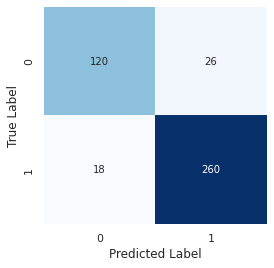


Ejemplo de predicciones:  drums
True label:  [1 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.74770945 0.04266424 0.00196766 0.9912628  0.99740857 0.9993444
  0.9981622  0.9996742  0.99891317 0.9989207 ]]
Epoch 1/200
11/11 [==============================] - 1s 19ms/step - loss: 0.6844 - accuracy: 0.5918 - val_loss: 0.6628 - val_accuracy: 0.6557
Epoch 2/200
11/11 [==============================] - 0s 6ms/step - loss: 0.6631 - accuracy: 0.6259 - val_loss: 0.6428 - val_accuracy: 0.6557
Epoch 3/200
11/11 [==============================] - 0s 6ms/step - loss: 0.6561 - accuracy: 0.6259 - val_loss: 0.6368 - val_accuracy: 0.6557
Epoch 4/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6497 - accuracy: 0.6259 - val_loss: 0.6325 - val_accuracy: 0.6557
Epoch 5/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6497 - accuracy: 0.6259 - val_loss: 0.6302 - val_accuracy: 0.6557
Epoch 6/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6438 - accuracy: 0.6259

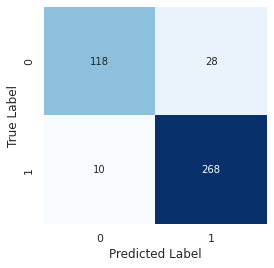


Ejemplo de predicciones:  drums
True label:  [1 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.8893697  0.05887705 0.00504875 0.997726   0.9996408  0.9999585
  0.99981695 0.999984   0.99991155 0.99991274]]
Epoch 1/200
11/11 [==============================] - 1s 19ms/step - loss: 0.6917 - accuracy: 0.5253 - val_loss: 0.6756 - val_accuracy: 0.6557
Epoch 2/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6733 - accuracy: 0.6251 - val_loss: 0.6532 - val_accuracy: 0.6557
Epoch 3/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6639 - accuracy: 0.6259 - val_loss: 0.6444 - val_accuracy: 0.6557
Epoch 4/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6573 - accuracy: 0.6259 - val_loss: 0.6400 - val_accuracy: 0.6557
Epoch 5/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6544 - accuracy: 0.6259 - val_loss: 0.6369 - val_accuracy: 0.6557
Epoch 6/200
11/11 [==============================] - 0s 6ms/step - loss: 0.6530 - accuracy: 0.6259

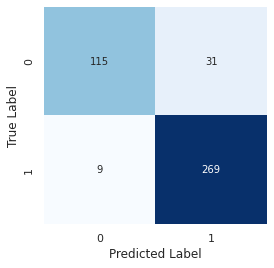


Ejemplo de predicciones:  drums
True label:  [1 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.8787378  0.06808475 0.00273872 0.99608165 0.99907696 0.9997962
  0.99939907 0.99990034 0.99966216 0.99962676]]
Epoch 1/200
11/11 [==============================] - 1s 19ms/step - loss: 0.6884 - accuracy: 0.5752 - val_loss: 0.6735 - val_accuracy: 0.6557
Epoch 2/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6722 - accuracy: 0.6259 - val_loss: 0.6543 - val_accuracy: 0.6557
Epoch 3/200
11/11 [==============================] - 0s 10ms/step - loss: 0.6643 - accuracy: 0.6259 - val_loss: 0.6458 - val_accuracy: 0.6557
Epoch 4/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6600 - accuracy: 0.6259 - val_loss: 0.6418 - val_accuracy: 0.6557
Epoch 5/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6575 - accuracy: 0.6259 - val_loss: 0.6391 - val_accuracy: 0.6557
Epoch 6/200
11/11 [==============================] - 0s 6ms/step - loss: 0.6562 - accuracy: 0.625

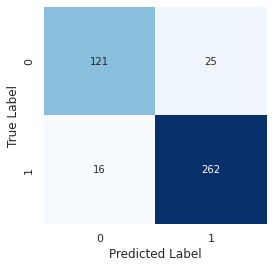


Ejemplo de predicciones:  drums
True label:  [1 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.8221873  0.04377805 0.00510854 0.99569845 0.9990095  0.99986196
  0.99950624 0.9999559  0.99975866 0.99976784]]
Epoch 1/200
11/11 [==============================] - 1s 19ms/step - loss: 0.6866 - accuracy: 0.5699 - val_loss: 0.6688 - val_accuracy: 0.6557
Epoch 2/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6681 - accuracy: 0.6266 - val_loss: 0.6515 - val_accuracy: 0.6557
Epoch 3/200
11/11 [==============================] - 0s 6ms/step - loss: 0.6627 - accuracy: 0.6259 - val_loss: 0.6426 - val_accuracy: 0.6557
Epoch 4/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6560 - accuracy: 0.6259 - val_loss: 0.6394 - val_accuracy: 0.6557
Epoch 5/200
11/11 [==============================] - 0s 6ms/step - loss: 0.6540 - accuracy: 0.6259 - val_loss: 0.6366 - val_accuracy: 0.6557
Epoch 6/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6555 - accuracy: 0.625

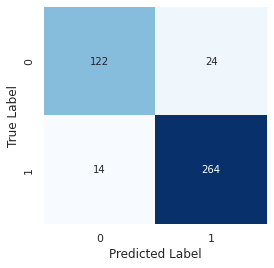


Ejemplo de predicciones:  drums
True label:  [1 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.8270769  0.06692537 0.00370827 0.9946666  0.99863833 0.99976414
  0.9991665  0.9999113  0.9994785  0.999608  ]]
Epoch 1/200
12/12 [==============================] - 1s 17ms/step - loss: 0.6604 - accuracy: 0.6873 - val_loss: 0.6367 - val_accuracy: 0.6886
Epoch 2/200
12/12 [==============================] - 0s 9ms/step - loss: 0.6316 - accuracy: 0.6899 - val_loss: 0.6193 - val_accuracy: 0.6886
Epoch 3/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6241 - accuracy: 0.6899 - val_loss: 0.6186 - val_accuracy: 0.6886
Epoch 4/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6235 - accuracy: 0.6899 - val_loss: 0.6178 - val_accuracy: 0.6886
Epoch 5/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6209 - accuracy: 0.6899 - val_loss: 0.6174 - val_accuracy: 0.6886
Epoch 6/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6166 - accuracy: 0.689

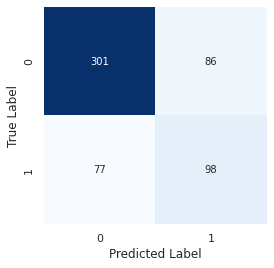


Ejemplo de predicciones:  flute
True label:  [0 0 1 0 0 0 1 0 0 0]
Predicted:   [[0.6818435  0.35835177 0.4947077  0.65165645 0.6469484  0.35882244
  0.49063075 0.6614335  0.49488527 0.01009831]]
Epoch 1/200
12/12 [==============================] - 1s 16ms/step - loss: 0.6829 - accuracy: 0.6216 - val_loss: 0.6636 - val_accuracy: 0.6886
Epoch 2/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6496 - accuracy: 0.6899 - val_loss: 0.6328 - val_accuracy: 0.6886
Epoch 3/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6281 - accuracy: 0.6899 - val_loss: 0.6211 - val_accuracy: 0.6886
Epoch 4/200
12/12 [==============================] - 0s 9ms/step - loss: 0.6197 - accuracy: 0.6899 - val_loss: 0.6196 - val_accuracy: 0.6886
Epoch 5/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6211 - accuracy: 0.6899 - val_loss: 0.6191 - val_accuracy: 0.6886
Epoch 6/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6182 - accuracy: 0.689

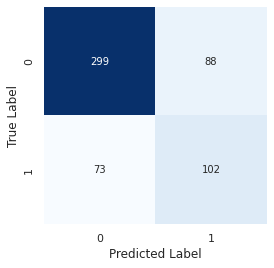


Ejemplo de predicciones:  flute
True label:  [0 0 1 0 0 0 1 0 0 0]
Predicted:   [[0.6697407  0.2675395  0.56693166 0.6506655  0.57028574 0.33664262
  0.530528   0.6305302  0.43832996 0.02366186]]
Epoch 1/200
12/12 [==============================] - 1s 18ms/step - loss: 0.6742 - accuracy: 0.6695 - val_loss: 0.6531 - val_accuracy: 0.6886
Epoch 2/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6351 - accuracy: 0.6899 - val_loss: 0.6226 - val_accuracy: 0.6886
Epoch 3/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6243 - accuracy: 0.6899 - val_loss: 0.6184 - val_accuracy: 0.6886
Epoch 4/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6230 - accuracy: 0.6899 - val_loss: 0.6178 - val_accuracy: 0.6886
Epoch 5/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6157 - accuracy: 0.6899 - val_loss: 0.6172 - val_accuracy: 0.6886
Epoch 6/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6170 - accuracy: 0.689

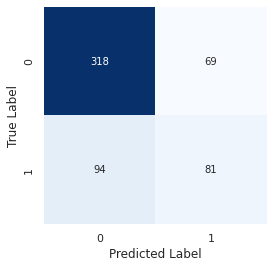


Ejemplo de predicciones:  flute
True label:  [0 0 1 0 0 0 1 0 0 0]
Predicted:   [[0.6690352  0.36324716 0.45321837 0.6011473  0.57799953 0.35470304
  0.45597875 0.6022694  0.47973704 0.01689088]]
Epoch 1/200
12/12 [==============================] - 1s 17ms/step - loss: 0.6697 - accuracy: 0.6748 - val_loss: 0.6460 - val_accuracy: 0.6886
Epoch 2/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6324 - accuracy: 0.6899 - val_loss: 0.6227 - val_accuracy: 0.6886
Epoch 3/200
12/12 [==============================] - 0s 6ms/step - loss: 0.6230 - accuracy: 0.6899 - val_loss: 0.6195 - val_accuracy: 0.6886
Epoch 4/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6240 - accuracy: 0.6899 - val_loss: 0.6188 - val_accuracy: 0.6886
Epoch 5/200
12/12 [==============================] - 0s 9ms/step - loss: 0.6221 - accuracy: 0.6899 - val_loss: 0.6184 - val_accuracy: 0.6886
Epoch 6/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6248 - accuracy: 0.689

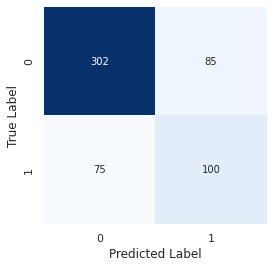


Ejemplo de predicciones:  flute
True label:  [0 0 1 0 0 0 1 0 0 0]
Predicted:   [[0.70661443 0.38103944 0.51778895 0.6085024  0.62102437 0.35412914
  0.53776544 0.63953197 0.5518208  0.01427483]]
Epoch 1/200
12/12 [==============================] - 1s 18ms/step - loss: 0.6773 - accuracy: 0.6426 - val_loss: 0.6519 - val_accuracy: 0.6886
Epoch 2/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6409 - accuracy: 0.6899 - val_loss: 0.6234 - val_accuracy: 0.6886
Epoch 3/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6209 - accuracy: 0.6899 - val_loss: 0.6185 - val_accuracy: 0.6886
Epoch 4/200
12/12 [==============================] - 0s 9ms/step - loss: 0.6195 - accuracy: 0.6899 - val_loss: 0.6178 - val_accuracy: 0.6886
Epoch 5/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6202 - accuracy: 0.6899 - val_loss: 0.6173 - val_accuracy: 0.6886
Epoch 6/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6178 - accuracy: 0.689

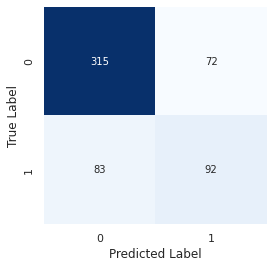


Ejemplo de predicciones:  flute
True label:  [0 0 1 0 0 0 1 0 0 0]
Predicted:   [[0.6790351  0.36948055 0.51141495 0.6133664  0.6041221  0.25915533
  0.5059199  0.6430978  0.48744398 0.01368917]]
Epoch 1/200
10/10 [==============================] - 1s 22ms/step - loss: 0.6807 - accuracy: 0.6071 - val_loss: 0.6657 - val_accuracy: 0.6560
Epoch 2/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6390 - accuracy: 0.7018 - val_loss: 0.6457 - val_accuracy: 0.6560
Epoch 3/200
10/10 [==============================] - 0s 7ms/step - loss: 0.6124 - accuracy: 0.7018 - val_loss: 0.6427 - val_accuracy: 0.6560
Epoch 4/200
10/10 [==============================] - 0s 7ms/step - loss: 0.6081 - accuracy: 0.7018 - val_loss: 0.6453 - val_accuracy: 0.6560
Epoch 5/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6160 - accuracy: 0.7018 - val_loss: 0.6451 - val_accuracy: 0.6560
Epoch 6/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6096 - accuracy: 0.701

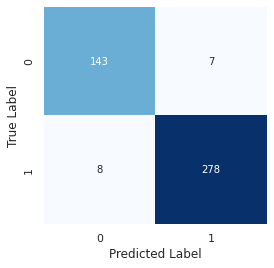


Ejemplo de predicciones:  guitar
True label:  [0 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.02612167 0.12385757 0.03088534 0.9713968  0.9709419  0.90242684
  0.97863376 0.996999   0.9876989  0.9946562 ]]
Epoch 1/200
10/10 [==============================] - 1s 22ms/step - loss: 0.6668 - accuracy: 0.6944 - val_loss: 0.6547 - val_accuracy: 0.6560
Epoch 2/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6273 - accuracy: 0.7018 - val_loss: 0.6372 - val_accuracy: 0.6560
Epoch 3/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6096 - accuracy: 0.7018 - val_loss: 0.6393 - val_accuracy: 0.6560
Epoch 4/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6102 - accuracy: 0.7018 - val_loss: 0.6397 - val_accuracy: 0.6560
Epoch 5/200
10/10 [==============================] - 0s 7ms/step - loss: 0.6056 - accuracy: 0.7018 - val_loss: 0.6357 - val_accuracy: 0.6560
Epoch 6/200
10/10 [==============================] - 0s 7ms/step - loss: 0.6001 - accuracy: 0.70

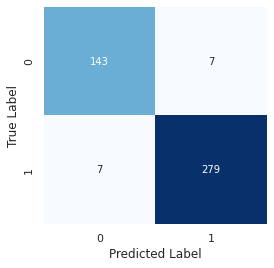


Ejemplo de predicciones:  guitar
True label:  [0 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.05059576 0.13987951 0.05757861 0.9761554  0.98044616 0.93849605
  0.98787785 0.9989962  0.9927371  0.9976624 ]]
Epoch 1/200
10/10 [==============================] - 1s 21ms/step - loss: 0.6819 - accuracy: 0.6260 - val_loss: 0.6672 - val_accuracy: 0.6560
Epoch 2/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6474 - accuracy: 0.7018 - val_loss: 0.6459 - val_accuracy: 0.6560
Epoch 3/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6209 - accuracy: 0.7018 - val_loss: 0.6400 - val_accuracy: 0.6560
Epoch 4/200
10/10 [==============================] - 0s 7ms/step - loss: 0.6126 - accuracy: 0.7018 - val_loss: 0.6403 - val_accuracy: 0.6560
Epoch 5/200
10/10 [==============================] - 0s 7ms/step - loss: 0.6135 - accuracy: 0.7018 - val_loss: 0.6411 - val_accuracy: 0.6560
Epoch 6/200
10/10 [==============================] - 0s 7ms/step - loss: 0.6073 - accuracy: 0.70

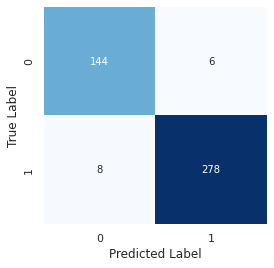


Ejemplo de predicciones:  guitar
True label:  [0 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.02426147 0.09835088 0.03030925 0.9735382  0.98053485 0.8951109
  0.9809063  0.99769884 0.9908421  0.99529934]]
Epoch 1/200
10/10 [==============================] - 1s 20ms/step - loss: 0.6785 - accuracy: 0.6153 - val_loss: 0.6574 - val_accuracy: 0.6560
Epoch 2/200
10/10 [==============================] - 0s 10ms/step - loss: 0.6343 - accuracy: 0.7018 - val_loss: 0.6408 - val_accuracy: 0.6560
Epoch 3/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6146 - accuracy: 0.7018 - val_loss: 0.6400 - val_accuracy: 0.6560
Epoch 4/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6128 - accuracy: 0.7018 - val_loss: 0.6398 - val_accuracy: 0.6560
Epoch 5/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6038 - accuracy: 0.7018 - val_loss: 0.6386 - val_accuracy: 0.6560
Epoch 6/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6077 - accuracy: 0.70

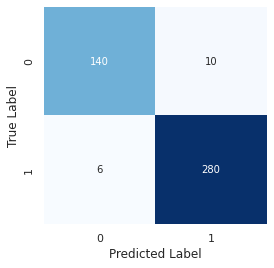


Ejemplo de predicciones:  guitar
True label:  [0 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.03945829 0.24499354 0.04943245 0.9872938  0.98571265 0.9611451
  0.9911985  0.99882466 0.99497014 0.997221  ]]
Epoch 1/200
10/10 [==============================] - 1s 20ms/step - loss: 0.6803 - accuracy: 0.6186 - val_loss: 0.6641 - val_accuracy: 0.6560
Epoch 2/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6400 - accuracy: 0.7018 - val_loss: 0.6436 - val_accuracy: 0.6560
Epoch 3/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6185 - accuracy: 0.7018 - val_loss: 0.6411 - val_accuracy: 0.6560
Epoch 4/200
10/10 [==============================] - 0s 7ms/step - loss: 0.6104 - accuracy: 0.7018 - val_loss: 0.6435 - val_accuracy: 0.6560
Epoch 5/200
10/10 [==============================] - 0s 7ms/step - loss: 0.6102 - accuracy: 0.7018 - val_loss: 0.6420 - val_accuracy: 0.6560
Epoch 6/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6102 - accuracy: 0.701

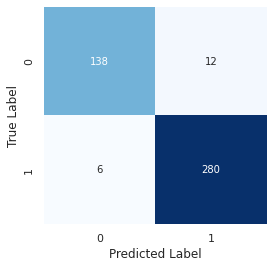


Ejemplo de predicciones:  guitar
True label:  [0 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.04346063 0.25585285 0.05300077 0.9866839  0.9918058  0.97375727
  0.991469   0.99924064 0.9957671  0.9982053 ]]
Epoch 1/200
11/11 [==============================] - 1s 19ms/step - loss: 0.6904 - accuracy: 0.5491 - val_loss: 0.6877 - val_accuracy: 0.5586
Epoch 2/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6800 - accuracy: 0.6035 - val_loss: 0.6852 - val_accuracy: 0.5586
Epoch 3/200
11/11 [==============================] - 0s 9ms/step - loss: 0.6731 - accuracy: 0.6057 - val_loss: 0.6868 - val_accuracy: 0.5586
Epoch 4/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6693 - accuracy: 0.6057 - val_loss: 0.6887 - val_accuracy: 0.5586
Epoch 5/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6699 - accuracy: 0.6057 - val_loss: 0.6882 - val_accuracy: 0.5586
Epoch 6/200
11/11 [==============================] - 0s 9ms/step - loss: 0.6694 - accuracy: 0.60

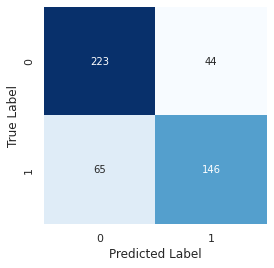


Ejemplo de predicciones:  mallet_percussion
True label:  [0 1 0 0 1 1 0 0 0 0]
Predicted:   [[0.7026228  0.7764619  0.08578415 0.0536841  0.86322063 0.5502768
  0.00654649 0.00354553 0.00534058 0.01204023]]
Epoch 1/200
11/11 [==============================] - 1s 18ms/step - loss: 0.6894 - accuracy: 0.5536 - val_loss: 0.6873 - val_accuracy: 0.5586
Epoch 2/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6778 - accuracy: 0.6057 - val_loss: 0.6857 - val_accuracy: 0.5586
Epoch 3/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6736 - accuracy: 0.6057 - val_loss: 0.6870 - val_accuracy: 0.5586
Epoch 4/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6705 - accuracy: 0.6057 - val_loss: 0.6880 - val_accuracy: 0.5586
Epoch 5/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6698 - accuracy: 0.6057 - val_loss: 0.6878 - val_accuracy: 0.5586
Epoch 6/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6701 - accu

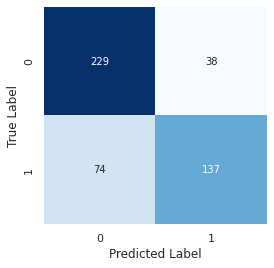


Ejemplo de predicciones:  mallet_percussion
True label:  [0 1 0 0 1 1 0 0 0 0]
Predicted:   [[0.7220628  0.7496506  0.07565966 0.0443305  0.8445399  0.48434195
  0.00743748 0.00510798 0.00707242 0.01335123]]
Epoch 1/200
11/11 [==============================] - 1s 19ms/step - loss: 0.6870 - accuracy: 0.5808 - val_loss: 0.6872 - val_accuracy: 0.5586
Epoch 2/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6731 - accuracy: 0.6057 - val_loss: 0.6881 - val_accuracy: 0.5586
Epoch 3/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6711 - accuracy: 0.6057 - val_loss: 0.6907 - val_accuracy: 0.5586
Epoch 4/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6722 - accuracy: 0.6057 - val_loss: 0.6894 - val_accuracy: 0.5586
Epoch 5/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6685 - accuracy: 0.6057 - val_loss: 0.6869 - val_accuracy: 0.5586
Epoch 6/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6686 - acc

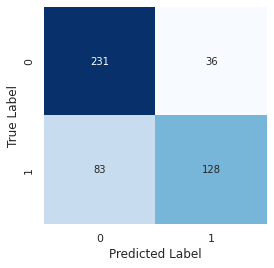


Ejemplo de predicciones:  mallet_percussion
True label:  [0 1 0 0 1 1 0 0 0 0]
Predicted:   [[0.6506032  0.7744032  0.04827811 0.02628668 0.8427707  0.42552623
  0.00228605 0.00189883 0.00301167 0.00609339]]
Epoch 1/200
11/11 [==============================] - 1s 19ms/step - loss: 0.6885 - accuracy: 0.5438 - val_loss: 0.6867 - val_accuracy: 0.5586
Epoch 2/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6749 - accuracy: 0.6065 - val_loss: 0.6855 - val_accuracy: 0.5586
Epoch 3/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6736 - accuracy: 0.6057 - val_loss: 0.6864 - val_accuracy: 0.5586
Epoch 4/200
11/11 [==============================] - 0s 9ms/step - loss: 0.6663 - accuracy: 0.6057 - val_loss: 0.6868 - val_accuracy: 0.5586
Epoch 5/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6676 - accuracy: 0.6057 - val_loss: 0.6866 - val_accuracy: 0.5586
Epoch 6/200
11/11 [==============================] - 0s 9ms/step - loss: 0.6640 - acc

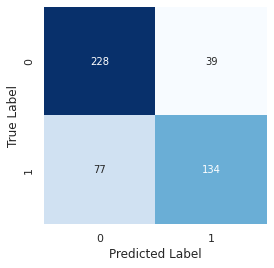


Ejemplo de predicciones:  mallet_percussion
True label:  [0 1 0 0 1 1 0 0 0 0]
Predicted:   [[0.74732405 0.75692374 0.10664213 0.03840308 0.8343191  0.47669116
  0.00284355 0.00293531 0.00445672 0.00656284]]
Epoch 1/200
11/11 [==============================] - 1s 21ms/step - loss: 0.6878 - accuracy: 0.5665 - val_loss: 0.6853 - val_accuracy: 0.5586
Epoch 2/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6777 - accuracy: 0.6035 - val_loss: 0.6843 - val_accuracy: 0.5586
Epoch 3/200
11/11 [==============================] - 0s 9ms/step - loss: 0.6751 - accuracy: 0.6057 - val_loss: 0.6855 - val_accuracy: 0.5586
Epoch 4/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6682 - accuracy: 0.6057 - val_loss: 0.6860 - val_accuracy: 0.5586
Epoch 5/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6701 - accuracy: 0.6057 - val_loss: 0.6854 - val_accuracy: 0.5586
Epoch 6/200
11/11 [==============================] - 0s 9ms/step - loss: 0.6697 - acc

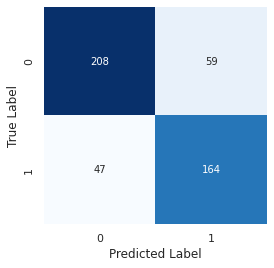


Ejemplo de predicciones:  mallet_percussion
True label:  [0 1 0 0 1 1 0 0 0 0]
Predicted:   [[0.78596175 0.83938015 0.12453799 0.05007024 0.87918955 0.6432466
  0.00890351 0.00614337 0.00972022 0.01585563]]
Epoch 1/200
15/15 [==============================] - 1s 15ms/step - loss: 0.6854 - accuracy: 0.5678 - val_loss: 0.6526 - val_accuracy: 0.6922
Epoch 2/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6588 - accuracy: 0.6451 - val_loss: 0.6276 - val_accuracy: 0.6922
Epoch 3/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6528 - accuracy: 0.6451 - val_loss: 0.6220 - val_accuracy: 0.6922
Epoch 4/200
15/15 [==============================] - 0s 10ms/step - loss: 0.6490 - accuracy: 0.6451 - val_loss: 0.6196 - val_accuracy: 0.6922
Epoch 5/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6484 - accuracy: 0.6451 - val_loss: 0.6197 - val_accuracy: 0.6922
Epoch 6/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6468 - acc

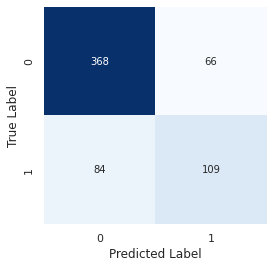


Ejemplo de predicciones:  mandolin
True label:  [0 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.01999044 0.7216643  0.03134739 0.1369195  0.20950055 0.21728389
  0.42641664 0.07002642 0.01497764 0.00162038]]
Epoch 1/200
15/15 [==============================] - 1s 15ms/step - loss: 0.6803 - accuracy: 0.6168 - val_loss: 0.6474 - val_accuracy: 0.6922
Epoch 2/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6575 - accuracy: 0.6451 - val_loss: 0.6260 - val_accuracy: 0.6922
Epoch 3/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6542 - accuracy: 0.6451 - val_loss: 0.6219 - val_accuracy: 0.6922
Epoch 4/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6512 - accuracy: 0.6451 - val_loss: 0.6221 - val_accuracy: 0.6922
Epoch 5/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6488 - accuracy: 0.6451 - val_loss: 0.6195 - val_accuracy: 0.6922
Epoch 6/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6485 - accuracy: 0.

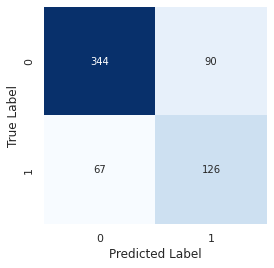


Ejemplo de predicciones:  mandolin
True label:  [0 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.02147584 0.7375498  0.04400294 0.22892138 0.35454324 0.23738761
  0.55209047 0.14862013 0.04795356 0.00200049]]
Epoch 1/200
15/15 [==============================] - 1s 51ms/step - loss: 0.6764 - accuracy: 0.6162 - val_loss: 0.6430 - val_accuracy: 0.6922
Epoch 2/200
15/15 [==============================] - 0s 8ms/step - loss: 0.6542 - accuracy: 0.6451 - val_loss: 0.6217 - val_accuracy: 0.6922
Epoch 3/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6488 - accuracy: 0.6451 - val_loss: 0.6192 - val_accuracy: 0.6922
Epoch 4/200
15/15 [==============================] - 0s 8ms/step - loss: 0.6472 - accuracy: 0.6451 - val_loss: 0.6207 - val_accuracy: 0.6922
Epoch 5/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6469 - accuracy: 0.6451 - val_loss: 0.6187 - val_accuracy: 0.6922
Epoch 6/200
15/15 [==============================] - 0s 8ms/step - loss: 0.6482 - accuracy: 0.

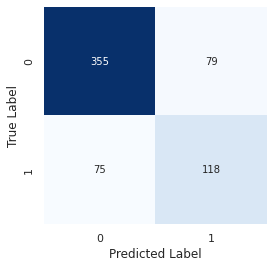


Ejemplo de predicciones:  mandolin
True label:  [0 0 0 0 0 1 0 0 0 0]
Predicted:   [[1.3428860e-02 7.4836230e-01 3.7893035e-02 1.7635410e-01 2.3283668e-01
  2.0898242e-01 5.3589314e-01 1.2934399e-01 1.9385118e-02 7.1482285e-04]]
Epoch 1/200
15/15 [==============================] - 1s 15ms/step - loss: 0.6780 - accuracy: 0.6195 - val_loss: 0.6425 - val_accuracy: 0.6922
Epoch 2/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6559 - accuracy: 0.6451 - val_loss: 0.6231 - val_accuracy: 0.6922
Epoch 3/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6523 - accuracy: 0.6451 - val_loss: 0.6193 - val_accuracy: 0.6922
Epoch 4/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6498 - accuracy: 0.6451 - val_loss: 0.6191 - val_accuracy: 0.6922
Epoch 5/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6493 - accuracy: 0.6451 - val_loss: 0.6183 - val_accuracy: 0.6922
Epoch 6/200
15/15 [==============================] - 0s 7ms/step

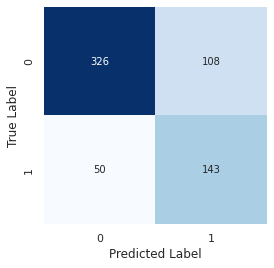


Ejemplo de predicciones:  mandolin
True label:  [0 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.02554579 0.7543236  0.04790429 0.30891004 0.40340787 0.32445267
  0.6467975  0.2036336  0.04150496 0.00164509]]
Epoch 1/200
15/15 [==============================] - 1s 16ms/step - loss: 0.6772 - accuracy: 0.6200 - val_loss: 0.6468 - val_accuracy: 0.6922
Epoch 2/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6528 - accuracy: 0.6451 - val_loss: 0.6224 - val_accuracy: 0.6922
Epoch 3/200
15/15 [==============================] - 0s 8ms/step - loss: 0.6557 - accuracy: 0.6451 - val_loss: 0.6173 - val_accuracy: 0.6922
Epoch 4/200
15/15 [==============================] - 0s 8ms/step - loss: 0.6486 - accuracy: 0.6451 - val_loss: 0.6196 - val_accuracy: 0.6922
Epoch 5/200
15/15 [==============================] - 0s 8ms/step - loss: 0.6467 - accuracy: 0.6451 - val_loss: 0.6202 - val_accuracy: 0.6922
Epoch 6/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6482 - accuracy: 0.

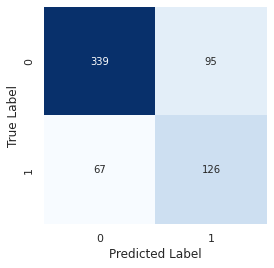


Ejemplo de predicciones:  mandolin
True label:  [0 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.02629281 0.7425473  0.03973196 0.24279736 0.3231861  0.24453093
  0.53626776 0.16301334 0.01761995 0.00077817]]
Epoch 1/200
12/12 [==============================] - 1s 18ms/step - loss: 0.6969 - accuracy: 0.4921 - val_loss: 0.6658 - val_accuracy: 0.7193
Epoch 2/200
12/12 [==============================] - 0s 9ms/step - loss: 0.6613 - accuracy: 0.6696 - val_loss: 0.6337 - val_accuracy: 0.7193
Epoch 3/200
12/12 [==============================] - 0s 9ms/step - loss: 0.6423 - accuracy: 0.6696 - val_loss: 0.6138 - val_accuracy: 0.7193
Epoch 4/200
12/12 [==============================] - 0s 9ms/step - loss: 0.6337 - accuracy: 0.6696 - val_loss: 0.6041 - val_accuracy: 0.7193
Epoch 5/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6309 - accuracy: 0.6696 - val_loss: 0.5991 - val_accuracy: 0.7193
Epoch 6/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6302 - accuracy: 0.

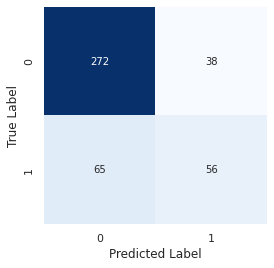


Ejemplo de predicciones:  organ
True label:  [0 0 0 1 0 1 0 0 0 0]
Predicted:   [[0.0345983  0.7306184  0.356188   0.21966529 0.02825172 0.5856521
  0.00876963 0.01547998 0.01060895 0.01211121]]
Epoch 1/200
12/12 [==============================] - 1s 18ms/step - loss: 0.6798 - accuracy: 0.6443 - val_loss: 0.6543 - val_accuracy: 0.7193
Epoch 2/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6526 - accuracy: 0.6696 - val_loss: 0.6188 - val_accuracy: 0.7193
Epoch 3/200
12/12 [==============================] - 0s 9ms/step - loss: 0.6388 - accuracy: 0.6696 - val_loss: 0.6030 - val_accuracy: 0.7193
Epoch 4/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6338 - accuracy: 0.6696 - val_loss: 0.5990 - val_accuracy: 0.7193
Epoch 5/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6293 - accuracy: 0.6696 - val_loss: 0.5965 - val_accuracy: 0.7193
Epoch 6/200
12/12 [==============================] - 0s 9ms/step - loss: 0.6285 - accuracy: 0.6696

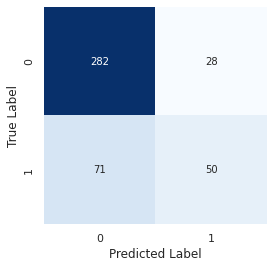


Ejemplo de predicciones:  organ
True label:  [0 0 0 1 0 1 0 0 0 0]
Predicted:   [[0.01372414 0.7020997  0.3731012  0.12880889 0.00838676 0.5623619
  0.00136107 0.00442434 0.00217585 0.00231244]]
Epoch 1/200
12/12 [==============================] - 1s 17ms/step - loss: 0.6748 - accuracy: 0.6210 - val_loss: 0.6405 - val_accuracy: 0.7193
Epoch 2/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6484 - accuracy: 0.6696 - val_loss: 0.6074 - val_accuracy: 0.7193
Epoch 3/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6340 - accuracy: 0.6696 - val_loss: 0.5975 - val_accuracy: 0.7193
Epoch 4/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6304 - accuracy: 0.6696 - val_loss: 0.5956 - val_accuracy: 0.7193
Epoch 5/200
12/12 [==============================] - 0s 10ms/step - loss: 0.6254 - accuracy: 0.6696 - val_loss: 0.5948 - val_accuracy: 0.7193
Epoch 6/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6198 - accuracy: 0.669

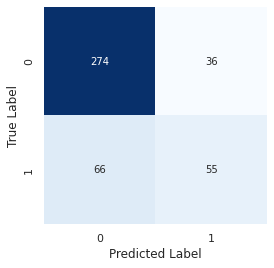


Ejemplo de predicciones:  organ
True label:  [0 0 0 1 0 1 0 0 0 0]
Predicted:   [[0.02472752 0.7078105  0.3278021  0.18586446 0.01091926 0.6111459
  0.00154144 0.00545783 0.00329383 0.0040075 ]]
Epoch 1/200
12/12 [==============================] - 1s 18ms/step - loss: 0.6877 - accuracy: 0.5353 - val_loss: 0.6493 - val_accuracy: 0.7193
Epoch 2/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6502 - accuracy: 0.6696 - val_loss: 0.6141 - val_accuracy: 0.7193
Epoch 3/200
12/12 [==============================] - 0s 9ms/step - loss: 0.6361 - accuracy: 0.6696 - val_loss: 0.6004 - val_accuracy: 0.7193
Epoch 4/200
12/12 [==============================] - 0s 9ms/step - loss: 0.6295 - accuracy: 0.6696 - val_loss: 0.5967 - val_accuracy: 0.7193
Epoch 5/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6299 - accuracy: 0.6696 - val_loss: 0.5958 - val_accuracy: 0.7193
Epoch 6/200
12/12 [==============================] - 0s 7ms/step - loss: 0.6213 - accuracy: 0.6696

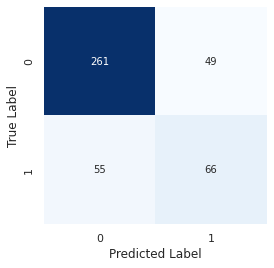


Ejemplo de predicciones:  organ
True label:  [0 0 0 1 0 1 0 0 0 0]
Predicted:   [[0.02429081 0.78133416 0.44489032 0.27665567 0.0171742  0.6972481
  0.00245143 0.0074095  0.00355226 0.00529313]]
Epoch 1/200
12/12 [==============================] - 1s 19ms/step - loss: 0.6799 - accuracy: 0.6367 - val_loss: 0.6537 - val_accuracy: 0.7193
Epoch 2/200
12/12 [==============================] - 0s 9ms/step - loss: 0.6517 - accuracy: 0.6696 - val_loss: 0.6177 - val_accuracy: 0.7193
Epoch 3/200
12/12 [==============================] - 0s 9ms/step - loss: 0.6368 - accuracy: 0.6696 - val_loss: 0.6025 - val_accuracy: 0.7193
Epoch 4/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6321 - accuracy: 0.6696 - val_loss: 0.5988 - val_accuracy: 0.7193
Epoch 5/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6265 - accuracy: 0.6696 - val_loss: 0.5969 - val_accuracy: 0.7193
Epoch 6/200
12/12 [==============================] - 0s 8ms/step - loss: 0.6241 - accuracy: 0.6696

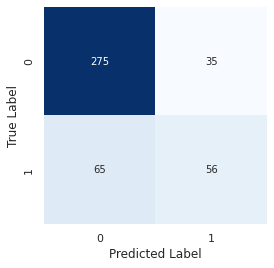


Ejemplo de predicciones:  organ
True label:  [0 0 0 1 0 1 0 0 0 0]
Predicted:   [[0.01812659 0.6945632  0.3715095  0.18553339 0.01262137 0.59771544
  0.00304805 0.00574094 0.00379103 0.00374668]]
Epoch 1/200
11/11 [==============================] - 1s 20ms/step - loss: 0.6818 - accuracy: 0.6069 - val_loss: 0.6580 - val_accuracy: 0.6867
Epoch 2/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6462 - accuracy: 0.6782 - val_loss: 0.6308 - val_accuracy: 0.6867
Epoch 3/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6324 - accuracy: 0.6782 - val_loss: 0.6189 - val_accuracy: 0.6867
Epoch 4/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6288 - accuracy: 0.6782 - val_loss: 0.6149 - val_accuracy: 0.6867
Epoch 5/200
11/11 [==============================] - 0s 10ms/step - loss: 0.6244 - accuracy: 0.6782 - val_loss: 0.6128 - val_accuracy: 0.6867
Epoch 6/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6168 - accuracy: 0.67

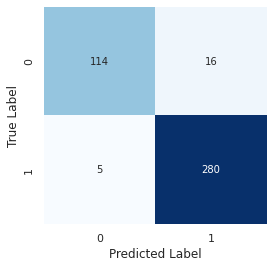


Ejemplo de predicciones:  piano
True label:  [0 0 0 0 0 0 0 1 0 0]
Predicted:   [[0.00744856 0.01078532 0.0189256  0.03315162 0.00922196 0.00299626
  0.01146214 0.5633539  0.93948257 0.00452027]]
Epoch 1/200
11/11 [==============================] - 1s 20ms/step - loss: 0.6883 - accuracy: 0.5716 - val_loss: 0.6680 - val_accuracy: 0.6867
Epoch 2/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6571 - accuracy: 0.6782 - val_loss: 0.6372 - val_accuracy: 0.6867
Epoch 3/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6318 - accuracy: 0.6782 - val_loss: 0.6212 - val_accuracy: 0.6867
Epoch 4/200
11/11 [==============================] - 0s 9ms/step - loss: 0.6222 - accuracy: 0.6782 - val_loss: 0.6147 - val_accuracy: 0.6867
Epoch 5/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6218 - accuracy: 0.6782 - val_loss: 0.6108 - val_accuracy: 0.6867
Epoch 6/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6176 - accuracy: 0.678

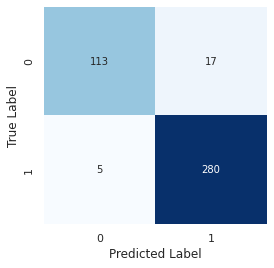


Ejemplo de predicciones:  piano
True label:  [0 0 0 0 0 0 0 1 0 0]
Predicted:   [[0.00582185 0.00926745 0.01567976 0.04206759 0.00680021 0.00132177
  0.00999178 0.732028   0.95556337 0.00298598]]
Epoch 1/200
11/11 [==============================] - 1s 20ms/step - loss: 0.6803 - accuracy: 0.6153 - val_loss: 0.6550 - val_accuracy: 0.6867
Epoch 2/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6429 - accuracy: 0.6782 - val_loss: 0.6242 - val_accuracy: 0.6867
Epoch 3/200
11/11 [==============================] - 0s 9ms/step - loss: 0.6285 - accuracy: 0.6782 - val_loss: 0.6137 - val_accuracy: 0.6867
Epoch 4/200
11/11 [==============================] - 0s 9ms/step - loss: 0.6205 - accuracy: 0.6782 - val_loss: 0.6090 - val_accuracy: 0.6867
Epoch 5/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6171 - accuracy: 0.6782 - val_loss: 0.6060 - val_accuracy: 0.6867
Epoch 6/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6189 - accuracy: 0.678

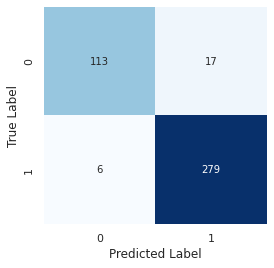


Ejemplo de predicciones:  piano
True label:  [0 0 0 0 0 0 0 1 0 0]
Predicted:   [[0.01334686 0.01927159 0.023777   0.06272493 0.01637379 0.00720274
  0.01994234 0.59851944 0.9611887  0.01033703]]
Epoch 1/200
11/11 [==============================] - 1s 18ms/step - loss: 0.6731 - accuracy: 0.6605 - val_loss: 0.6499 - val_accuracy: 0.6867
Epoch 2/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6413 - accuracy: 0.6782 - val_loss: 0.6238 - val_accuracy: 0.6867
Epoch 3/200
11/11 [==============================] - 0s 10ms/step - loss: 0.6284 - accuracy: 0.6782 - val_loss: 0.6152 - val_accuracy: 0.6867
Epoch 4/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6312 - accuracy: 0.6782 - val_loss: 0.6117 - val_accuracy: 0.6867
Epoch 5/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6208 - accuracy: 0.6782 - val_loss: 0.6086 - val_accuracy: 0.6867
Epoch 6/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6142 - accuracy: 0.67

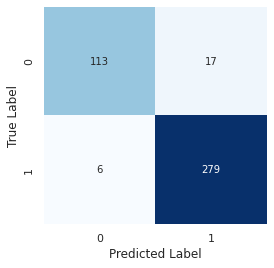


Ejemplo de predicciones:  piano
True label:  [0 0 0 0 0 0 0 1 0 0]
Predicted:   [[0.01193338 0.01494193 0.02303271 0.04152493 0.01243223 0.00491492
  0.01620214 0.6306555  0.9572699  0.00689831]]
Epoch 1/200
11/11 [==============================] - 1s 18ms/step - loss: 0.6708 - accuracy: 0.6743 - val_loss: 0.6433 - val_accuracy: 0.6867
Epoch 2/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6353 - accuracy: 0.6782 - val_loss: 0.6168 - val_accuracy: 0.6867
Epoch 3/200
11/11 [==============================] - 0s 10ms/step - loss: 0.6218 - accuracy: 0.6782 - val_loss: 0.6101 - val_accuracy: 0.6867
Epoch 4/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6149 - accuracy: 0.6782 - val_loss: 0.6062 - val_accuracy: 0.6867
Epoch 5/200
11/11 [==============================] - 0s 9ms/step - loss: 0.6158 - accuracy: 0.6782 - val_loss: 0.6026 - val_accuracy: 0.6867
Epoch 6/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6130 - accuracy: 0.67

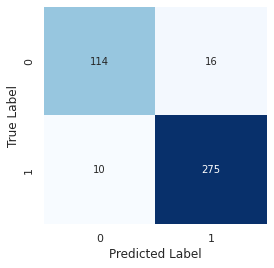


Ejemplo de predicciones:  piano
True label:  [0 0 0 0 0 0 0 1 0 0]
Predicted:   [[0.01283219 0.01559181 0.01829106 0.03485834 0.01479923 0.00665879
  0.01667118 0.3538628  0.9114955  0.00844136]]
Epoch 1/200
14/14 [==============================] - 1s 17ms/step - loss: 0.6929 - accuracy: 0.5202 - val_loss: 0.6924 - val_accuracy: 0.5119
Epoch 2/200
14/14 [==============================] - 0s 8ms/step - loss: 0.6923 - accuracy: 0.5242 - val_loss: 0.6914 - val_accuracy: 0.5151
Epoch 3/200
14/14 [==============================] - 0s 6ms/step - loss: 0.6899 - accuracy: 0.5415 - val_loss: 0.6908 - val_accuracy: 0.5151
Epoch 4/200
14/14 [==============================] - 0s 8ms/step - loss: 0.6897 - accuracy: 0.5397 - val_loss: 0.6898 - val_accuracy: 0.5151
Epoch 5/200
14/14 [==============================] - 0s 8ms/step - loss: 0.6890 - accuracy: 0.5438 - val_loss: 0.6884 - val_accuracy: 0.5151
Epoch 6/200
14/14 [==============================] - 0s 8ms/step - loss: 0.6875 - accuracy: 0.558

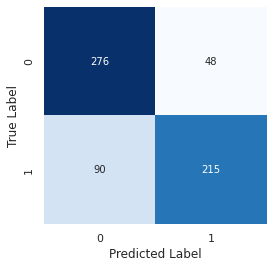


Ejemplo de predicciones:  saxophone
True label:  [0 1 0 0 0 0 0 0 0 1]
Predicted:   [[0.24347591 0.46816507 0.01689208 0.01452555 0.30162838 0.02454246
  0.14854068 0.20180155 0.29061663 0.33715278]]
Epoch 1/200
14/14 [==============================] - 1s 23ms/step - loss: 0.6939 - accuracy: 0.4988 - val_loss: 0.6926 - val_accuracy: 0.5151
Epoch 2/200
14/14 [==============================] - 0s 13ms/step - loss: 0.6931 - accuracy: 0.5035 - val_loss: 0.6918 - val_accuracy: 0.5151
Epoch 3/200
14/14 [==============================] - 0s 10ms/step - loss: 0.6925 - accuracy: 0.5190 - val_loss: 0.6912 - val_accuracy: 0.5151
Epoch 4/200
14/14 [==============================] - 0s 15ms/step - loss: 0.6915 - accuracy: 0.5271 - val_loss: 0.6906 - val_accuracy: 0.5151
Epoch 5/200
14/14 [==============================] - 0s 11ms/step - loss: 0.6910 - accuracy: 0.5282 - val_loss: 0.6902 - val_accuracy: 0.5151
Epoch 6/200
14/14 [==============================] - 0s 10ms/step - loss: 0.6903 - accura

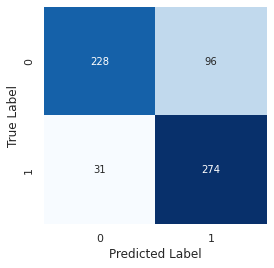


Ejemplo de predicciones:  saxophone
True label:  [0 1 0 0 0 0 0 0 0 1]
Predicted:   [[0.43015635 0.7787774  0.05046477 0.02531306 0.68760914 0.0349299
  0.3119128  0.41756523 0.45426682 0.64775795]]
Epoch 1/200
14/14 [==============================] - 1s 22ms/step - loss: 0.6919 - accuracy: 0.5156 - val_loss: 0.6903 - val_accuracy: 0.5167
Epoch 2/200
14/14 [==============================] - 0s 8ms/step - loss: 0.6910 - accuracy: 0.5334 - val_loss: 0.6892 - val_accuracy: 0.5151
Epoch 3/200
14/14 [==============================] - 0s 8ms/step - loss: 0.6898 - accuracy: 0.5386 - val_loss: 0.6881 - val_accuracy: 0.5167
Epoch 4/200
14/14 [==============================] - 0s 8ms/step - loss: 0.6890 - accuracy: 0.5253 - val_loss: 0.6871 - val_accuracy: 0.5151
Epoch 5/200
14/14 [==============================] - 0s 7ms/step - loss: 0.6871 - accuracy: 0.5426 - val_loss: 0.6858 - val_accuracy: 0.5151
Epoch 6/200
14/14 [==============================] - 0s 8ms/step - loss: 0.6871 - accuracy: 0.

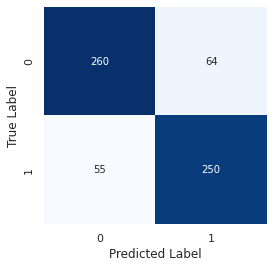


Ejemplo de predicciones:  saxophone
True label:  [0 1 0 0 0 0 0 0 0 1]
Predicted:   [[0.31307983 0.6844763  0.02345865 0.02098391 0.64431655 0.01832111
  0.20400788 0.27750692 0.29048598 0.52685916]]
Epoch 1/200
14/14 [==============================] - 1s 21ms/step - loss: 0.6929 - accuracy: 0.5075 - val_loss: 0.6914 - val_accuracy: 0.5167
Epoch 2/200
14/14 [==============================] - 0s 7ms/step - loss: 0.6915 - accuracy: 0.5196 - val_loss: 0.6902 - val_accuracy: 0.5151
Epoch 3/200
14/14 [==============================] - 0s 8ms/step - loss: 0.6913 - accuracy: 0.5317 - val_loss: 0.6893 - val_accuracy: 0.5151
Epoch 4/200
14/14 [==============================] - 0s 7ms/step - loss: 0.6887 - accuracy: 0.5455 - val_loss: 0.6878 - val_accuracy: 0.5151
Epoch 5/200
14/14 [==============================] - 0s 8ms/step - loss: 0.6879 - accuracy: 0.5300 - val_loss: 0.6866 - val_accuracy: 0.5151
Epoch 6/200
14/14 [==============================] - 0s 7ms/step - loss: 0.6877 - accuracy: 0

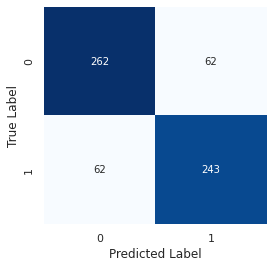


Ejemplo de predicciones:  saxophone
True label:  [0 1 0 0 0 0 0 0 0 1]
Predicted:   [[0.24070653 0.62792027 0.02179239 0.01343624 0.39311093 0.0219896
  0.14045452 0.23901187 0.33200765 0.5028901 ]]
Epoch 1/200
14/14 [==============================] - 1s 17ms/step - loss: 0.6917 - accuracy: 0.5236 - val_loss: 0.6911 - val_accuracy: 0.5151
Epoch 2/200
14/14 [==============================] - 0s 8ms/step - loss: 0.6918 - accuracy: 0.5179 - val_loss: 0.6900 - val_accuracy: 0.5151
Epoch 3/200
14/14 [==============================] - 0s 7ms/step - loss: 0.6900 - accuracy: 0.5438 - val_loss: 0.6886 - val_accuracy: 0.5151
Epoch 4/200
14/14 [==============================] - 0s 7ms/step - loss: 0.6895 - accuracy: 0.5392 - val_loss: 0.6873 - val_accuracy: 0.5167
Epoch 5/200
14/14 [==============================] - 0s 7ms/step - loss: 0.6870 - accuracy: 0.5605 - val_loss: 0.6861 - val_accuracy: 0.5151
Epoch 6/200
14/14 [==============================] - 0s 8ms/step - loss: 0.6859 - accuracy: 0.

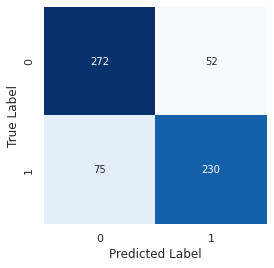


Ejemplo de predicciones:  saxophone
True label:  [0 1 0 0 0 0 0 0 0 1]
Predicted:   [[0.26400355 0.59897494 0.01987639 0.01629273 0.32447782 0.02221945
  0.12456615 0.17653923 0.17258967 0.4730255 ]]
Epoch 1/200
10/10 [==============================] - 1s 28ms/step - loss: 0.6802 - accuracy: 0.6391 - val_loss: 0.6546 - val_accuracy: 0.7053
Epoch 2/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6509 - accuracy: 0.6735 - val_loss: 0.6182 - val_accuracy: 0.7053
Epoch 3/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6326 - accuracy: 0.6735 - val_loss: 0.6058 - val_accuracy: 0.7053
Epoch 4/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6280 - accuracy: 0.6735 - val_loss: 0.6006 - val_accuracy: 0.7053
Epoch 5/200
10/10 [==============================] - 0s 10ms/step - loss: 0.6242 - accuracy: 0.6735 - val_loss: 0.5979 - val_accuracy: 0.7053
Epoch 6/200
10/10 [==============================] - 0s 10ms/step - loss: 0.6247 - accuracy:

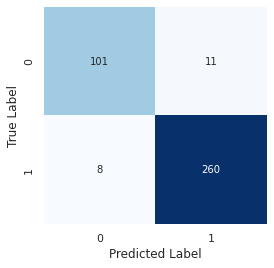


Ejemplo de predicciones:  synthesizer
True label:  [1 1 1 1 1 0 1 1 1 1]
Predicted:   [[0.66868013 0.9938106  0.9977769  0.85618573 0.9878671  0.22260973
  0.9966049  0.9957035  0.99934286 0.98708713]]
Epoch 1/200
10/10 [==============================] - 1s 29ms/step - loss: 0.6859 - accuracy: 0.5933 - val_loss: 0.6636 - val_accuracy: 0.7053
Epoch 2/200
10/10 [==============================] - 0s 12ms/step - loss: 0.6578 - accuracy: 0.6735 - val_loss: 0.6323 - val_accuracy: 0.7053
Epoch 3/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6394 - accuracy: 0.6735 - val_loss: 0.6144 - val_accuracy: 0.7053
Epoch 4/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6326 - accuracy: 0.6735 - val_loss: 0.6062 - val_accuracy: 0.7053
Epoch 5/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6295 - accuracy: 0.6735 - val_loss: 0.6021 - val_accuracy: 0.7053
Epoch 6/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6245 - accuracy

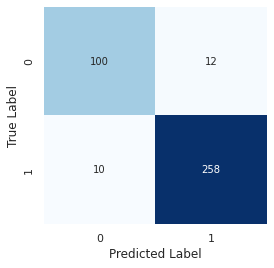


Ejemplo de predicciones:  synthesizer
True label:  [1 1 1 1 1 0 1 1 1 1]
Predicted:   [[0.53966326 0.99021614 0.99551433 0.8187071  0.9822067  0.24597825
  0.99449086 0.99131256 0.9983565  0.98359895]]
Epoch 1/200
10/10 [==============================] - 1s 31ms/step - loss: 0.6826 - accuracy: 0.6178 - val_loss: 0.6615 - val_accuracy: 0.7053
Epoch 2/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6575 - accuracy: 0.6735 - val_loss: 0.6310 - val_accuracy: 0.7053
Epoch 3/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6386 - accuracy: 0.6735 - val_loss: 0.6125 - val_accuracy: 0.7053
Epoch 4/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6336 - accuracy: 0.6735 - val_loss: 0.6057 - val_accuracy: 0.7053
Epoch 5/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6291 - accuracy: 0.6735 - val_loss: 0.6029 - val_accuracy: 0.7053
Epoch 6/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6266 - accuracy:

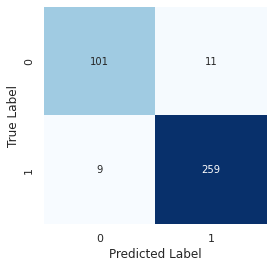


Ejemplo de predicciones:  synthesizer
True label:  [1 1 1 1 1 0 1 1 1 1]
Predicted:   [[0.68101335 0.99398583 0.9982115  0.8914689  0.9842195  0.26202694
  0.99746513 0.9960359  0.99970275 0.98817885]]
Epoch 1/200
10/10 [==============================] - 1s 36ms/step - loss: 0.6906 - accuracy: 0.5368 - val_loss: 0.6661 - val_accuracy: 0.7053
Epoch 2/200
10/10 [==============================] - 0s 11ms/step - loss: 0.6611 - accuracy: 0.6735 - val_loss: 0.6343 - val_accuracy: 0.7053
Epoch 3/200
10/10 [==============================] - 0s 12ms/step - loss: 0.6447 - accuracy: 0.6735 - val_loss: 0.6179 - val_accuracy: 0.7053
Epoch 4/200
10/10 [==============================] - 0s 12ms/step - loss: 0.6334 - accuracy: 0.6735 - val_loss: 0.6101 - val_accuracy: 0.7053
Epoch 5/200
10/10 [==============================] - 0s 13ms/step - loss: 0.6298 - accuracy: 0.6735 - val_loss: 0.6063 - val_accuracy: 0.7053
Epoch 6/200
10/10 [==============================] - 0s 14ms/step - loss: 0.6290 - accu

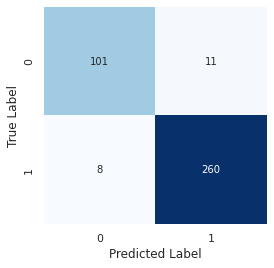


Ejemplo de predicciones:  synthesizer
True label:  [1 1 1 1 1 0 1 1 1 1]
Predicted:   [[0.6573081  0.99247557 0.9959617  0.9054735  0.98544854 0.31039435
  0.9940764  0.9930763  0.99849296 0.98497796]]
Epoch 1/200
10/10 [==============================] - 1s 21ms/step - loss: 0.6890 - accuracy: 0.5606 - val_loss: 0.6708 - val_accuracy: 0.7053
Epoch 2/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6657 - accuracy: 0.6735 - val_loss: 0.6438 - val_accuracy: 0.7053
Epoch 3/200
10/10 [==============================] - 0s 7ms/step - loss: 0.6463 - accuracy: 0.6735 - val_loss: 0.6242 - val_accuracy: 0.7053
Epoch 4/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6333 - accuracy: 0.6735 - val_loss: 0.6124 - val_accuracy: 0.7053
Epoch 5/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6303 - accuracy: 0.6735 - val_loss: 0.6065 - val_accuracy: 0.7053
Epoch 6/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6268 - accuracy:

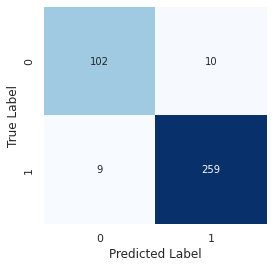


Ejemplo de predicciones:  synthesizer
True label:  [1 1 1 1 1 0 1 1 1 1]
Predicted:   [[0.61068726 0.9896163  0.99519926 0.91092813 0.9842217  0.22178198
  0.994706   0.99156183 0.998381   0.98095083]]
Epoch 1/200
16/16 [==============================] - 1s 18ms/step - loss: 0.6739 - accuracy: 0.6333 - val_loss: 0.6467 - val_accuracy: 0.6833
Epoch 2/200
16/16 [==============================] - 0s 7ms/step - loss: 0.6332 - accuracy: 0.6887 - val_loss: 0.6251 - val_accuracy: 0.6833
Epoch 3/200
16/16 [==============================] - 0s 7ms/step - loss: 0.6211 - accuracy: 0.6887 - val_loss: 0.6229 - val_accuracy: 0.6833
Epoch 4/200
16/16 [==============================] - 0s 7ms/step - loss: 0.6229 - accuracy: 0.6887 - val_loss: 0.6222 - val_accuracy: 0.6833
Epoch 5/200
16/16 [==============================] - 0s 7ms/step - loss: 0.6230 - accuracy: 0.6887 - val_loss: 0.6214 - val_accuracy: 0.6833
Epoch 6/200
16/16 [==============================] - 0s 8ms/step - loss: 0.6192 - accuracy:

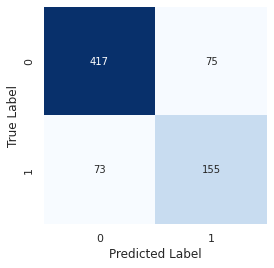


Ejemplo de predicciones:  trombone
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.0272826  0.41644922 0.14558315 0.08380381 0.7499729  0.18481477
  0.2955777  0.00351025 0.1719139  0.00518291]]
Epoch 1/200
16/16 [==============================] - 1s 19ms/step - loss: 0.6689 - accuracy: 0.6745 - val_loss: 0.6406 - val_accuracy: 0.6833
Epoch 2/200
16/16 [==============================] - 0s 8ms/step - loss: 0.6283 - accuracy: 0.6887 - val_loss: 0.6238 - val_accuracy: 0.6833
Epoch 3/200
16/16 [==============================] - 0s 7ms/step - loss: 0.6233 - accuracy: 0.6887 - val_loss: 0.6226 - val_accuracy: 0.6833
Epoch 4/200
16/16 [==============================] - 0s 7ms/step - loss: 0.6231 - accuracy: 0.6887 - val_loss: 0.6214 - val_accuracy: 0.6833
Epoch 5/200
16/16 [==============================] - 0s 7ms/step - loss: 0.6182 - accuracy: 0.6887 - val_loss: 0.6205 - val_accuracy: 0.6833
Epoch 6/200
16/16 [==============================] - 0s 7ms/step - loss: 0.6185 - accuracy: 0.

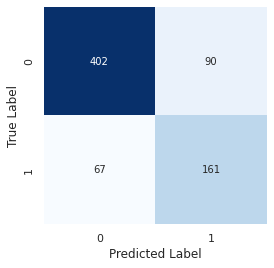


Ejemplo de predicciones:  trombone
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.0336828  0.5192528  0.206662   0.06436034 0.8030661  0.32528177
  0.2571223  0.00229683 0.23305164 0.00261716]]
Epoch 1/200
16/16 [==============================] - 1s 22ms/step - loss: 0.6744 - accuracy: 0.6172 - val_loss: 0.6440 - val_accuracy: 0.6833
Epoch 2/200
16/16 [==============================] - 0s 7ms/step - loss: 0.6302 - accuracy: 0.6887 - val_loss: 0.6244 - val_accuracy: 0.6833
Epoch 3/200
16/16 [==============================] - 0s 8ms/step - loss: 0.6238 - accuracy: 0.6887 - val_loss: 0.6233 - val_accuracy: 0.6833
Epoch 4/200
16/16 [==============================] - 0s 7ms/step - loss: 0.6229 - accuracy: 0.6887 - val_loss: 0.6225 - val_accuracy: 0.6833
Epoch 5/200
16/16 [==============================] - 0s 7ms/step - loss: 0.6217 - accuracy: 0.6887 - val_loss: 0.6215 - val_accuracy: 0.6833
Epoch 6/200
16/16 [==============================] - 0s 7ms/step - loss: 0.6206 - accuracy: 0.

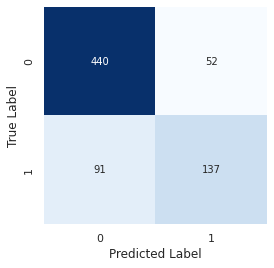


Ejemplo de predicciones:  trombone
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.02197436 0.34817082 0.10198531 0.06342967 0.6459582  0.11702944
  0.13179058 0.00256    0.11631081 0.00285907]]
Epoch 1/200
16/16 [==============================] - 1s 16ms/step - loss: 0.6705 - accuracy: 0.6525 - val_loss: 0.6427 - val_accuracy: 0.6833
Epoch 2/200
16/16 [==============================] - 0s 8ms/step - loss: 0.6322 - accuracy: 0.6887 - val_loss: 0.6250 - val_accuracy: 0.6833
Epoch 3/200
16/16 [==============================] - 0s 7ms/step - loss: 0.6260 - accuracy: 0.6887 - val_loss: 0.6237 - val_accuracy: 0.6833
Epoch 4/200
16/16 [==============================] - 0s 8ms/step - loss: 0.6210 - accuracy: 0.6887 - val_loss: 0.6231 - val_accuracy: 0.6833
Epoch 5/200
16/16 [==============================] - 0s 7ms/step - loss: 0.6215 - accuracy: 0.6887 - val_loss: 0.6227 - val_accuracy: 0.6833
Epoch 6/200
16/16 [==============================] - 0s 7ms/step - loss: 0.6211 - accuracy: 0.

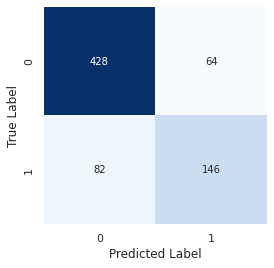


Ejemplo de predicciones:  trombone
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.01881243 0.42522088 0.08461547 0.04647331 0.77930224 0.20362873
  0.11076637 0.00194531 0.11717059 0.00217723]]
Epoch 1/200
16/16 [==============================] - 1s 15ms/step - loss: 0.6696 - accuracy: 0.6475 - val_loss: 0.6423 - val_accuracy: 0.6833
Epoch 2/200
16/16 [==============================] - 0s 7ms/step - loss: 0.6326 - accuracy: 0.6887 - val_loss: 0.6233 - val_accuracy: 0.6833
Epoch 3/200
16/16 [==============================] - 0s 7ms/step - loss: 0.6234 - accuracy: 0.6887 - val_loss: 0.6224 - val_accuracy: 0.6833
Epoch 4/200
16/16 [==============================] - 0s 10ms/step - loss: 0.6206 - accuracy: 0.6887 - val_loss: 0.6218 - val_accuracy: 0.6833
Epoch 5/200
16/16 [==============================] - 0s 7ms/step - loss: 0.6217 - accuracy: 0.6887 - val_loss: 0.6214 - val_accuracy: 0.6833
Epoch 6/200
16/16 [==============================] - 0s 7ms/step - loss: 0.6168 - accuracy: 0

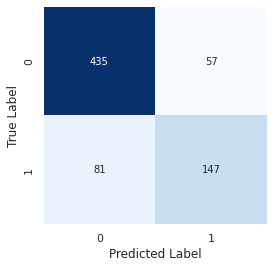


Ejemplo de predicciones:  trombone
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.01789876 0.34654418 0.11559962 0.05305332 0.6827824  0.14987361
  0.21838291 0.00120802 0.10959438 0.00166209]]
Epoch 1/200
17/17 [==============================] - 1s 20ms/step - loss: 0.6862 - accuracy: 0.5753 - val_loss: 0.6781 - val_accuracy: 0.5949
Epoch 2/200
17/17 [==============================] - 0s 8ms/step - loss: 0.6707 - accuracy: 0.6115 - val_loss: 0.6748 - val_accuracy: 0.5949
Epoch 3/200
17/17 [==============================] - 0s 7ms/step - loss: 0.6697 - accuracy: 0.6115 - val_loss: 0.6744 - val_accuracy: 0.5949
Epoch 4/200
17/17 [==============================] - 0s 7ms/step - loss: 0.6697 - accuracy: 0.6115 - val_loss: 0.6735 - val_accuracy: 0.5949
Epoch 5/200
17/17 [==============================] - 0s 8ms/step - loss: 0.6670 - accuracy: 0.6115 - val_loss: 0.6732 - val_accuracy: 0.5949
Epoch 6/200
17/17 [==============================] - 0s 10ms/step - loss: 0.6670 - accuracy: 0

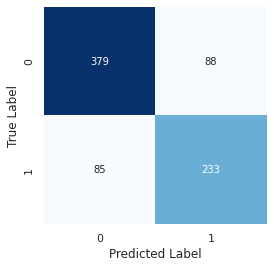


Ejemplo de predicciones:  trumpet
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.05945159 0.07392932 0.1079852  0.370364   0.88100046 0.52930963
  0.01134451 0.67258555 0.03645639 0.03798454]]
Epoch 1/200
17/17 [==============================] - 1s 19ms/step - loss: 0.6818 - accuracy: 0.5828 - val_loss: 0.6746 - val_accuracy: 0.5949
Epoch 2/200
17/17 [==============================] - 0s 7ms/step - loss: 0.6690 - accuracy: 0.6115 - val_loss: 0.6739 - val_accuracy: 0.5949
Epoch 3/200
17/17 [==============================] - 0s 7ms/step - loss: 0.6669 - accuracy: 0.6115 - val_loss: 0.6719 - val_accuracy: 0.5949
Epoch 4/200
17/17 [==============================] - 0s 7ms/step - loss: 0.6658 - accuracy: 0.6115 - val_loss: 0.6709 - val_accuracy: 0.5949
Epoch 5/200
17/17 [==============================] - 0s 11ms/step - loss: 0.6649 - accuracy: 0.6115 - val_loss: 0.6698 - val_accuracy: 0.5949
Epoch 6/200
17/17 [==============================] - 0s 10ms/step - loss: 0.6644 - accuracy: 0

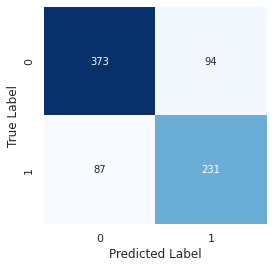


Ejemplo de predicciones:  trumpet
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.07494369 0.07321712 0.15669347 0.406646   0.8809383  0.49677265
  0.00685339 0.7492403  0.03315372 0.03178973]]
Epoch 1/200
17/17 [==============================] - 1s 15ms/step - loss: 0.6818 - accuracy: 0.5805 - val_loss: 0.6744 - val_accuracy: 0.5949
Epoch 2/200
17/17 [==============================] - 0s 7ms/step - loss: 0.6674 - accuracy: 0.6115 - val_loss: 0.6734 - val_accuracy: 0.5949
Epoch 3/200
17/17 [==============================] - 0s 7ms/step - loss: 0.6674 - accuracy: 0.6115 - val_loss: 0.6718 - val_accuracy: 0.5949
Epoch 4/200
17/17 [==============================] - 0s 9ms/step - loss: 0.6655 - accuracy: 0.6115 - val_loss: 0.6703 - val_accuracy: 0.5949
Epoch 5/200
17/17 [==============================] - 0s 8ms/step - loss: 0.6656 - accuracy: 0.6115 - val_loss: 0.6690 - val_accuracy: 0.5949
Epoch 6/200
17/17 [==============================] - 0s 8ms/step - loss: 0.6622 - accuracy: 0.6

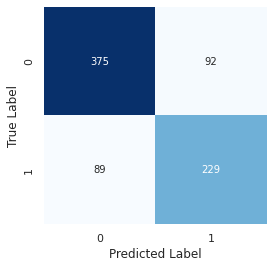


Ejemplo de predicciones:  trumpet
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.04344985 0.07058918 0.11713286 0.37346634 0.87575406 0.5980924
  0.00761829 0.67061025 0.02462673 0.04314351]]
Epoch 1/200
17/17 [==============================] - 1s 20ms/step - loss: 0.6859 - accuracy: 0.5523 - val_loss: 0.6792 - val_accuracy: 0.5949
Epoch 2/200
17/17 [==============================] - 0s 7ms/step - loss: 0.6707 - accuracy: 0.6115 - val_loss: 0.6748 - val_accuracy: 0.5949
Epoch 3/200
17/17 [==============================] - 0s 7ms/step - loss: 0.6686 - accuracy: 0.6115 - val_loss: 0.6747 - val_accuracy: 0.5949
Epoch 4/200
17/17 [==============================] - 0s 8ms/step - loss: 0.6674 - accuracy: 0.6115 - val_loss: 0.6740 - val_accuracy: 0.5949
Epoch 5/200
17/17 [==============================] - 0s 7ms/step - loss: 0.6668 - accuracy: 0.6115 - val_loss: 0.6732 - val_accuracy: 0.5949
Epoch 6/200
17/17 [==============================] - 0s 7ms/step - loss: 0.6669 - accuracy: 0.61

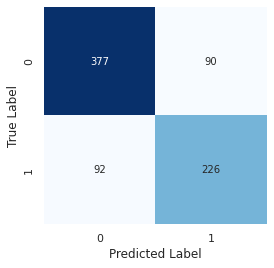


Ejemplo de predicciones:  trumpet
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.08322319 0.09046607 0.11323901 0.29138067 0.8888829  0.421029
  0.00856249 0.7159815  0.03523927 0.04873768]]
Epoch 1/200
17/17 [==============================] - 1s 14ms/step - loss: 0.6894 - accuracy: 0.5378 - val_loss: 0.6784 - val_accuracy: 0.5949
Epoch 2/200
17/17 [==============================] - 0s 6ms/step - loss: 0.6714 - accuracy: 0.6115 - val_loss: 0.6742 - val_accuracy: 0.5949
Epoch 3/200
17/17 [==============================] - 0s 7ms/step - loss: 0.6673 - accuracy: 0.6115 - val_loss: 0.6742 - val_accuracy: 0.5949
Epoch 4/200
17/17 [==============================] - 0s 7ms/step - loss: 0.6665 - accuracy: 0.6115 - val_loss: 0.6736 - val_accuracy: 0.5949
Epoch 5/200
17/17 [==============================] - 0s 8ms/step - loss: 0.6663 - accuracy: 0.6115 - val_loss: 0.6723 - val_accuracy: 0.5949
Epoch 6/200
17/17 [==============================] - 0s 7ms/step - loss: 0.6663 - accuracy: 0.611

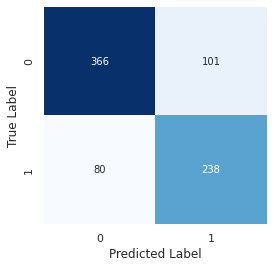


Ejemplo de predicciones:  trumpet
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.08668502 0.0880257  0.12744042 0.41909796 0.9004162  0.5840146
  0.01216247 0.76733696 0.03778553 0.03864343]]
Epoch 1/200
15/15 [==============================] - 1s 54ms/step - loss: 0.6735 - accuracy: 0.6599 - val_loss: 0.6452 - val_accuracy: 0.6915
Epoch 2/200
15/15 [==============================] - 0s 8ms/step - loss: 0.6317 - accuracy: 0.6970 - val_loss: 0.6201 - val_accuracy: 0.6915
Epoch 3/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6171 - accuracy: 0.6970 - val_loss: 0.6162 - val_accuracy: 0.6915
Epoch 4/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6157 - accuracy: 0.6970 - val_loss: 0.6150 - val_accuracy: 0.6915
Epoch 5/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6144 - accuracy: 0.6970 - val_loss: 0.6140 - val_accuracy: 0.6915
Epoch 6/200
15/15 [==============================] - 0s 8ms/step - loss: 0.6076 - accuracy: 0.69

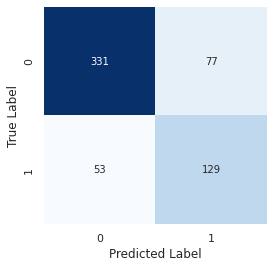


Ejemplo de predicciones:  ukulele
True label:  [1 0 0 0 0 1 0 0 0 0]
Predicted:   [[7.3567832e-01 1.3774212e-02 2.9022437e-02 6.5807238e-02 5.4338634e-01
  5.3429729e-01 3.6687360e-04 3.2414214e-04 9.7092462e-04 3.5553825e-01]]
Epoch 1/200
15/15 [==============================] - 1s 17ms/step - loss: 0.6755 - accuracy: 0.6098 - val_loss: 0.6448 - val_accuracy: 0.6915
Epoch 2/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6284 - accuracy: 0.6970 - val_loss: 0.6193 - val_accuracy: 0.6915
Epoch 3/200
15/15 [==============================] - 0s 8ms/step - loss: 0.6157 - accuracy: 0.6970 - val_loss: 0.6169 - val_accuracy: 0.6915
Epoch 4/200
15/15 [==============================] - 0s 10ms/step - loss: 0.6115 - accuracy: 0.6970 - val_loss: 0.6167 - val_accuracy: 0.6915
Epoch 5/200
15/15 [==============================] - 0s 8ms/step - loss: 0.6179 - accuracy: 0.6970 - val_loss: 0.6158 - val_accuracy: 0.6915
Epoch 6/200
15/15 [==============================] - 0s 7ms/step

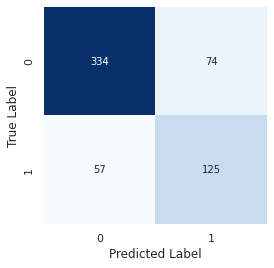


Ejemplo de predicciones:  ukulele
True label:  [1 0 0 0 0 1 0 0 0 0]
Predicted:   [[7.1881181e-01 1.6217282e-02 3.6687914e-02 8.3787262e-02 4.5026278e-01
  4.8708719e-01 5.2783149e-04 6.3887809e-04 1.0720391e-03 5.0976837e-01]]
Epoch 1/200
15/15 [==============================] - 1s 17ms/step - loss: 0.6820 - accuracy: 0.5842 - val_loss: 0.6507 - val_accuracy: 0.6915
Epoch 2/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6328 - accuracy: 0.6970 - val_loss: 0.6235 - val_accuracy: 0.6915
Epoch 3/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6187 - accuracy: 0.6970 - val_loss: 0.6179 - val_accuracy: 0.6915
Epoch 4/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6190 - accuracy: 0.6970 - val_loss: 0.6172 - val_accuracy: 0.6915
Epoch 5/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6153 - accuracy: 0.6970 - val_loss: 0.6167 - val_accuracy: 0.6915
Epoch 6/200
15/15 [==============================] - 0s 7ms/step 

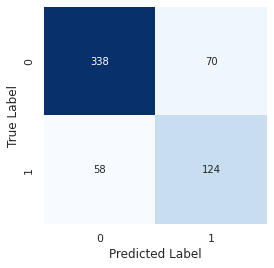


Ejemplo de predicciones:  ukulele
True label:  [1 0 0 0 0 1 0 0 0 0]
Predicted:   [[7.3344380e-01 9.9323150e-03 2.7737215e-02 7.5796142e-02 5.1346600e-01
  5.3860450e-01 3.9665669e-04 4.0102261e-04 8.2996592e-04 4.9094820e-01]]
Epoch 1/200
15/15 [==============================] - 1s 17ms/step - loss: 0.6720 - accuracy: 0.6196 - val_loss: 0.6346 - val_accuracy: 0.6915
Epoch 2/200
15/15 [==============================] - 0s 8ms/step - loss: 0.6244 - accuracy: 0.6970 - val_loss: 0.6180 - val_accuracy: 0.6915
Epoch 3/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6173 - accuracy: 0.6970 - val_loss: 0.6158 - val_accuracy: 0.6915
Epoch 4/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6121 - accuracy: 0.6970 - val_loss: 0.6143 - val_accuracy: 0.6915
Epoch 5/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6076 - accuracy: 0.6970 - val_loss: 0.6130 - val_accuracy: 0.6915
Epoch 6/200
15/15 [==============================] - 0s 8ms/step 

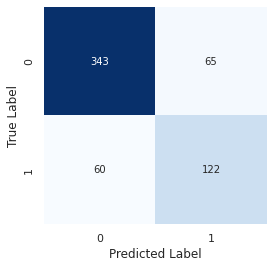


Ejemplo de predicciones:  ukulele
True label:  [1 0 0 0 0 1 0 0 0 0]
Predicted:   [[7.3008740e-01 8.0811447e-03 3.3231817e-02 6.1058093e-02 4.5190921e-01
  5.1704490e-01 1.7858212e-04 2.0123563e-04 3.9678902e-04 4.0880498e-01]]
Epoch 1/200
15/15 [==============================] - 1s 16ms/step - loss: 0.6648 - accuracy: 0.6654 - val_loss: 0.6383 - val_accuracy: 0.6915
Epoch 2/200
15/15 [==============================] - 0s 8ms/step - loss: 0.6227 - accuracy: 0.6970 - val_loss: 0.6173 - val_accuracy: 0.6915
Epoch 3/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6155 - accuracy: 0.6970 - val_loss: 0.6160 - val_accuracy: 0.6915
Epoch 4/200
15/15 [==============================] - 0s 8ms/step - loss: 0.6101 - accuracy: 0.6970 - val_loss: 0.6152 - val_accuracy: 0.6915
Epoch 5/200
15/15 [==============================] - 0s 7ms/step - loss: 0.6152 - accuracy: 0.6970 - val_loss: 0.6143 - val_accuracy: 0.6915
Epoch 6/200
15/15 [==============================] - 0s 7ms/step 

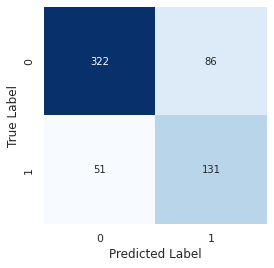


Ejemplo de predicciones:  ukulele
True label:  [1 0 0 0 0 1 0 0 0 0]
Predicted:   [[7.3025560e-01 1.2958560e-02 3.4663357e-02 8.3537385e-02 5.1836568e-01
  5.2768594e-01 1.9778665e-04 2.8443441e-04 4.9912458e-04 5.3488946e-01]]
Epoch 1/200
11/11 [==============================] - 1s 20ms/step - loss: 0.6917 - accuracy: 0.5292 - val_loss: 0.6819 - val_accuracy: 0.6244
Epoch 2/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6875 - accuracy: 0.5563 - val_loss: 0.6740 - val_accuracy: 0.6244
Epoch 3/200
11/11 [==============================] - 0s 12ms/step - loss: 0.6855 - accuracy: 0.5556 - val_loss: 0.6685 - val_accuracy: 0.6244
Epoch 4/200
11/11 [==============================] - 0s 9ms/step - loss: 0.6846 - accuracy: 0.5556 - val_loss: 0.6663 - val_accuracy: 0.6244
Epoch 5/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6830 - accuracy: 0.5556 - val_loss: 0.6652 - val_accuracy: 0.6244
Epoch 6/200
11/11 [==============================] - 0s 7ms/step

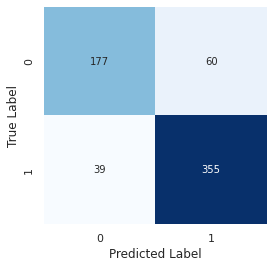


Ejemplo de predicciones:  violin
True label:  [0 0 1 0 0 0 0 0 0 1]
Predicted:   [[0.4722174  0.86410815 0.7617177  0.1903895  0.91961485 0.00731986
  0.01030778 0.00527762 0.02773486 0.9065499 ]]
Epoch 1/200
11/11 [==============================] - 1s 25ms/step - loss: 0.6910 - accuracy: 0.5506 - val_loss: 0.6834 - val_accuracy: 0.6244
Epoch 2/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6871 - accuracy: 0.5571 - val_loss: 0.6759 - val_accuracy: 0.6244
Epoch 3/200
11/11 [==============================] - 0s 9ms/step - loss: 0.6864 - accuracy: 0.5556 - val_loss: 0.6711 - val_accuracy: 0.6244
Epoch 4/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6853 - accuracy: 0.5563 - val_loss: 0.6686 - val_accuracy: 0.6244
Epoch 5/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6830 - accuracy: 0.5556 - val_loss: 0.6677 - val_accuracy: 0.6244
Epoch 6/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6836 - accuracy: 0.55

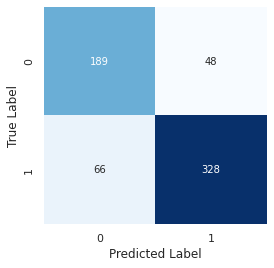


Ejemplo de predicciones:  violin
True label:  [0 0 1 0 0 0 0 0 0 1]
Predicted:   [[0.39539945 0.74791497 0.5630372  0.18404174 0.88254094 0.00317209
  0.00617136 0.00259412 0.01994296 0.8656985 ]]
Epoch 1/200
11/11 [==============================] - 1s 25ms/step - loss: 0.6936 - accuracy: 0.5057 - val_loss: 0.6869 - val_accuracy: 0.6244
Epoch 2/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6885 - accuracy: 0.5549 - val_loss: 0.6790 - val_accuracy: 0.6244
Epoch 3/200
11/11 [==============================] - 0s 9ms/step - loss: 0.6881 - accuracy: 0.5556 - val_loss: 0.6746 - val_accuracy: 0.6244
Epoch 4/200
11/11 [==============================] - 0s 10ms/step - loss: 0.6854 - accuracy: 0.5556 - val_loss: 0.6720 - val_accuracy: 0.6244
Epoch 5/200
11/11 [==============================] - 0s 7ms/step - loss: 0.6848 - accuracy: 0.5556 - val_loss: 0.6692 - val_accuracy: 0.6244
Epoch 6/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6852 - accuracy: 0.5

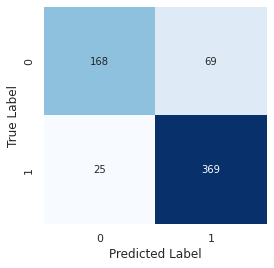


Ejemplo de predicciones:  violin
True label:  [0 0 1 0 0 0 0 0 0 1]
Predicted:   [[5.8994079e-01 8.8535178e-01 8.1755102e-01 3.4124517e-01 9.2501062e-01
  1.2693814e-03 1.8861955e-03 9.1995951e-04 1.2034760e-02 9.1231573e-01]]
Epoch 1/200
11/11 [==============================] - 1s 25ms/step - loss: 0.6937 - accuracy: 0.4943 - val_loss: 0.6872 - val_accuracy: 0.6244
Epoch 2/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6887 - accuracy: 0.5599 - val_loss: 0.6763 - val_accuracy: 0.6244
Epoch 3/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6856 - accuracy: 0.5585 - val_loss: 0.6696 - val_accuracy: 0.6244
Epoch 4/200
11/11 [==============================] - 0s 9ms/step - loss: 0.6849 - accuracy: 0.5549 - val_loss: 0.6669 - val_accuracy: 0.6244
Epoch 5/200
11/11 [==============================] - 0s 9ms/step - loss: 0.6830 - accuracy: 0.5571 - val_loss: 0.6646 - val_accuracy: 0.6244
Epoch 6/200
11/11 [==============================] - 0s 9ms/step -

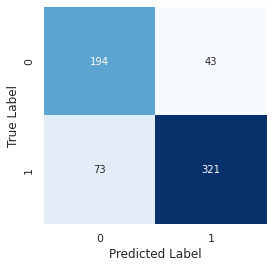


Ejemplo de predicciones:  violin
True label:  [0 0 1 0 0 0 0 0 0 1]
Predicted:   [[4.6391410e-01 7.4856192e-01 6.4926875e-01 8.9249000e-02 8.6057097e-01
  8.4496394e-04 1.2459655e-03 5.4866378e-04 5.2759955e-03 8.0233741e-01]]
Epoch 1/200
11/11 [==============================] - 1s 27ms/step - loss: 0.6903 - accuracy: 0.5442 - val_loss: 0.6817 - val_accuracy: 0.6244
Epoch 2/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6886 - accuracy: 0.5556 - val_loss: 0.6730 - val_accuracy: 0.6244
Epoch 3/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6868 - accuracy: 0.5556 - val_loss: 0.6690 - val_accuracy: 0.6244
Epoch 4/200
11/11 [==============================] - 0s 8ms/step - loss: 0.6832 - accuracy: 0.5556 - val_loss: 0.6676 - val_accuracy: 0.6244
Epoch 5/200
11/11 [==============================] - 0s 9ms/step - loss: 0.6828 - accuracy: 0.5556 - val_loss: 0.6667 - val_accuracy: 0.6244
Epoch 6/200
11/11 [==============================] - 0s 9ms/step -

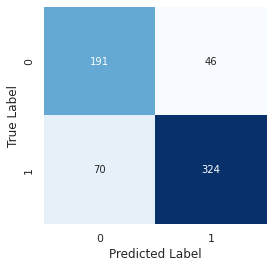


Ejemplo de predicciones:  violin
True label:  [0 0 1 0 0 0 0 0 0 1]
Predicted:   [[0.36535907 0.77948713 0.5665364  0.13316454 0.8366097  0.00292522
  0.00496712 0.00268813 0.01314013 0.85064566]]
Epoch 1/200
10/10 [==============================] - 1s 28ms/step - loss: 0.6884 - accuracy: 0.5504 - val_loss: 0.6805 - val_accuracy: 0.5989
Epoch 2/200
10/10 [==============================] - 0s 7ms/step - loss: 0.6678 - accuracy: 0.6412 - val_loss: 0.6700 - val_accuracy: 0.5989
Epoch 3/200
10/10 [==============================] - 0s 7ms/step - loss: 0.6570 - accuracy: 0.6420 - val_loss: 0.6683 - val_accuracy: 0.5989
Epoch 4/200
10/10 [==============================] - 0s 7ms/step - loss: 0.6489 - accuracy: 0.6420 - val_loss: 0.6687 - val_accuracy: 0.5989
Epoch 5/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6484 - accuracy: 0.6420 - val_loss: 0.6682 - val_accuracy: 0.5989
Epoch 6/200
10/10 [==============================] - 0s 10ms/step - loss: 0.6499 - accuracy: 0.6

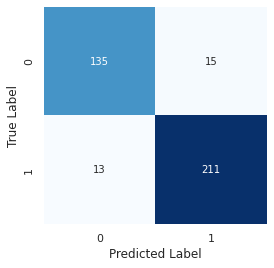


Ejemplo de predicciones:  voice
True label:  [1 0 1 1 1 1 1 0 1 1]
Predicted:   [[0.98555404 0.0124422  0.99843055 0.99237376 0.9980318  0.9826263
  0.99839574 0.00680791 0.98192203 0.99161375]]
Epoch 1/200
10/10 [==============================] - 1s 27ms/step - loss: 0.6930 - accuracy: 0.4992 - val_loss: 0.6834 - val_accuracy: 0.5989
Epoch 2/200
10/10 [==============================] - 0s 7ms/step - loss: 0.6723 - accuracy: 0.6429 - val_loss: 0.6730 - val_accuracy: 0.5989
Epoch 3/200
10/10 [==============================] - 0s 11ms/step - loss: 0.6580 - accuracy: 0.6420 - val_loss: 0.6705 - val_accuracy: 0.5989
Epoch 4/200
10/10 [==============================] - 0s 7ms/step - loss: 0.6534 - accuracy: 0.6420 - val_loss: 0.6701 - val_accuracy: 0.5989
Epoch 5/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6510 - accuracy: 0.6420 - val_loss: 0.6700 - val_accuracy: 0.5989
Epoch 6/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6480 - accuracy: 0.642

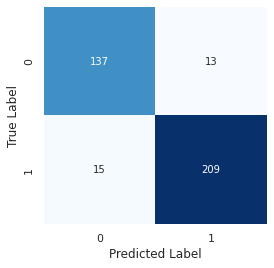


Ejemplo de predicciones:  voice
True label:  [1 0 1 1 1 1 1 0 1 1]
Predicted:   [[0.9717585  0.00364522 0.99354434 0.981261   0.99343514 0.9613158
  0.9939247  0.00113029 0.97489357 0.9839324 ]]
Epoch 1/200
10/10 [==============================] - 1s 28ms/step - loss: 0.6867 - accuracy: 0.5748 - val_loss: 0.6769 - val_accuracy: 0.5989
Epoch 2/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6633 - accuracy: 0.6420 - val_loss: 0.6694 - val_accuracy: 0.5989
Epoch 3/200
10/10 [==============================] - 0s 7ms/step - loss: 0.6515 - accuracy: 0.6420 - val_loss: 0.6693 - val_accuracy: 0.5989
Epoch 4/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6457 - accuracy: 0.6420 - val_loss: 0.6701 - val_accuracy: 0.5989
Epoch 5/200
10/10 [==============================] - 0s 7ms/step - loss: 0.6499 - accuracy: 0.6420 - val_loss: 0.6702 - val_accuracy: 0.5989
Epoch 6/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6471 - accuracy: 0.6420

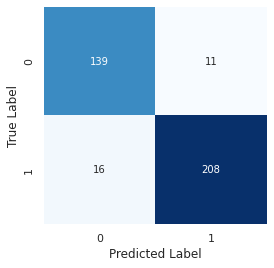


Ejemplo de predicciones:  voice
True label:  [1 0 1 1 1 1 1 0 1 1]
Predicted:   [[0.9755375  0.00970139 0.99672    0.9883653  0.9966246  0.9718283
  0.9954835  0.00464623 0.97873473 0.98786455]]
Epoch 1/200
10/10 [==============================] - 1s 27ms/step - loss: 0.6852 - accuracy: 0.5798 - val_loss: 0.6759 - val_accuracy: 0.5989
Epoch 2/200
10/10 [==============================] - 0s 7ms/step - loss: 0.6604 - accuracy: 0.6420 - val_loss: 0.6686 - val_accuracy: 0.5989
Epoch 3/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6492 - accuracy: 0.6420 - val_loss: 0.6699 - val_accuracy: 0.5989
Epoch 4/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6499 - accuracy: 0.6420 - val_loss: 0.6679 - val_accuracy: 0.5989
Epoch 5/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6411 - accuracy: 0.6420 - val_loss: 0.6630 - val_accuracy: 0.5989
Epoch 6/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6433 - accuracy: 0.6420

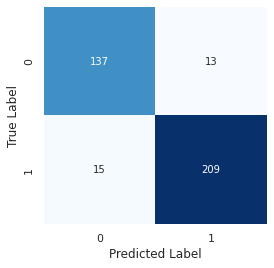


Ejemplo de predicciones:  voice
True label:  [1 0 1 1 1 1 1 0 1 1]
Predicted:   [[0.98354244 0.00944209 0.9980565  0.99301153 0.99824274 0.9772298
  0.997783   0.00514293 0.9849568  0.991572  ]]
Epoch 1/200
10/10 [==============================] - 1s 32ms/step - loss: 0.6881 - accuracy: 0.5790 - val_loss: 0.6798 - val_accuracy: 0.5989
Epoch 2/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6650 - accuracy: 0.6437 - val_loss: 0.6711 - val_accuracy: 0.5989
Epoch 3/200
10/10 [==============================] - 0s 8ms/step - loss: 0.6528 - accuracy: 0.6420 - val_loss: 0.6703 - val_accuracy: 0.5989
Epoch 4/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6492 - accuracy: 0.6420 - val_loss: 0.6721 - val_accuracy: 0.5989
Epoch 5/200
10/10 [==============================] - 0s 9ms/step - loss: 0.6481 - accuracy: 0.6420 - val_loss: 0.6713 - val_accuracy: 0.5989
Epoch 6/200
10/10 [==============================] - 0s 7ms/step - loss: 0.6502 - accuracy: 0.6420

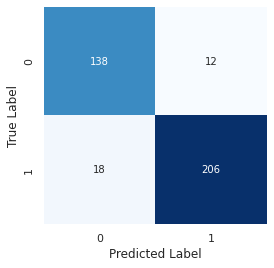


Ejemplo de predicciones:  voice
True label:  [1 0 1 1 1 1 1 0 1 1]
Predicted:   [[0.9693132  0.01106789 0.99733526 0.988335   0.9964059  0.9613114
  0.9970503  0.00579797 0.9797253  0.9884799 ]]


In [ ]:
## Classification binary cross entropy
from tensorflow import keras
#import tf.keras.Sequential
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.models import Model
from keras.optimizers import gradient_descent_v2
#from keras.optimizers import SGD
#from tensorflow.keras.optimizers import SGD
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import average_precision_score
%matplotlib inline

# This dictionary will include the classifiers for each model
models = dict()
histories = dict()
classification_accuracy_results_10s = dict()

n_realizations = 5

# We'll iterate over all istrument classes, and fit a model for each one
# After training, we'll print a classification report for each instrument
for instrument in class_map:
    
    # A list where we are going to store results of that instrument
    instrument_result_list = []
    
    # A list where we are going to store the threshold that maximizes accuracy for that instrument
    optimal_threshold_list = []

    # Map the instrument name to its column number
    inst_num = class_map[instrument]
    #if inst_num != 0:
    #  continue
    # Several train/test realizations
    for n_realizations_ in range(0,n_realizations):
        
      # Step 1: sub-sample the data
      
      # First, we need to select down to the data for which we have annotations
      # This is what the mask arrays are for
      train_inst = Y_mask_train[:, inst_num]
      test_inst = Y_mask_test[:, inst_num]
      
      # Here, we're using the Y_mask_train array to slice out only the training examples
      # for which we have annotations for the given class
      X_train_inst = X_train[train_inst]
      
      # Step 3: simplify the data by averaging over time  XXXXXXX1
      
      # Let's arrange the data for a sklearn Random Forest model 
      # Instead of having time-varying features, we'll summarize each track by its mean feature vector over time
      #X_train_inst_sklearn = np.mean(X_train_inst, axis=1)
      # Reshape the 10*128 VGG features to a 1280 elements vector
      X_train_inst_sklearn = X_train_inst.reshape((X_train_inst.shape[0],X_train_inst.shape[1]*X_train_inst.shape[2]))
      
      # Again, we slice the labels to the annotated examples XXXXXXX2
      # We thresold the label likelihoods at 0.5 to get binary labels
      Y_true_train_inst = Y_true_train[train_inst, inst_num] >= 0.5
      Y_true_train_inst = Y_true_train_inst.round()

      
      # Repeat the above slicing and dicing but for the test set XXXXXXX2
      X_test_inst = X_test[test_inst]
      #X_test_inst_sklearn = np.mean(X_test_inst, axis=1)
      X_test_inst_sklearn = X_test_inst.reshape((X_test_inst.shape[0],X_test_inst.shape[1]*X_test_inst.shape[2]))
      Y_true_test_inst = Y_true_test[test_inst, inst_num] >= 0.5
      Y_true_test_inst = Y_true_test_inst.round()

      X_train_inst_sklearn = X_train_inst_sklearn / 255
      X_test_inst_sklearn = X_test_inst_sklearn / 255

      # Step 3.
      # Initialize a new classifier

      model = Sequential()
      model.add(Dense(128, activation='relu', input_dim=X_train_inst_sklearn.shape[1]))
      model.add(Dropout(0.5))
      model.add(Dense(32, activation='relu'))
      model.add(Dropout(0.5))
      model.add(Dense(1, activation='sigmoid'))


      ### Normalize input data for the Feed Forward Network
      X_train_inst_sklearn_norm = preprocessing.normalize(X_train_inst_sklearn)
      X_test_inst_sklearn_norm = preprocessing.normalize(X_test_inst_sklearn)


      sgd = gradient_descent_v2.SGD(learning_rate=0.01, decay=1e-6, momentum=0.9, nesterov=True)

      model.compile(loss='binary_crossentropy',
                    optimizer=sgd,
                    metrics=['accuracy'])

      
      # Step 4.
      history = model.fit(X_train_inst_sklearn_norm, Y_true_train_inst,
          epochs=200,
          batch_size=128,
          validation_data=(X_test_inst_sklearn_norm, Y_true_test_inst),
          verbose=1)


      # Step 5.
      # Finally, we'll evaluate the model on both train and test
      Y_pred_train = model.predict(X_train_inst_sklearn_norm)


      Y_pred_test = model.predict(X_test_inst_sklearn_norm)
      y_true_ = Y_true_test_inst > 0.5
      #threshold = np.mean(optimal_threshold_list)
      threshold = 0.5
      y_pred_ = Y_pred_test > threshold

      
      
      #Y_pred_train = Y_pred_train.round()
      #Y_pred_test = Y_pred_test.round()
      
      print('-' * 52)
      print(instrument)
      print('\tTRAIN')
      print(classification_report(Y_true_train_inst, Y_pred_train.round()))
      print('\tTEST')
      print(classification_report(Y_true_test_inst, Y_pred_test.round()))

      cm = confusion_matrix(Y_true_test_inst, Y_pred_test.round())
      plt.figure(figsize=(4,4))
      sns.heatmap(cm, annot=True,  fmt='d', cmap=plt.cm.Blues, cbar=False)
      plt.xlabel('Predicted Label')
      plt.ylabel('True Label')
      plt.show()
      
      print()
      print("Ejemplo de predicciones: ", instrument)
      print("True label: ", np.array(Y_true_test_inst[0:10]).astype(int))
      print("Predicted:  ", Y_pred_test[0:10].T)

      # Store the classifier in our dictionary
      models[instrument] = model
      histories[instrument] = history
      results = dict()
      results["Y_true_train"] = Y_true_train_inst.round()
      results["Y_pred_train"] = (Y_pred_train).T
      results["Y_true_test"] = Y_true_test_inst.round()
      results["Y_pred_test"] = (Y_pred_test).T

      results["Accuracy"] = [accuracy_score(y_true_, y_pred_).round(3), threshold]
      # Store test f1 with format [ F1, threshold_accuracy ]
      results["F1"] = [f1_score(y_true_, y_pred_, zero_division=1).round(3), threshold]
      results["AP"] = average_precision_score(y_true_, Y_pred_test).round(3)
      instrument_result_list.append(results)
      if n_realizations_ == n_realizations-1:
        classification_accuracy_results_10s[instrument] = instrument_result_list

Classification using:

*   Features: Average VGG vector over the 10 seconds clip
*   Training: Rounded label probabilities {0,1}
*   Optimization Metric: Accuracy

Classification using:

*   Features: Average VGG vector over the 10 seconds clip
*   Training: Rounded label probabilities {0,1}
*   Optimization Metric: F1 score

Epoch 1/200
12/12 [==============================] - 1s 26ms/step - loss: 0.5311 - accuracy: 0.6204 - val_loss: 0.5365 - val_accuracy: 0.7862
Epoch 2/200
12/12 [==============================] - 0s 8ms/step - loss: 0.5233 - accuracy: 0.7260 - val_loss: 0.5272 - val_accuracy: 0.7862
Epoch 3/200
12/12 [==============================] - 0s 7ms/step - loss: 0.5150 - accuracy: 0.7560 - val_loss: 0.5195 - val_accuracy: 0.7862
Epoch 4/200
12/12 [==============================] - 0s 6ms/step - loss: 0.5105 - accuracy: 0.7560 - val_loss: 0.5141 - val_accuracy: 0.7862
Epoch 5/200
12/12 [==============================] - 0s 7ms/step - loss: 0.5063 - accuracy: 0.7560 - val_loss: 0.5102 - val_accuracy: 0.7862
Epoch 6/200
12/12 [==============================] - 0s 8ms/step - loss: 0.5020 - accuracy: 0.7560 - val_loss: 0.5076 - val_accuracy: 0.7862
Epoch 7/200
12/12 [==============================] - 0s 8ms/step - loss: 0.5006 - accuracy: 0.7560 - val_loss: 0.5058 - val_accuracy: 0.7862
Epoch 8/200


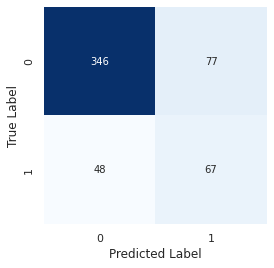


Ejemplo de predicciones:  accordion
True label:  [0 0 0 0 0 0 0 0 0 0]
Predicted:   [[2.5114226e-01 1.5890947e-01 7.4372321e-05 5.9730966e-05 2.0006140e-05
  1.0084297e-01 9.4311422e-01 2.9094797e-02 1.7389980e-04 7.3267927e-04]]
Epoch 1/200
14/14 [==============================] - 1s 20ms/step - loss: 0.5115 - accuracy: 0.5287 - val_loss: 0.5190 - val_accuracy: 0.7071
Epoch 2/200
14/14 [==============================] - 0s 7ms/step - loss: 0.5056 - accuracy: 0.6322 - val_loss: 0.5139 - val_accuracy: 0.7071
Epoch 3/200
14/14 [==============================] - 0s 6ms/step - loss: 0.5035 - accuracy: 0.6471 - val_loss: 0.5097 - val_accuracy: 0.7071
Epoch 4/200
14/14 [==============================] - 0s 6ms/step - loss: 0.5024 - accuracy: 0.6586 - val_loss: 0.5067 - val_accuracy: 0.7071
Epoch 5/200
14/14 [==============================] - 0s 7ms/step - loss: 0.5019 - accuracy: 0.6569 - val_loss: 0.5047 - val_accuracy: 0.7071
Epoch 6/200
14/14 [==============================] - 0s 5ms/ste

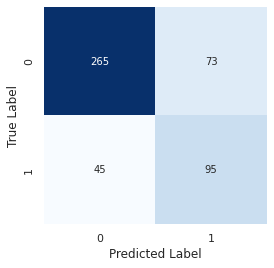


Ejemplo de predicciones:  banjo
True label:  [0 0 1 0 1 0 1 0 0 1]
Predicted:   [[7.6892768e-04 2.8923820e-05 9.9588352e-01 9.3557680e-01 1.1975412e-04
  1.2035759e-02 9.8661596e-01 3.1608051e-05 1.8032728e-04 2.6094287e-03]]
Epoch 1/200
12/12 [==============================] - 1s 24ms/step - loss: 0.5205 - accuracy: 0.6014 - val_loss: 0.5216 - val_accuracy: 0.7106
Epoch 2/200
12/12 [==============================] - 0s 7ms/step - loss: 0.5171 - accuracy: 0.6856 - val_loss: 0.5176 - val_accuracy: 0.7106
Epoch 3/200
12/12 [==============================] - 0s 6ms/step - loss: 0.5130 - accuracy: 0.7095 - val_loss: 0.5141 - val_accuracy: 0.7106
Epoch 4/200
12/12 [==============================] - 0s 6ms/step - loss: 0.5110 - accuracy: 0.7102 - val_loss: 0.5113 - val_accuracy: 0.7106
Epoch 5/200
12/12 [==============================] - 0s 9ms/step - loss: 0.5073 - accuracy: 0.7088 - val_loss: 0.5090 - val_accuracy: 0.7106
Epoch 6/200
12/12 [==============================] - 0s 6ms/step - 

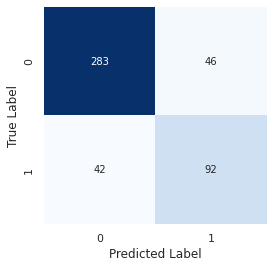


Ejemplo de predicciones:  bass
True label:  [1 1 0 1 1 0 1 0 0 0]
Predicted:   [[0.8742441  0.4754471  0.05440735 0.939508   0.45595703 0.9476469
  0.97555643 0.00275157 0.03427396 0.00379006]]
Epoch 1/200
12/12 [==============================] - 1s 23ms/step - loss: 0.5035 - accuracy: 0.5369 - val_loss: 0.5021 - val_accuracy: 0.5340
Epoch 2/200
12/12 [==============================] - 0s 7ms/step - loss: 0.5037 - accuracy: 0.5574 - val_loss: 0.5013 - val_accuracy: 0.5340
Epoch 3/200
12/12 [==============================] - 0s 7ms/step - loss: 0.5024 - accuracy: 0.5697 - val_loss: 0.5008 - val_accuracy: 0.5340
Epoch 4/200
12/12 [==============================] - 0s 8ms/step - loss: 0.5020 - accuracy: 0.5779 - val_loss: 0.5004 - val_accuracy: 0.5340
Epoch 5/200
12/12 [==============================] - 0s 8ms/step - loss: 0.4968 - accuracy: 0.5984 - val_loss: 0.5002 - val_accuracy: 0.5340
Epoch 6/200
12/12 [==============================] - 0s 6ms/step - loss: 0.5016 - accuracy: 0.5813 

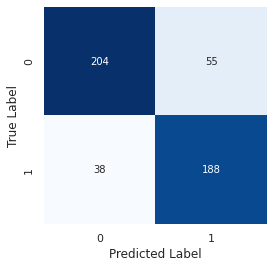


Ejemplo de predicciones:  cello
True label:  [0 0 0 1 0 0 0 0 0 0]
Predicted:   [[3.06842499e-04 6.23401080e-04 9.94885504e-01 2.25257486e-01
  1.12639915e-04 2.23605075e-05 9.67414380e-05 1.13992020e-01
  8.16321190e-05 9.60224196e-02]]
Epoch 1/200
14/14 [==============================] - 2s 23ms/step - loss: 0.5256 - accuracy: 0.7272 - val_loss: 0.5230 - val_accuracy: 0.7859
Epoch 2/200
14/14 [==============================] - 0s 6ms/step - loss: 0.5145 - accuracy: 0.7685 - val_loss: 0.5119 - val_accuracy: 0.7859
Epoch 3/200
14/14 [==============================] - 0s 8ms/step - loss: 0.5088 - accuracy: 0.7719 - val_loss: 0.5059 - val_accuracy: 0.7859
Epoch 4/200
14/14 [==============================] - 0s 7ms/step - loss: 0.5030 - accuracy: 0.7725 - val_loss: 0.5032 - val_accuracy: 0.7859
Epoch 5/200
14/14 [==============================] - 0s 7ms/step - loss: 0.5004 - accuracy: 0.7731 - val_loss: 0.5020 - val_accuracy: 0.7859
Epoch 6/200
14/14 [==============================] - 0s

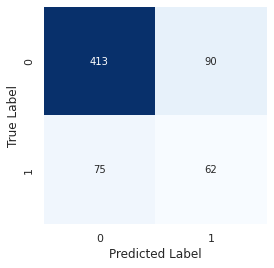


Ejemplo de predicciones:  clarinet
True label:  [1 0 0 0 1 0 0 0 0 0]
Predicted:   [[9.4041961e-01 8.1161633e-03 2.1737758e-02 1.2123653e-02 7.8660458e-01
  2.1788216e-04 4.0726177e-02 2.4750904e-04 1.7660479e-01 7.0812283e-03]]
Epoch 1/200
11/11 [==============================] - 1s 24ms/step - loss: 0.5065 - accuracy: 0.5412 - val_loss: 0.5142 - val_accuracy: 0.6927
Epoch 2/200
11/11 [==============================] - 0s 6ms/step - loss: 0.5031 - accuracy: 0.6082 - val_loss: 0.5075 - val_accuracy: 0.6812
Epoch 3/200
11/11 [==============================] - 0s 7ms/step - loss: 0.5010 - accuracy: 0.6151 - val_loss: 0.5018 - val_accuracy: 0.6812
Epoch 4/200
11/11 [==============================] - 0s 7ms/step - loss: 0.4959 - accuracy: 0.6297 - val_loss: 0.4979 - val_accuracy: 0.6812
Epoch 5/200
11/11 [==============================] - 0s 7ms/step - loss: 0.4957 - accuracy: 0.6266 - val_loss: 0.4949 - val_accuracy: 0.6812
Epoch 6/200
11/11 [==============================] - 0s 8ms/step

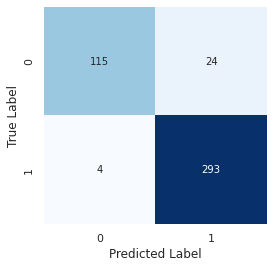


Ejemplo de predicciones:  cymbals
True label:  [1 1 1 1 1 0 1 0 0 0]
Predicted:   [[9.9999928e-01 9.9999982e-01 9.9992669e-01 9.9999988e-01 9.9999344e-01
  9.9997199e-01 9.9999917e-01 8.8154740e-04 5.8805308e-04 1.3055153e-03]]
Epoch 1/200
11/11 [==============================] - 1s 26ms/step - loss: 0.5133 - accuracy: 0.4376 - val_loss: 0.5153 - val_accuracy: 0.4222
Epoch 2/200
11/11 [==============================] - 0s 9ms/step - loss: 0.5089 - accuracy: 0.5057 - val_loss: 0.5125 - val_accuracy: 0.6557
Epoch 3/200
11/11 [==============================] - 0s 6ms/step - loss: 0.5065 - accuracy: 0.5835 - val_loss: 0.5099 - val_accuracy: 0.6557
Epoch 4/200
11/11 [==============================] - 0s 7ms/step - loss: 0.5055 - accuracy: 0.5986 - val_loss: 0.5079 - val_accuracy: 0.6557
Epoch 5/200
11/11 [==============================] - 0s 7ms/step - loss: 0.5025 - accuracy: 0.6395 - val_loss: 0.5059 - val_accuracy: 0.6557
Epoch 6/200
11/11 [==============================] - 0s 7ms/step 

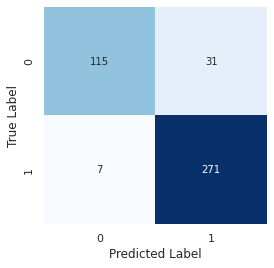


Ejemplo de predicciones:  drums
True label:  [1 0 0 1 1 1 1 1 1 1]
Predicted:   [[9.8886222e-01 2.7521388e-03 1.2330191e-04 9.9979746e-01 9.9977690e-01
  9.9996704e-01 9.9992543e-01 9.9995083e-01 9.9993980e-01 9.9983752e-01]]
Epoch 1/200
12/12 [==============================] - 1s 25ms/step - loss: 0.5234 - accuracy: 0.4106 - val_loss: 0.5190 - val_accuracy: 0.5925
Epoch 2/200
12/12 [==============================] - 0s 8ms/step - loss: 0.5176 - accuracy: 0.5460 - val_loss: 0.5140 - val_accuracy: 0.6886
Epoch 3/200
12/12 [==============================] - 0s 9ms/step - loss: 0.5139 - accuracy: 0.6597 - val_loss: 0.5103 - val_accuracy: 0.6886
Epoch 4/200
12/12 [==============================] - 0s 10ms/step - loss: 0.5089 - accuracy: 0.6859 - val_loss: 0.5076 - val_accuracy: 0.6886
Epoch 5/200
12/12 [==============================] - 0s 9ms/step - loss: 0.5073 - accuracy: 0.6892 - val_loss: 0.5058 - val_accuracy: 0.6886
Epoch 6/200
12/12 [==============================] - 0s 10ms/step 

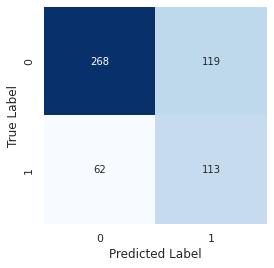


Ejemplo de predicciones:  flute
True label:  [0 0 1 0 0 0 1 0 0 0]
Predicted:   [[0.9631756  0.01727958 0.97428405 0.8299936  0.97159    0.10751234
  0.98324233 0.96241015 0.10745392 0.00481702]]
Epoch 1/200
10/10 [==============================] - 1s 29ms/step - loss: 0.5162 - accuracy: 0.6359 - val_loss: 0.5098 - val_accuracy: 0.6560
Epoch 2/200
10/10 [==============================] - 0s 7ms/step - loss: 0.5120 - accuracy: 0.6787 - val_loss: 0.5049 - val_accuracy: 0.6560
Epoch 3/200
10/10 [==============================] - 0s 7ms/step - loss: 0.5063 - accuracy: 0.6977 - val_loss: 0.5011 - val_accuracy: 0.6560
Epoch 4/200
10/10 [==============================] - 0s 8ms/step - loss: 0.5017 - accuracy: 0.7010 - val_loss: 0.4982 - val_accuracy: 0.6560
Epoch 5/200
10/10 [==============================] - 0s 7ms/step - loss: 0.4975 - accuracy: 0.7010 - val_loss: 0.4962 - val_accuracy: 0.6560
Epoch 6/200
10/10 [==============================] - 0s 10ms/step - loss: 0.4945 - accuracy: 0.70

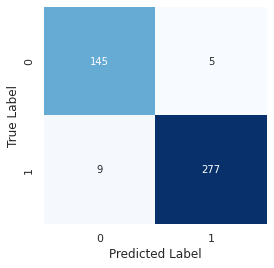


Ejemplo de predicciones:  guitar
True label:  [0 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.00292746 0.00626133 0.00403163 0.9998078  0.999991   0.9975986
  0.999934   0.9999945  0.9997327  0.99982625]]
Epoch 1/200
11/11 [==============================] - 1s 28ms/step - loss: 0.5100 - accuracy: 0.4350 - val_loss: 0.5034 - val_accuracy: 0.4372
Epoch 2/200
11/11 [==============================] - 0s 9ms/step - loss: 0.5068 - accuracy: 0.4887 - val_loss: 0.5016 - val_accuracy: 0.5586
Epoch 3/200
11/11 [==============================] - 0s 9ms/step - loss: 0.5051 - accuracy: 0.5393 - val_loss: 0.5005 - val_accuracy: 0.5586
Epoch 4/200
11/11 [==============================] - 0s 10ms/step - loss: 0.5023 - accuracy: 0.5823 - val_loss: 0.5000 - val_accuracy: 0.5586
Epoch 5/200
11/11 [==============================] - 0s 10ms/step - loss: 0.5022 - accuracy: 0.5861 - val_loss: 0.4996 - val_accuracy: 0.5586
Epoch 6/200
11/11 [==============================] - 0s 8ms/step - loss: 0.4996 - accuracy: 0.6

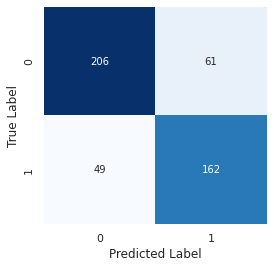


Ejemplo de predicciones:  mallet_percussion
True label:  [0 1 0 0 1 1 0 0 0 0]
Predicted:   [[9.8601079e-01 9.8566115e-01 6.3044061e-03 2.1761472e-03 9.9426407e-01
  9.8972768e-01 6.4479234e-04 1.4504928e-03 1.5406500e-03 7.7429385e-04]]
Epoch 1/200
15/15 [==============================] - 1s 21ms/step - loss: 0.5104 - accuracy: 0.5585 - val_loss: 0.5153 - val_accuracy: 0.6922
Epoch 2/200
15/15 [==============================] - 0s 7ms/step - loss: 0.5061 - accuracy: 0.6320 - val_loss: 0.5119 - val_accuracy: 0.6922
Epoch 3/200
15/15 [==============================] - 0s 7ms/step - loss: 0.5039 - accuracy: 0.6445 - val_loss: 0.5087 - val_accuracy: 0.6922
Epoch 4/200
15/15 [==============================] - 0s 8ms/step - loss: 0.5015 - accuracy: 0.6467 - val_loss: 0.5059 - val_accuracy: 0.6922
Epoch 5/200
15/15 [==============================] - 0s 7ms/step - loss: 0.5002 - accuracy: 0.6440 - val_loss: 0.5035 - val_accuracy: 0.6922
Epoch 6/200
15/15 [==============================] - 0s

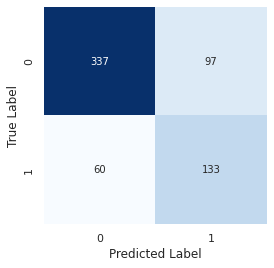


Ejemplo de predicciones:  mandolin
True label:  [0 0 0 0 0 1 0 0 0 0]
Predicted:   [[1.2560695e-04 9.9829054e-01 3.2273421e-04 9.8365508e-03 7.4439114e-03
  8.2270920e-01 9.0879542e-01 2.8944496e-04 1.3539550e-04 2.8981332e-05]]
Epoch 1/200
12/12 [==============================] - 1s 26ms/step - loss: 0.5146 - accuracy: 0.5517 - val_loss: 0.5230 - val_accuracy: 0.7193
Epoch 2/200
12/12 [==============================] - 0s 9ms/step - loss: 0.5098 - accuracy: 0.6073 - val_loss: 0.5173 - val_accuracy: 0.7193
Epoch 3/200
12/12 [==============================] - 0s 9ms/step - loss: 0.5065 - accuracy: 0.6546 - val_loss: 0.5118 - val_accuracy: 0.7193
Epoch 4/200
12/12 [==============================] - 0s 7ms/step - loss: 0.5022 - accuracy: 0.6690 - val_loss: 0.5073 - val_accuracy: 0.7193
Epoch 5/200
12/12 [==============================] - 0s 9ms/step - loss: 0.4991 - accuracy: 0.6696 - val_loss: 0.5042 - val_accuracy: 0.7193
Epoch 6/200
12/12 [==============================] - 0s 7ms/step

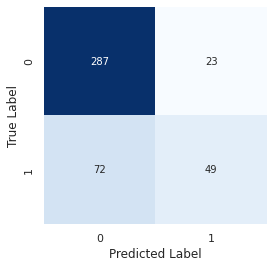


Ejemplo de predicciones:  organ
True label:  [0 0 0 1 0 1 0 0 0 0]
Predicted:   [[1.8938888e-05 2.0985545e-01 1.9605111e-02 3.0696080e-03 2.5735375e-05
  8.0075435e-02 4.7474121e-05 2.1107357e-04 2.6098167e-05 7.6237222e-05]]
Epoch 1/200
11/11 [==============================] - 1s 27ms/step - loss: 0.5121 - accuracy: 0.5686 - val_loss: 0.5136 - val_accuracy: 0.6867
Epoch 2/200
11/11 [==============================] - 0s 6ms/step - loss: 0.5101 - accuracy: 0.6383 - val_loss: 0.5089 - val_accuracy: 0.6867
Epoch 3/200
11/11 [==============================] - 0s 8ms/step - loss: 0.5063 - accuracy: 0.6690 - val_loss: 0.5050 - val_accuracy: 0.6867
Epoch 4/200
11/11 [==============================] - 0s 9ms/step - loss: 0.5008 - accuracy: 0.6751 - val_loss: 0.5017 - val_accuracy: 0.6867
Epoch 5/200
11/11 [==============================] - 0s 9ms/step - loss: 0.5008 - accuracy: 0.6774 - val_loss: 0.4986 - val_accuracy: 0.6867
Epoch 6/200
11/11 [==============================] - 0s 7ms/step - 

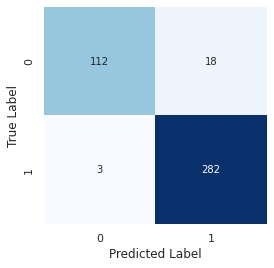


Ejemplo de predicciones:  piano
True label:  [0 0 0 0 0 0 0 1 0 0]
Predicted:   [[1.9268095e-04 1.2856239e-03 6.8841100e-02 4.4973399e-03 8.1563293e-04
  2.2024802e-04 3.6662072e-03 8.7965435e-01 9.9934930e-01 3.4490484e-04]]
Epoch 1/200
14/14 [==============================] - 1s 25ms/step - loss: 0.5007 - accuracy: 0.5081 - val_loss: 0.5009 - val_accuracy: 0.5676
Epoch 2/200
14/14 [==============================] - 0s 8ms/step - loss: 0.5002 - accuracy: 0.5115 - val_loss: 0.4999 - val_accuracy: 0.6375
Epoch 3/200
14/14 [==============================] - 0s 8ms/step - loss: 0.4999 - accuracy: 0.5086 - val_loss: 0.4988 - val_accuracy: 0.6455
Epoch 4/200
14/14 [==============================] - 0s 9ms/step - loss: 0.4974 - accuracy: 0.5576 - val_loss: 0.4976 - val_accuracy: 0.6471
Epoch 5/200
14/14 [==============================] - 0s 9ms/step - loss: 0.4966 - accuracy: 0.5565 - val_loss: 0.4968 - val_accuracy: 0.6280
Epoch 6/200
14/14 [==============================] - 0s 8ms/step - 

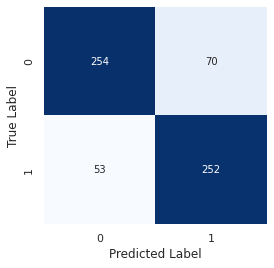


Ejemplo de predicciones:  saxophone
True label:  [0 1 0 0 0 0 0 0 0 1]
Predicted:   [[0.6545203  0.9683936  0.00166621 0.00329247 0.6786629  0.00239134
  0.05192527 0.05066642 0.48497525 0.58973914]]
Epoch 1/200
10/10 [==============================] - 1s 33ms/step - loss: 0.5117 - accuracy: 0.5679 - val_loss: 0.5146 - val_accuracy: 0.7053
Epoch 2/200
10/10 [==============================] - 0s 10ms/step - loss: 0.5075 - accuracy: 0.6293 - val_loss: 0.5090 - val_accuracy: 0.7053
Epoch 3/200
10/10 [==============================] - 0s 10ms/step - loss: 0.5049 - accuracy: 0.6637 - val_loss: 0.5047 - val_accuracy: 0.7053
Epoch 4/200
10/10 [==============================] - 0s 8ms/step - loss: 0.5031 - accuracy: 0.6686 - val_loss: 0.5012 - val_accuracy: 0.7053
Epoch 5/200
10/10 [==============================] - 0s 10ms/step - loss: 0.4995 - accuracy: 0.6743 - val_loss: 0.4985 - val_accuracy: 0.7053
Epoch 6/200
10/10 [==============================] - 0s 9ms/step - loss: 0.4989 - accuracy

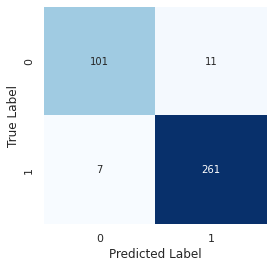


Ejemplo de predicciones:  synthesizer
True label:  [1 1 1 1 1 0 1 1 1 1]
Predicted:   [[0.8806914  0.9999559  0.9999965  0.9987291  0.9998914  0.14230268
  0.9999766  0.9999637  0.9999994  0.9997651 ]]
Epoch 1/200
16/16 [==============================] - 1s 22ms/step - loss: 0.5164 - accuracy: 0.5897 - val_loss: 0.5179 - val_accuracy: 0.6833
Epoch 2/200
16/16 [==============================] - 0s 8ms/step - loss: 0.5119 - accuracy: 0.6779 - val_loss: 0.5128 - val_accuracy: 0.6833
Epoch 3/200
16/16 [==============================] - 0s 7ms/step - loss: 0.5075 - accuracy: 0.6887 - val_loss: 0.5083 - val_accuracy: 0.6833
Epoch 4/200
16/16 [==============================] - 0s 8ms/step - loss: 0.5056 - accuracy: 0.6892 - val_loss: 0.5054 - val_accuracy: 0.6833
Epoch 5/200
16/16 [==============================] - 0s 10ms/step - loss: 0.5026 - accuracy: 0.6887 - val_loss: 0.5038 - val_accuracy: 0.6833
Epoch 6/200
16/16 [==============================] - 0s 8ms/step - loss: 0.4996 - accuracy

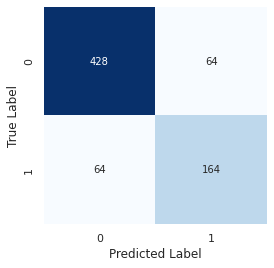


Ejemplo de predicciones:  trombone
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[3.82703758e-04 8.59316662e-02 5.68367494e-03 5.07474877e-02
  9.55305874e-01 1.19570106e-01 2.08240226e-01 5.11521648e-06
  3.31118479e-02 2.53129929e-05]]
Epoch 1/200
17/17 [==============================] - 1s 19ms/step - loss: 0.5057 - accuracy: 0.5467 - val_loss: 0.5073 - val_accuracy: 0.5949
Epoch 2/200
17/17 [==============================] - 0s 8ms/step - loss: 0.5042 - accuracy: 0.5983 - val_loss: 0.5054 - val_accuracy: 0.5949
Epoch 3/200
17/17 [==============================] - 0s 7ms/step - loss: 0.5004 - accuracy: 0.6096 - val_loss: 0.5040 - val_accuracy: 0.5949
Epoch 4/200
17/17 [==============================] - 0s 8ms/step - loss: 0.4998 - accuracy: 0.6115 - val_loss: 0.5031 - val_accuracy: 0.5949
Epoch 5/200
17/17 [==============================] - 0s 7ms/step - loss: 0.4991 - accuracy: 0.6119 - val_loss: 0.5027 - val_accuracy: 0.5949
Epoch 6/200
17/17 [==============================] -

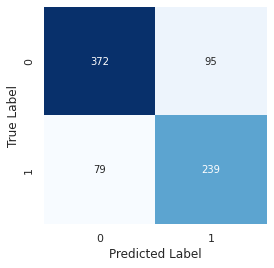


Ejemplo de predicciones:  trumpet
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.13544257 0.01173391 0.09149419 0.91778624 0.99758977 0.3556186
  0.00145401 0.37113455 0.00375208 0.00110339]]
Epoch 1/200
15/15 [==============================] - 1s 21ms/step - loss: 0.5204 - accuracy: 0.5232 - val_loss: 0.5166 - val_accuracy: 0.6915
Epoch 2/200
15/15 [==============================] - 0s 8ms/step - loss: 0.5153 - accuracy: 0.6518 - val_loss: 0.5103 - val_accuracy: 0.6915
Epoch 3/200
15/15 [==============================] - 0s 8ms/step - loss: 0.5079 - accuracy: 0.6948 - val_loss: 0.5060 - val_accuracy: 0.6915
Epoch 4/200
15/15 [==============================] - 0s 7ms/step - loss: 0.5048 - accuracy: 0.6975 - val_loss: 0.5030 - val_accuracy: 0.6915
Epoch 5/200
15/15 [==============================] - 0s 9ms/step - loss: 0.5023 - accuracy: 0.6970 - val_loss: 0.5013 - val_accuracy: 0.6915
Epoch 6/200
15/15 [==============================] - 0s 8ms/step - loss: 0.5018 - accuracy: 0.69

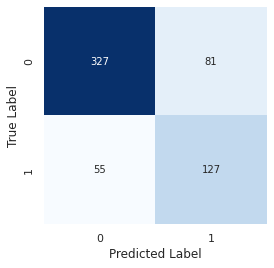


Ejemplo de predicciones:  ukulele
True label:  [1 0 0 0 0 1 0 0 0 0]
Predicted:   [[9.94303286e-01 1.40509321e-04 1.21019395e-04 1.05811376e-03
  6.99976563e-01 7.09229648e-01 4.84053453e-06 1.48448080e-05
  1.58896837e-05 7.48020887e-01]]
Epoch 1/200
11/11 [==============================] - 1s 25ms/step - loss: 0.5040 - accuracy: 0.4636 - val_loss: 0.5191 - val_accuracy: 0.3756
Epoch 2/200
11/11 [==============================] - 0s 8ms/step - loss: 0.5025 - accuracy: 0.4679 - val_loss: 0.5172 - val_accuracy: 0.4041
Epoch 3/200
11/11 [==============================] - 0s 8ms/step - loss: 0.5029 - accuracy: 0.4800 - val_loss: 0.5154 - val_accuracy: 0.6355
Epoch 4/200
11/11 [==============================] - 0s 11ms/step - loss: 0.5012 - accuracy: 0.5200 - val_loss: 0.5139 - val_accuracy: 0.6260
Epoch 5/200
11/11 [==============================] - 0s 11ms/step - loss: 0.5005 - accuracy: 0.5350 - val_loss: 0.5125 - val_accuracy: 0.6244
Epoch 6/200
11/11 [==============================] 

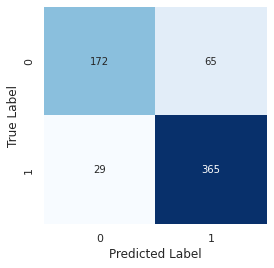


Ejemplo de predicciones:  violin
True label:  [0 0 1 0 0 0 0 0 0 1]
Predicted:   [[9.6593589e-01 9.9766493e-01 9.9188471e-01 2.4019235e-01 9.9545109e-01
  6.0762151e-05 8.4148211e-05 3.1550917e-05 3.8372193e-04 9.8749918e-01]]
Epoch 1/200
10/10 [==============================] - 1s 52ms/step - loss: 0.5147 - accuracy: 0.4244 - val_loss: 0.5092 - val_accuracy: 0.2968
Epoch 2/200
10/10 [==============================] - 0s 13ms/step - loss: 0.5109 - accuracy: 0.5059 - val_loss: 0.5071 - val_accuracy: 0.5989
Epoch 3/200
10/10 [==============================] - 0s 17ms/step - loss: 0.5103 - accuracy: 0.5714 - val_loss: 0.5053 - val_accuracy: 0.5989
Epoch 4/200
10/10 [==============================] - 0s 14ms/step - loss: 0.5056 - accuracy: 0.6294 - val_loss: 0.5037 - val_accuracy: 0.5989
Epoch 5/200
10/10 [==============================] - 0s 21ms/step - loss: 0.5059 - accuracy: 0.6345 - val_loss: 0.5024 - val_accuracy: 0.5989
Epoch 6/200
10/10 [==============================] - 0s 24ms/s

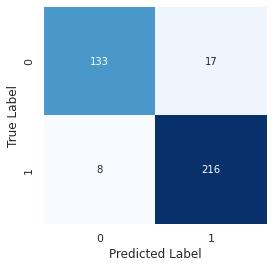


Ejemplo de predicciones:  voice
True label:  [1 0 1 1 1 1 1 0 1 1]
Predicted:   [[9.9828553e-01 1.0043101e-03 9.9994367e-01 9.9987674e-01 9.9892950e-01
  9.3280965e-01 9.9998850e-01 4.1658105e-04 9.9999094e-01 9.9993771e-01]]


In [ ]:
## Classification optimized using F1-score!!
from tensorflow import keras
#import tf.keras.Sequential
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.models import Model
from keras.optimizers import gradient_descent_v2
#from keras.optimizers import SGD
#from tensorflow.keras.optimizers import SGD
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
import tensorflow as tf

%matplotlib inline

def macro_soft_f1(y, y_hat):
    """Compute the macro soft F1-score as a cost.
    Average (1 - soft-F1) across all labels.
    Use probability values instead of binary predictions.
    
    Args:
        y (int32 Tensor): targets array of shape (BATCH_SIZE, N_LABELS)
        y_hat (float32 Tensor): probability matrix of shape (BATCH_SIZE, N_LABELS)
        
    Returns:
        cost (scalar Tensor): value of the cost function for the batch
    """
    
    y = tf.cast(y, tf.float32)
    y_hat = tf.cast(y_hat, tf.float32)
    tp = tf.reduce_sum(y_hat * y, axis=0)
    fp = tf.reduce_sum(y_hat * (1 - y), axis=0)
    fn = tf.reduce_sum((1 - y_hat) * y, axis=0)
    soft_f1 = 2*tp / (2*tp + fn + fp + 1e-16)
    cost = 1 - soft_f1 # reduce 1 - soft-f1 in order to increase soft-f1
    macro_cost = tf.reduce_mean(cost) # average on all labels
    
    return macro_cost

def macro_f1(y, y_hat, thresh=0.5):
    """Compute the macro F1-score on a batch of observations (average F1 across labels)
    
    Args:
        y (int32 Tensor): labels array of shape (BATCH_SIZE, N_LABELS)
        y_hat (float32 Tensor): probability matrix from forward propagation of shape (BATCH_SIZE, N_LABELS)
        thresh: probability value above which we predict positive
        
    Returns:
        macro_f1 (scalar Tensor): value of macro F1 for the batch
    """
    y_pred = tf.cast(tf.greater(y_hat, thresh), tf.float32)
    tp = tf.cast(tf.math.count_nonzero(y_pred * y, axis=0), tf.float32)
    fp = tf.cast(tf.math.count_nonzero(y_pred * (1 - y), axis=0), tf.float32)
    fn = tf.cast(tf.math.count_nonzero((1 - y_pred) * y, axis=0), tf.float32)
    f1 = 2*tp / (2*tp + fn + fp + 1e-16)
    macro_f1 = tf.reduce_mean(f1)
    return macro_f1

def macro_double_soft_f1(y, y_hat):
    """Compute the macro soft F1-score as a cost (average 1 - soft-F1 across all labels).
    Use probability values instead of binary predictions.
    This version uses the computation of soft-F1 for both positive and negative class for each label.
    
    Args:
        y (int32 Tensor): targets array of shape (BATCH_SIZE, N_LABELS)
        y_hat (float32 Tensor): probability matrix from forward propagation of shape (BATCH_SIZE, N_LABELS)
        
    Returns:
        cost (scalar Tensor): value of the cost function for the batch
    """
    y = tf.cast(y, tf.float32)
    y_hat = tf.cast(y_hat, tf.float32)
    tp = tf.reduce_sum(y_hat * y, axis=0)
    fp = tf.reduce_sum(y_hat * (1 - y), axis=0)
    fn = tf.reduce_sum((1 - y_hat) * y, axis=0)
    tn = tf.reduce_sum((1 - y_hat) * (1 - y), axis=0)
    soft_f1_class1 = 2*tp / (2*tp + fn + fp + 1e-16)
    soft_f1_class0 = 2*tn / (2*tn + fn + fp + 1e-16)
    cost_class1 = 1 - soft_f1_class1 # reduce 1 - soft-f1_class1 in order to increase soft-f1 on class 1
    cost_class0 = 1 - soft_f1_class0 # reduce 1 - soft-f1_class0 in order to increase soft-f1 on class 0
    cost = 0.5 * (cost_class1 + cost_class0) # take into account both class 1 and class 0
    macro_cost = tf.reduce_mean(cost) # average on all labels
    return macro_cost

# This dictionary will include the classifiers for each model
models = dict()
histories = dict()
classification_f1_results = dict()

# We'll iterate over all istrument classes, and fit a model for each one
# After training, we'll print a classification report for each instrument
for instrument in class_map:
    
    # Map the instrument name to its column number
    inst_num = class_map[instrument]
        
    # Step 1: sub-sample the data
    
    # First, we need to select down to the data for which we have annotations
    # This is what the mask arrays are for
    train_inst = Y_mask_train[:, inst_num]
    test_inst = Y_mask_test[:, inst_num]
    
    # Here, we're using the Y_mask_train array to slice out only the training examples
    # for which we have annotations for the given class
    X_train_inst = X_train[train_inst]
    
    # Step 3: simplify the data by averaging over time  XXXXXXX1
    
    # Let's arrange the data for a sklearn Random Forest model 
    # Instead of having time-varying features, we'll summarize each track by its mean feature vector over time
    X_train_inst_sklearn = np.mean(X_train_inst, axis=1)
    
    # Again, we slice the labels to the annotated examples XXXXXXX2
    # We thresold the label likelihoods at 0.5 to get binary labels
    #Y_true_train_inst = Y_true_train[train_inst, inst_num] >= 0.5
    Y_true_train_inst = Y_true_train[train_inst, inst_num]
    Y_true_train_inst = Y_true_train_inst.round()
    
    # Repeat the above slicing and dicing but for the test set XXXXXXX2
    X_test_inst = X_test[test_inst]
    X_test_inst_sklearn = np.mean(X_test_inst, axis=1)
    #Y_true_test_inst = Y_true_test[test_inst, inst_num] >= 0.5
    Y_true_test_inst = Y_true_test[test_inst, inst_num]
    Y_true_test_inst = Y_true_test_inst.round()
    
    

    # Step 3.
    # Initialize a new classifier

    model = Sequential()
    model.add(Dense(128, activation='relu', input_dim=X_train_inst_sklearn.shape[1]))
    model.add(Dropout(0.5))
    model.add(Dense(32, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1, activation='sigmoid'))


    ### Normalize input data for the Feed Forward Network
    X_train_inst_sklearn_norm = preprocessing.normalize(X_train_inst_sklearn)
    X_test_inst_sklearn_norm = preprocessing.normalize(X_test_inst_sklearn)


    sgd = gradient_descent_v2.SGD(learning_rate=0.01, decay=1e-6, momentum=0.9, nesterov=True)
    
    #model.compile(loss='binary_crossentropy',
    #model.compile(loss=[macro_f1],
    model.compile(loss=[macro_double_soft_f1],
                  optimizer=sgd,
                  metrics=['accuracy'])
    
    
    # Step 4.
    history = model.fit(X_train_inst_sklearn_norm, Y_true_train_inst,
         epochs=200,
         batch_size=128,
         validation_data=(X_test_inst_sklearn_norm, Y_true_test_inst),
         verbose=1)


    # Step 5.
    # Finally, we'll evaluate the model on both train and test
    Y_pred_train = model.predict(X_train_inst_sklearn_norm)
    Y_pred_test = model.predict(X_test_inst_sklearn_norm)
    
    #Y_pred_train = Y_pred_train.round()
    #Y_pred_test = Y_pred_test.round()
    
    print('-' * 52)
    print(instrument)
    print('\tTRAIN')
    print(classification_report(Y_true_train_inst, Y_pred_train.round()))
    print('\tTEST')
    print(classification_report(Y_true_test_inst, Y_pred_test.round()))

    cm = confusion_matrix(Y_true_test_inst.round(), Y_pred_test.round())
    plt.figure(figsize=(4,4))
    sns.heatmap(cm, annot=True,  fmt='d', cmap=plt.cm.Blues, cbar=False)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.show()
    
    print()
    print("Ejemplo de predicciones: ", instrument)
    print("True label: ", np.array(Y_true_test_inst[0:10]).astype(int))
    print("Predicted:  ", Y_pred_test[0:10].T)

    # Store the classifier in our dictionary
    models[instrument] = model
    histories[instrument] = history
    results = dict()
    results["Y_true_train"] = Y_true_train_inst.round()
    results["Y_pred_train"] = (Y_pred_train).T
    results["Y_true_test"] = Y_true_test_inst.round()
    results["Y_pred_test"] = (Y_pred_test).T
    classification_f1_results[instrument] = results

Metric: ACCURACY
# accordion
Train Accuracy :  0.91
Test  Accuracy :  0.91

# banjo
Train Accuracy :  0.89
Test  Accuracy :  0.89

# bass
Train Accuracy :  0.89
Test  Accuracy :  0.9

# cello
Train Accuracy :  0.88
Test  Accuracy :  0.89

# clarinet
Train Accuracy :  0.88
Test  Accuracy :  0.89

# cymbals
Train Accuracy :  0.96
Test  Accuracy :  0.97

# drums
Train Accuracy :  0.97
Test  Accuracy :  0.95

# flute
Train Accuracy :  0.87
Test  Accuracy :  0.86

# guitar
Train Accuracy :  0.98
Test  Accuracy :  0.98

# mallet_percussion
Train Accuracy :  0.91
Test  Accuracy :  0.89

# mandolin
Train Accuracy :  0.88
Test  Accuracy :  0.86

# organ
Train Accuracy :  0.91
Test  Accuracy :  0.87

# piano
Train Accuracy :  0.98
Test  Accuracy :  0.97

# saxophone
Train Accuracy :  0.89
Test  Accuracy :  0.9

# synthesizer
Train Accuracy :  0.97
Test  Accuracy :  0.97

# trombone
Train Accuracy :  0.89
Test  Accuracy :  0.91

# trumpet
Train Accuracy :  0.89
Test  Accuracy :  0.89

# ukulele
T

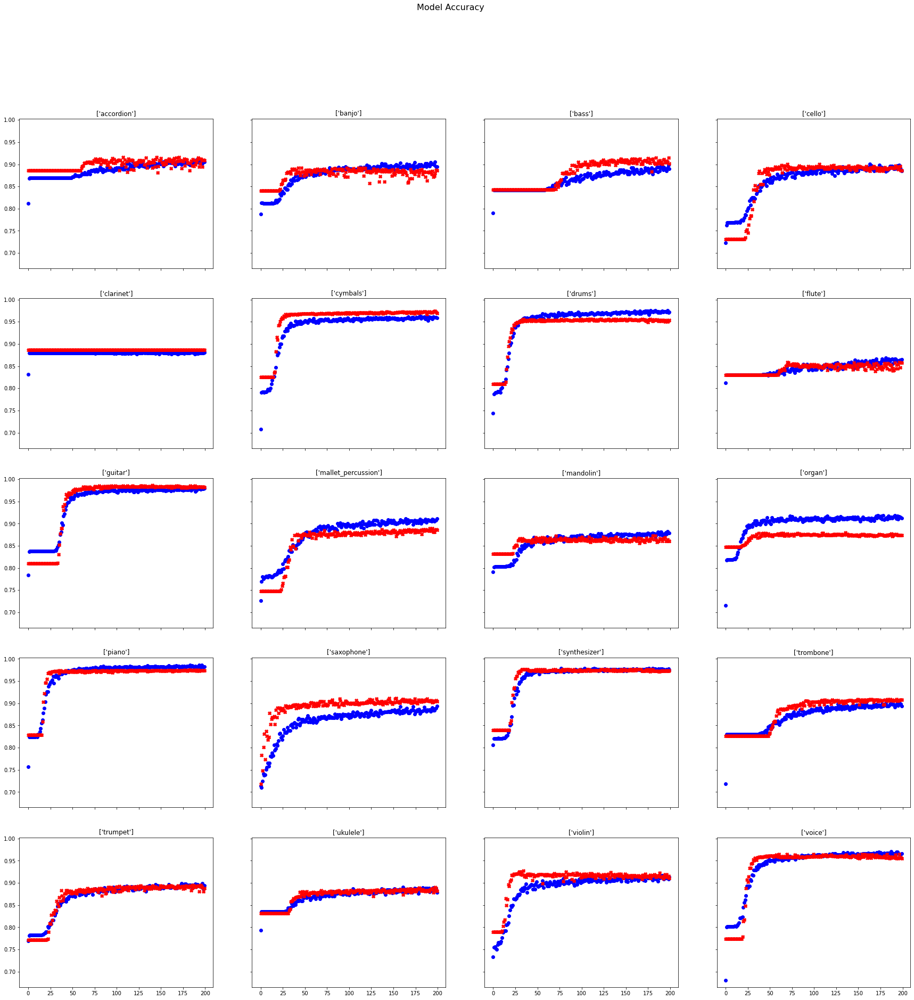

In [ ]:
def plot_accuracy():
    fig,axes = plt.subplots(nrows=5,ncols=4,sharex=True,sharey=True,figsize=(30,30))
    fig.suptitle('Model Accuracy',size=16)
    i=0
    print("Metric: ACCURACY")
    for x in range(5):
        for y in range(4):
            keys = [k for k, v in class_map.items() if v == i]
            
            axes[x,y].set_title(keys)
            
            history = histories[keys[0]]
            print("#",keys[0])
            print('Train Accuracy : ',np.round(np.sqrt(history.history['accuracy'][-1]),2))
            print('Test  Accuracy : ',np.round(np.sqrt(history.history['val_accuracy'][-1]),2))
            print()

            # Plot the accuracy curves
            #axes[x,y].plot(history.history['mse'],'bo')
            #axes[x,y].plot(history.history['val_mse'],'rX')

            axes[x,y].plot(np.sqrt(history.history['accuracy']),'bo')
            axes[x,y].plot(np.sqrt(history.history['val_accuracy']),'rX')

            #axes[x,y].xlabel(np.round(history.history['accuracy'][-1],2))


            #axes[x,y].get_xaxis().set_visible(False)
            #axes[x,y].get_yaxis().set_visible(False)
            i+=1
plot_accuracy()

### **RESULT COMPARISON: Regression   VS   Classification_accuracy   VS    Classification_F1**

In [ ]:
# Save training/testing results
np.save('/content/gdrive/MyDrive/MASTER/TFM/regression_results.npy', regression_results)
np.save('/content/gdrive/MyDrive/MASTER/TFM/classification_accuracy_results.npy', classification_accuracy_results)
np.save('/content/gdrive/MyDrive/MASTER/TFM/classification_f1_results.npy', classification_f1_results)
np.save('/content/gdrive/MyDrive/MASTER/TFM/classification_f1_results_10s.npy', classification_f1_results_10s)
np.save('/content/gdrive/MyDrive/MASTER/TFM/regression_results_10s.npy', regression_results_10s)
np.save('/content/gdrive/MyDrive/MASTER/TFM/CNN_results.npy', CNN_results)

AP  0.596 accordion
Optimal Accuracy: 0.831  with threshold  0.97   accordion
Optimal F1: 0.694  with threshold  0.24   accordion

AP  0.688 banjo
Optimal Accuracy: 0.793  with threshold  0.93   banjo
Optimal F1: 0.736  with threshold  0.9   banjo

AP  0.735 bass
Optimal Accuracy: 0.825  with threshold  0.72   bass
Optimal F1: 0.775  with threshold  0.55   bass

AP  0.845 cello
Optimal Accuracy: 0.814  with threshold  0.62   cello
Optimal F1: 0.814  with threshold  0.62   cello

AP  0.417 clarinet
Optimal Accuracy: 0.797  with threshold  0.93   clarinet
Optimal F1: 0.639  with threshold  0.41   clarinet

AP  0.97 cymbals
Optimal Accuracy: 0.943  with threshold  0.79   cymbals
Optimal F1: 0.932  with threshold  0.79   cymbals

AP  0.975 drums
Optimal Accuracy: 0.917  with threshold  0.31   drums
Optimal F1: 0.904  with threshold  0.31   drums

AP  0.576 flute
Optimal Accuracy: 0.733  with threshold  0.93   flute
Optimal F1: 0.672  with threshold  0.79   flute

AP  0.996 guitar
Optimal A

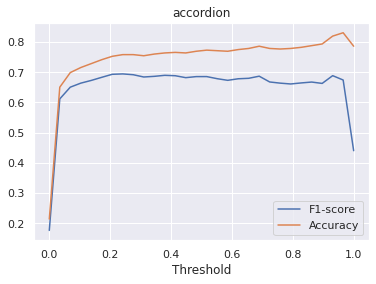

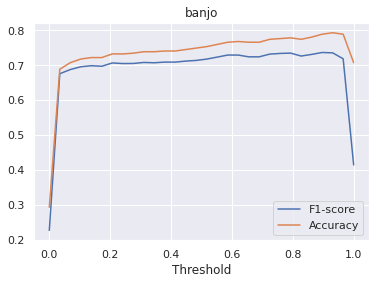

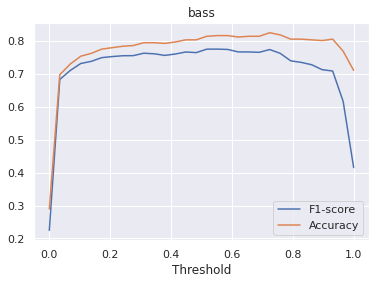

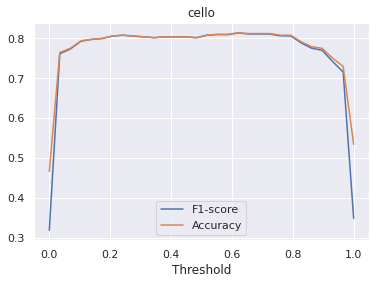

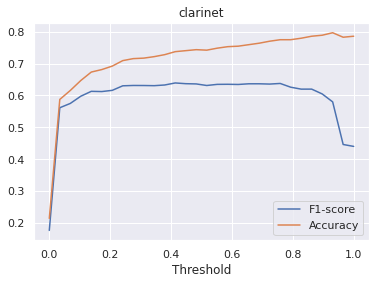

...

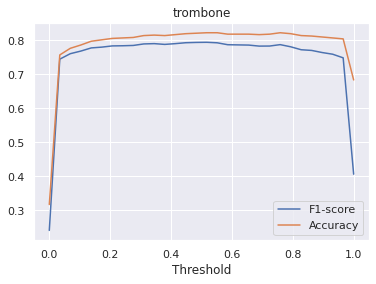

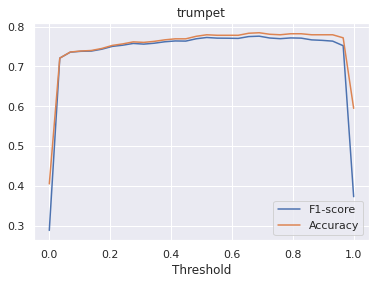

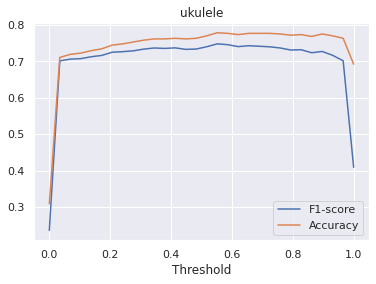

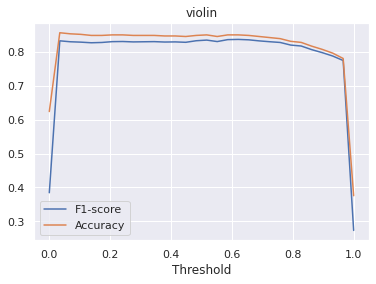

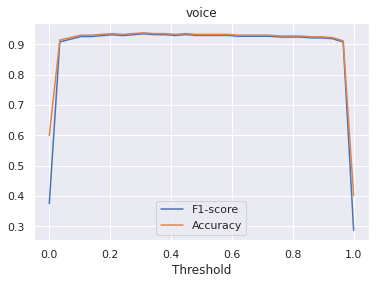

In [ ]:
from sklearn.metrics import f1_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import average_precision_score
AP_values = []
for x in range(20):

  keys = [k for k, v in class_map.items() if v == x]
  result = classification_f1_results[keys[0]]

  y_true = result["Y_true_test"] > 0.5
  print("AP ", average_precision_score(y_true, result["Y_pred_test"][0]).round(3), keys[0])
  AP_values.append(average_precision_score(y_true, result["Y_pred_test"][0]).round(3))
  f1_values = []
  acc_values = []
  threshold = np.linspace(0,1,30)
  for threshold_ in threshold:
    y_pred = result["Y_pred_test"][0] > threshold_
    f1_values.append(f1_score(y_true, y_pred, average='macro', zero_division=1))
    acc_values.append(accuracy_score(y_true, y_pred))
  #print("F1 values: ", f1_values)
  #print("Accuracy: ", acc_values)
  #print()

  plt.figure()
  plt.plot(threshold,f1_values,label="F1-score")
  plt.plot(threshold,acc_values,label="Accuracy")
  plt.legend()
  plt.xlabel("Threshold")
  plt.title(keys[0])

  print("Optimal Accuracy:",np.max(acc_values).round(3), " with threshold ", threshold[acc_values.index(np.max(acc_values))].round(2), " ", keys[0])
  print("Optimal F1:",np.max(f1_values).round(3), " with threshold ", threshold[f1_values.index(np.max(f1_values))].round(2), " ", keys[0])
  print()
print("mAP ", np.mean(AP_values))

AP  0.582 accordion
Optimal Accuracy: 0.827  with threshold  0.48   accordion
Optimal F1: 0.689  with threshold  0.41   accordion

AP  0.682 banjo
Optimal Accuracy: 0.795  with threshold  0.52   banjo
Optimal F1: 0.75  with threshold  0.52   banjo

AP  0.736 bass
Optimal Accuracy: 0.819  with threshold  0.45   bass
Optimal F1: 0.772  with threshold  0.41   bass

AP  0.848 cello
Optimal Accuracy: 0.804  with threshold  0.48   cello
Optimal F1: 0.803  with threshold  0.48   cello

AP  0.38 clarinet
Optimal Accuracy: 0.786  with threshold  0.41   clarinet
Optimal F1: 0.617  with threshold  0.34   clarinet

AP  0.975 cymbals
Optimal Accuracy: 0.943  with threshold  0.55   cymbals
Optimal F1: 0.932  with threshold  0.59   cymbals

AP  0.98 drums
Optimal Accuracy: 0.917  with threshold  0.62   drums
Optimal F1: 0.907  with threshold  0.62   drums

AP  0.585 flute
Optimal Accuracy: 0.735  with threshold  0.48   flute
Optimal F1: 0.664  with threshold  0.41   flute

AP  0.995 guitar
Optimal Ac

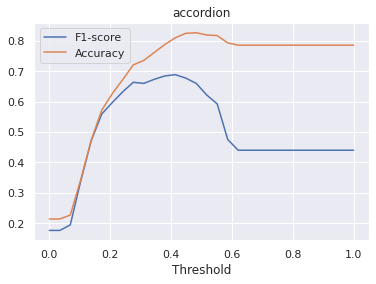

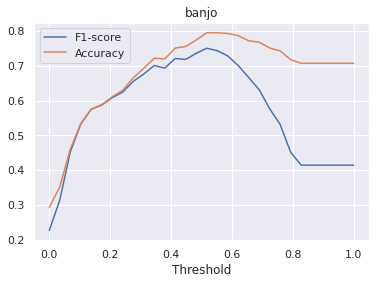

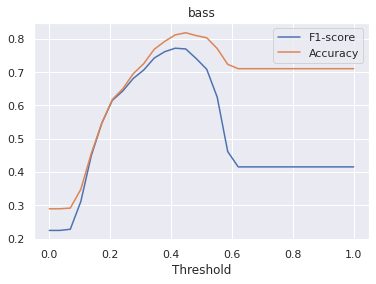

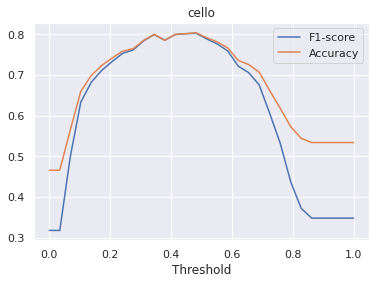

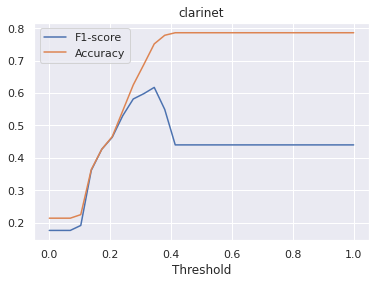

...

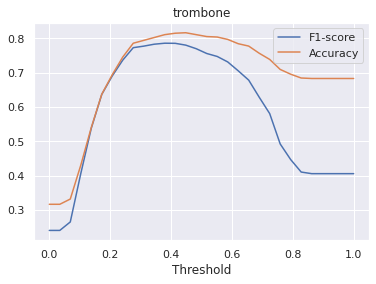

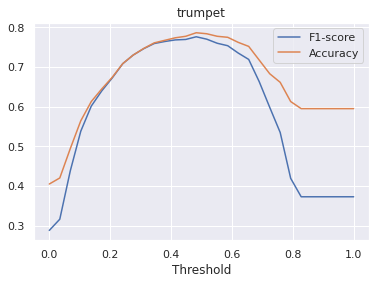

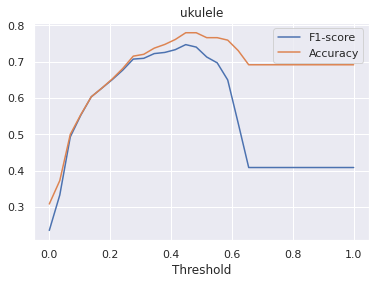

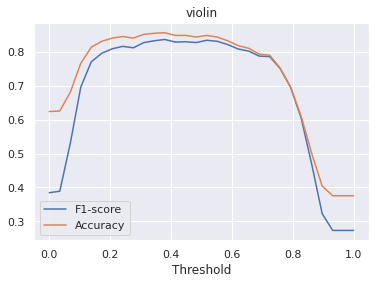

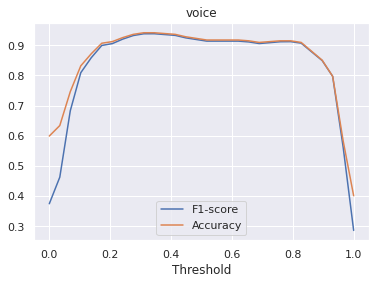

In [ ]:
from sklearn.metrics import f1_score
from sklearn.metrics import accuracy_score
from sklearn.metrics import average_precision_score
AP_values = []
for x in range(20):

  keys = [k for k, v in class_map.items() if v == x]
  result = regression_results[keys[0]]

  y_true = result["Y_true_test"] > 0.5
  print("AP ", average_precision_score(y_true, result["Y_pred_test"][0]).round(3), keys[0])
  AP_values.append(average_precision_score(y_true, result["Y_pred_test"][0]).round(3))
  f1_values = []
  acc_values = []
  threshold = np.linspace(0,1,30)
  for threshold_ in threshold:
    y_pred = result["Y_pred_test"][0] > threshold_
    f1_values.append(f1_score(y_true, y_pred, average='macro', zero_division=1))
    acc_values.append(accuracy_score(y_true, y_pred))
  #print("F1 values: ", f1_values)
  #print("Accuracy: ", acc_values)
  #print()

  plt.figure()
  plt.plot(threshold,f1_values,label="F1-score")
  plt.plot(threshold,acc_values,label="Accuracy")
  plt.legend()
  plt.xlabel("Threshold")
  plt.title(keys[0])

  print("Optimal Accuracy:",np.max(acc_values).round(3), " with threshold ", threshold[acc_values.index(np.max(acc_values))].round(2), " ", keys[0])
  print("Optimal F1:",np.max(f1_values).round(3), " with threshold ", threshold[f1_values.index(np.max(f1_values))].round(2), " ", keys[0])
  print()
print("mAP ", np.mean(AP_values))

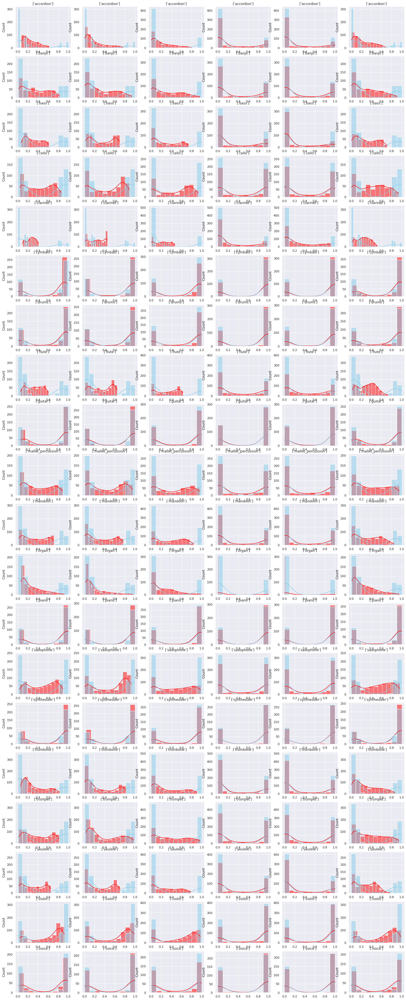

In [ ]:
# Compares the distribution of the predicted labels (red) vs the true lables (blue) for all the models (regression,regression_10s, classification_accuracy, classification_f1, 
# classification_f1_10s, and CNN, respectively)
import seaborn as sns
import matplotlib.pyplot as plt

#print("REGRESSION     REGRESSION_10S      CLASSIFICATION_ACCURACY    CLASSIFICATION_F1     CLASSIFICATION_F1_10S      CNN")

fig,axes = plt.subplots(nrows=20,ncols=6,sharex=False,sharey=False,figsize=(25,65))
#fig.suptitle('Regression VS Classification_accuracy VS Classification_F1',size=16)
i=0
for x in range(20):
    for y in range(6):
        keys = [k for k, v in class_map.items() if v == x]
        
        axes[x,y].set_title(keys)
        #print(keys)

        if y == 0:
          result = regression_results[keys[0]]
        elif y == 1:
          result = regression_results_10s[keys[0]]
        elif y == 2:
          result = classification_accuracy_results[keys[0]]
        elif y == 3:
          result = classification_f1_results[keys[0]]
        elif y == 4:
          result = classification_f1_results_10s[keys[0]]
        else:
          result = CNN_results[keys[0]]
        

        sns.set(style="darkgrid")

        sns.histplot( x=result["Y_pred_test"][0], color="red", label="Prediction", kde=True, ax=axes[x,y])
        sns.histplot( x=result["Y_true_test"], color="skyblue", label="True", kde=True, ax=axes[x,y])


        i+=1

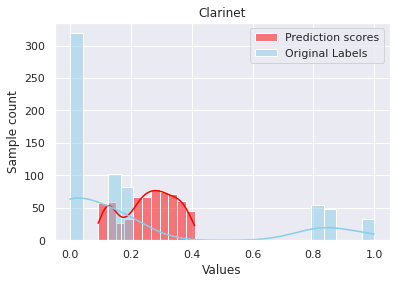

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

#print("REGRESSION     REGRESSION_10S      CLASSIFICATION_ACCURACY    CLASSIFICATION_F1     CLASSIFICATION_F1_10S      CNN")

#fig.suptitle('Regression VS Classification_accuracy VS Classification_F1',size=16)

#keys = [k for k, v in class_map.items() if v == x]

#axes[x,y].set_title(keys)
#print(keys)


result = regression_results["clarinet"]



sns.set(style="darkgrid")

ax = sns.histplot( x=result["Y_pred_test"][0], color="red", label="Prediction scores", kde=True)
sns.histplot( x=result["Y_true_test"], color="skyblue", label="Original Labels", kde=True, axes=ax)
ax.legend()
#ax.set_title("Clarinet")
ax.set(xlabel='Values', ylabel='Sample count', title="Clarinet")
plt.show()

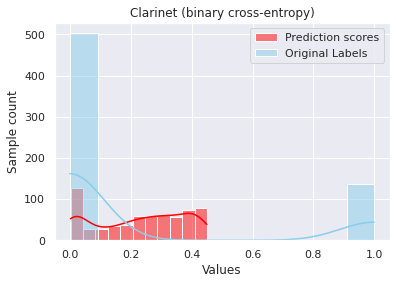

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

#print("REGRESSION     REGRESSION_10S      CLASSIFICATION_ACCURACY    CLASSIFICATION_F1     CLASSIFICATION_F1_10S      CNN")

#fig.suptitle('Regression VS Classification_accuracy VS Classification_F1',size=16)

#keys = [k for k, v in class_map.items() if v == x]

#axes[x,y].set_title(keys)
#print(keys)


result = classification_accuracy_results["clarinet"][0]



sns.set(style="darkgrid")

ax = sns.histplot( x=result["Y_pred_test"][0], color="red", label="Prediction scores", kde=True)
sns.histplot( x=result["Y_true_test"], color="skyblue", label="Original Labels", kde=True, axes=ax)
ax.legend()
#ax.set_title("Clarinet")
ax.set(xlabel='Values', ylabel='Sample count', title="Clarinet (binary cross-entropy)")
plt.show()

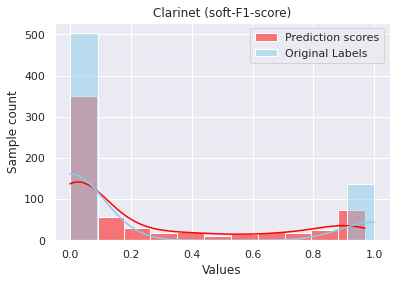

In [ ]:
import seaborn as sns
import matplotlib.pyplot as plt

#print("REGRESSION     REGRESSION_10S      CLASSIFICATION_ACCURACY    CLASSIFICATION_F1     CLASSIFICATION_F1_10S      CNN")

#fig.suptitle('Regression VS Classification_accuracy VS Classification_F1',size=16)

#keys = [k for k, v in class_map.items() if v == x]

#axes[x,y].set_title(keys)
#print(keys)


result = classification_f1_results["clarinet"]



sns.set(style="darkgrid")

ax = sns.histplot( x=result["Y_pred_test"][0], color="red", label="Prediction scores", kde=True)
sns.histplot( x=result["Y_true_test"], color="skyblue", label="Original Labels", kde=True, axes=ax)
ax.legend()
#ax.set_title("Clarinet")
ax.set(xlabel='Values', ylabel='Sample count', title="Clarinet (soft-F1-score)")
plt.show()

In [ ]:
threshold = compute_optimal_accuracy_threshold(Y_true_train_inst, Y_pred_train, instrument)

(562,)


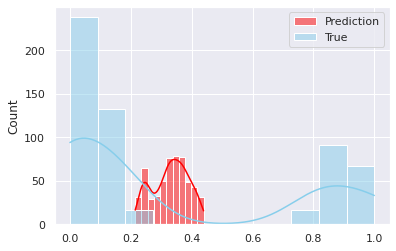

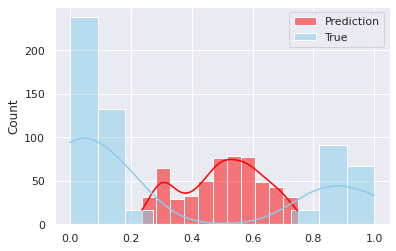

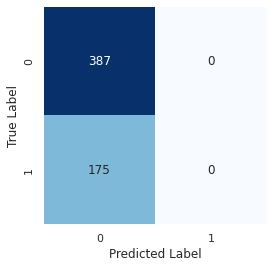

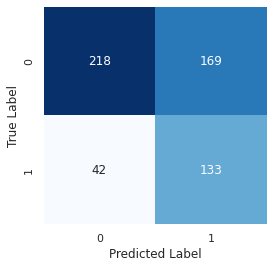

In [ ]:
result = regression_results_10s["flute"]
#result = regression_results["voice"]

#sns.set_style('darkgrid')
#sns.distplot(result["Y_pred_test"])

Y_pred_test = result["Y_pred_test"][0]
print(Y_pred_test.shape)

import seaborn as sns
import matplotlib.pyplot as plt

sns.set(style="darkgrid")

sns.histplot( x=result["Y_pred_test"][0], color="red", label="Prediction", kde=True)
sns.histplot( x=result["Y_true_test"], color="skyblue", label="True", kde=True)

plt.legend() 
plt.show()

#Y_pred_test_norm = preprocessing.normalize(Y_pred_test)
y_mean = np.mean(Y_pred_test)
y_max = max(Y_pred_test)
Y_pred_test_norm = ((Y_pred_test-y_mean)/y_max)+0.5


sns.set(style="darkgrid")

sns.histplot( x=Y_pred_test_norm, color="red", label="Prediction", kde=True)
sns.histplot( x=result["Y_true_test"], color="skyblue", label="True", kde=True)

plt.legend() 
plt.show()

cm = confusion_matrix(result["Y_true_test"].round(), result["Y_pred_test"][0].round())
plt.figure(figsize=(4,4))
sns.heatmap(cm, annot=True,  fmt='d', cmap=plt.cm.Blues, cbar=False)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

cm = confusion_matrix(result["Y_true_test"].round(), Y_pred_test_norm.round())
plt.figure(figsize=(4,4))
sns.heatmap(cm, annot=True,  fmt='d', cmap=plt.cm.Blues, cbar=False)
plt.xlabel('Predicted Label')
plt.ylabel('True Label')
plt.show()

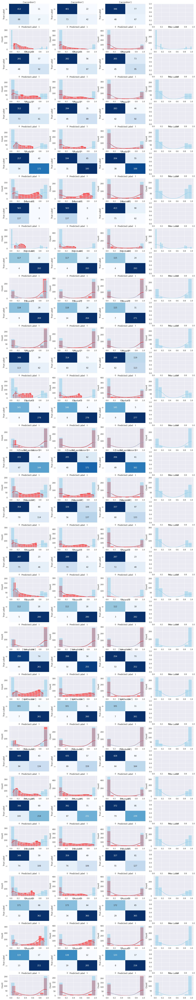

In [ ]:
fig,axes = plt.subplots(nrows=40,ncols=4,sharex=False,sharey=False,figsize=(20,110))
#fig.suptitle('Regression VS Classification_accuracy VS Classification_F1',size=16)
i=0

for x in range(40):
    for y in range(4):
        if i == 3 or i ==11 or i == 19 or i == 27 or i == 35 or i ==43 or i == 51 or i == 59 or i == 67 or i ==75 or i == 83 or i == 91 or i == 99 or i ==107 or i == 115 or i == 123 or i == 131 or i ==139 or i == 147 or i == 155:
          i+=1
          continue
        keys = [k for k, v in class_map.items() if v == round(x/2 - 0.01)]
        
        axes[x,y].set_title(keys)
        #print(keys)

        if y == 0:
          result = regression_results[keys[0]]
        elif y == 1:
          result = classification_accuracy_results[keys[0]]
        elif y == 2:
          result = classification_f1_results[keys[0]]
        else:
          result = regression_results[keys[0]]
          #axes[x,y].set_title("True label")
        
        if (x % 2):
          sns.set(style="darkgrid")

            
          if y == 3:
            sns.histplot( x=result["Y_true_test"], color="skyblue", label="True", kde=True, ax=axes[x,y])
            axes[x,y].set_title("True Label")
            #plt.legend()
          else:
            sns.histplot( x=result["Y_pred_test"][0], color="red", label="Prediction", kde=True, ax=axes[x,y])
            sns.histplot( x=result["Y_true_test"], color="skyblue", label="True", kde=True, ax=axes[x,y])
            axes[x,y].set_title("Predicted Label")
        else:

          cm = confusion_matrix(result["Y_true_test"].round(), result["Y_pred_test"][0].round())
          sns.heatmap(cm, annot=True,  fmt='d', cmap=plt.cm.Blues, cbar=False, ax=axes[x,y])
          
          if x == 19:
            axes[x,y].set_xlabel('Predicted Label') 
          axes[x,y].set_ylabel('True Label')

        i+=1

When analyzing the general confussion matrix, we have to consider at which family or sub-family of instruments belongs our target instrument.

1.   **Wind Family:**
*   Trumpet (Brass), Trombone (Brass)
*   Accordion, Organ
*   Clarinet (Woodwind), Flute (Woodwind), Saxophone (Woodwind)


2.   **Percusion  Family:**
*   Drums, Cymbals, Mallet percussion

3.   **String Family**
*   Guitar, Bass, Piano
*   Violin (Violin), Cello (Violin)

*   Mandolin (Lute), Banjo (Lute), Ukulele (Lute)


4. **Others:**
*   Synthesizer
*   Voice

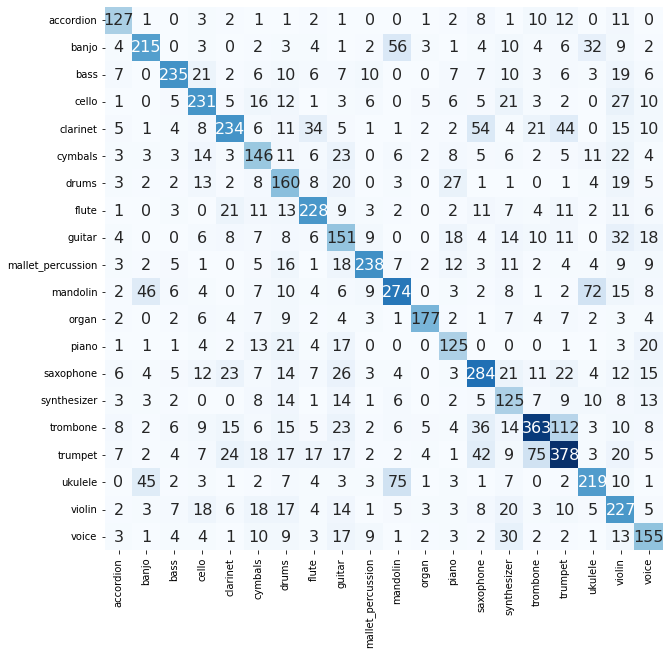

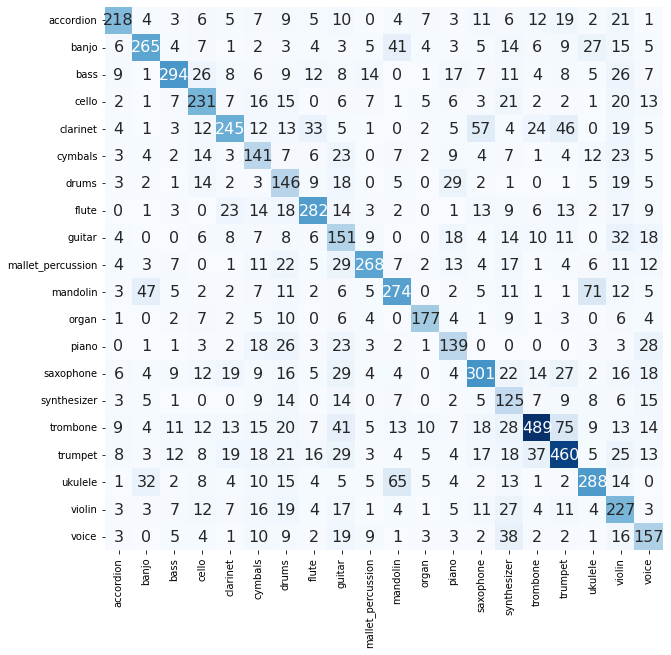

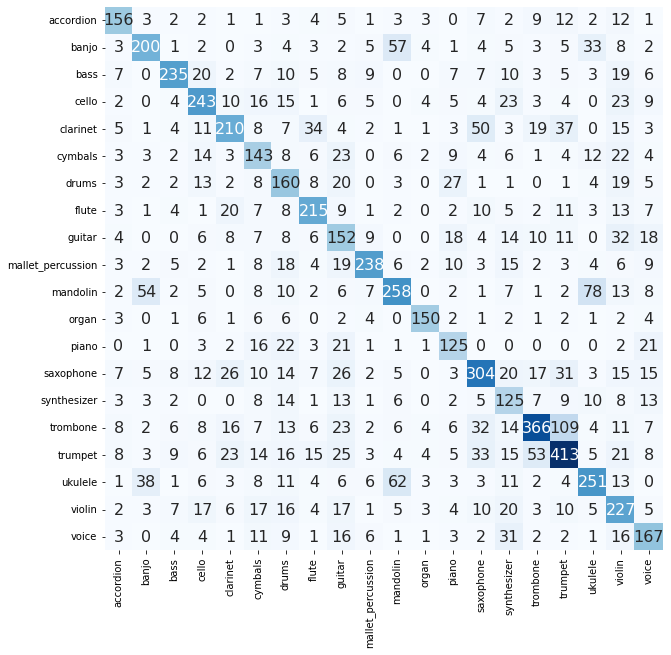

In [ ]:

def print_confussion_matrix(model_results):
  #20 x 20 confusion matrix
  conf_matrix = np.zeros((Y_true_test.shape[1],Y_true_test.shape[1]))

  for instrument in class_map:
      
      # Map the instrument name to its column number
      inst_num = class_map[instrument]

      keys = [k for k, v in class_map.items() if v == inst_num]
      result = model_results[keys[0]]
      Y_pred_test_inst = result["Y_pred_test"][0].round()
      
      count = 0
      
      for i in range(0,Y_true_test.shape[0]):

        if Y_true_test[i,inst_num] != 0.5:

          if Y_true_test[i,inst_num].round() == Y_pred_test_inst[count]:
            #print("ACIERTO")
            #conf_matrix[inst_num,inst_num] += 1
            continue
          else:
            #print("FALLO")
            conf_matrix[inst_num,inst_num] += 1
            for m in range(0,20):
              if (m != inst_num) and (Y_true_test[i,m] > 0.5):
                conf_matrix[inst_num,m] += 1

          
          count += 1  

  import seaborn as sn
  import pandas as pd
  import matplotlib.pyplot as plt

  #conf_matrix = track_errors_multilabel()

  df_cm = pd.DataFrame(conf_matrix, class_map.keys(), class_map.keys())
  plt.figure(figsize=(10,10))
  #sn.set(font_scale=1.4) # for label size
  sn.heatmap(df_cm, annot=True, annot_kws={"size": 16}, fmt='g', cmap=plt.cm.Blues, cbar=False) # font size
  #cmap=plt.cm.Blues,

  plt.show()     
     

print_confussion_matrix(regression_results)
print_confussion_matrix(classification_accuracy_results)
print_confussion_matrix(classification_f1_results)

### **Multilabel Analysis**

#### Auxiliary functions

In [ ]:
def get_accuracy_multilabel():
  total = 0
  aciertos_total = 0;
  for j in range(0,Y_true_test.shape[1]):
    keys = [k for k, v in class_map.items() if v == j]
    #print(keys)
    aciertos_inst = 0
    total_inst = 0
    for i in range(0,Y_true_test.shape[0]):
    
      if Y_true_test[i][j] != 0.5:
        total = total + 1
        total_inst = total_inst + 1
        #print("True: ", Y_true_test[i][j], "  Predicted: ", Y_pred_test[i][j].round())
        if Y_true_test[i][j].round() == Y_pred_test[i][j].round():
          #print("YES!!")
          aciertos_total = aciertos_total + 1
          aciertos_inst = aciertos_inst + 1
    print("Accuracy: ", aciertos_inst/total_inst, keys)

  print("Mean Accuracy: ", aciertos_total/total)


#### Code

In [ ]:
## MULTILABEL REGRESSION using all 10 seconds
from tensorflow import keras
#import tf.keras.Sequential
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.models import Model
from keras.optimizers import gradient_descent_v2
#from keras.optimizers import SGD
#from tensorflow.keras.optimizers import SGD
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline


#X_train_sklear = np.mean(X_train, axis=1)
#X_test_sklear = np.mean(X_test, axis=1)

X_train_sklear = X_train.reshape((X_train.shape[0],X_train.shape[1]*X_train.shape[2]))    
X_test_sklear = X_test.reshape((X_test.shape[0],X_test.shape[1]*X_test.shape[2]))

X_train_sklear_norm = preprocessing.normalize(X_train_sklear)
X_test_sklear_norm = preprocessing.normalize(X_test_sklear)



# Step 3.
# Initialize a new classifier
model = Sequential()
model.add(Dense(128, activation='relu', input_dim=X_train_sklear_norm.shape[1]))
model.add(Dropout(0.5))
model.add(Dense(32, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(Y_true_train.shape[1], activation='sigmoid'))
#model.add(Dense(1, activation='sigmoid'))


sgd = gradient_descent_v2.SGD(learning_rate=0.01, decay=1e-6, momentum=0.9, nesterov=True)


model.compile(loss='mse',
              optimizer=sgd,
              metrics=['mse'])

model.summary()

# Step 4.
history = model.fit(X_train_sklear_norm, Y_true_train,
      epochs=120,
      batch_size=128,
      validation_data=(X_test_sklear_norm, Y_true_test),
      verbose=0)


# Step 5.
# Finally, we'll evaluate the model on both train and test
Y_pred_train = model.predict(X_train_sklear_norm)
Y_pred_test = model.predict(X_test_sklear_norm)

print()
track_errors_multilabel()
get_accuracy_multilabel()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense (Dense)               (None, 128)               163968    
                                                                 
 dropout (Dropout)           (None, 128)               0         
                                                                 
 dense_1 (Dense)             (None, 32)                4128      
                                                                 
 dropout_1 (Dropout)         (None, 32)                0         
                                                                 
 dense_2 (Dense)             (None, 20)                660       
                                                                 
Total params: 168,756
Trainable params: 168,756
Non-trainable params: 0
_________________________________________________________________
159/159 [==============================] - 0s 2ms/

True (5085, 20)
Pred (5085, 20)
(538,)
(538,)
[0.15515 0.16665 0.      0.      0.     ]
[0.47438043 0.47326666 0.47453684 0.47551885 0.47571346]


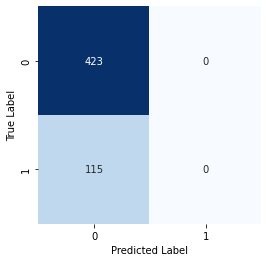

(478,)
(478,)
[0.      0.      0.84495 0.15635 0.83055]
[0.4840619  0.4817103  0.48510075 0.4816129  0.48304158]


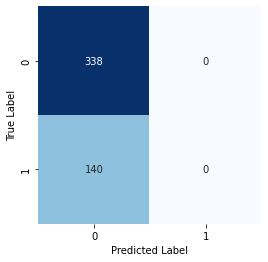

(463,)
(463,)
[1.      1.      0.17255 0.84    1.     ]
[0.48220888 0.48153302 0.48290604 0.4840214  0.48373806]


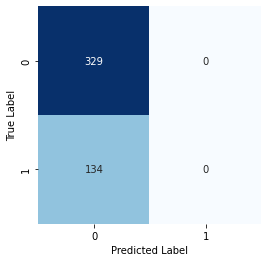

(485,)
(485,)
[0. 0. 0. 1. 0.]
[0.49029964 0.49323887 0.4900022  0.490641   0.49035403]


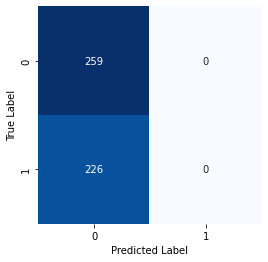

(640,)
(640,)
[0.8242 0.1547 0.1555 0.     0.8279]
[0.47091743 0.46943766 0.4712264  0.4696958  0.4697518 ]


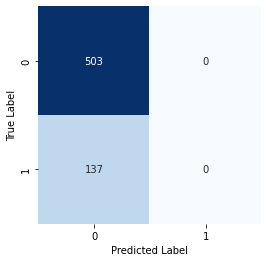

(436,)
(436,)
[1. 1. 1. 1. 1.]
[0.5139682  0.51259404 0.5110582  0.5134801  0.5144258 ]


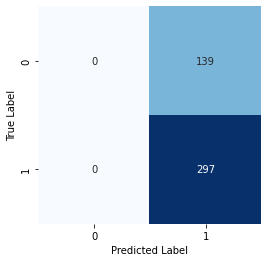

(424,)
(424,)
[0.8227  0.15625 0.      1.      1.     ]
[0.5109373  0.5096365  0.5100539  0.50977325 0.5119051 ]


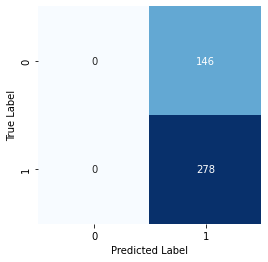

(562,)
(562,)
[0.16195 0.15825 1.      0.      0.169  ]
[0.4817763  0.4813158  0.47988883 0.48006356 0.47892234]


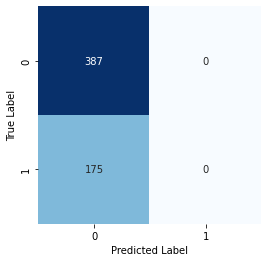

(436,)
(436,)
[0. 0. 0. 1. 1.]
[0.5158275  0.5166942  0.51463974 0.5178079  0.5163823 ]


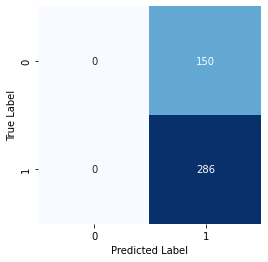

(478,)
(478,)
[0. 1. 0. 0. 1.]
[0.49149525 0.49318346 0.4921721  0.49141032 0.4914078 ]


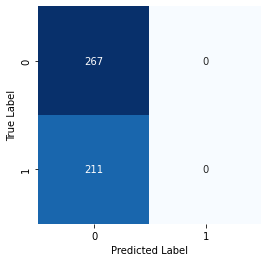

(627,)
(627,)
[0.     0.1715 0.     0.     0.    ]
[0.48165518 0.48468894 0.48219612 0.48310485 0.48107168]


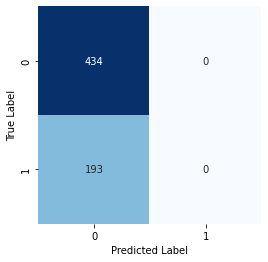

(431,)
(431,)
[0.      0.1511  0.1607  0.82755 0.     ]
[0.48352784 0.4861369  0.4851517  0.48770648 0.48573065]


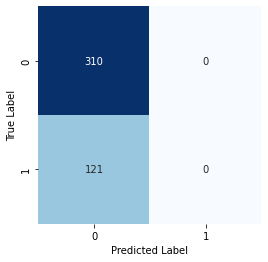

(415,)
(415,)
[0.     0.1574 0.     0.     0.    ]
[0.5137263  0.51614344 0.5158634  0.5156714  0.51644135]


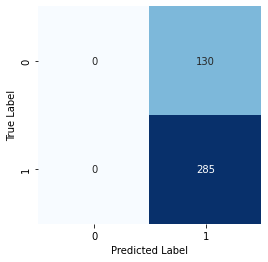

(629,)
(629,)
[0.      0.83005 0.      0.      0.     ]
[0.4999235  0.4979779  0.4979068  0.50029314 0.4972758 ]


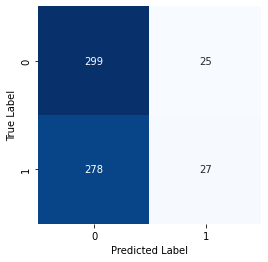

(380,)
(380,)
[1.      0.83335 1.      0.8269  1.     ]
[0.51404065 0.5171988  0.51455355 0.51722735 0.51656026]


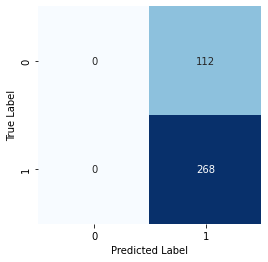

(720,)
(720,)
[0.      0.      0.16665 0.      1.     ]
[0.47382107 0.47507608 0.47269174 0.4769303  0.47622225]


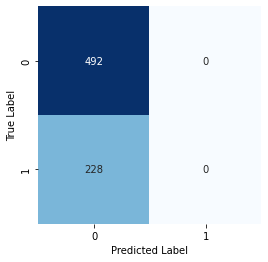

(785,)
(785,)
[0.1677  0.      0.      0.      0.85105]
[0.4854204  0.4834256  0.48302668 0.4846767  0.485366  ]


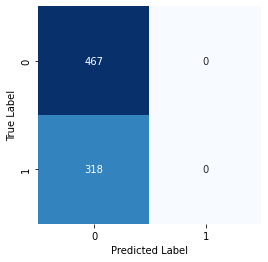

(590,)
(590,)
[1.     0.     0.1875 0.     0.    ]
[0.4760731  0.47782716 0.47692364 0.47749937 0.4768428 ]


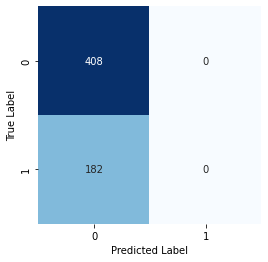

(631,)
(631,)
[0.1793  0.1757  1.      0.      0.17085]
[0.5028732  0.5074472  0.50622976 0.5050551  0.5032401 ]


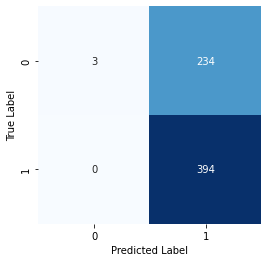

(374,)
(374,)
[1. 0. 1. 1. 1.]
[0.5182476  0.50947833 0.5158705  0.51293415 0.5090697 ]


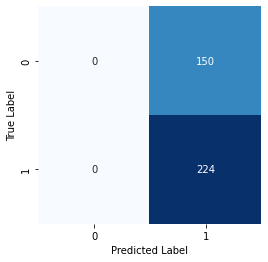

In [ ]:
from sklearn.metrics import confusion_matrix
import seaborn as sns

print("True",Y_true_test.shape)
print("Pred",Y_pred_test.shape)

for instrument in class_map:
    
    # Map the instrument name to its column number
    inst_num = class_map[instrument]
        
    # Step 1: sub-sample the data
    
    # First, we need to select down to the data for which we have annotations
    # This is what the mask arrays are for
    test_indexes = Y_mask_test[:, inst_num]

    Y_true_test_inst = Y_true_test[test_indexes, inst_num]
    Y_pred_test_inst = Y_pred_test[test_indexes, inst_num]

    print(Y_true_test_inst.shape)
    print(Y_pred_test_inst.shape)
    print(Y_true_test_inst[0:5])
    print(Y_pred_test_inst[0:5])

    #Confusion Matrix
    cm = confusion_matrix(np.round(Y_true_test_inst), np.round(Y_pred_test_inst))
    plt.figure(figsize=(4,4))
    sns.heatmap(cm, annot=True,  fmt='d', cmap=plt.cm.Blues, cbar=False)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.show()






In [ ]:
## MULTILABEL REGRESSION
from tensorflow import keras
#import tf.keras.Sequential
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.models import Model
from keras.optimizers import gradient_descent_v2
#from keras.optimizers import SGD
#from tensorflow.keras.optimizers import SGD
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline


X_train_sklear = np.mean(X_train, axis=1)
X_test_sklear = np.mean(X_test, axis=1)

X_train_sklear_norm = preprocessing.normalize(X_train_sklear)
X_test_sklear_norm = preprocessing.normalize(X_test_sklear)


# Step 3.
# Initialize a new classifier
model = Sequential()
model.add(Dense(128, activation='relu', input_dim=X_train_inst_sklearn.shape[1]))
model.add(Dropout(0.5))
model.add(Dense(32, activation='relu'))
model.add(Dropout(0.5))
model.add(Dense(Y_true_train.shape[1], activation='sigmoid'))
#model.add(Dense(1, activation='sigmoid'))


sgd = gradient_descent_v2.SGD(learning_rate=0.01, decay=1e-6, momentum=0.9, nesterov=True)


model.compile(loss='mse',
              optimizer=sgd,
              metrics=['mse'])

model.summary()

# Step 4.
history = model.fit(X_train_sklear_norm, Y_true_train,
      epochs=120,
      batch_size=128,
      validation_data=(X_test_sklear_norm, Y_true_test),
      verbose=0)


# Step 5.
# Finally, we'll evaluate the model on both train and test
Y_pred_train = model.predict(X_train_sklear_norm)
Y_pred_test = model.predict(X_test_sklear_norm)

print()
get_accuracy_multilabel()


## **2- CONVOLUTIONAL NEURAL NETWORK (CNN)**

Model: "sequential_111"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_111 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_111 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_111 (Flatten)       (None, 744)               0         
                                                                 
 dense_222 (Dense)           (None, 32)                23840     
                                                                 
 dropout_111 (Dropout)       (None, 32)                0         
                                                                 
 dense_223 (Dense)           (None, 1)                 33        
                                                    

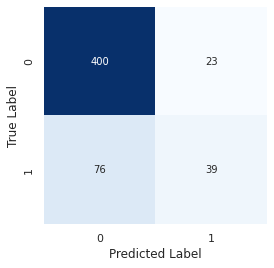

Model: "sequential_112"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_112 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_112 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_112 (Flatten)       (None, 744)               0         
                                                                 
 dense_224 (Dense)           (None, 32)                23840     
                                                                 
 dropout_112 (Dropout)       (None, 32)                0         
                                                                 
 dense_225 (Dense)           (None, 1)                 33        
                                                    

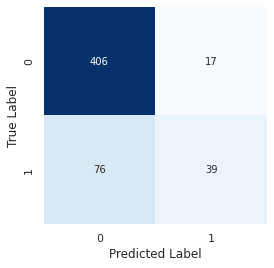

Model: "sequential_113"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_113 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_113 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_113 (Flatten)       (None, 744)               0         
                                                                 
 dense_226 (Dense)           (None, 32)                23840     
                                                                 
 dropout_113 (Dropout)       (None, 32)                0         
                                                                 
 dense_227 (Dense)           (None, 1)                 33        
                                                    

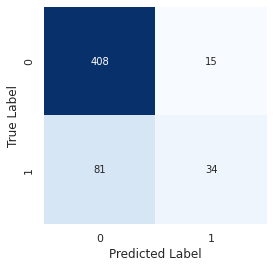

Model: "sequential_114"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_114 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_114 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_114 (Flatten)       (None, 744)               0         
                                                                 
 dense_228 (Dense)           (None, 32)                23840     
                                                                 
 dropout_114 (Dropout)       (None, 32)                0         
                                                                 
 dense_229 (Dense)           (None, 1)                 33        
                                                    

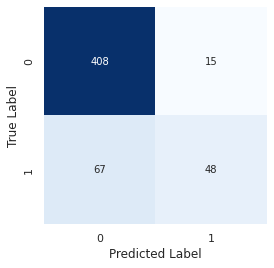

Model: "sequential_115"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_115 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_115 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_115 (Flatten)       (None, 744)               0         
                                                                 
 dense_230 (Dense)           (None, 32)                23840     
                                                                 
 dropout_115 (Dropout)       (None, 32)                0         
                                                                 
 dense_231 (Dense)           (None, 1)                 33        
                                                    

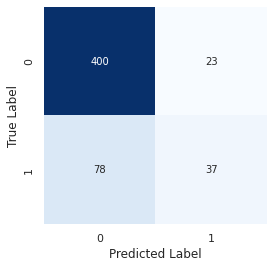

Model: "sequential_116"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_116 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_116 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_116 (Flatten)       (None, 744)               0         
                                                                 
 dense_232 (Dense)           (None, 32)                23840     
                                                                 
 dropout_116 (Dropout)       (None, 32)                0         
                                                                 
 dense_233 (Dense)           (None, 1)                 33        
                                                    

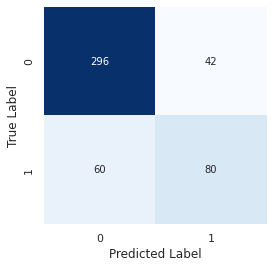

Model: "sequential_117"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_117 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_117 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_117 (Flatten)       (None, 744)               0         
                                                                 
 dense_234 (Dense)           (None, 32)                23840     
                                                                 
 dropout_117 (Dropout)       (None, 32)                0         
                                                                 
 dense_235 (Dense)           (None, 1)                 33        
                                                    

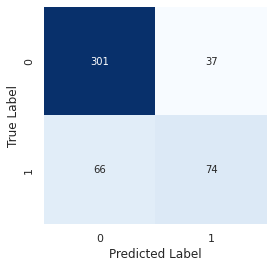

Model: "sequential_118"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_118 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_118 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_118 (Flatten)       (None, 744)               0         
                                                                 
 dense_236 (Dense)           (None, 32)                23840     
                                                                 
 dropout_118 (Dropout)       (None, 32)                0         
                                                                 
 dense_237 (Dense)           (None, 1)                 33        
                                                    

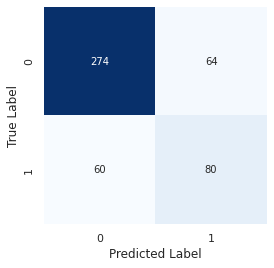

Model: "sequential_119"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_119 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_119 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_119 (Flatten)       (None, 744)               0         
                                                                 
 dense_238 (Dense)           (None, 32)                23840     
                                                                 
 dropout_119 (Dropout)       (None, 32)                0         
                                                                 
 dense_239 (Dense)           (None, 1)                 33        
                                                    

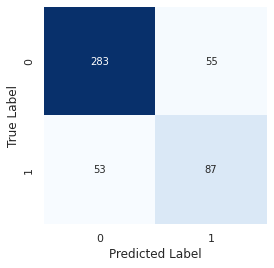

Model: "sequential_120"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_120 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_120 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_120 (Flatten)       (None, 744)               0         
                                                                 
 dense_240 (Dense)           (None, 32)                23840     
                                                                 
 dropout_120 (Dropout)       (None, 32)                0         
                                                                 
 dense_241 (Dense)           (None, 1)                 33        
                                                    

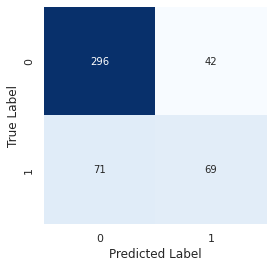

Model: "sequential_121"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_121 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_121 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_121 (Flatten)       (None, 744)               0         
                                                                 
 dense_242 (Dense)           (None, 32)                23840     
                                                                 
 dropout_121 (Dropout)       (None, 32)                0         
                                                                 
 dense_243 (Dense)           (None, 1)                 33        
                                                    

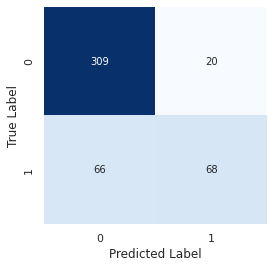

Model: "sequential_122"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_122 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_122 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_122 (Flatten)       (None, 744)               0         
                                                                 
 dense_244 (Dense)           (None, 32)                23840     
                                                                 
 dropout_122 (Dropout)       (None, 32)                0         
                                                                 
 dense_245 (Dense)           (None, 1)                 33        
                                                    

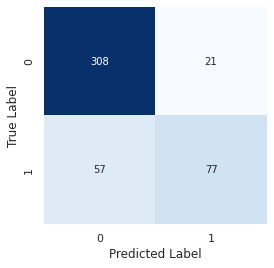

Model: "sequential_123"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_123 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_123 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_123 (Flatten)       (None, 744)               0         
                                                                 
 dense_246 (Dense)           (None, 32)                23840     
                                                                 
 dropout_123 (Dropout)       (None, 32)                0         
                                                                 
 dense_247 (Dense)           (None, 1)                 33        
                                                    

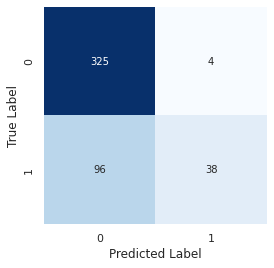

Model: "sequential_124"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_124 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_124 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_124 (Flatten)       (None, 744)               0         
                                                                 
 dense_248 (Dense)           (None, 32)                23840     
                                                                 
 dropout_124 (Dropout)       (None, 32)                0         
                                                                 
 dense_249 (Dense)           (None, 1)                 33        
                                                    

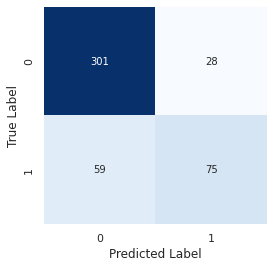

Model: "sequential_125"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_125 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_125 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_125 (Flatten)       (None, 744)               0         
                                                                 
 dense_250 (Dense)           (None, 32)                23840     
                                                                 
 dropout_125 (Dropout)       (None, 32)                0         
                                                                 
 dense_251 (Dense)           (None, 1)                 33        
                                                    

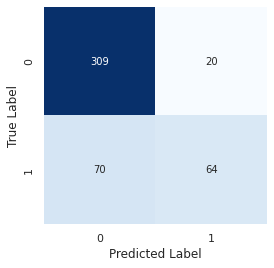

Model: "sequential_126"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_126 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_126 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_126 (Flatten)       (None, 744)               0         
                                                                 
 dense_252 (Dense)           (None, 32)                23840     
                                                                 
 dropout_126 (Dropout)       (None, 32)                0         
                                                                 
 dense_253 (Dense)           (None, 1)                 33        
                                                    

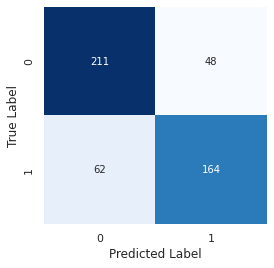

Model: "sequential_127"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_127 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_127 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_127 (Flatten)       (None, 744)               0         
                                                                 
 dense_254 (Dense)           (None, 32)                23840     
                                                                 
 dropout_127 (Dropout)       (None, 32)                0         
                                                                 
 dense_255 (Dense)           (None, 1)                 33        
                                                    

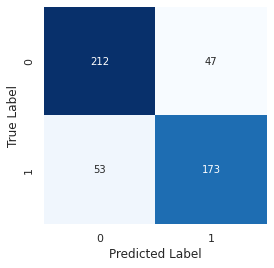

Model: "sequential_128"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_128 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_128 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_128 (Flatten)       (None, 744)               0         
                                                                 
 dense_256 (Dense)           (None, 32)                23840     
                                                                 
 dropout_128 (Dropout)       (None, 32)                0         
                                                                 
 dense_257 (Dense)           (None, 1)                 33        
                                                    

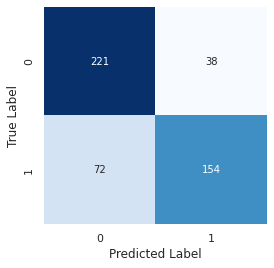

Model: "sequential_129"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_129 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_129 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_129 (Flatten)       (None, 744)               0         
                                                                 
 dense_258 (Dense)           (None, 32)                23840     
                                                                 
 dropout_129 (Dropout)       (None, 32)                0         
                                                                 
 dense_259 (Dense)           (None, 1)                 33        
                                                    

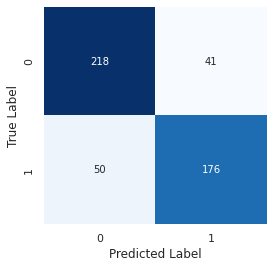

Model: "sequential_130"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_130 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_130 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_130 (Flatten)       (None, 744)               0         
                                                                 
 dense_260 (Dense)           (None, 32)                23840     
                                                                 
 dropout_130 (Dropout)       (None, 32)                0         
                                                                 
 dense_261 (Dense)           (None, 1)                 33        
                                                    

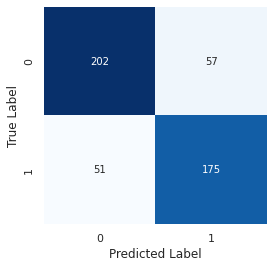

Model: "sequential_131"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_131 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_131 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_131 (Flatten)       (None, 744)               0         
                                                                 
 dense_262 (Dense)           (None, 32)                23840     
                                                                 
 dropout_131 (Dropout)       (None, 32)                0         
                                                                 
 dense_263 (Dense)           (None, 1)                 33        
                                                    

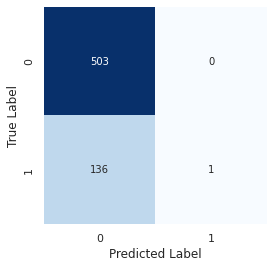

Model: "sequential_132"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_132 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_132 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_132 (Flatten)       (None, 744)               0         
                                                                 
 dense_264 (Dense)           (None, 32)                23840     
                                                                 
 dropout_132 (Dropout)       (None, 32)                0         
                                                                 
 dense_265 (Dense)           (None, 1)                 33        
                                                    

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

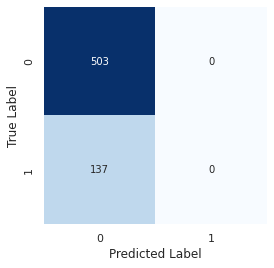

Model: "sequential_133"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_133 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_133 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_133 (Flatten)       (None, 744)               0         
                                                                 
 dense_266 (Dense)           (None, 32)                23840     
                                                                 
 dropout_133 (Dropout)       (None, 32)                0         
                                                                 
 dense_267 (Dense)           (None, 1)                 33        
                                                    

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

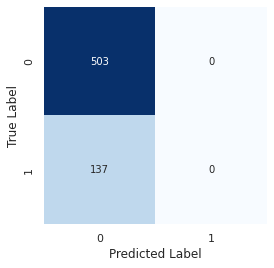

Model: "sequential_134"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_134 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_134 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_134 (Flatten)       (None, 744)               0         
                                                                 
 dense_268 (Dense)           (None, 32)                23840     
                                                                 
 dropout_134 (Dropout)       (None, 32)                0         
                                                                 
 dense_269 (Dense)           (None, 1)                 33        
                                                    

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

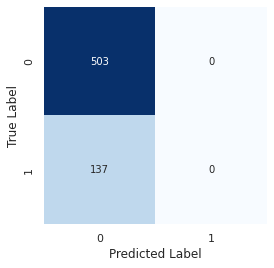

Model: "sequential_135"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_135 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_135 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_135 (Flatten)       (None, 744)               0         
                                                                 
 dense_270 (Dense)           (None, 32)                23840     
                                                                 
 dropout_135 (Dropout)       (None, 32)                0         
                                                                 
 dense_271 (Dense)           (None, 1)                 33        
                                                    

/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/usr/local/lib/python3.8/dist-packages/sklearn/metrics/_classificat

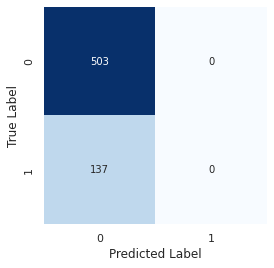

Model: "sequential_136"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_136 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_136 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_136 (Flatten)       (None, 744)               0         
                                                                 
 dense_272 (Dense)           (None, 32)                23840     
                                                                 
 dropout_136 (Dropout)       (None, 32)                0         
                                                                 
 dense_273 (Dense)           (None, 1)                 33        
                                                    

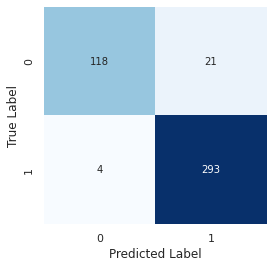

Model: "sequential_137"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_137 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_137 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_137 (Flatten)       (None, 744)               0         
                                                                 
 dense_274 (Dense)           (None, 32)                23840     
                                                                 
 dropout_137 (Dropout)       (None, 32)                0         
                                                                 
 dense_275 (Dense)           (None, 1)                 33        
                                                    

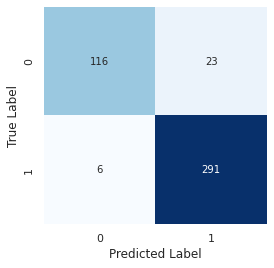

Model: "sequential_138"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_138 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_138 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_138 (Flatten)       (None, 744)               0         
                                                                 
 dense_276 (Dense)           (None, 32)                23840     
                                                                 
 dropout_138 (Dropout)       (None, 32)                0         
                                                                 
 dense_277 (Dense)           (None, 1)                 33        
                                                    

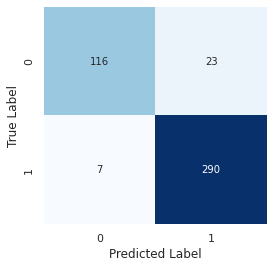

Model: "sequential_139"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_139 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_139 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_139 (Flatten)       (None, 744)               0         
                                                                 
 dense_278 (Dense)           (None, 32)                23840     
                                                                 
 dropout_139 (Dropout)       (None, 32)                0         
                                                                 
 dense_279 (Dense)           (None, 1)                 33        
                                                    

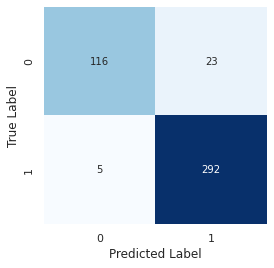

Model: "sequential_140"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_140 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_140 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_140 (Flatten)       (None, 744)               0         
                                                                 
 dense_280 (Dense)           (None, 32)                23840     
                                                                 
 dropout_140 (Dropout)       (None, 32)                0         
                                                                 
 dense_281 (Dense)           (None, 1)                 33        
                                                    

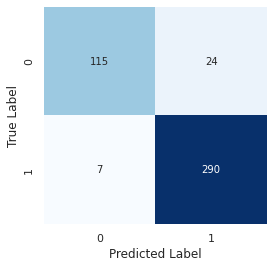

Model: "sequential_141"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_141 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_141 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_141 (Flatten)       (None, 744)               0         
                                                                 
 dense_282 (Dense)           (None, 32)                23840     
                                                                 
 dropout_141 (Dropout)       (None, 32)                0         
                                                                 
 dense_283 (Dense)           (None, 1)                 33        
                                                    

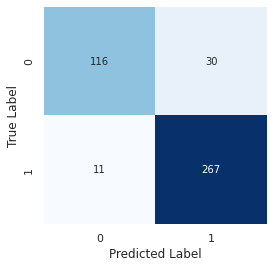

Model: "sequential_142"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_142 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_142 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_142 (Flatten)       (None, 744)               0         
                                                                 
 dense_284 (Dense)           (None, 32)                23840     
                                                                 
 dropout_142 (Dropout)       (None, 32)                0         
                                                                 
 dense_285 (Dense)           (None, 1)                 33        
                                                    

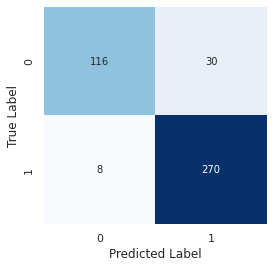

Model: "sequential_143"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_143 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_143 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_143 (Flatten)       (None, 744)               0         
                                                                 
 dense_286 (Dense)           (None, 32)                23840     
                                                                 
 dropout_143 (Dropout)       (None, 32)                0         
                                                                 
 dense_287 (Dense)           (None, 1)                 33        
                                                    

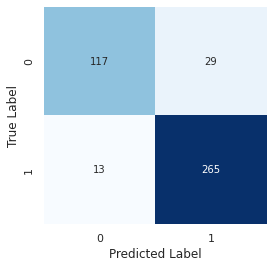

Model: "sequential_144"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_144 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_144 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_144 (Flatten)       (None, 744)               0         
                                                                 
 dense_288 (Dense)           (None, 32)                23840     
                                                                 
 dropout_144 (Dropout)       (None, 32)                0         
                                                                 
 dense_289 (Dense)           (None, 1)                 33        
                                                    

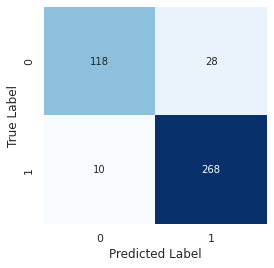

Model: "sequential_145"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_145 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_145 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_145 (Flatten)       (None, 744)               0         
                                                                 
 dense_290 (Dense)           (None, 32)                23840     
                                                                 
 dropout_145 (Dropout)       (None, 32)                0         
                                                                 
 dense_291 (Dense)           (None, 1)                 33        
                                                    

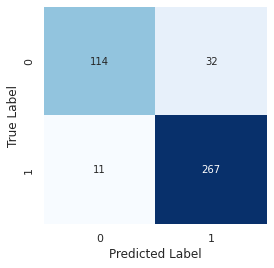

Model: "sequential_146"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_146 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_146 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_146 (Flatten)       (None, 744)               0         
                                                                 
 dense_292 (Dense)           (None, 32)                23840     
                                                                 
 dropout_146 (Dropout)       (None, 32)                0         
                                                                 
 dense_293 (Dense)           (None, 1)                 33        
                                                    

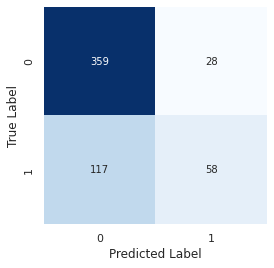

Model: "sequential_147"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_147 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_147 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_147 (Flatten)       (None, 744)               0         
                                                                 
 dense_294 (Dense)           (None, 32)                23840     
                                                                 
 dropout_147 (Dropout)       (None, 32)                0         
                                                                 
 dense_295 (Dense)           (None, 1)                 33        
                                                    

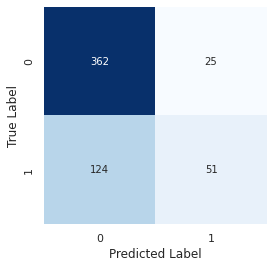

Model: "sequential_148"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_148 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_148 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_148 (Flatten)       (None, 744)               0         
                                                                 
 dense_296 (Dense)           (None, 32)                23840     
                                                                 
 dropout_148 (Dropout)       (None, 32)                0         
                                                                 
 dense_297 (Dense)           (None, 1)                 33        
                                                    

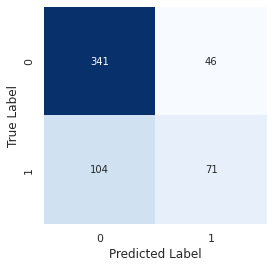

Model: "sequential_149"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_149 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_149 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_149 (Flatten)       (None, 744)               0         
                                                                 
 dense_298 (Dense)           (None, 32)                23840     
                                                                 
 dropout_149 (Dropout)       (None, 32)                0         
                                                                 
 dense_299 (Dense)           (None, 1)                 33        
                                                    

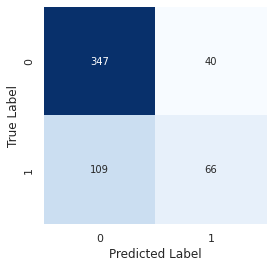

Model: "sequential_150"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_150 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_150 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_150 (Flatten)       (None, 744)               0         
                                                                 
 dense_300 (Dense)           (None, 32)                23840     
                                                                 
 dropout_150 (Dropout)       (None, 32)                0         
                                                                 
 dense_301 (Dense)           (None, 1)                 33        
                                                    

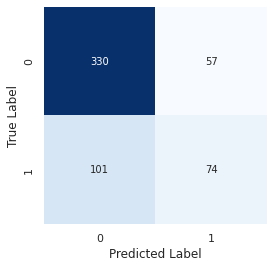

Model: "sequential_151"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_151 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_151 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_151 (Flatten)       (None, 744)               0         
                                                                 
 dense_302 (Dense)           (None, 32)                23840     
                                                                 
 dropout_151 (Dropout)       (None, 32)                0         
                                                                 
 dense_303 (Dense)           (None, 1)                 33        
                                                    

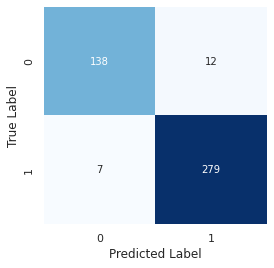

Model: "sequential_152"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_152 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_152 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_152 (Flatten)       (None, 744)               0         
                                                                 
 dense_304 (Dense)           (None, 32)                23840     
                                                                 
 dropout_152 (Dropout)       (None, 32)                0         
                                                                 
 dense_305 (Dense)           (None, 1)                 33        
                                                    

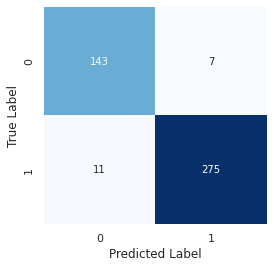

Model: "sequential_153"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_153 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_153 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_153 (Flatten)       (None, 744)               0         
                                                                 
 dense_306 (Dense)           (None, 32)                23840     
                                                                 
 dropout_153 (Dropout)       (None, 32)                0         
                                                                 
 dense_307 (Dense)           (None, 1)                 33        
                                                    

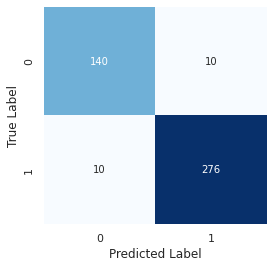

Model: "sequential_154"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_154 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_154 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_154 (Flatten)       (None, 744)               0         
                                                                 
 dense_308 (Dense)           (None, 32)                23840     
                                                                 
 dropout_154 (Dropout)       (None, 32)                0         
                                                                 
 dense_309 (Dense)           (None, 1)                 33        
                                                    

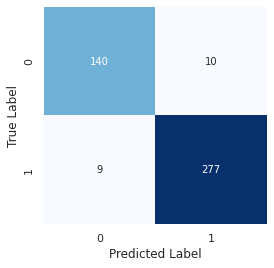

Model: "sequential_155"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_155 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_155 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_155 (Flatten)       (None, 744)               0         
                                                                 
 dense_310 (Dense)           (None, 32)                23840     
                                                                 
 dropout_155 (Dropout)       (None, 32)                0         
                                                                 
 dense_311 (Dense)           (None, 1)                 33        
                                                    

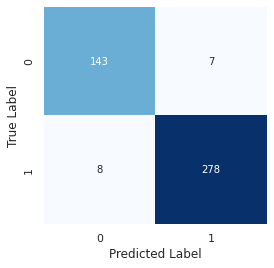

Model: "sequential_156"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_156 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_156 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_156 (Flatten)       (None, 744)               0         
                                                                 
 dense_312 (Dense)           (None, 32)                23840     
                                                                 
 dropout_156 (Dropout)       (None, 32)                0         
                                                                 
 dense_313 (Dense)           (None, 1)                 33        
                                                    

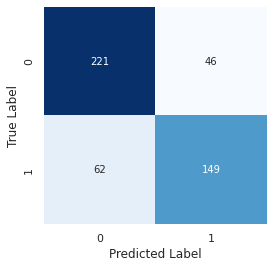

Model: "sequential_157"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_157 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_157 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_157 (Flatten)       (None, 744)               0         
                                                                 
 dense_314 (Dense)           (None, 32)                23840     
                                                                 
 dropout_157 (Dropout)       (None, 32)                0         
                                                                 
 dense_315 (Dense)           (None, 1)                 33        
                                                    

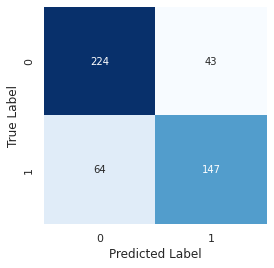

Model: "sequential_158"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_158 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_158 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_158 (Flatten)       (None, 744)               0         
                                                                 
 dense_316 (Dense)           (None, 32)                23840     
                                                                 
 dropout_158 (Dropout)       (None, 32)                0         
                                                                 
 dense_317 (Dense)           (None, 1)                 33        
                                                    

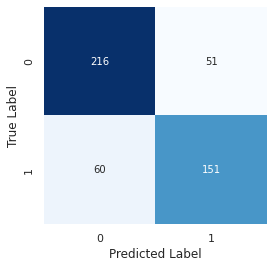

Model: "sequential_159"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_159 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_159 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_159 (Flatten)       (None, 744)               0         
                                                                 
 dense_318 (Dense)           (None, 32)                23840     
                                                                 
 dropout_159 (Dropout)       (None, 32)                0         
                                                                 
 dense_319 (Dense)           (None, 1)                 33        
                                                    

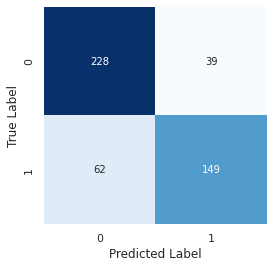

Model: "sequential_160"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_160 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_160 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_160 (Flatten)       (None, 744)               0         
                                                                 
 dense_320 (Dense)           (None, 32)                23840     
                                                                 
 dropout_160 (Dropout)       (None, 32)                0         
                                                                 
 dense_321 (Dense)           (None, 1)                 33        
                                                    

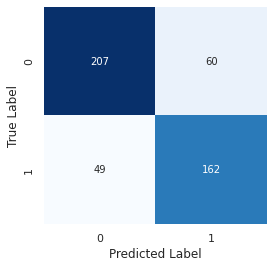

Model: "sequential_161"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_161 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_161 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_161 (Flatten)       (None, 744)               0         
                                                                 
 dense_322 (Dense)           (None, 32)                23840     
                                                                 
 dropout_161 (Dropout)       (None, 32)                0         
                                                                 
 dense_323 (Dense)           (None, 1)                 33        
                                                    

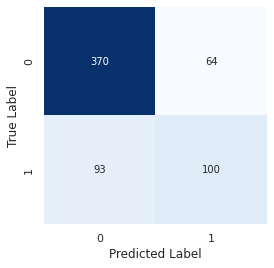

Model: "sequential_162"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_162 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_162 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_162 (Flatten)       (None, 744)               0         
                                                                 
 dense_324 (Dense)           (None, 32)                23840     
                                                                 
 dropout_162 (Dropout)       (None, 32)                0         
                                                                 
 dense_325 (Dense)           (None, 1)                 33        
                                                    

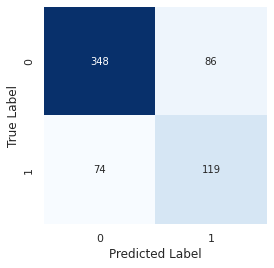

Model: "sequential_163"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_163 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_163 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_163 (Flatten)       (None, 744)               0         
                                                                 
 dense_326 (Dense)           (None, 32)                23840     
                                                                 
 dropout_163 (Dropout)       (None, 32)                0         
                                                                 
 dense_327 (Dense)           (None, 1)                 33        
                                                    

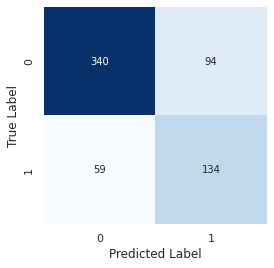

Model: "sequential_164"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_164 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_164 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_164 (Flatten)       (None, 744)               0         
                                                                 
 dense_328 (Dense)           (None, 32)                23840     
                                                                 
 dropout_164 (Dropout)       (None, 32)                0         
                                                                 
 dense_329 (Dense)           (None, 1)                 33        
                                                    

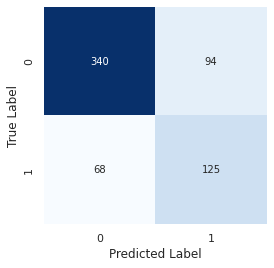

Model: "sequential_165"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_165 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_165 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_165 (Flatten)       (None, 744)               0         
                                                                 
 dense_330 (Dense)           (None, 32)                23840     
                                                                 
 dropout_165 (Dropout)       (None, 32)                0         
                                                                 
 dense_331 (Dense)           (None, 1)                 33        
                                                    

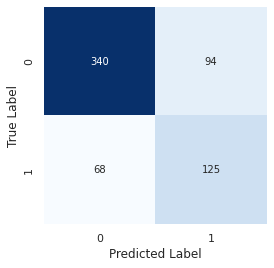

Model: "sequential_166"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_166 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_166 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_166 (Flatten)       (None, 744)               0         
                                                                 
 dense_332 (Dense)           (None, 32)                23840     
                                                                 
 dropout_166 (Dropout)       (None, 32)                0         
                                                                 
 dense_333 (Dense)           (None, 1)                 33        
                                                    

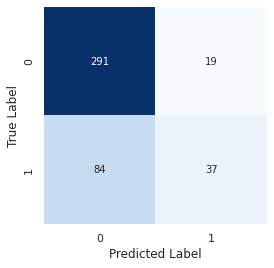

Model: "sequential_167"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_167 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_167 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_167 (Flatten)       (None, 744)               0         
                                                                 
 dense_334 (Dense)           (None, 32)                23840     
                                                                 
 dropout_167 (Dropout)       (None, 32)                0         
                                                                 
 dense_335 (Dense)           (None, 1)                 33        
                                                    

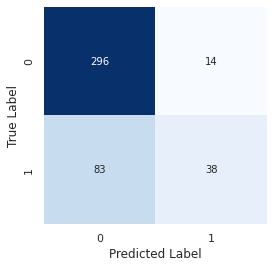

Model: "sequential_168"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_168 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_168 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_168 (Flatten)       (None, 744)               0         
                                                                 
 dense_336 (Dense)           (None, 32)                23840     
                                                                 
 dropout_168 (Dropout)       (None, 32)                0         
                                                                 
 dense_337 (Dense)           (None, 1)                 33        
                                                    

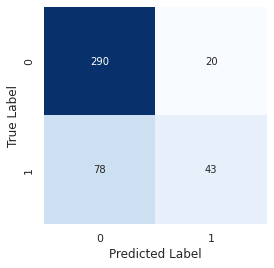

Model: "sequential_169"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_169 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_169 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_169 (Flatten)       (None, 744)               0         
                                                                 
 dense_338 (Dense)           (None, 32)                23840     
                                                                 
 dropout_169 (Dropout)       (None, 32)                0         
                                                                 
 dense_339 (Dense)           (None, 1)                 33        
                                                    

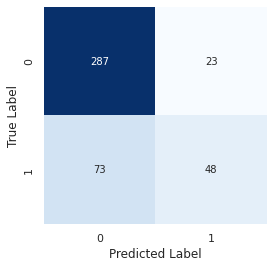

Model: "sequential_170"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_170 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_170 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_170 (Flatten)       (None, 744)               0         
                                                                 
 dense_340 (Dense)           (None, 32)                23840     
                                                                 
 dropout_170 (Dropout)       (None, 32)                0         
                                                                 
 dense_341 (Dense)           (None, 1)                 33        
                                                    

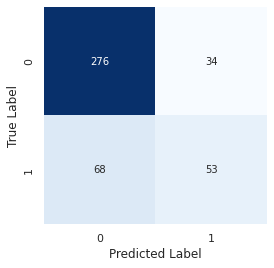

Model: "sequential_171"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_171 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_171 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_171 (Flatten)       (None, 744)               0         
                                                                 
 dense_342 (Dense)           (None, 32)                23840     
                                                                 
 dropout_171 (Dropout)       (None, 32)                0         
                                                                 
 dense_343 (Dense)           (None, 1)                 33        
                                                    

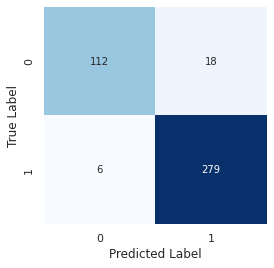

Model: "sequential_172"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_172 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_172 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_172 (Flatten)       (None, 744)               0         
                                                                 
 dense_344 (Dense)           (None, 32)                23840     
                                                                 
 dropout_172 (Dropout)       (None, 32)                0         
                                                                 
 dense_345 (Dense)           (None, 1)                 33        
                                                    

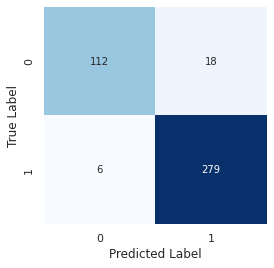

Model: "sequential_173"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_173 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_173 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_173 (Flatten)       (None, 744)               0         
                                                                 
 dense_346 (Dense)           (None, 32)                23840     
                                                                 
 dropout_173 (Dropout)       (None, 32)                0         
                                                                 
 dense_347 (Dense)           (None, 1)                 33        
                                                    

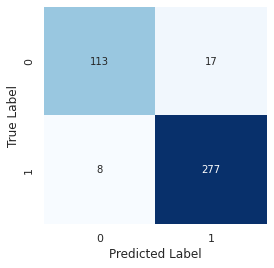

Model: "sequential_174"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_174 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_174 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_174 (Flatten)       (None, 744)               0         
                                                                 
 dense_348 (Dense)           (None, 32)                23840     
                                                                 
 dropout_174 (Dropout)       (None, 32)                0         
                                                                 
 dense_349 (Dense)           (None, 1)                 33        
                                                    

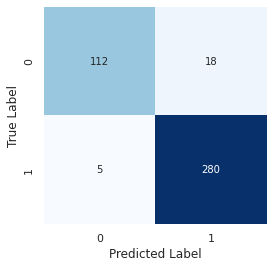

Model: "sequential_175"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_175 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_175 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_175 (Flatten)       (None, 744)               0         
                                                                 
 dense_350 (Dense)           (None, 32)                23840     
                                                                 
 dropout_175 (Dropout)       (None, 32)                0         
                                                                 
 dense_351 (Dense)           (None, 1)                 33        
                                                    

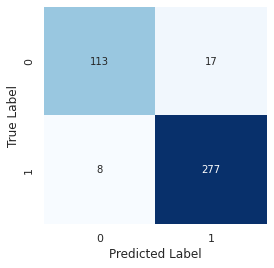

Model: "sequential_176"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_176 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_176 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_176 (Flatten)       (None, 744)               0         
                                                                 
 dense_352 (Dense)           (None, 32)                23840     
                                                                 
 dropout_176 (Dropout)       (None, 32)                0         
                                                                 
 dense_353 (Dense)           (None, 1)                 33        
                                                    

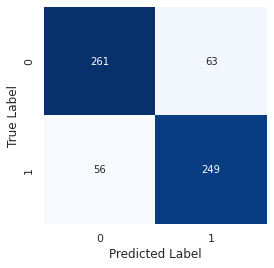

Model: "sequential_177"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_177 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_177 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_177 (Flatten)       (None, 744)               0         
                                                                 
 dense_354 (Dense)           (None, 32)                23840     
                                                                 
 dropout_177 (Dropout)       (None, 32)                0         
                                                                 
 dense_355 (Dense)           (None, 1)                 33        
                                                    

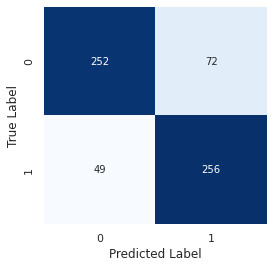

Model: "sequential_178"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_178 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_178 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_178 (Flatten)       (None, 744)               0         
                                                                 
 dense_356 (Dense)           (None, 32)                23840     
                                                                 
 dropout_178 (Dropout)       (None, 32)                0         
                                                                 
 dense_357 (Dense)           (None, 1)                 33        
                                                    

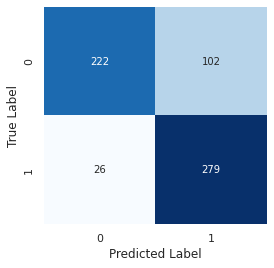

Model: "sequential_179"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_179 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_179 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_179 (Flatten)       (None, 744)               0         
                                                                 
 dense_358 (Dense)           (None, 32)                23840     
                                                                 
 dropout_179 (Dropout)       (None, 32)                0         
                                                                 
 dense_359 (Dense)           (None, 1)                 33        
                                                    

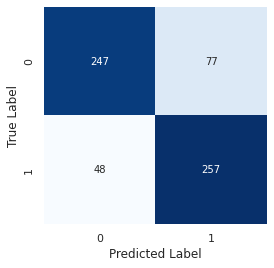

Model: "sequential_180"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_180 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_180 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_180 (Flatten)       (None, 744)               0         
                                                                 
 dense_360 (Dense)           (None, 32)                23840     
                                                                 
 dropout_180 (Dropout)       (None, 32)                0         
                                                                 
 dense_361 (Dense)           (None, 1)                 33        
                                                    

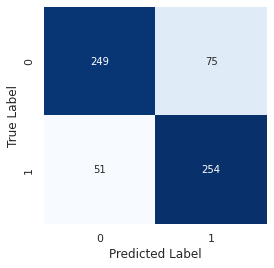

Model: "sequential_181"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_181 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_181 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_181 (Flatten)       (None, 744)               0         
                                                                 
 dense_362 (Dense)           (None, 32)                23840     
                                                                 
 dropout_181 (Dropout)       (None, 32)                0         
                                                                 
 dense_363 (Dense)           (None, 1)                 33        
                                                    

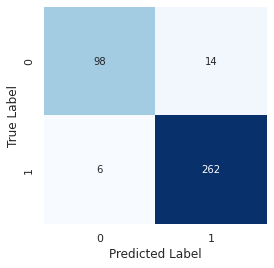

Model: "sequential_182"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_182 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_182 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_182 (Flatten)       (None, 744)               0         
                                                                 
 dense_364 (Dense)           (None, 32)                23840     
                                                                 
 dropout_182 (Dropout)       (None, 32)                0         
                                                                 
 dense_365 (Dense)           (None, 1)                 33        
                                                    

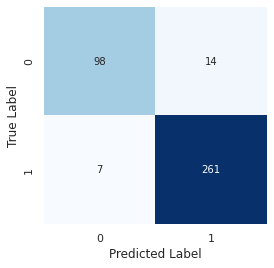

Model: "sequential_183"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_183 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_183 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_183 (Flatten)       (None, 744)               0         
                                                                 
 dense_366 (Dense)           (None, 32)                23840     
                                                                 
 dropout_183 (Dropout)       (None, 32)                0         
                                                                 
 dense_367 (Dense)           (None, 1)                 33        
                                                    

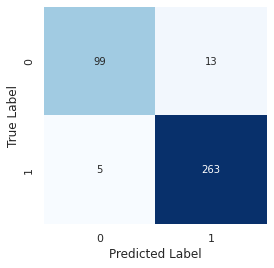

Model: "sequential_184"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_184 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_184 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_184 (Flatten)       (None, 744)               0         
                                                                 
 dense_368 (Dense)           (None, 32)                23840     
                                                                 
 dropout_184 (Dropout)       (None, 32)                0         
                                                                 
 dense_369 (Dense)           (None, 1)                 33        
                                                    

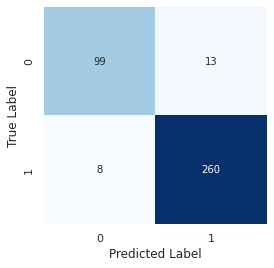

Model: "sequential_185"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_185 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_185 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_185 (Flatten)       (None, 744)               0         
                                                                 
 dense_370 (Dense)           (None, 32)                23840     
                                                                 
 dropout_185 (Dropout)       (None, 32)                0         
                                                                 
 dense_371 (Dense)           (None, 1)                 33        
                                                    

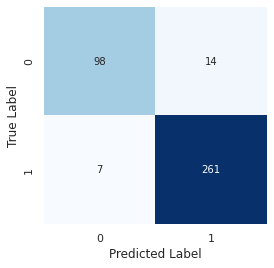

Model: "sequential_186"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_186 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_186 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_186 (Flatten)       (None, 744)               0         
                                                                 
 dense_372 (Dense)           (None, 32)                23840     
                                                                 
 dropout_186 (Dropout)       (None, 32)                0         
                                                                 
 dense_373 (Dense)           (None, 1)                 33        
                                                    

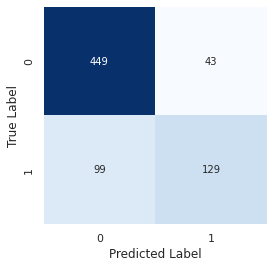

Model: "sequential_187"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_187 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_187 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_187 (Flatten)       (None, 744)               0         
                                                                 
 dense_374 (Dense)           (None, 32)                23840     
                                                                 
 dropout_187 (Dropout)       (None, 32)                0         
                                                                 
 dense_375 (Dense)           (None, 1)                 33        
                                                    

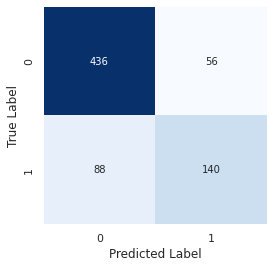

Model: "sequential_188"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_188 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_188 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_188 (Flatten)       (None, 744)               0         
                                                                 
 dense_376 (Dense)           (None, 32)                23840     
                                                                 
 dropout_188 (Dropout)       (None, 32)                0         
                                                                 
 dense_377 (Dense)           (None, 1)                 33        
                                                    

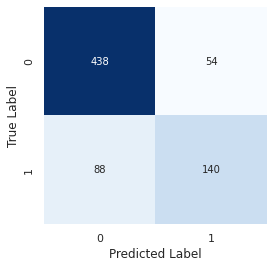

Model: "sequential_189"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_189 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_189 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_189 (Flatten)       (None, 744)               0         
                                                                 
 dense_378 (Dense)           (None, 32)                23840     
                                                                 
 dropout_189 (Dropout)       (None, 32)                0         
                                                                 
 dense_379 (Dense)           (None, 1)                 33        
                                                    

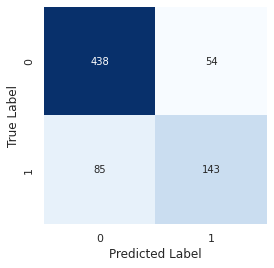

Model: "sequential_190"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_190 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_190 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_190 (Flatten)       (None, 744)               0         
                                                                 
 dense_380 (Dense)           (None, 32)                23840     
                                                                 
 dropout_190 (Dropout)       (None, 32)                0         
                                                                 
 dense_381 (Dense)           (None, 1)                 33        
                                                    

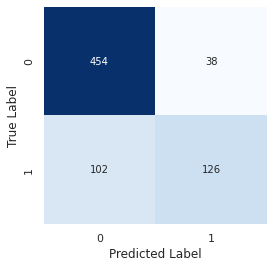

Model: "sequential_191"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_191 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_191 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_191 (Flatten)       (None, 744)               0         
                                                                 
 dense_382 (Dense)           (None, 32)                23840     
                                                                 
 dropout_191 (Dropout)       (None, 32)                0         
                                                                 
 dense_383 (Dense)           (None, 1)                 33        
                                                    

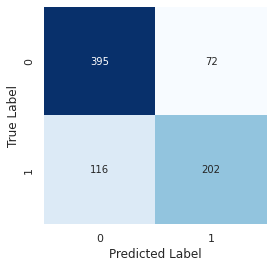

Model: "sequential_192"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_192 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_192 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_192 (Flatten)       (None, 744)               0         
                                                                 
 dense_384 (Dense)           (None, 32)                23840     
                                                                 
 dropout_192 (Dropout)       (None, 32)                0         
                                                                 
 dense_385 (Dense)           (None, 1)                 33        
                                                    

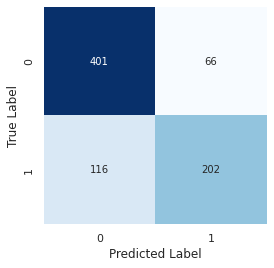

Model: "sequential_193"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_193 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_193 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_193 (Flatten)       (None, 744)               0         
                                                                 
 dense_386 (Dense)           (None, 32)                23840     
                                                                 
 dropout_193 (Dropout)       (None, 32)                0         
                                                                 
 dense_387 (Dense)           (None, 1)                 33        
                                                    

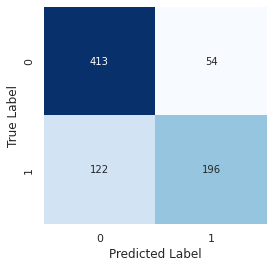

Model: "sequential_194"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_194 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_194 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_194 (Flatten)       (None, 744)               0         
                                                                 
 dense_388 (Dense)           (None, 32)                23840     
                                                                 
 dropout_194 (Dropout)       (None, 32)                0         
                                                                 
 dense_389 (Dense)           (None, 1)                 33        
                                                    

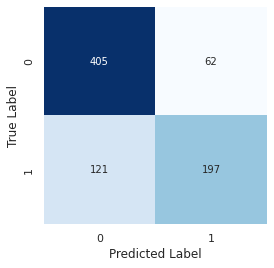

Model: "sequential_195"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_195 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_195 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_195 (Flatten)       (None, 744)               0         
                                                                 
 dense_390 (Dense)           (None, 32)                23840     
                                                                 
 dropout_195 (Dropout)       (None, 32)                0         
                                                                 
 dense_391 (Dense)           (None, 1)                 33        
                                                    

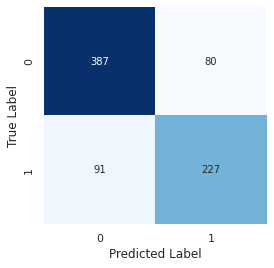

Model: "sequential_196"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_196 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_196 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_196 (Flatten)       (None, 744)               0         
                                                                 
 dense_392 (Dense)           (None, 32)                23840     
                                                                 
 dropout_196 (Dropout)       (None, 32)                0         
                                                                 
 dense_393 (Dense)           (None, 1)                 33        
                                                    

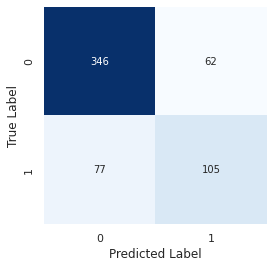

Model: "sequential_197"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_197 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_197 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_197 (Flatten)       (None, 744)               0         
                                                                 
 dense_394 (Dense)           (None, 32)                23840     
                                                                 
 dropout_197 (Dropout)       (None, 32)                0         
                                                                 
 dense_395 (Dense)           (None, 1)                 33        
                                                    

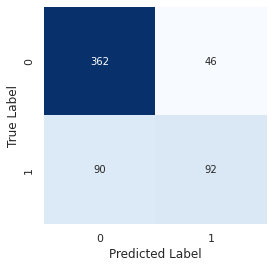

Model: "sequential_198"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_198 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_198 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_198 (Flatten)       (None, 744)               0         
                                                                 
 dense_396 (Dense)           (None, 32)                23840     
                                                                 
 dropout_198 (Dropout)       (None, 32)                0         
                                                                 
 dense_397 (Dense)           (None, 1)                 33        
                                                    

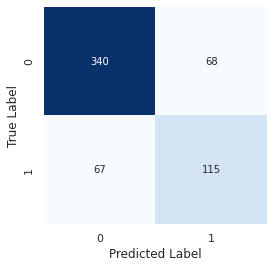

Model: "sequential_199"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_199 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_199 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_199 (Flatten)       (None, 744)               0         
                                                                 
 dense_398 (Dense)           (None, 32)                23840     
                                                                 
 dropout_199 (Dropout)       (None, 32)                0         
                                                                 
 dense_399 (Dense)           (None, 1)                 33        
                                                    

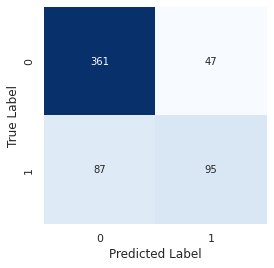

Model: "sequential_200"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_200 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_200 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_200 (Flatten)       (None, 744)               0         
                                                                 
 dense_400 (Dense)           (None, 32)                23840     
                                                                 
 dropout_200 (Dropout)       (None, 32)                0         
                                                                 
 dense_401 (Dense)           (None, 1)                 33        
                                                    

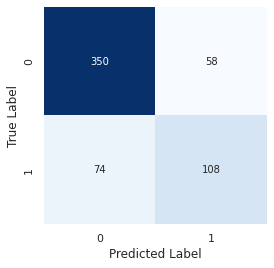

Model: "sequential_201"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_201 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_201 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_201 (Flatten)       (None, 744)               0         
                                                                 
 dense_402 (Dense)           (None, 32)                23840     
                                                                 
 dropout_201 (Dropout)       (None, 32)                0         
                                                                 
 dense_403 (Dense)           (None, 1)                 33        
                                                    

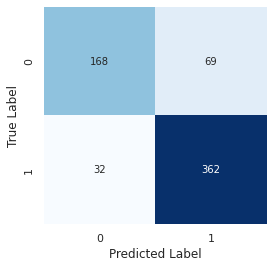

Model: "sequential_202"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_202 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_202 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_202 (Flatten)       (None, 744)               0         
                                                                 
 dense_404 (Dense)           (None, 32)                23840     
                                                                 
 dropout_202 (Dropout)       (None, 32)                0         
                                                                 
 dense_405 (Dense)           (None, 1)                 33        
                                                    

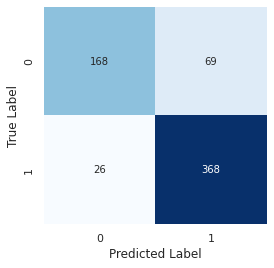

Model: "sequential_203"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_203 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_203 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_203 (Flatten)       (None, 744)               0         
                                                                 
 dense_406 (Dense)           (None, 32)                23840     
                                                                 
 dropout_203 (Dropout)       (None, 32)                0         
                                                                 
 dense_407 (Dense)           (None, 1)                 33        
                                                    

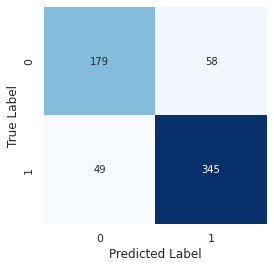

Model: "sequential_204"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_204 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_204 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_204 (Flatten)       (None, 744)               0         
                                                                 
 dense_408 (Dense)           (None, 32)                23840     
                                                                 
 dropout_204 (Dropout)       (None, 32)                0         
                                                                 
 dense_409 (Dense)           (None, 1)                 33        
                                                    

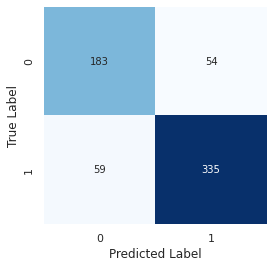

Model: "sequential_205"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_205 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_205 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_205 (Flatten)       (None, 744)               0         
                                                                 
 dense_410 (Dense)           (None, 32)                23840     
                                                                 
 dropout_205 (Dropout)       (None, 32)                0         
                                                                 
 dense_411 (Dense)           (None, 1)                 33        
                                                    

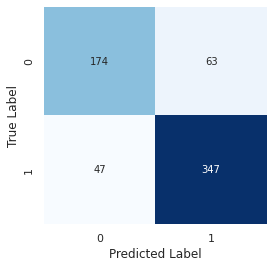

Model: "sequential_206"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_206 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_206 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_206 (Flatten)       (None, 744)               0         
                                                                 
 dense_412 (Dense)           (None, 32)                23840     
                                                                 
 dropout_206 (Dropout)       (None, 32)                0         
                                                                 
 dense_413 (Dense)           (None, 1)                 33        
                                                    

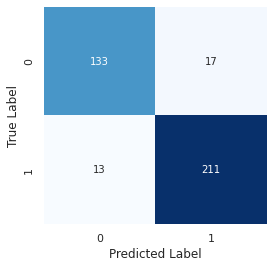

Model: "sequential_207"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_207 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_207 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_207 (Flatten)       (None, 744)               0         
                                                                 
 dense_414 (Dense)           (None, 32)                23840     
                                                                 
 dropout_207 (Dropout)       (None, 32)                0         
                                                                 
 dense_415 (Dense)           (None, 1)                 33        
                                                    

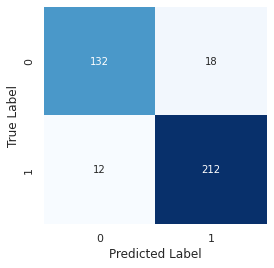

Model: "sequential_208"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_208 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_208 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_208 (Flatten)       (None, 744)               0         
                                                                 
 dense_416 (Dense)           (None, 32)                23840     
                                                                 
 dropout_208 (Dropout)       (None, 32)                0         
                                                                 
 dense_417 (Dense)           (None, 1)                 33        
                                                    

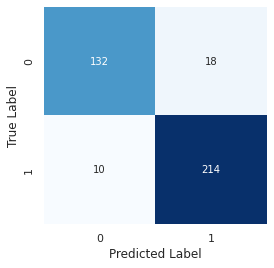

Model: "sequential_209"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_209 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_209 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_209 (Flatten)       (None, 744)               0         
                                                                 
 dense_418 (Dense)           (None, 32)                23840     
                                                                 
 dropout_209 (Dropout)       (None, 32)                0         
                                                                 
 dense_419 (Dense)           (None, 1)                 33        
                                                    

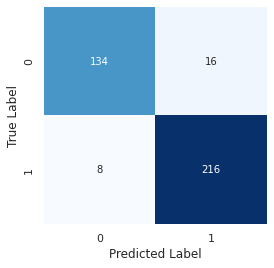

Model: "sequential_210"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_210 (Conv2D)         (None, 6, 124, 4)         104       
                                                                 
 max_pooling2d_210 (MaxPooli  (None, 3, 62, 4)         0         
 ng2D)                                                           
                                                                 
 flatten_210 (Flatten)       (None, 744)               0         
                                                                 
 dense_420 (Dense)           (None, 32)                23840     
                                                                 
 dropout_210 (Dropout)       (None, 32)                0         
                                                                 
 dense_421 (Dense)           (None, 1)                 33        
                                                    

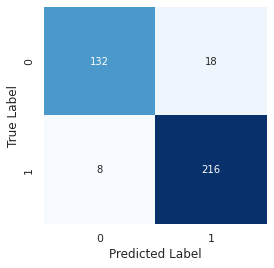

In [ ]:
## REGRESSION with optimal thresholding
from tensorflow import keras
#import tf.keras.Sequential
from keras.models import Sequential
from keras.layers import MaxPooling2D, Dropout, Dense, Flatten
from keras.layers import Convolution2D as Conv2D
from keras.models import Model
from keras.optimizers import gradient_descent_v2
#from keras.optimizers import SGD
#from tensorflow.keras.optimizers import SGD
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import average_precision_score
%matplotlib inline

# This dictionary will include the classifiers for each model
models = dict()
histories = dict()
#regression_results = dict()
CNN_reg_results = dict()
#regression_results_balanced_oversampling = dict()

# We repeat the training/test several times to get well-rounded results
n_realizations = 5

# We'll iterate over all istrument classes, and fit a model for each one
# After training, we'll print a classification report for each instrument
for instrument in class_map:
    
    # A list where we are going to store results of that instrument
    instrument_result_list = []
    
    # A list where we are going to store the threshold that maximizes accuracy for that instrument
    optimal_threshold_list = []

    # Map the instrument name to its column number
    inst_num = class_map[instrument]
    #if inst_num != 0:
    #  continue
    # Several train/test realizations
    for n_realizations_ in range(0,n_realizations):

      # Step 1: sub-sample the data
      
      # First, we need to select down to the data for which we have annotations
      # This is what the mask arrays are for
      train_inst = Y_mask_train[:, inst_num]
      test_inst = Y_mask_test[:, inst_num]
      
      # Here, we're using the Y_mask_train array to slice out only the training examples
      # for which we have annotations for the given class
      X_train_inst = X_train[train_inst]
      #Y_true_train_inst = Y_true_train[train_inst, inst_num] > 0.5
      Y_true_train_inst = Y_true_train[train_inst, inst_num]
      Y_true_train_inst = np.multiply(Y_true_train_inst, 1)
      
      X_test_inst = X_test[test_inst]
      #Y_true_test_inst = Y_true_test[test_inst, inst_num] > 0.5
      Y_true_test_inst = Y_true_test[test_inst, inst_num]
      Y_true_test_inst = np.multiply(Y_true_test_inst, 1)

      #print(X_train_inst.shape)
      #print(X_train_inst)

      ### Normalize input data for the Convolutional Neural Network
      X_train_inst_sklearn_norm = X_train_inst / 255
      X_test_inst_sklearn_norm = X_test_inst / 255
      
      # Instead of having time-varying features, we'll summarize each track by its mean feature vector over time
      #X_train_inst_sklearn = np.mean(X_train_inst, axis=1)
      
      """
      #balanced_indices = get_balanced_indeces_undersample(Y_true_train_inst)
      balanced_indices = get_balanced_indeces_oversample(Y_true_train_inst)
      
      # Downsample most common class
      Y_true_train_inst = Y_true_train_inst[balanced_indices] 
      X_train_inst = X_train_inst[balanced_indices] 
      """

      # Step 3.
      # Initialize a new classifier
      
      model = Sequential()

      # input: 10x128 VGG features with 1 channel -> (36, 36) tensors.
      # this applies 4 convolution filters of size 5x5 each.
      model.add(Conv2D(4, (5, 5), activation='relu', input_shape=(10, 128,1)))

      model.add(MaxPooling2D(pool_size=(2, 2)))

      model.add(Flatten())
      model.add(Dense(32, activation='relu'))
      model.add(Dropout(0.5))
      model.add(Dense(1, activation='sigmoid'))
      model.summary()
      """

      model = Sequential()
      model.add(Dense(128, activation='relu', input_dim=X_train_inst_sklearn.shape[1]))
      model.add(Dropout(0.5))
      model.add(Dense(32, activation='relu'))
      model.add(Dropout(0.5))
      model.add(Dense(1, activation='sigmoid'))
      model.summary()
      """
      
      # Compile the model
      from keras.optimizers import SGD
      sgd = gradient_descent_v2.SGD(learning_rate=0.01, decay=1e-6, momentum=0.9, nesterov=True)

      model.compile(loss='mse',
                    optimizer=sgd,
                    metrics=['mse'])

      # validation_data allows to see evaluation on test while training
      history = model.fit(X_train_inst_sklearn_norm, Y_true_train_inst,
              epochs=40,
              batch_size=128,
              validation_data=(X_test_inst_sklearn_norm, Y_true_test_inst),
              verbose=1)


      # Step 5.
      # Finally, we'll evaluate the model on both train and test
      Y_pred_train = model.predict(X_train_inst_sklearn_norm)

      # Compute the optimal threshold for the training data
      #threshold = compute_optimal_accuracy_threshold(Y_true_train_inst, Y_pred_train, instrument)
      #optimal_threshold_list.append(threshold)

      # For the testing data we are going to use the threshold mean over all previous training experiments.
      Y_pred_test = model.predict(X_test_inst_sklearn_norm)
      y_true_ = Y_true_test_inst > 0.5
      #threshold = np.mean(optimal_threshold_list)
      threshold = 0.5
      y_pred_ = Y_pred_test > threshold
      print("Accuracy (TEST):",accuracy_score(y_true_, y_pred_).round(3), " with threshold ", threshold, " ", instrument)


      #print("Y_pred_test = ", Y_pred_test)
      #Y_pred_test_norm = preprocessing.normalize(Y_pred_test)
      
      print2(instrument,Y_true_train_inst,Y_pred_train,Y_true_test_inst,Y_pred_test)

      # Store the classifier in our dictionary
      models[instrument] = model
      histories[instrument] = history
      results = dict()
      results["Y_true_train"] = Y_true_train_inst
      results["Y_pred_train"] = (Y_pred_train).T
      results["Y_true_test"] = Y_true_test_inst
      results["Y_pred_test"] = (Y_pred_test).T
      # Store test accuracy with format [ Accuracy, threshold_accuracy ]
      results["Accuracy"] = [accuracy_score(y_true_, y_pred_).round(3), threshold]
      # Store test f1 with format [ F1, threshold_accuracy ]
      results["F1"] = [f1_score(y_true_, y_pred_, zero_division=1).round(3), threshold]
      results["AP"] = average_precision_score(y_true_, Y_pred_test).round(3)
      instrument_result_list.append(results)
      if n_realizations_ == n_realizations-1:
        CNN_reg_results[instrument] = instrument_result_list


In [ ]:
# CNN Classification BASE
import keras
from keras.utils import to_categorical
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn import preprocessing
from keras.optimizers import gradient_descent_v2
from sklearn.metrics import confusion_matrix
import seaborn as sns
#from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import MaxPooling2D, Dropout, Dense, Flatten
from keras.layers import Convolution2D as Conv2D
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import average_precision_score


# This dictionary will include the classifiers for each model
models = dict()
histories = dict()
CNN_results = dict()

for instrument in class_map:
    
    # Map the instrument name to its column number
    inst_num = class_map[instrument]
        
    # Step 1: sub-sample the data
    
    # First, we need to select down to the data for which we have annotations
    # This is what the mask arrays are for
    train_inst = Y_mask_train[:, inst_num]
    test_inst = Y_mask_test[:, inst_num]
    
    # Here, we're using the Y_mask_train array to slice out only the training examples
    # for which we have annotations for the given class
    X_train_inst = X_train[train_inst]
    Y_true_train_inst = Y_true_train[train_inst, inst_num] > 0.5
    Y_true_train_inst = np.multiply(Y_true_train_inst, 1)
    
    X_test_inst = X_test[test_inst]
    Y_true_test_inst = Y_true_test[test_inst, inst_num] > 0.5
    Y_true_test_inst = np.multiply(Y_true_test_inst, 1)

    #print(X_train_inst.shape)
    #print(X_train_inst)

    ### Normalize input data for the Convolutional Neural Network
    X_train_inst_sklearn_norm = X_train_inst / 255
    #print(X_train_inst_sklearn_norm)

    X_test_inst_sklearn_norm = X_test_inst / 255



    model = Sequential()

    # input: 10x128 VGG features with 1 channel -> (36, 36) tensors.
    # this applies 4 convolution filters of size 5x5 each.
    model.add(Conv2D(10, (6, 6), activation='relu', strides=(1,2),input_shape=(10, 128,1)))

    model.add(MaxPooling2D(pool_size=(2, 2)))
    #model.add(Conv2D(20, (2, 9), activation='relu'))
    
    #model.add(MaxPooling2D(pool_size=(1, 2)))
  
    model.add(Flatten())
    model.add(Dense(32, activation='relu'))
    model.add(Dropout(0.5))
    model.add(Dense(1, activation='sigmoid'))
    model.summary()
    
    # Compile the model
    from keras.optimizers import SGD
    sgd = gradient_descent_v2.SGD(learning_rate=0.01, decay=1e-6, momentum=0.9, nesterov=True)

    model.compile(loss='binary_crossentropy',
                  optimizer=sgd,
                  metrics=['accuracy'])

    # validation_data allows to see evaluation on test while training
    history = model.fit(X_train_inst_sklearn_norm, Y_true_train_inst,
            epochs=40,
            batch_size=64,
            validation_data=(X_test_inst_sklearn_norm, Y_true_test_inst),
            verbose=0)

    # Make predictions
    Y_pred_train = model.predict(X_train_inst_sklearn_norm)
    Y_pred_test = model.predict(X_test_inst_sklearn_norm)
    threshold = 0.5000
    y_pred_ = Y_pred_test >= threshold


    print('Train Accuracy: ',np.round(history.history['accuracy'][-1],2))
    print('Test_Accuracy: ',np.round(history.history['val_accuracy'][-1],2))


    print("AP: ", average_precision_score(Y_true_test_inst, y_pred_).round(3))

    # Store the classifier in our dictionary
    models[instrument] = model
    histories[instrument] = history
    results = dict()
    results["Y_true_train"] = Y_true_train_inst
    results["Y_pred_train"] = (Y_pred_train).T
    results["Y_true_test"] = Y_true_test_inst
    results["Y_pred_test"] = (Y_pred_test).T
    results["AP"] = average_precision_score(Y_true_test_inst, Y_pred_test).round(3)
    results["Accuracy"] = [accuracy_score(Y_true_test_inst, y_pred_).round(3), threshold]
    # Store test f1 with format [ F1, threshold_accuracy ]
    results["F1"] = [f1_score(Y_true_test_inst, y_pred_, zero_division=1).round(3), threshold]
    CNN_results[instrument] = results

Model: "sequential_305"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_389 (Conv2D)         (None, 5, 62, 10)         370       
                                                                 
 max_pooling2d_367 (MaxPooli  (None, 2, 31, 10)        0         
 ng2D)                                                           
                                                                 
 flatten_300 (Flatten)       (None, 620)               0         
                                                                 
 dense_600 (Dense)           (None, 32)                19872     
                                                                 
 dropout_280 (Dropout)       (None, 32)                0         
                                                                 
 dense_601 (Dense)           (None, 1)                 33        
                                                    

In [ ]:
import keras
from keras.utils import to_categorical
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn import preprocessing
from keras.optimizers import gradient_descent_v2
from sklearn.metrics import confusion_matrix
import seaborn as sns
#from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import MaxPooling2D, Dropout, Dense, Flatten
from keras.layers import Convolution2D as Conv2D
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import average_precision_score
import tensorflow as tf


def macro_double_soft_f1(y, y_hat):
    """Compute the macro soft F1-score as a cost (average 1 - soft-F1 across all labels).
    Use probability values instead of binary predictions.
    This version uses the computation of soft-F1 for both positive and negative class for each label.
    
    Args:
        y (int32 Tensor): targets array of shape (BATCH_SIZE, N_LABELS)
        y_hat (float32 Tensor): probability matrix from forward propagation of shape (BATCH_SIZE, N_LABELS)
        
    Returns:
        cost (scalar Tensor): value of the cost function for the batch
    """
    y = tf.cast(y, tf.float32)
    y_hat = tf.cast(y_hat, tf.float32)
    tp = tf.reduce_sum(y_hat * y, axis=0)
    fp = tf.reduce_sum(y_hat * (1 - y), axis=0)
    fn = tf.reduce_sum((1 - y_hat) * y, axis=0)
    tn = tf.reduce_sum((1 - y_hat) * (1 - y), axis=0)
    soft_f1_class1 = 2*tp / (2*tp + fn + fp + 1e-16)
    soft_f1_class0 = 2*tn / (2*tn + fn + fp + 1e-16)
    cost_class1 = 1 - soft_f1_class1 # reduce 1 - soft-f1_class1 in order to increase soft-f1 on class 1
    cost_class0 = 1 - soft_f1_class0 # reduce 1 - soft-f1_class0 in order to increase soft-f1 on class 0
    cost = 0.5 * (cost_class1 + cost_class0) # take into account both class 1 and class 0
    macro_cost = tf.reduce_mean(cost) # average on all labels
    return macro_cost

# This dictionary will include the classifiers for each model
models = dict()
histories = dict()
#CNN_results = dict()
#CNN_oversample_results = dict()
#CNN_undersample_results = dict()
#CNN_thresholding_results = dict()
CNN_f1_results = dict()

# We repeat the training/test several times to get well-rounded results
n_realizations = 4

for instrument in class_map:
    
    # A list where we are going to store results of that instrument
    instrument_result_list = []
    
    # A list where we are going to store the threshold that maximizes accuracy for that instrument
    optimal_threshold_list = []

    # Map the instrument name to its column number
    inst_num = class_map[instrument]
    #if inst_num != 0:
    #  continue
    # Several train/test realizations
    for n_realizations_ in range(0,n_realizations):
        
      # Step 1: sub-sample the data
      
      # First, we need to select down to the data for which we have annotations
      # This is what the mask arrays are for
      train_inst = Y_mask_train[:, inst_num]
      test_inst = Y_mask_test[:, inst_num]
      


      
      # Here, we're using the Y_mask_train array to slice out only the training examples
      # for which we have annotations for the given class
      X_train_inst = X_train[train_inst]
      Y_true_train_inst = Y_true_train[train_inst, inst_num] > 0.5
      Y_true_train_inst = np.multiply(Y_true_train_inst, 1)
      
      X_test_inst = X_test[test_inst]
      Y_true_test_inst = Y_true_test[test_inst, inst_num] > 0.5
      Y_true_test_inst = np.multiply(Y_true_test_inst, 1)

      #print(X_train_inst.shape)
      #print(X_train_inst)

      """
      #balanced_indices = get_balanced_indeces_undersample(Y_true_train_inst)
      #balanced_indices = get_balanced_indeces_oversample(Y_true_train_inst)
      
      # Downsample most common class
      Y_true_train_inst = Y_true_train_inst[balanced_indices] 
      X_train_inst = X_train_inst[balanced_indices]
      """

      ### Normalize input data for the Convolutional Neural Network
      X_train_inst_sklearn_norm = X_train_inst / 255
      #print(X_train_inst_sklearn_norm)

      X_test_inst_sklearn_norm = X_test_inst / 255

      model = Sequential()

      # input: 10x128 VGG features with 1 channel -> (36, 36) tensors.
      # this applies 4 convolution filters of size 5x5 each.
      model.add(Conv2D(10, (6, 6), activation='relu', strides=(1,2),input_shape=(10, 128,1)))

      model.add(MaxPooling2D(pool_size=(2, 2)))
      #model.add(Conv2D(20, (2, 9), activation='relu'))
      
      #model.add(MaxPooling2D(pool_size=(1, 2)))
    
      model.add(Flatten())
      model.add(Dense(32, activation='relu'))
      model.add(Dropout(0.5))
      model.add(Dense(1, activation='sigmoid'))
      model.summary()
      
      # Compile the model
      from keras.optimizers import SGD
      sgd = gradient_descent_v2.SGD(learning_rate=0.01, decay=1e-6, momentum=0.9, nesterov=True)

      model.compile(
                    loss='binary_crossentropy',
                    #loss=[macro_double_soft_f1],
                    optimizer=sgd,
                    metrics=['accuracy'])

      """
      # Adjust the number of epochs depending on the imbalance ratio of the instrument classes
      n_epochs_max = 40
      len_0 = len(Y_true_test[Y_mask_test[:,inst_num],inst_num][Y_true_test[Y_mask_test[:,inst_num],inst_num]<0.5])
      len_1 = len(Y_true_test[Y_mask_test[:,inst_num],inst_num][Y_true_test[Y_mask_test[:,inst_num],inst_num]>0.5])
      imbalance_ratio =max(len_0, len_1)/min(len_0, len_1)
      aux = (imbalance_ratio - 1)/3.67826
      n_epochs = n_epochs_max - round(20*aux)
      print("n_epochs:", n_epochs)
      """

      # validation_data allows to see evaluation on test while training
      history = model.fit(X_train_inst_sklearn_norm, Y_true_train_inst,
              epochs=40,
              batch_size=64,
              validation_data=(X_test_inst_sklearn_norm, Y_true_test_inst),
              verbose=0)

      # Make predictions
      Y_pred_train = model.predict(X_train_inst_sklearn_norm)
      Y_pred_test = model.predict(X_test_inst_sklearn_norm)
      
      threshold = 0.5000
      y_pred_ = Y_pred_test >= threshold
      """
      #
      # Compute the optimal threshold for the training data
      threshold = compute_optimal_f1_threshold(Y_true_train_inst, Y_pred_train, instrument)
      optimal_threshold_list.append(threshold)

      # For the testing data we are going to use the threshold mean over all previous training experiments.
      #Y_pred_test = model.predict(X_test_inst_sklearn_norm)
      #y_true_ = Y_true_test_inst > 0.5
      threshold = np.mean(optimal_threshold_list)
      y_pred_ = Y_pred_test > threshold
      print("Accuracy (TEST):",accuracy_score(Y_true_test_inst, y_pred_).round(3), " with threshold ", threshold.round(2), " ", instrument)

      #
      #print("PREDICTIONSSSS", Y_pred_test[0:10])
      #Y_pred_test_norm = preprocessing.normalize(Y_pred_test)
      """

      #print2(instrument,Y_true_train_inst,Y_pred_train,Y_true_test_inst,Y_pred_test)

      print('Train Accuracy: ',np.round(history.history['accuracy'][-1],2))
      print('Test_Accuracy: ',np.round(history.history['val_accuracy'][-1],2))

      """# Plot the accuracy curves
      plt.plot(history.history['accuracy'],'bo')
      plt.plot(history.history['val_accuracy'],'rX')
      plt.grid()
      """
      print("AP: ", average_precision_score(Y_true_test_inst, y_pred_).round(3))

      # Store the classifier in our dictionary
      models[instrument] = model
      histories[instrument] = history
      results = dict()
      results["Y_true_train"] = Y_true_train_inst
      results["Y_pred_train"] = (Y_pred_train).T
      results["Y_true_test"] = Y_true_test_inst
      results["Y_pred_test"] = (Y_pred_test).T
      results["AP"] = average_precision_score(Y_true_test_inst, Y_pred_test).round(3)
      results["Accuracy"] = [accuracy_score(Y_true_test_inst, y_pred_).round(3), threshold]
      # Store test f1 with format [ F1, threshold_accuracy ]
      results["F1"] = [f1_score(Y_true_test_inst, y_pred_, zero_division=1).round(3), threshold]
      #CNN_results[instrument] = results
      instrument_result_list.append(results)
      if n_realizations_ == n_realizations-1:
          CNN_f1_results[instrument] = instrument_result_list

Model: "sequential_243"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d_243 (Conv2D)         (None, 5, 62, 10)         370       
                                                                 
 max_pooling2d_243 (MaxPooli  (None, 2, 31, 10)        0         
 ng2D)                                                           
                                                                 
 flatten_243 (Flatten)       (None, 620)               0         
                                                                 
 dense_486 (Dense)           (None, 32)                19872     
                                                                 
 dropout_243 (Dropout)       (None, 32)                0         
                                                                 
 dense_487 (Dense)           (None, 1)                 33        
                                                    

# accordion
Train Mean Error :  0.91
Test  Mean Error :  0.84

# banjo
Train Mean Error :  0.92
Test  Mean Error :  0.86

# bass
Train Mean Error :  0.91
Test  Mean Error :  0.87

# cello
Train Mean Error :  0.91
Test  Mean Error :  0.89

# clarinet
Train Mean Error :  0.9
Test  Mean Error :  0.77

# cymbals
Train Mean Error :  0.96
Test  Mean Error :  0.97

# drums
Train Mean Error :  0.98
Test  Mean Error :  0.95

# flute
Train Mean Error :  0.91
Test  Mean Error :  0.77

# guitar
Train Mean Error :  0.98
Test  Mean Error :  0.97

# mallet_percussion
Train Mean Error :  0.92
Test  Mean Error :  0.87

# mandolin
Train Mean Error :  0.9
Test  Mean Error :  0.85

# organ
Train Mean Error :  0.92
Test  Mean Error :  0.87

# piano
Train Mean Error :  0.98
Test  Mean Error :  0.97

# saxophone
Train Mean Error :  0.92
Test  Mean Error :  0.9

# synthesizer
Train Mean Error :  0.98
Test  Mean Error :  0.97

# trombone
Train Mean Error :  0.92
Test  Mean Error :  0.89

# trumpet
Train Mean E

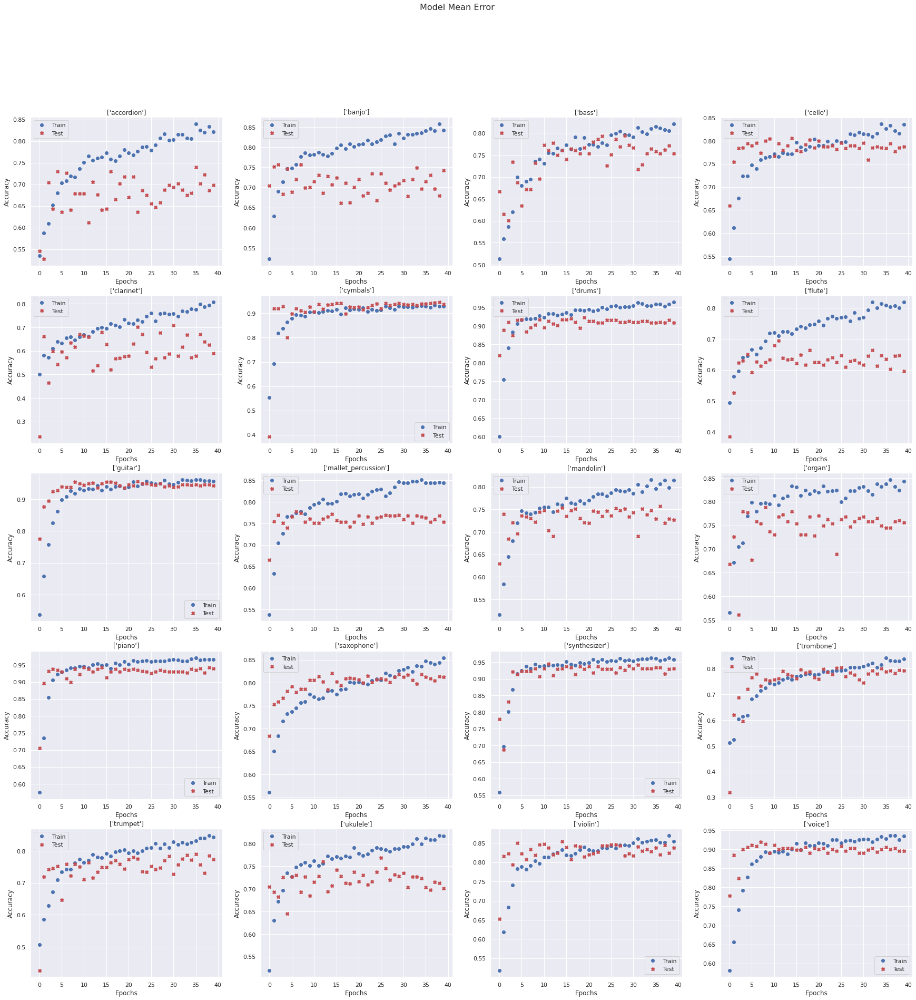

In [ ]:
fig,axes = plt.subplots(nrows=5,ncols=4,sharex=False,sharey=False,figsize=(30,30))
fig.suptitle('Model Mean Error',size=16)
i=0

for x in range(5):
    for y in range(4):
        keys = [k for k, v in class_map.items() if v == i]
        #axes[x,y].set_title(generated_audio_labels[i])
        axes[x,y].set_title(keys)
        #axes[x,y].plot(generated_audio_waves[i])
        history = histories[keys[0]]
        print("#",keys[0])
        print('Train Mean Error : ',np.round(np.sqrt(history.history['accuracy'][-1]),2))
        print('Test  Mean Error : ',np.round(np.sqrt(history.history['val_accuracy'][-1]),2))
        print()

        # Plot the accuracy curves
        #axes[x,y].plot(history.history['mse'],'bo')
        #axes[x,y].plot(history.history['val_mse'],'rX')

        axes[x,y].plot(history.history['accuracy'],'bo',label="Train")
        axes[x,y].plot(history.history['val_accuracy'],'rX',label="Test")
        axes[x,y].legend()
        axes[x,y].set_xlabel("Epochs")
        axes[x,y].set_ylabel("Accuracy")


        #axes[x,y].xlabel(np.round(history.history['accuracy'][-1],2))


        #axes[x,y].get_xaxis().set_visible(False)
        #axes[x,y].get_yaxis().set_visible(False)
        i+=1

## **3- Recurrent Neural Networks (RNN)**

#### Simple RNN

Model: "sequential_505"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_65 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_745 (Dropout)       (None, 250)               0         
                                                                 
 dense_1010 (Dense)          (None, 40)                10040     
                                                                 
 dense_1011 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_________________________________________________________________
Epoch 1/40
12/12 [==============================] - 2s 55ms/step - loss: 0.5968 - accuracy: 0.7286 - val_loss: 0.5040 - val_accuracy: 0.7862
Epoch 2/40
12/12 [===================

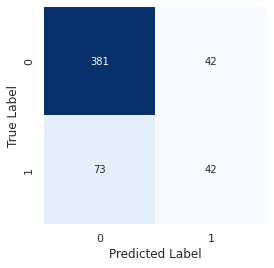

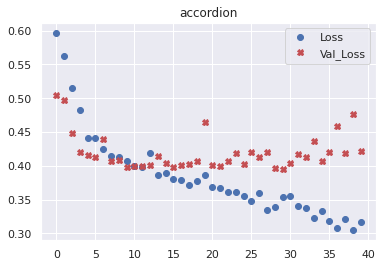

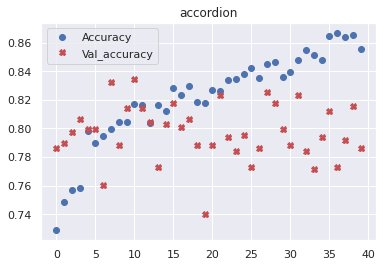


Ejemplo de predicciones:  accordion
True label:  [0 0 0 0 0 0 0 0 0 0]
Predicted:   [[0.05335301 0.5088485  0.01086846 0.00644768 0.00329223 0.19591199
  0.5002019  0.01324776 0.00432059 0.09247592]]
Model: "sequential_506"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_66 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_746 (Dropout)       (None, 250)               0         
                                                                 
 dense_1012 (Dense)          (None, 40)                10040     
                                                                 
 dense_1013 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
___________________________________________

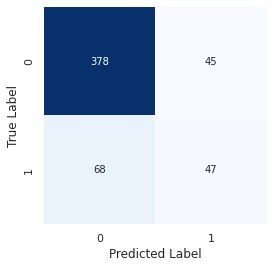

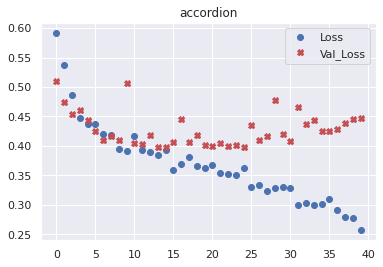

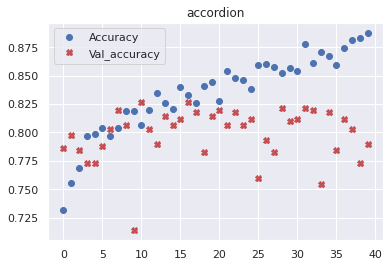


Ejemplo de predicciones:  accordion
True label:  [0 0 0 0 0 0 0 0 0 0]
Predicted:   [[0.01494601 0.50521326 0.00512952 0.00499925 0.00416255 0.20601124
  0.22377518 0.00443514 0.0068984  0.00891985]]
Model: "sequential_507"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_67 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_747 (Dropout)       (None, 250)               0         
                                                                 
 dense_1014 (Dense)          (None, 40)                10040     
                                                                 
 dense_1015 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
___________________________________________

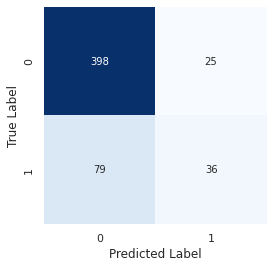

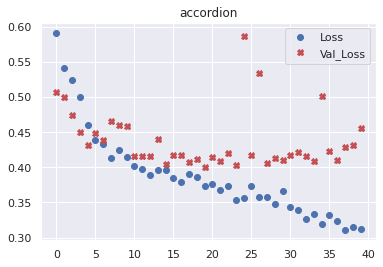

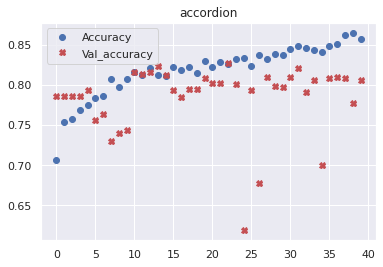


Ejemplo de predicciones:  accordion
True label:  [0 0 0 0 0 0 0 0 0 0]
Predicted:   [[0.01558603 0.14737926 0.00252265 0.0045606  0.00231024 0.07747784
  0.21782194 0.00635197 0.00275083 0.01456978]]
Model: "sequential_508"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_68 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_748 (Dropout)       (None, 250)               0         
                                                                 
 dense_1016 (Dense)          (None, 40)                10040     
                                                                 
 dense_1017 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
___________________________________________

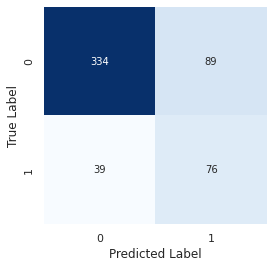

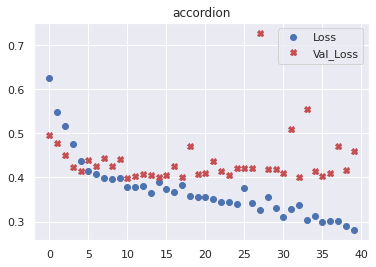

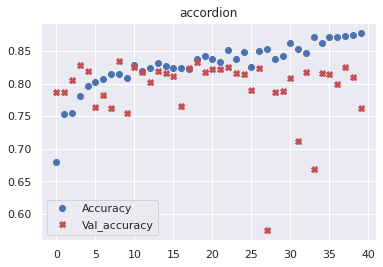


Ejemplo de predicciones:  accordion
True label:  [0 0 0 0 0 0 0 0 0 0]
Predicted:   [[0.09145714 0.4444373  0.00669816 0.01019415 0.00232406 0.5656671
  0.6734652  0.03023274 0.00351485 0.15311922]]
Model: "sequential_509"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_69 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_749 (Dropout)       (None, 250)               0         
                                                                 
 dense_1018 (Dense)          (None, 40)                10040     
                                                                 
 dense_1019 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
____________________________________________

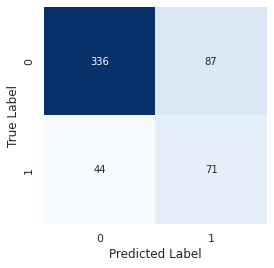

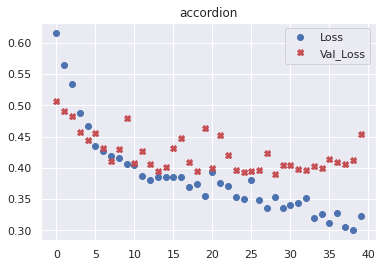

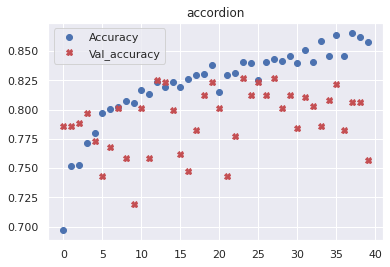


Ejemplo de predicciones:  accordion
True label:  [0 0 0 0 0 0 0 0 0 0]
Predicted:   [[0.1150814  0.6005679  0.01101605 0.04113069 0.00647503 0.7608767
  0.5495845  0.03685334 0.00425987 0.07776675]]
Model: "sequential_510"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_70 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_750 (Dropout)       (None, 250)               0         
                                                                 
 dense_1020 (Dense)          (None, 40)                10040     
                                                                 
 dense_1021 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
____________________________________________

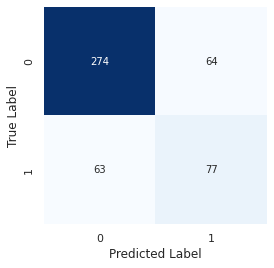

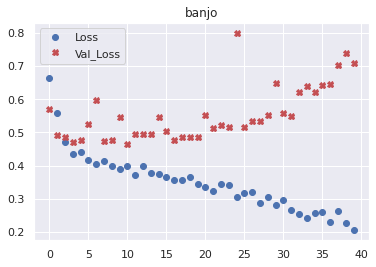

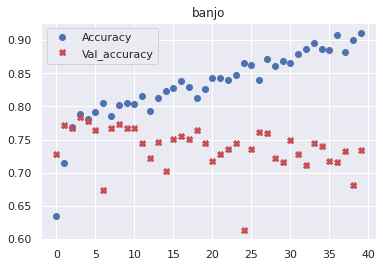


Ejemplo de predicciones:  banjo
True label:  [0 0 1 0 1 0 1 0 0 1]
Predicted:   [[1.8572077e-01 1.7063405e-03 2.2529437e-01 2.4223472e-01 4.0660333e-04
  1.0262056e-01 8.0902022e-01 3.4733853e-04 9.3968696e-04 2.0654596e-01]]
Model: "sequential_511"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_71 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_751 (Dropout)       (None, 250)               0         
                                                                 
 dense_1022 (Dense)          (None, 40)                10040     
                                                                 
 dense_1023 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_________________

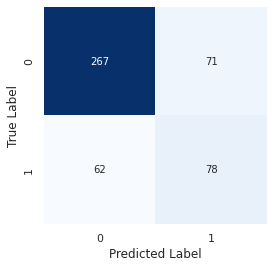

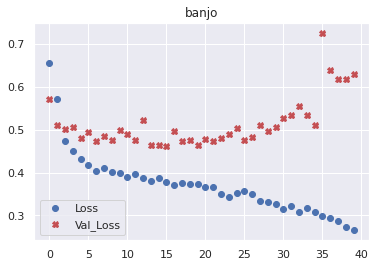

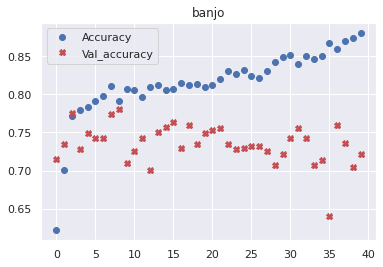


Ejemplo de predicciones:  banjo
True label:  [0 0 1 0 1 0 1 0 0 1]
Predicted:   [[6.0996767e-02 1.1607375e-03 5.4365152e-01 2.5998744e-01 9.0096373e-04
  5.2512422e-02 8.2351661e-01 3.1965066e-04 1.6418149e-03 1.9595486e-01]]
Model: "sequential_512"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_72 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_752 (Dropout)       (None, 250)               0         
                                                                 
 dense_1024 (Dense)          (None, 40)                10040     
                                                                 
 dense_1025 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_________________

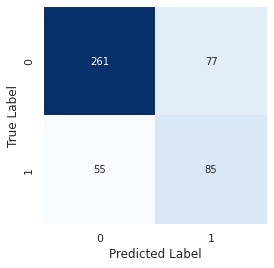

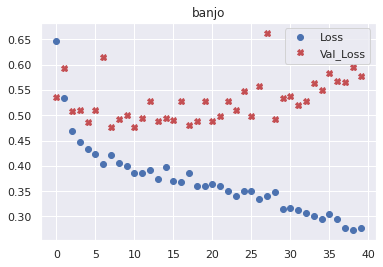

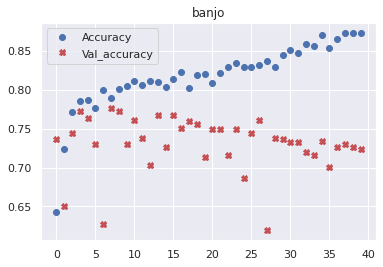


Ejemplo de predicciones:  banjo
True label:  [0 0 1 0 1 0 1 0 0 1]
Predicted:   [[0.11230495 0.00762887 0.39254954 0.32480347 0.00759982 0.26756576
  0.59772176 0.00088917 0.01088559 0.17643687]]
Model: "sequential_513"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_73 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_753 (Dropout)       (None, 250)               0         
                                                                 
 dense_1026 (Dense)          (None, 40)                10040     
                                                                 
 dense_1027 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________________________________________

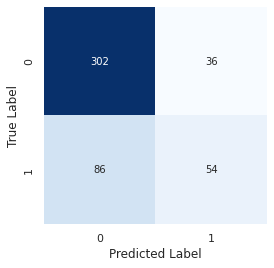

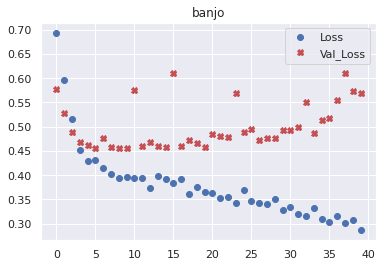

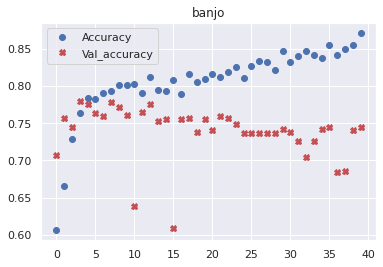


Ejemplo de predicciones:  banjo
True label:  [0 0 1 0 1 0 1 0 0 1]
Predicted:   [[0.0199622  0.00726513 0.314562   0.18823789 0.00415064 0.05216644
  0.30161494 0.00056684 0.00199557 0.13606526]]
Model: "sequential_514"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_74 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_754 (Dropout)       (None, 250)               0         
                                                                 
 dense_1028 (Dense)          (None, 40)                10040     
                                                                 
 dense_1029 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________________________________________

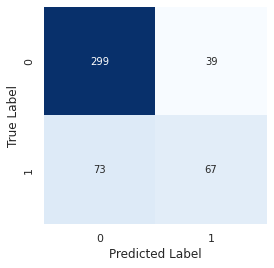

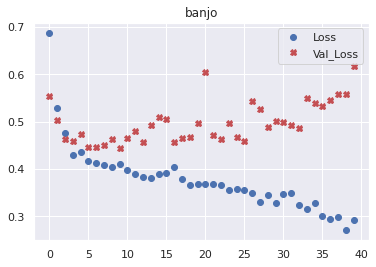

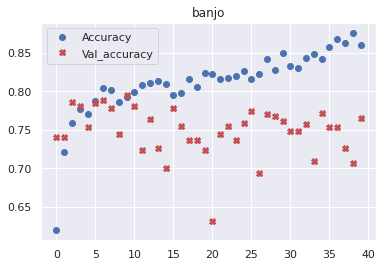


Ejemplo de predicciones:  banjo
True label:  [0 0 1 0 1 0 1 0 0 1]
Predicted:   [[3.16217821e-03 2.55213096e-03 2.81838298e-01 2.16200963e-01
  1.91192224e-03 6.38105795e-02 6.92469776e-01 4.10937646e-04
  6.99570170e-04 1.15517944e-01]]
Model: "sequential_515"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_75 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_755 (Dropout)       (None, 250)               0         
                                                                 
 dense_1030 (Dense)          (None, 40)                10040     
                                                                 
 dense_1031 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_____

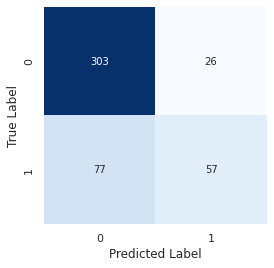

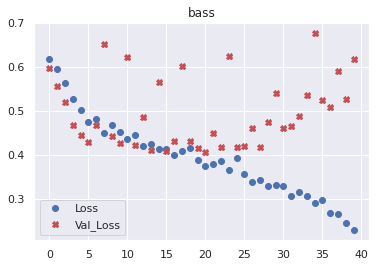

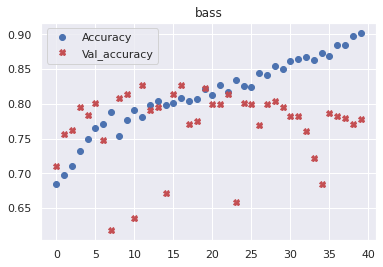


Ejemplo de predicciones:  bass
True label:  [1 1 0 1 1 0 1 0 0 0]
Predicted:   [[4.9884069e-01 9.8315157e-02 3.2104375e-03 8.8119757e-01 4.4567201e-01
  7.6362288e-01 9.4392747e-01 1.6204873e-03 1.5914320e-03 7.6589495e-04]]
Model: "sequential_516"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_76 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_756 (Dropout)       (None, 250)               0         
                                                                 
 dense_1032 (Dense)          (None, 40)                10040     
                                                                 
 dense_1033 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
__________________

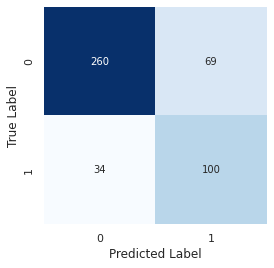

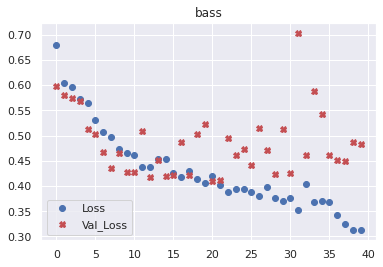

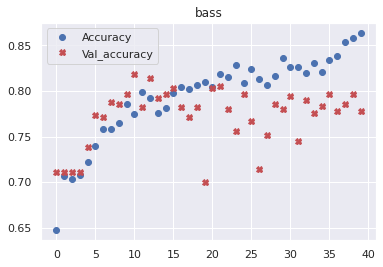


Ejemplo de predicciones:  bass
True label:  [1 1 0 1 1 0 1 0 0 0]
Predicted:   [[0.8633309  0.51672274 0.49730384 0.77032864 0.4342065  0.9257002
  0.9531532  0.15928592 0.03664185 0.03795825]]
Model: "sequential_517"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_77 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_757 (Dropout)       (None, 250)               0         
                                                                 
 dense_1034 (Dense)          (None, 40)                10040     
                                                                 
 dense_1035 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_________________________________________________

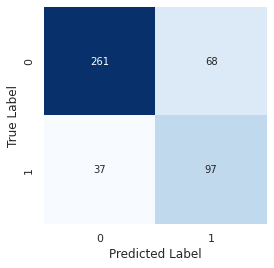

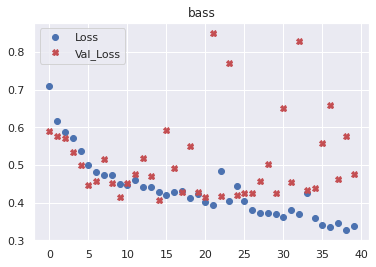

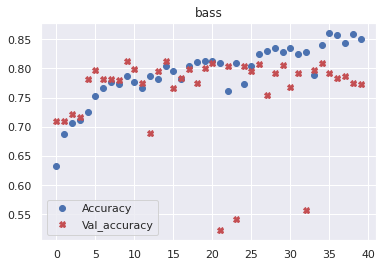


Ejemplo de predicciones:  bass
True label:  [1 1 0 1 1 0 1 0 0 0]
Predicted:   [[0.8682142  0.85263866 0.22201465 0.8995672  0.5511816  0.8455889
  0.92440444 0.11826131 0.03088651 0.00753494]]
Model: "sequential_518"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_78 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_758 (Dropout)       (None, 250)               0         
                                                                 
 dense_1036 (Dense)          (None, 40)                10040     
                                                                 
 dense_1037 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_________________________________________________

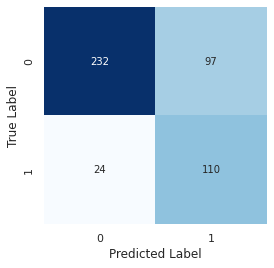

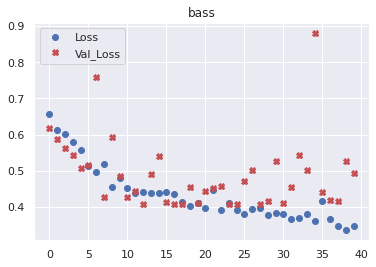

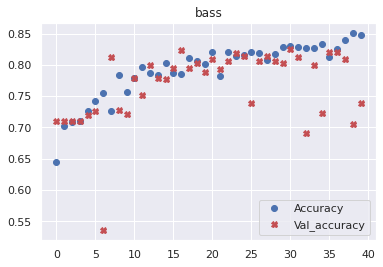


Ejemplo de predicciones:  bass
True label:  [1 1 0 1 1 0 1 0 0 0]
Predicted:   [[0.8916854  0.8369574  0.5566276  0.9017132  0.7277322  0.90298903
  0.92023385 0.33761704 0.02588451 0.02112195]]
Model: "sequential_519"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_79 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_759 (Dropout)       (None, 250)               0         
                                                                 
 dense_1038 (Dense)          (None, 40)                10040     
                                                                 
 dense_1039 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
________________________________________________

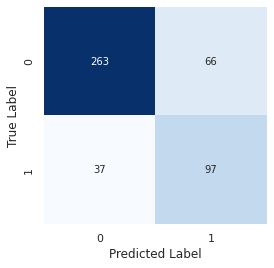

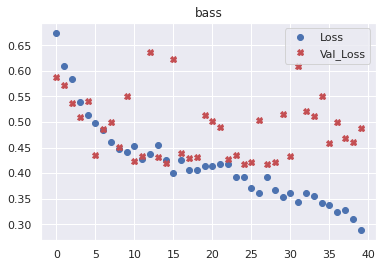

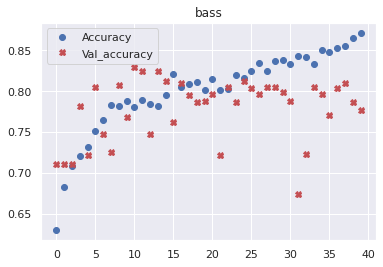


Ejemplo de predicciones:  bass
True label:  [1 1 0 1 1 0 1 0 0 0]
Predicted:   [[0.9223926  0.5144427  0.02736192 0.76250964 0.53332704 0.89056087
  0.8990799  0.38788489 0.01347454 0.01667922]]
Model: "sequential_520"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_80 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_760 (Dropout)       (None, 250)               0         
                                                                 
 dense_1040 (Dense)          (None, 40)                10040     
                                                                 
 dense_1041 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
________________________________________________

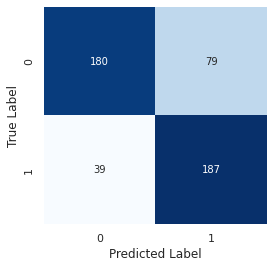

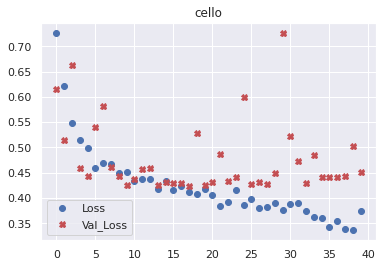

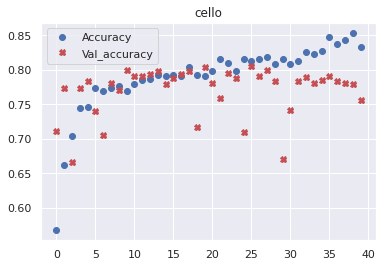


Ejemplo de predicciones:  cello
True label:  [0 0 0 1 0 0 0 0 0 0]
Predicted:   [[1.0177682e-02 5.2496772e-03 8.6965519e-01 4.4790220e-01 6.1720418e-04
  6.7971100e-04 9.7463338e-04 6.7020231e-01 1.0281928e-03 2.3269582e-01]]
Model: "sequential_521"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_81 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_761 (Dropout)       (None, 250)               0         
                                                                 
 dense_1042 (Dense)          (None, 40)                10040     
                                                                 
 dense_1043 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_________________

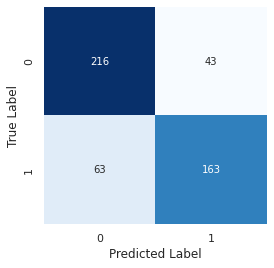

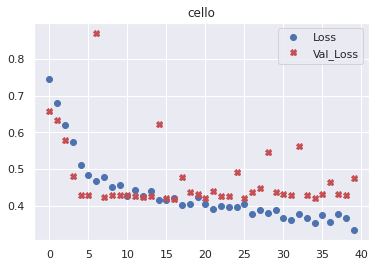

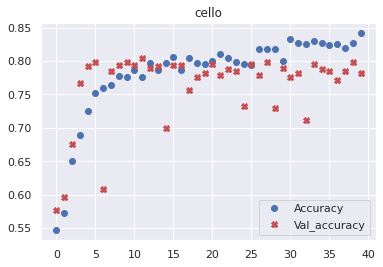


Ejemplo de predicciones:  cello
True label:  [0 0 0 1 0 0 0 0 0 0]
Predicted:   [[2.5364221e-03 2.4874217e-03 9.1580760e-01 1.1922329e-01 9.7871595e-04
  7.8028388e-04 7.2963501e-04 6.4117503e-01 1.0590461e-03 2.4122626e-02]]
Model: "sequential_522"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_82 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_762 (Dropout)       (None, 250)               0         
                                                                 
 dense_1044 (Dense)          (None, 40)                10040     
                                                                 
 dense_1045 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_________________

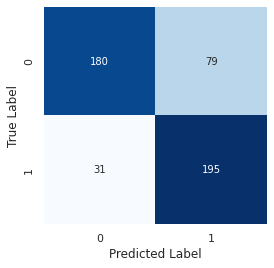

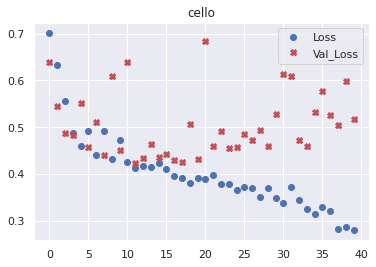

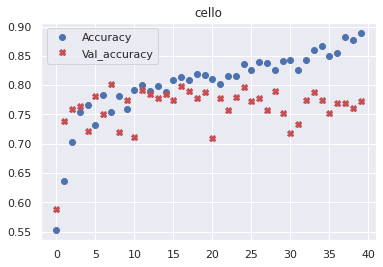


Ejemplo de predicciones:  cello
True label:  [0 0 0 1 0 0 0 0 0 0]
Predicted:   [[7.0048571e-03 2.4923105e-03 9.8644501e-01 5.5620271e-01 2.8275482e-03
  1.4469589e-03 8.6600444e-04 9.7809130e-01 1.8194218e-03 4.6580699e-01]]
Model: "sequential_523"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_83 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_763 (Dropout)       (None, 250)               0         
                                                                 
 dense_1046 (Dense)          (None, 40)                10040     
                                                                 
 dense_1047 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_________________

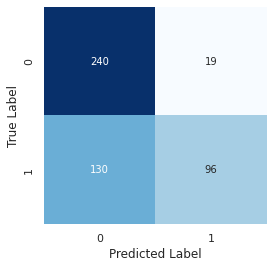

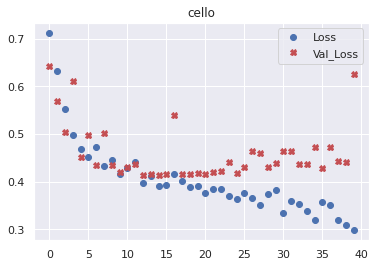

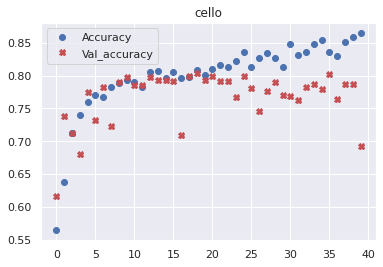


Ejemplo de predicciones:  cello
True label:  [0 0 0 1 0 0 0 0 0 0]
Predicted:   [[1.3735854e-03 6.9768063e-04 8.5249949e-01 1.0023135e-01 3.7172798e-04
  4.6353272e-04 6.5703253e-04 3.1965700e-01 9.6814148e-04 2.7099194e-02]]
Model: "sequential_524"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_84 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_764 (Dropout)       (None, 250)               0         
                                                                 
 dense_1048 (Dense)          (None, 40)                10040     
                                                                 
 dense_1049 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_________________

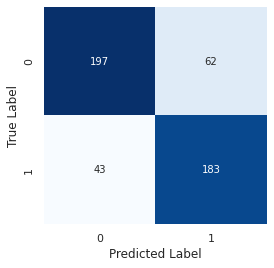

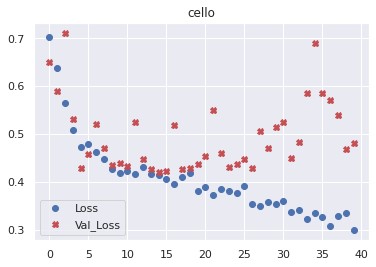

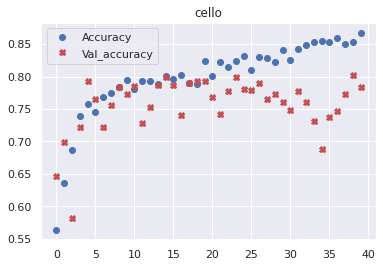


Ejemplo de predicciones:  cello
True label:  [0 0 0 1 0 0 0 0 0 0]
Predicted:   [[8.8519938e-03 1.1720313e-03 9.6988726e-01 6.9857264e-01 4.5300729e-04
  3.3420051e-04 1.1761043e-03 9.2370701e-01 4.2304085e-04 5.7954013e-02]]
Model: "sequential_525"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_85 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_765 (Dropout)       (None, 250)               0         
                                                                 
 dense_1050 (Dense)          (None, 40)                10040     
                                                                 
 dense_1051 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_________________

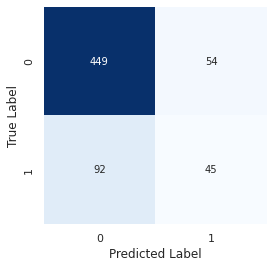

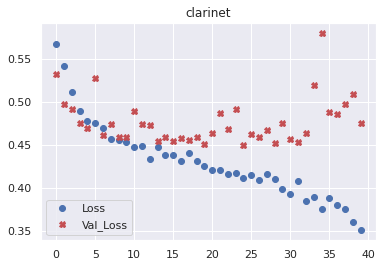

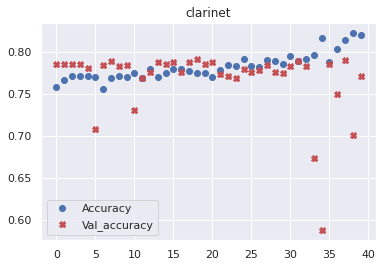


Ejemplo de predicciones:  clarinet
True label:  [1 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.7408651  0.23011331 0.3183393  0.0080037  0.66091424 0.0011741
  0.5258136  0.00552183 0.10638213 0.0345819 ]]
Model: "sequential_526"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_86 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_766 (Dropout)       (None, 250)               0         
                                                                 
 dense_1052 (Dense)          (None, 40)                10040     
                                                                 
 dense_1053 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_____________________________________________

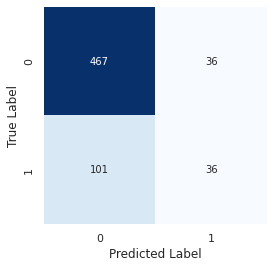

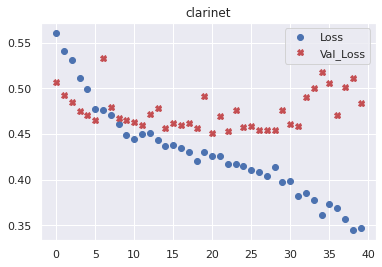

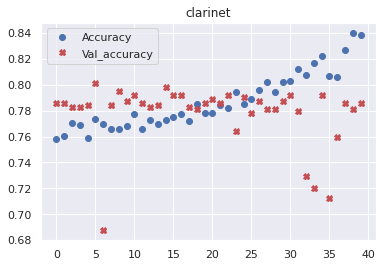


Ejemplo de predicciones:  clarinet
True label:  [1 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.58910644 0.09348737 0.1551069  0.00963722 0.432924   0.00153496
  0.58263093 0.0123263  0.13864727 0.06128336]]
Model: "sequential_527"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_87 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_767 (Dropout)       (None, 250)               0         
                                                                 
 dense_1054 (Dense)          (None, 40)                10040     
                                                                 
 dense_1055 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
____________________________________________

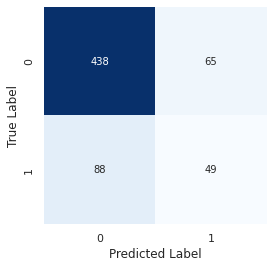

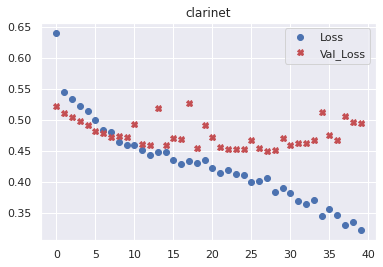

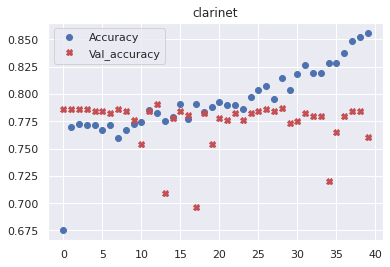


Ejemplo de predicciones:  clarinet
True label:  [1 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.8725131  0.07102425 0.649205   0.02734872 0.64910287 0.00295731
  0.40253642 0.01948444 0.289494   0.06331121]]
Model: "sequential_528"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_88 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_768 (Dropout)       (None, 250)               0         
                                                                 
 dense_1056 (Dense)          (None, 40)                10040     
                                                                 
 dense_1057 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
____________________________________________

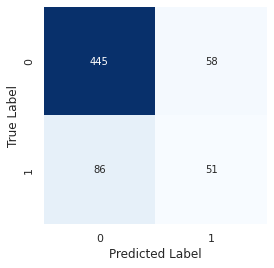

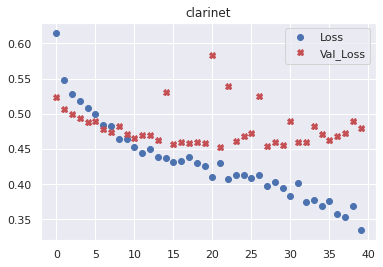

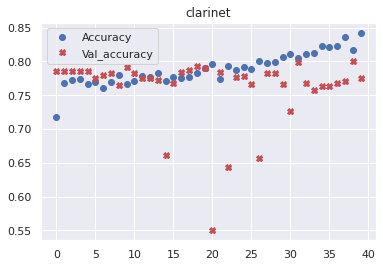


Ejemplo de predicciones:  clarinet
True label:  [1 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.78971463 0.11161283 0.30201182 0.02227929 0.66336536 0.00247739
  0.5081391  0.00849118 0.11845342 0.05722653]]
Model: "sequential_529"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_89 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_769 (Dropout)       (None, 250)               0         
                                                                 
 dense_1058 (Dense)          (None, 40)                10040     
                                                                 
 dense_1059 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
____________________________________________

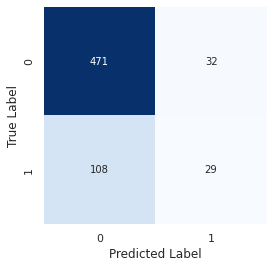

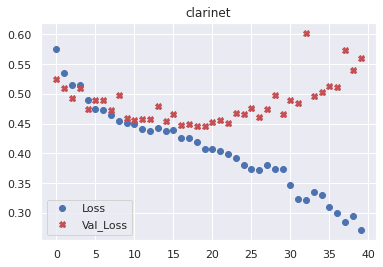

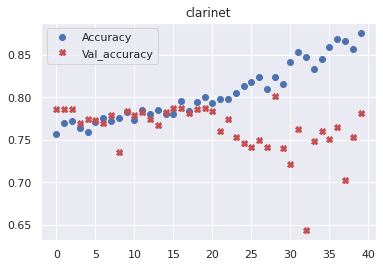


Ejemplo de predicciones:  clarinet
True label:  [1 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.9190245  0.08600532 0.03127917 0.00783027 0.3720022  0.00099864
  0.68899333 0.00638638 0.01287331 0.00303379]]
Model: "sequential_530"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_90 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_770 (Dropout)       (None, 250)               0         
                                                                 
 dense_1060 (Dense)          (None, 40)                10040     
                                                                 
 dense_1061 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
____________________________________________

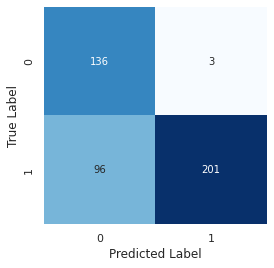

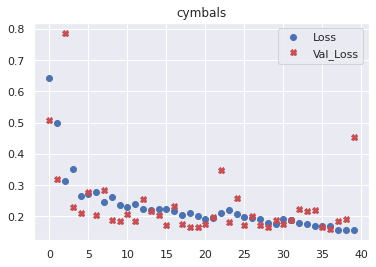

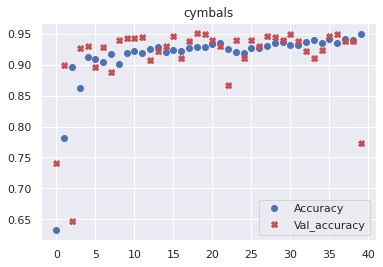


Ejemplo de predicciones:  cymbals
True label:  [1 1 1 1 1 0 1 0 0 0]
Predicted:   [[0.94500583 0.98480994 0.46874687 0.98511016 0.5996842  0.5019779
  0.9569867  0.00723915 0.0031971  0.00460638]]
Model: "sequential_531"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_91 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_771 (Dropout)       (None, 250)               0         
                                                                 
 dense_1062 (Dense)          (None, 40)                10040     
                                                                 
 dense_1063 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
______________________________________________

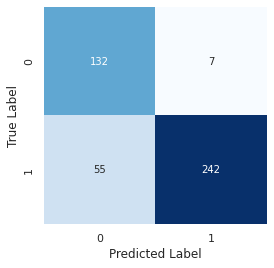

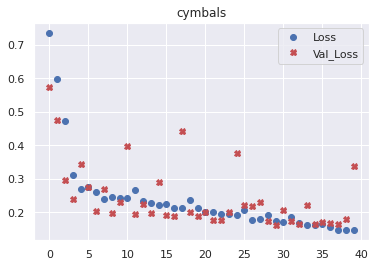

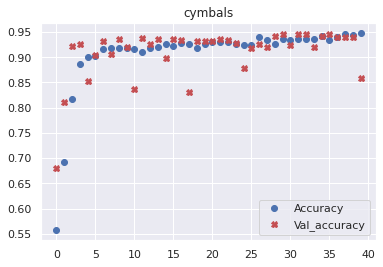


Ejemplo de predicciones:  cymbals
True label:  [1 1 1 1 1 0 1 0 0 0]
Predicted:   [[0.9197828  0.94098413 0.92360204 0.9648846  0.87077606 0.8892218
  0.96077025 0.01687049 0.00624558 0.00578871]]
Model: "sequential_532"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_92 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_772 (Dropout)       (None, 250)               0         
                                                                 
 dense_1064 (Dense)          (None, 40)                10040     
                                                                 
 dense_1065 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
______________________________________________

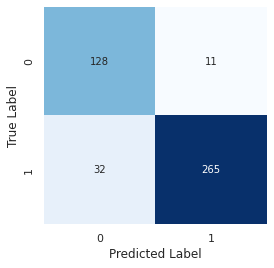

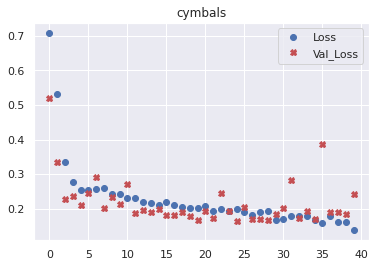

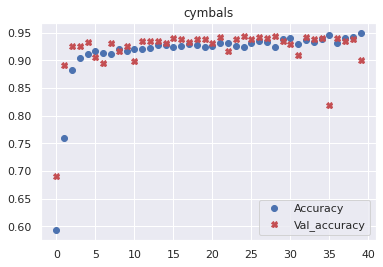


Ejemplo de predicciones:  cymbals
True label:  [1 1 1 1 1 0 1 0 0 0]
Predicted:   [[0.9771224  0.9957659  0.7865303  0.9897669  0.89693767 0.9881859
  0.9872684  0.00393507 0.00213444 0.00547451]]
Model: "sequential_533"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_93 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_773 (Dropout)       (None, 250)               0         
                                                                 
 dense_1066 (Dense)          (None, 40)                10040     
                                                                 
 dense_1067 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
______________________________________________

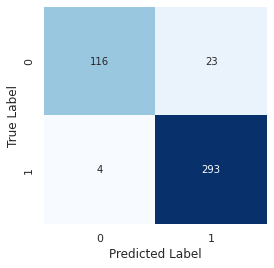

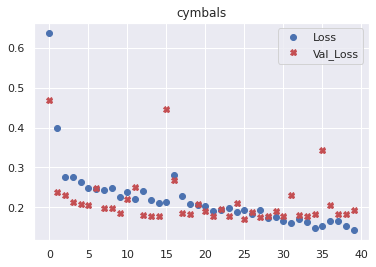

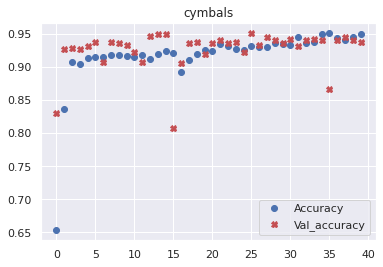


Ejemplo de predicciones:  cymbals
True label:  [1 1 1 1 1 0 1 0 0 0]
Predicted:   [[0.9957735  0.99742824 0.9918561  0.9964563  0.9953489  0.99339217
  0.9950655  0.03802799 0.0034423  0.02124728]]
Model: "sequential_534"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_94 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_774 (Dropout)       (None, 250)               0         
                                                                 
 dense_1068 (Dense)          (None, 40)                10040     
                                                                 
 dense_1069 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_____________________________________________

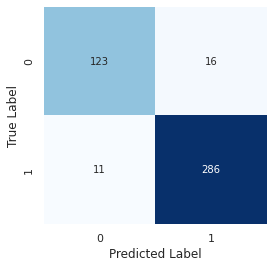

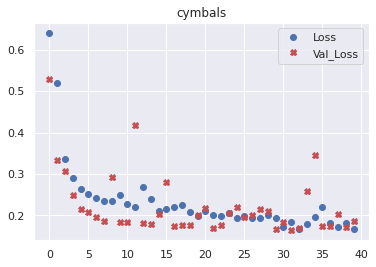

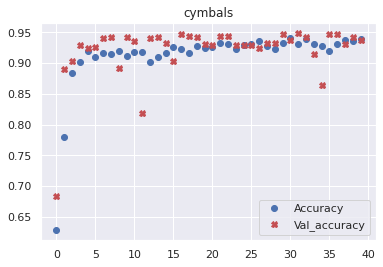


Ejemplo de predicciones:  cymbals
True label:  [1 1 1 1 1 0 1 0 0 0]
Predicted:   [[0.98777837 0.99344325 0.87102675 0.9930489  0.94694245 0.9802642
  0.9913708  0.01729026 0.00791653 0.02046844]]
Model: "sequential_535"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_95 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_775 (Dropout)       (None, 250)               0         
                                                                 
 dense_1070 (Dense)          (None, 40)                10040     
                                                                 
 dense_1071 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
______________________________________________

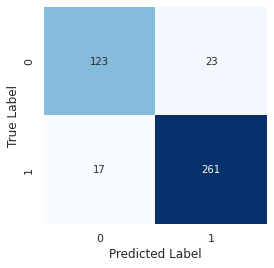

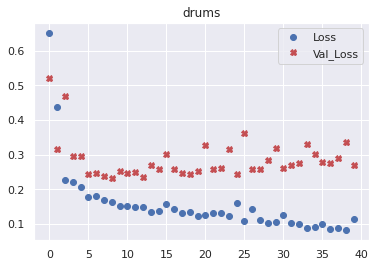

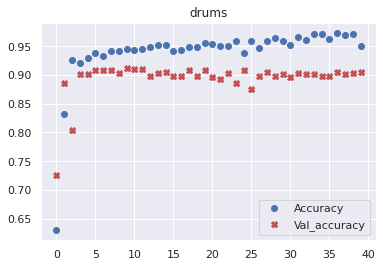


Ejemplo de predicciones:  drums
True label:  [1 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.9304294  0.02956603 0.00172563 0.9965888  0.99839574 0.9988967
  0.99832827 0.9991774  0.9985905  0.9987355 ]]
Model: "sequential_536"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_96 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_776 (Dropout)       (None, 250)               0         
                                                                 
 dense_1072 (Dense)          (None, 40)                10040     
                                                                 
 dense_1073 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
________________________________________________

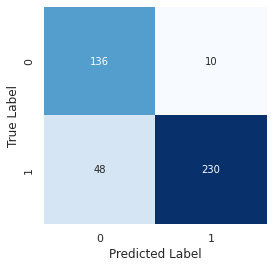

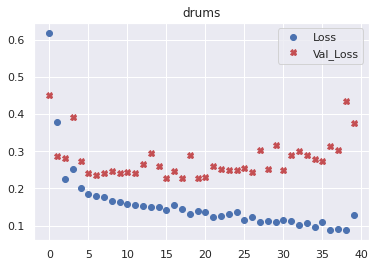

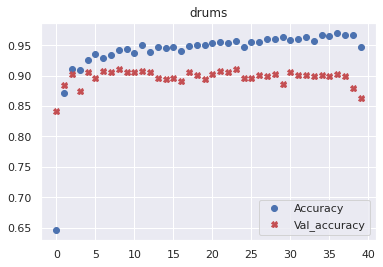


Ejemplo de predicciones:  drums
True label:  [1 0 0 1 1 1 1 1 1 1]
Predicted:   [[6.4777911e-01 5.5590938e-03 6.3835527e-04 9.8140782e-01 9.9735034e-01
  9.9731088e-01 9.9742943e-01 9.9888653e-01 9.9695385e-01 9.9647826e-01]]
Model: "sequential_537"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_97 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_777 (Dropout)       (None, 250)               0         
                                                                 
 dense_1074 (Dense)          (None, 40)                10040     
                                                                 
 dense_1075 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_________________

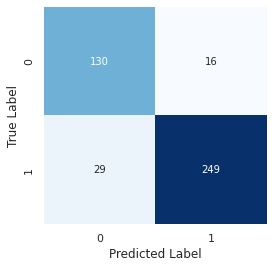

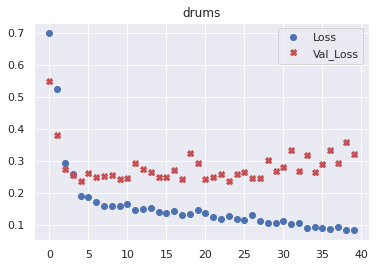

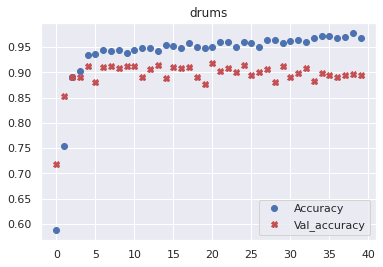


Ejemplo de predicciones:  drums
True label:  [1 0 0 1 1 1 1 1 1 1]
Predicted:   [[7.0931011e-01 1.3035093e-02 4.2852020e-04 9.9717999e-01 9.9831969e-01
  9.9926072e-01 9.9705231e-01 9.9909735e-01 9.9876165e-01 9.9788147e-01]]
Model: "sequential_538"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_98 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_778 (Dropout)       (None, 250)               0         
                                                                 
 dense_1076 (Dense)          (None, 40)                10040     
                                                                 
 dense_1077 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_________________

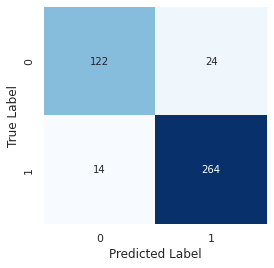

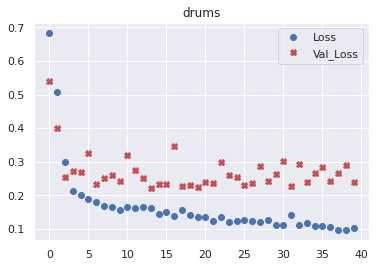

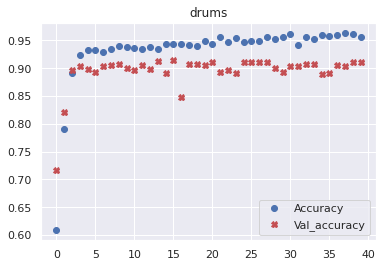


Ejemplo de predicciones:  drums
True label:  [1 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.8001215  0.05464825 0.00115616 0.9948537  0.99853337 0.99868697
  0.99792033 0.9986689  0.9976998  0.9973801 ]]
Model: "sequential_539"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_99 (SimpleRNN)   (None, 250)               94750     
                                                                 
 dropout_779 (Dropout)       (None, 250)               0         
                                                                 
 dense_1078 (Dense)          (None, 40)                10040     
                                                                 
 dense_1079 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________________________________________

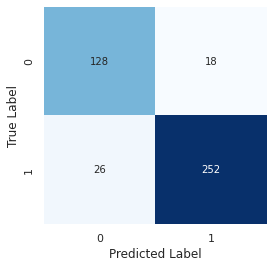

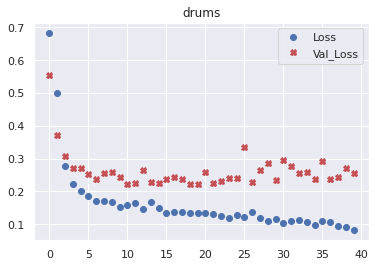

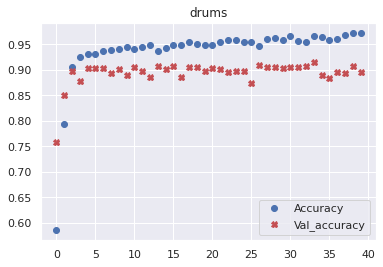


Ejemplo de predicciones:  drums
True label:  [1 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.7940397  0.01423169 0.00162146 0.9938642  0.9982893  0.9991128
  0.9987562  0.9993368  0.9990664  0.99832326]]
Model: "sequential_540"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_100 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_780 (Dropout)       (None, 250)               0         
                                                                 
 dense_1080 (Dense)          (None, 40)                10040     
                                                                 
 dense_1081 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
________________________________________________

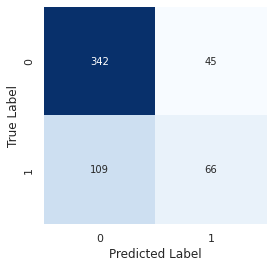

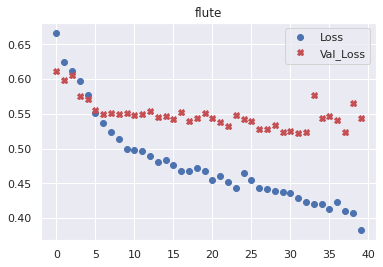

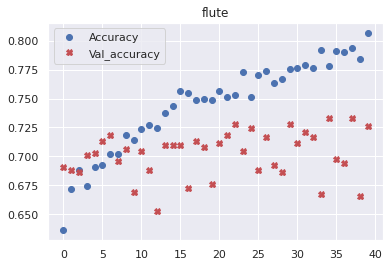


Ejemplo de predicciones:  flute
True label:  [0 0 1 0 0 0 1 0 0 0]
Predicted:   [[0.585626   0.11555163 0.4934309  0.7464081  0.33152026 0.3033374
  0.30988052 0.51052594 0.1717953  0.00630863]]
Model: "sequential_541"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_101 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_781 (Dropout)       (None, 250)               0         
                                                                 
 dense_1082 (Dense)          (None, 40)                10040     
                                                                 
 dense_1083 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
________________________________________________

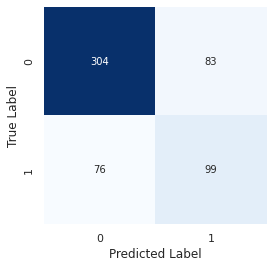

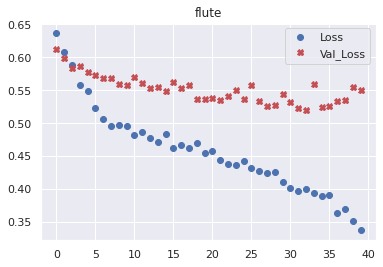

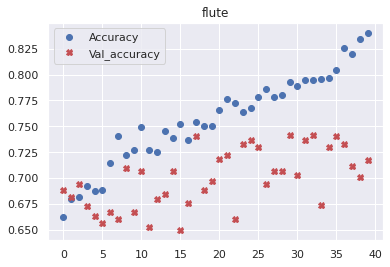


Ejemplo de predicciones:  flute
True label:  [0 0 1 0 0 0 1 0 0 0]
Predicted:   [[0.7282579  0.7613311  0.86299497 0.56439817 0.50135094 0.23848078
  0.24588694 0.5637978  0.5290895  0.00264481]]
Model: "sequential_542"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_102 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_782 (Dropout)       (None, 250)               0         
                                                                 
 dense_1084 (Dense)          (None, 40)                10040     
                                                                 
 dense_1085 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________________________________________

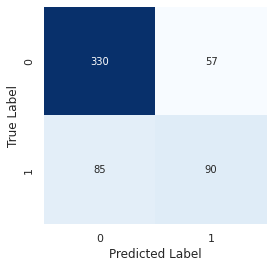

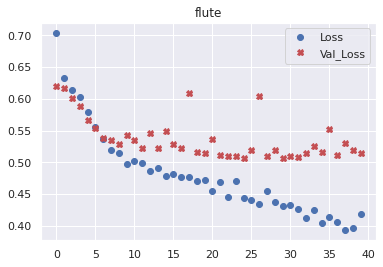

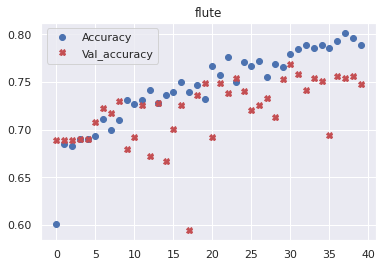


Ejemplo de predicciones:  flute
True label:  [0 0 1 0 0 0 1 0 0 0]
Predicted:   [[0.5037521  0.31043687 0.59377396 0.6130935  0.45395407 0.35244474
  0.36720142 0.5015371  0.47986576 0.00640377]]
Model: "sequential_543"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_103 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_783 (Dropout)       (None, 250)               0         
                                                                 
 dense_1086 (Dense)          (None, 40)                10040     
                                                                 
 dense_1087 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________________________________________

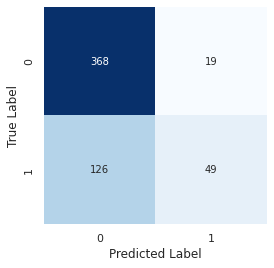

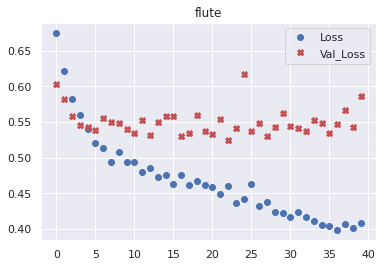

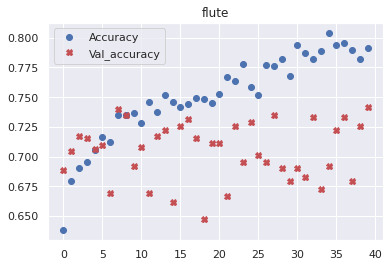


Ejemplo de predicciones:  flute
True label:  [0 0 1 0 0 0 1 0 0 0]
Predicted:   [[0.5876147  0.20278347 0.4079436  0.49794084 0.3624314  0.25539222
  0.20702966 0.3346864  0.31357092 0.00345692]]
Model: "sequential_544"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_104 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_784 (Dropout)       (None, 250)               0         
                                                                 
 dense_1088 (Dense)          (None, 40)                10040     
                                                                 
 dense_1089 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________________________________________

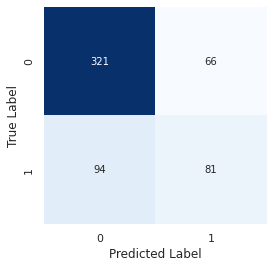

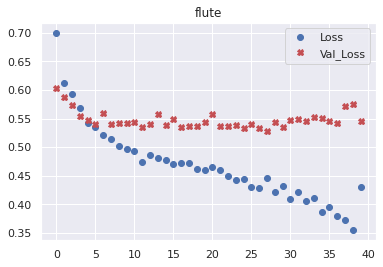

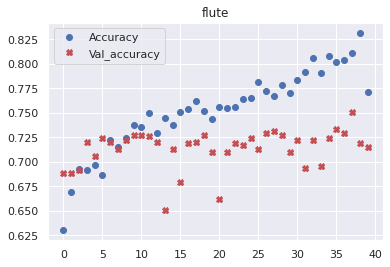


Ejemplo de predicciones:  flute
True label:  [0 0 1 0 0 0 1 0 0 0]
Predicted:   [[0.6315188  0.3247701  0.57761765 0.5540417  0.40240878 0.31557697
  0.23036392 0.47110718 0.46266648 0.02020489]]
Model: "sequential_545"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_105 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_785 (Dropout)       (None, 250)               0         
                                                                 
 dense_1090 (Dense)          (None, 40)                10040     
                                                                 
 dense_1091 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________________________________________

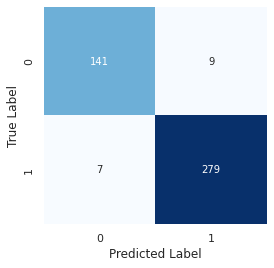

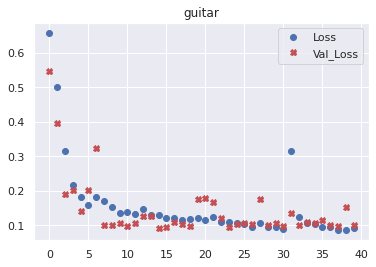

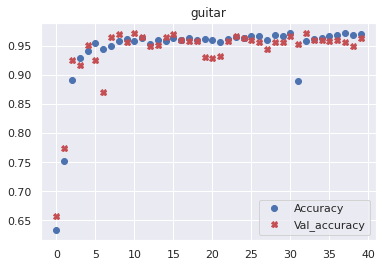


Ejemplo de predicciones:  guitar
True label:  [0 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.01026744 0.13513601 0.00770159 0.9526579  0.96909976 0.8393122
  0.9812431  0.99805105 0.99651873 0.9963722 ]]
Model: "sequential_546"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_106 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_786 (Dropout)       (None, 250)               0         
                                                                 
 dense_1092 (Dense)          (None, 40)                10040     
                                                                 
 dense_1093 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________________________________________

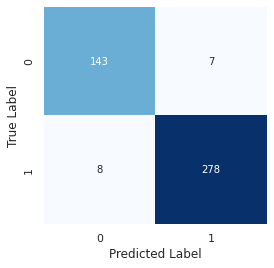

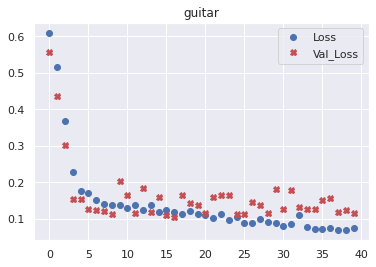

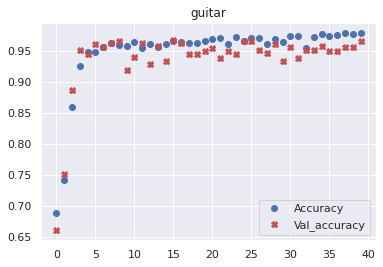


Ejemplo de predicciones:  guitar
True label:  [0 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.04337002 0.64320415 0.01026961 0.9879161  0.89629155 0.9382074
  0.99192905 0.9993198  0.9986313  0.99853206]]
Model: "sequential_547"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_107 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_787 (Dropout)       (None, 250)               0         
                                                                 
 dense_1094 (Dense)          (None, 40)                10040     
                                                                 
 dense_1095 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________________________________________

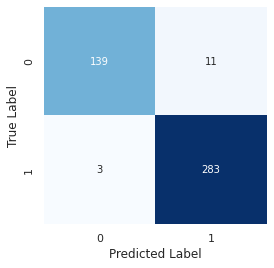

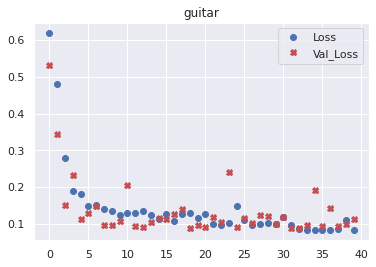

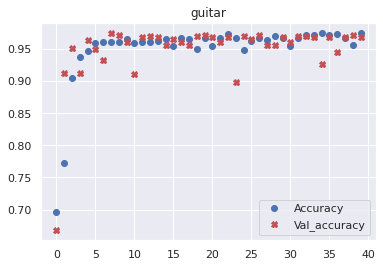


Ejemplo de predicciones:  guitar
True label:  [0 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.00939949 0.41860202 0.00540814 0.98683596 0.9816721  0.8686161
  0.9659403  0.99859947 0.9929093  0.9968388 ]]
Model: "sequential_548"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_108 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_788 (Dropout)       (None, 250)               0         
                                                                 
 dense_1096 (Dense)          (None, 40)                10040     
                                                                 
 dense_1097 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________________________________________

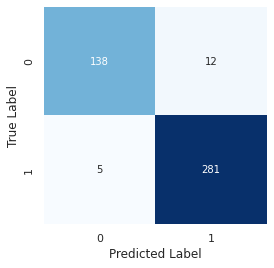

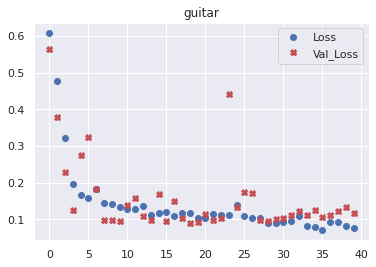

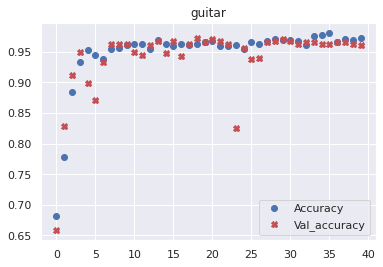


Ejemplo de predicciones:  guitar
True label:  [0 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.02078282 0.11853384 0.00685947 0.9880443  0.9860503  0.94061375
  0.9869508  0.9981036  0.99765426 0.9976192 ]]
Model: "sequential_549"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_109 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_789 (Dropout)       (None, 250)               0         
                                                                 
 dense_1098 (Dense)          (None, 40)                10040     
                                                                 
 dense_1099 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
______________________________________________

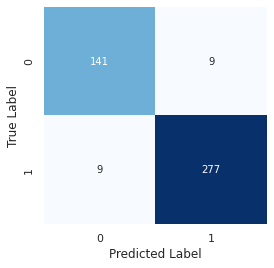

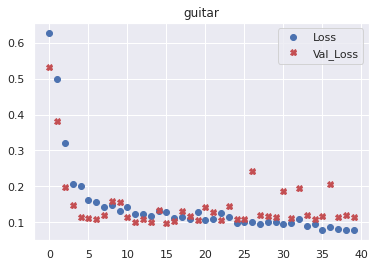

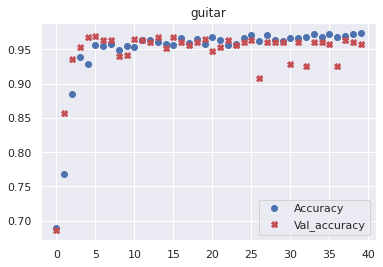


Ejemplo de predicciones:  guitar
True label:  [0 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.00660048 0.27180028 0.00670536 0.90495366 0.9813632  0.84279054
  0.98403543 0.99920803 0.9968671  0.9953146 ]]
Model: "sequential_550"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_110 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_790 (Dropout)       (None, 250)               0         
                                                                 
 dense_1100 (Dense)          (None, 40)                10040     
                                                                 
 dense_1101 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
______________________________________________

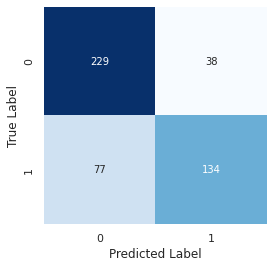

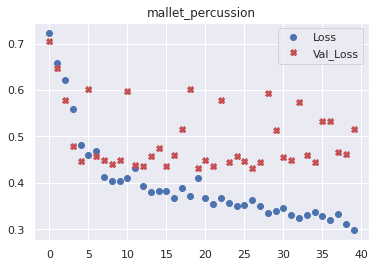

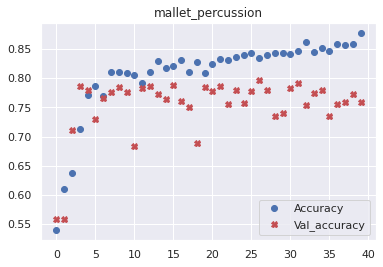


Ejemplo de predicciones:  mallet_percussion
True label:  [0 1 0 0 1 1 0 0 0 0]
Predicted:   [[0.80321676 0.74426776 0.10093216 0.05800757 0.85993725 0.6022876
  0.00402843 0.0020925  0.00336644 0.00466766]]
Model: "sequential_551"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_111 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_791 (Dropout)       (None, 250)               0         
                                                                 
 dense_1102 (Dense)          (None, 40)                10040     
                                                                 
 dense_1103 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
____________________________________

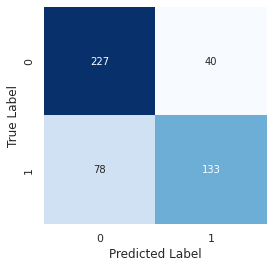

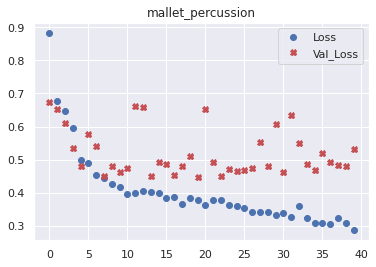

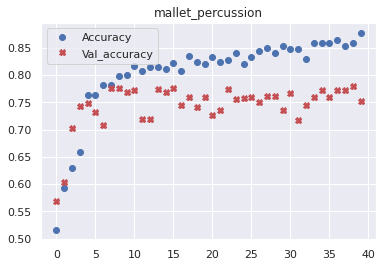


Ejemplo de predicciones:  mallet_percussion
True label:  [0 1 0 0 1 1 0 0 0 0]
Predicted:   [[0.6791463  0.8589755  0.07207036 0.0265616  0.8588627  0.38577652
  0.00294591 0.00431058 0.006489   0.00476131]]
Model: "sequential_552"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_112 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_792 (Dropout)       (None, 250)               0         
                                                                 
 dense_1104 (Dense)          (None, 40)                10040     
                                                                 
 dense_1105 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
___________________________________

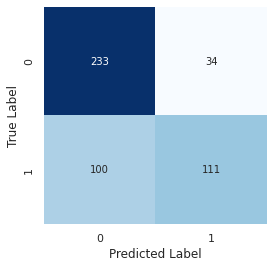

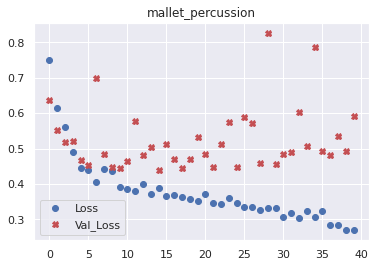

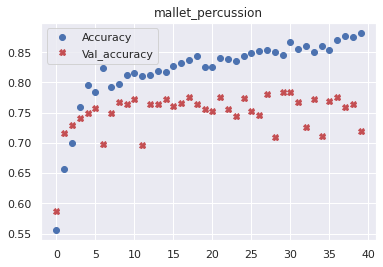


Ejemplo de predicciones:  mallet_percussion
True label:  [0 1 0 0 1 1 0 0 0 0]
Predicted:   [[5.25063574e-01 5.26170433e-01 5.19317798e-02 1.47982845e-02
  8.06724370e-01 5.02994657e-01 4.21235221e-04 7.93037354e-04
  1.91455276e-03 1.82201725e-03]]
Model: "sequential_553"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_113 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_793 (Dropout)       (None, 250)               0         
                                                                 
 dense_1106 (Dense)          (None, 40)                10040     
                                                                 
 dense_1107 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable par

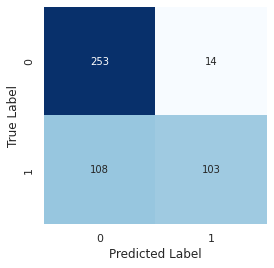

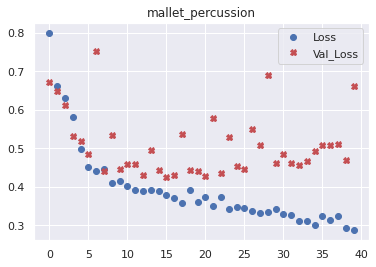

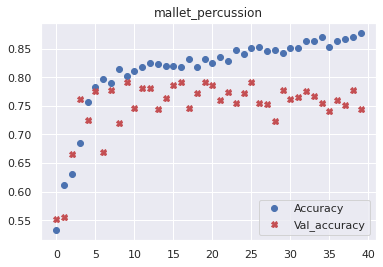


Ejemplo de predicciones:  mallet_percussion
True label:  [0 1 0 0 1 1 0 0 0 0]
Predicted:   [[0.33102256 0.57559276 0.07182757 0.05090873 0.5835242  0.25877464
  0.00150082 0.00141246 0.0018218  0.00127215]]
Model: "sequential_554"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_114 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_794 (Dropout)       (None, 250)               0         
                                                                 
 dense_1108 (Dense)          (None, 40)                10040     
                                                                 
 dense_1109 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
___________________________________

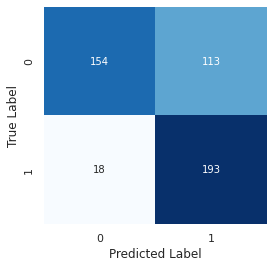

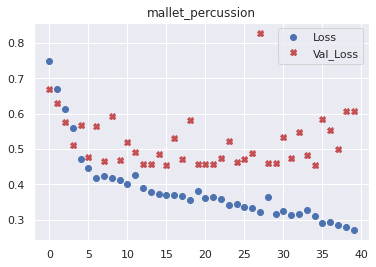

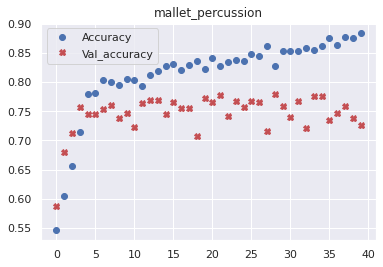


Ejemplo de predicciones:  mallet_percussion
True label:  [0 1 0 0 1 1 0 0 0 0]
Predicted:   [[0.6682194  0.8969565  0.3494225  0.41296205 0.9685102  0.85837674
  0.00678552 0.00435996 0.0050687  0.00707061]]
Model: "sequential_555"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_115 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_795 (Dropout)       (None, 250)               0         
                                                                 
 dense_1110 (Dense)          (None, 40)                10040     
                                                                 
 dense_1111 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
___________________________________

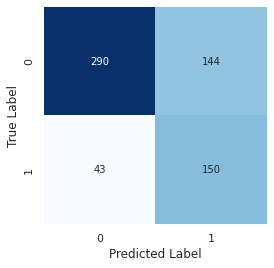

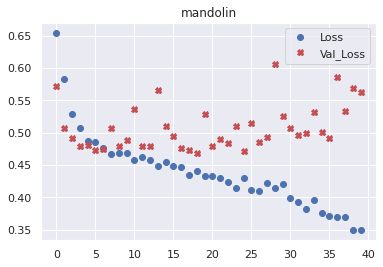

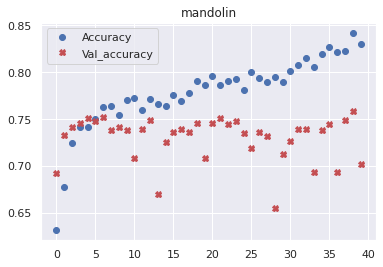


Ejemplo de predicciones:  mandolin
True label:  [0 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.01157022 0.8496309  0.11092    0.43975037 0.4021396  0.7324207
  0.8118654  0.6424447  0.02775654 0.00093077]]
Model: "sequential_556"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_116 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_796 (Dropout)       (None, 250)               0         
                                                                 
 dense_1112 (Dense)          (None, 40)                10040     
                                                                 
 dense_1113 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_____________________________________________

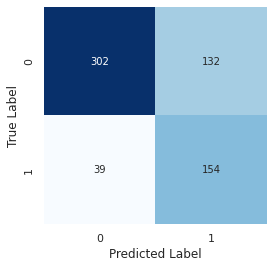

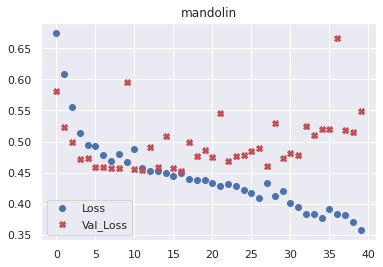

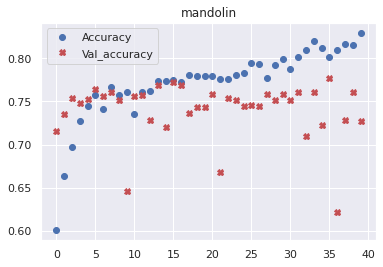


Ejemplo de predicciones:  mandolin
True label:  [0 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.00477432 0.858386   0.09953655 0.4707552  0.5467259  0.42327872
  0.78535515 0.1634752  0.01108839 0.00160728]]
Model: "sequential_557"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_117 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_797 (Dropout)       (None, 250)               0         
                                                                 
 dense_1114 (Dense)          (None, 40)                10040     
                                                                 
 dense_1115 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
____________________________________________

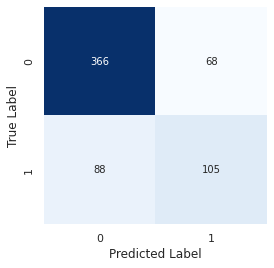

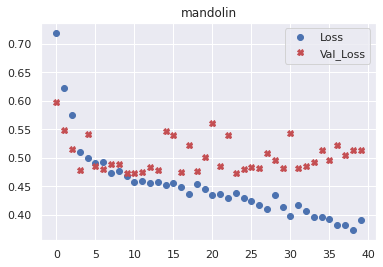

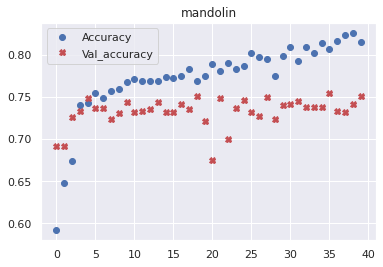


Ejemplo de predicciones:  mandolin
True label:  [0 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.006118   0.73391235 0.03691671 0.31037527 0.34587172 0.09497052
  0.15886904 0.16027324 0.02329923 0.00214515]]
Model: "sequential_558"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_118 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_798 (Dropout)       (None, 250)               0         
                                                                 
 dense_1116 (Dense)          (None, 40)                10040     
                                                                 
 dense_1117 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
____________________________________________

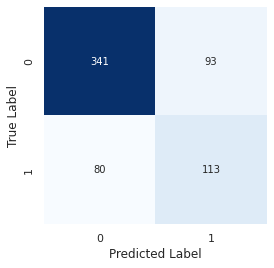

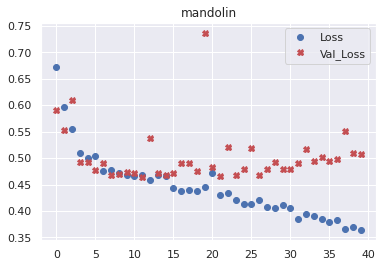

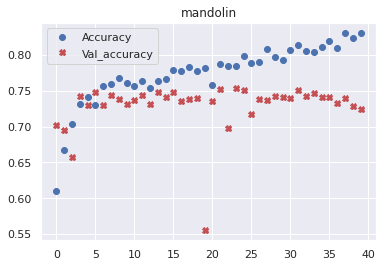


Ejemplo de predicciones:  mandolin
True label:  [0 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.00672244 0.62379014 0.09024981 0.11510589 0.38324103 0.2242726
  0.4144647  0.36734056 0.01006582 0.00277114]]
Model: "sequential_559"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_119 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_799 (Dropout)       (None, 250)               0         
                                                                 
 dense_1118 (Dense)          (None, 40)                10040     
                                                                 
 dense_1119 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_____________________________________________

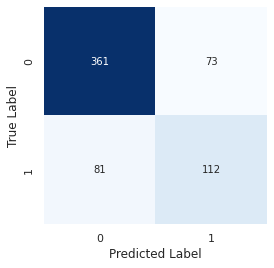

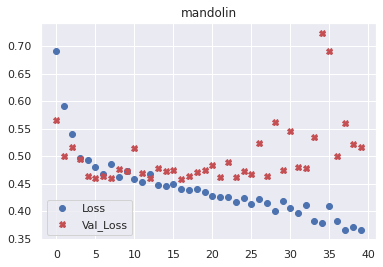

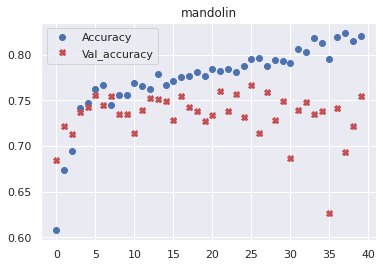


Ejemplo de predicciones:  mandolin
True label:  [0 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.00336653 0.75650686 0.11486936 0.07745332 0.37159267 0.12198971
  0.33455735 0.02498481 0.00883295 0.00124939]]
Model: "sequential_560"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_120 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_800 (Dropout)       (None, 250)               0         
                                                                 
 dense_1120 (Dense)          (None, 40)                10040     
                                                                 
 dense_1121 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
____________________________________________

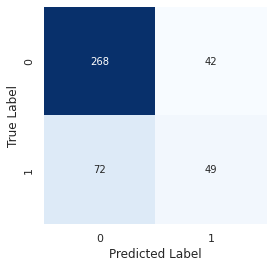

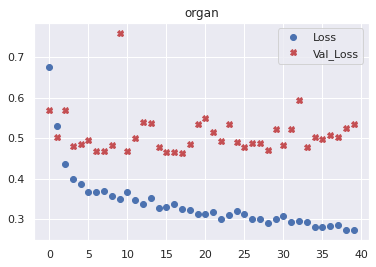

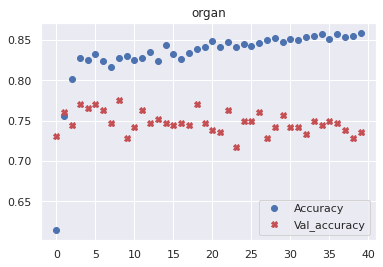


Ejemplo de predicciones:  organ
True label:  [0 0 0 1 0 1 0 0 0 0]
Predicted:   [[0.00889637 0.7116089  0.45655555 0.24437    0.00549054 0.553597
  0.00117212 0.00192917 0.00089425 0.00162455]]
Model: "sequential_561"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_121 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_801 (Dropout)       (None, 250)               0         
                                                                 
 dense_1122 (Dense)          (None, 40)                10040     
                                                                 
 dense_1123 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_________________________________________________

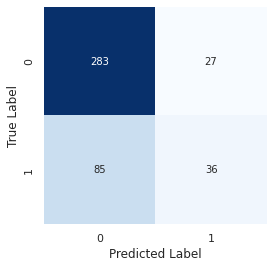

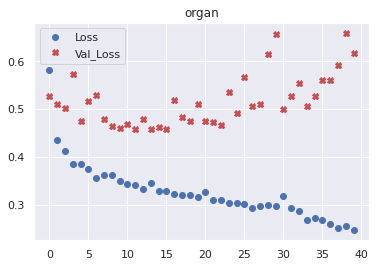

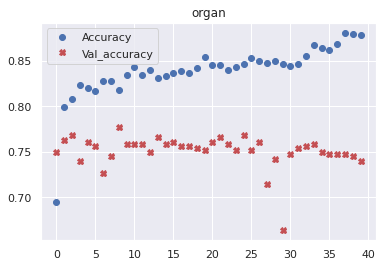


Ejemplo de predicciones:  organ
True label:  [0 0 0 1 0 1 0 0 0 0]
Predicted:   [[1.36389420e-03 2.44215012e-01 1.18062265e-01 4.15856019e-02
  1.22164155e-03 5.76520801e-01 1.43371848e-03 9.63821833e-04
  2.47946504e-04 8.26819916e-04]]
Model: "sequential_562"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_122 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_802 (Dropout)       (None, 250)               0         
                                                                 
 dense_1124 (Dense)          (None, 40)                10040     
                                                                 
 dense_1125 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_____

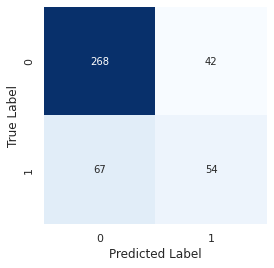

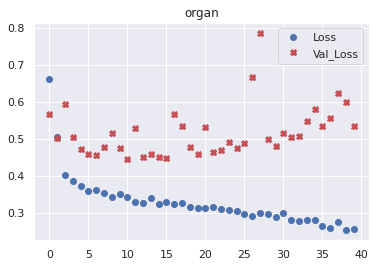

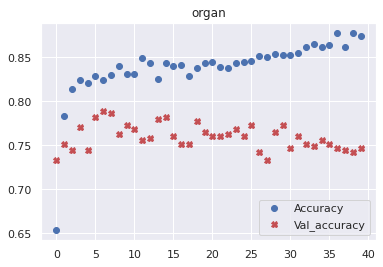


Ejemplo de predicciones:  organ
True label:  [0 0 0 1 0 1 0 0 0 0]
Predicted:   [[0.08236198 0.40827245 0.32960355 0.19983369 0.00892306 0.6774573
  0.00124564 0.00154831 0.0007506  0.00242803]]
Model: "sequential_563"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_123 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_803 (Dropout)       (None, 250)               0         
                                                                 
 dense_1126 (Dense)          (None, 40)                10040     
                                                                 
 dense_1127 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
________________________________________________

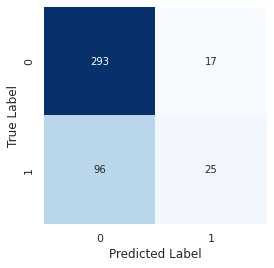

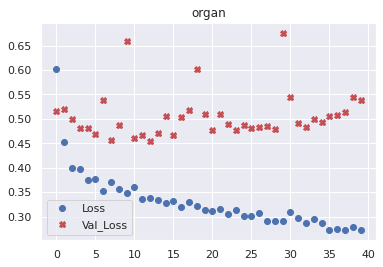

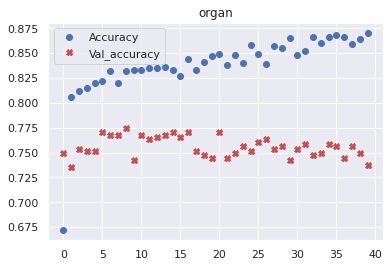


Ejemplo de predicciones:  organ
True label:  [0 0 0 1 0 1 0 0 0 0]
Predicted:   [[0.01482571 0.41027558 0.20970438 0.10674874 0.00510516 0.45781988
  0.00257106 0.00227331 0.00156417 0.00197957]]
Model: "sequential_564"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_124 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_804 (Dropout)       (None, 250)               0         
                                                                 
 dense_1128 (Dense)          (None, 40)                10040     
                                                                 
 dense_1129 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________________________________________

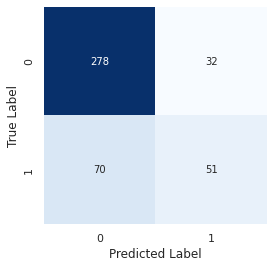

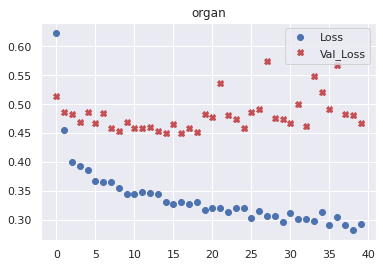

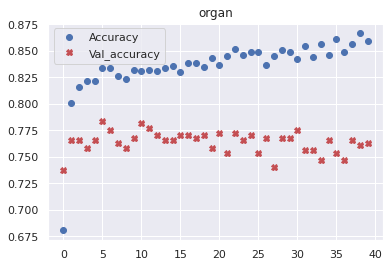


Ejemplo de predicciones:  organ
True label:  [0 0 0 1 0 1 0 0 0 0]
Predicted:   [[0.07517862 0.67568606 0.3213798  0.40014258 0.02059589 0.5173817
  0.00154397 0.01222291 0.00224353 0.00562341]]
Model: "sequential_565"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_125 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_805 (Dropout)       (None, 250)               0         
                                                                 
 dense_1130 (Dense)          (None, 40)                10040     
                                                                 
 dense_1131 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
________________________________________________

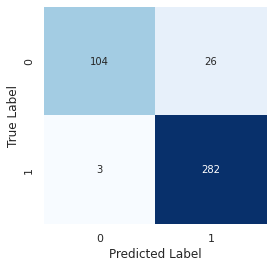

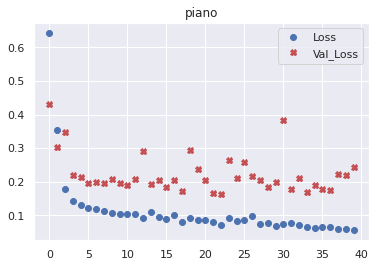

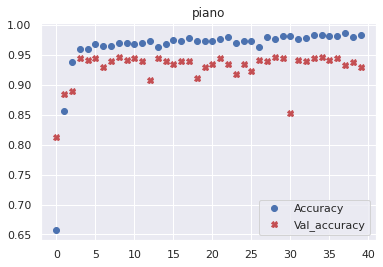


Ejemplo de predicciones:  piano
True label:  [0 0 0 0 0 0 0 1 0 0]
Predicted:   [[4.2691953e-03 3.1523651e-03 2.6549404e-03 2.2318965e-02 1.7648275e-03
  5.6524819e-04 2.1389807e-03 9.6671516e-01 9.3143833e-01 1.0065247e-03]]
Model: "sequential_566"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_126 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_806 (Dropout)       (None, 250)               0         
                                                                 
 dense_1132 (Dense)          (None, 40)                10040     
                                                                 
 dense_1133 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_________________

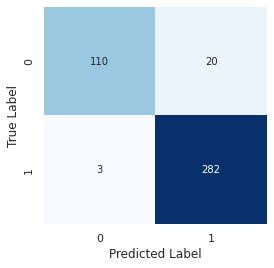

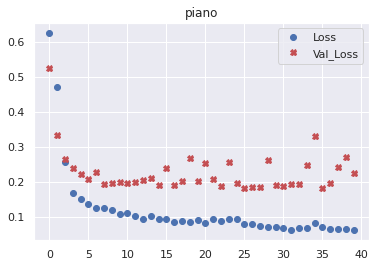

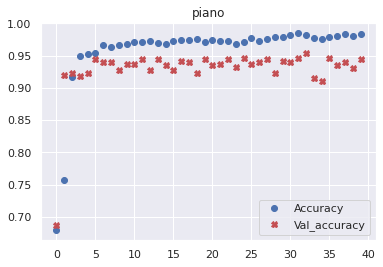


Ejemplo de predicciones:  piano
True label:  [0 0 0 0 0 0 0 1 0 0]
Predicted:   [[0.00359719 0.00345905 0.00446985 0.00226614 0.00356455 0.00118063
  0.00157577 0.89439315 0.93817717 0.00129815]]
Model: "sequential_567"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_127 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_807 (Dropout)       (None, 250)               0         
                                                                 
 dense_1134 (Dense)          (None, 40)                10040     
                                                                 
 dense_1135 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________________________________________

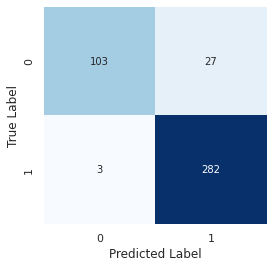

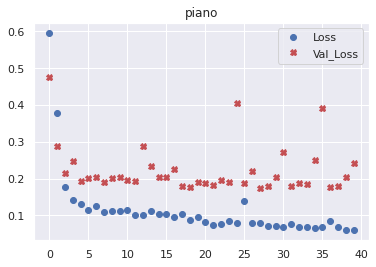

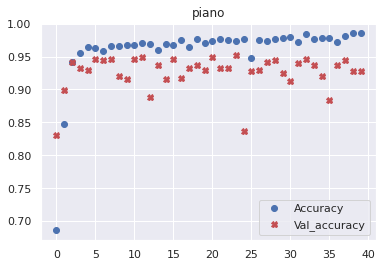


Ejemplo de predicciones:  piano
True label:  [0 0 0 0 0 0 0 1 0 0]
Predicted:   [[0.03960577 0.00700085 0.17268686 0.05929462 0.00850322 0.00260599
  0.00889857 0.79446906 0.96719074 0.00666516]]
Model: "sequential_568"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_128 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_808 (Dropout)       (None, 250)               0         
                                                                 
 dense_1136 (Dense)          (None, 40)                10040     
                                                                 
 dense_1137 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________________________________________

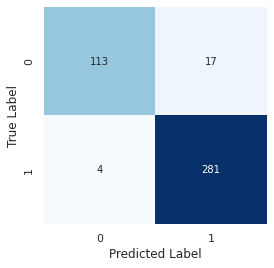

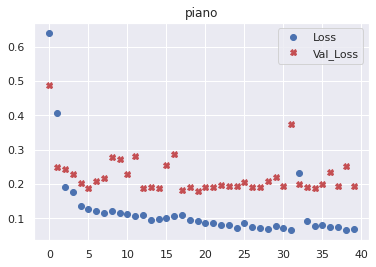

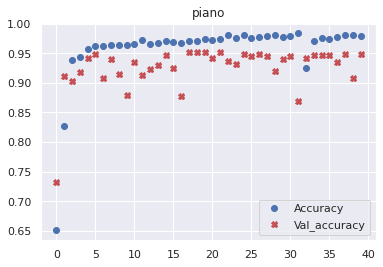


Ejemplo de predicciones:  piano
True label:  [0 0 0 0 0 0 0 1 0 0]
Predicted:   [[0.00251166 0.00266656 0.01708702 0.00902765 0.00322903 0.0011973
  0.00317273 0.7745491  0.8882108  0.00184389]]
Model: "sequential_569"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_129 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_809 (Dropout)       (None, 250)               0         
                                                                 
 dense_1138 (Dense)          (None, 40)                10040     
                                                                 
 dense_1139 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
________________________________________________

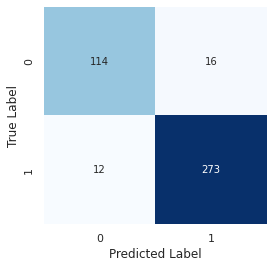

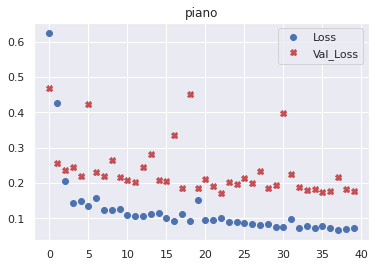

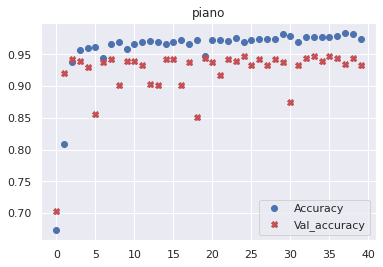


Ejemplo de predicciones:  piano
True label:  [0 0 0 0 0 0 0 1 0 0]
Predicted:   [[0.00214478 0.00199289 0.00420082 0.00454912 0.00292715 0.00209352
  0.00455958 0.47450787 0.7404079  0.00266385]]
Model: "sequential_570"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_130 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_810 (Dropout)       (None, 250)               0         
                                                                 
 dense_1140 (Dense)          (None, 40)                10040     
                                                                 
 dense_1141 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________________________________________

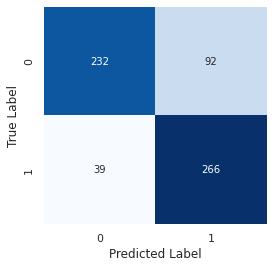

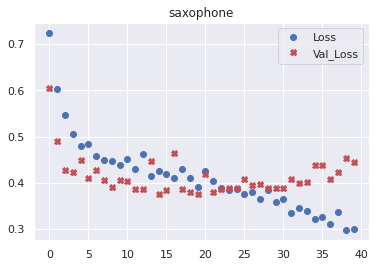

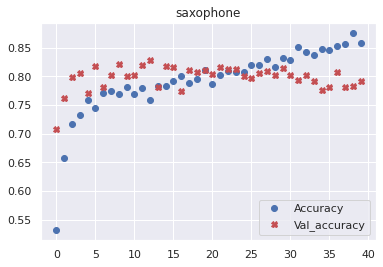


Ejemplo de predicciones:  saxophone
True label:  [0 1 0 0 0 0 0 0 0 1]
Predicted:   [[0.20112087 0.66163063 0.00276779 0.0016425  0.67068005 0.01257114
  0.49518463 0.3766656  0.3463348  0.7898898 ]]
Model: "sequential_571"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_131 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_811 (Dropout)       (None, 250)               0         
                                                                 
 dense_1142 (Dense)          (None, 40)                10040     
                                                                 
 dense_1143 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
___________________________________________

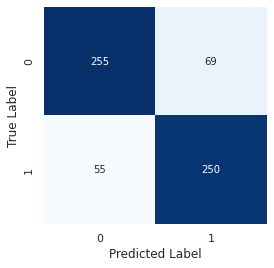

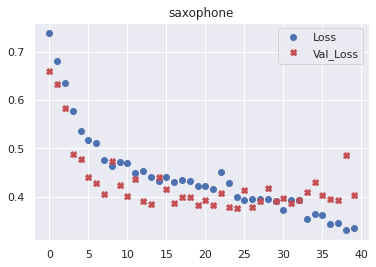

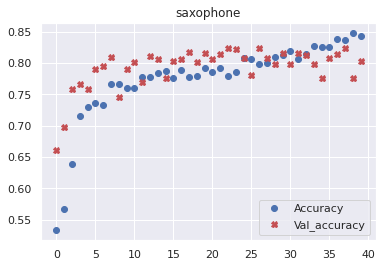


Ejemplo de predicciones:  saxophone
True label:  [0 1 0 0 0 0 0 0 0 1]
Predicted:   [[0.18848221 0.83009267 0.00334517 0.00755222 0.6551986  0.00367843
  0.21871461 0.27167106 0.2870089  0.5420831 ]]
Model: "sequential_572"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_132 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_812 (Dropout)       (None, 250)               0         
                                                                 
 dense_1144 (Dense)          (None, 40)                10040     
                                                                 
 dense_1145 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
___________________________________________

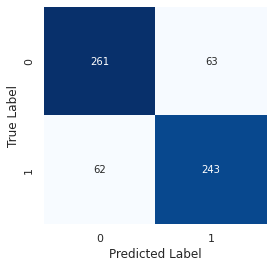

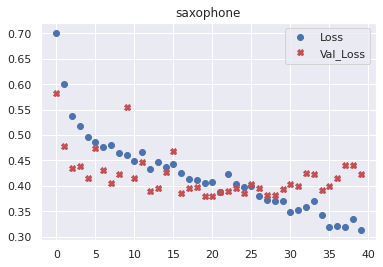

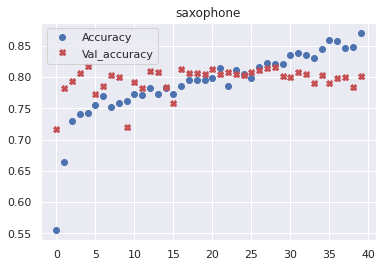


Ejemplo de predicciones:  saxophone
True label:  [0 1 0 0 0 0 0 0 0 1]
Predicted:   [[0.23938867 0.8485488  0.01043222 0.0118506  0.59944963 0.00180728
  0.11991856 0.33695602 0.1694106  0.6457569 ]]
Model: "sequential_573"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_133 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_813 (Dropout)       (None, 250)               0         
                                                                 
 dense_1146 (Dense)          (None, 40)                10040     
                                                                 
 dense_1147 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
___________________________________________

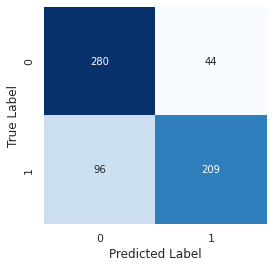

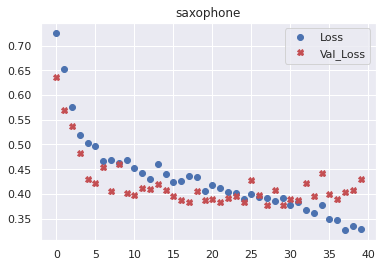

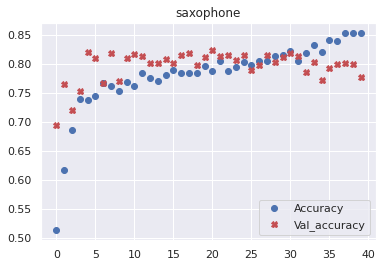


Ejemplo de predicciones:  saxophone
True label:  [0 1 0 0 0 0 0 0 0 1]
Predicted:   [[0.26671654 0.6372639  0.00747768 0.00130657 0.34017858 0.01475395
  0.07389049 0.47719863 0.15137203 0.44348598]]
Model: "sequential_574"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_134 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_814 (Dropout)       (None, 250)               0         
                                                                 
 dense_1148 (Dense)          (None, 40)                10040     
                                                                 
 dense_1149 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
___________________________________________

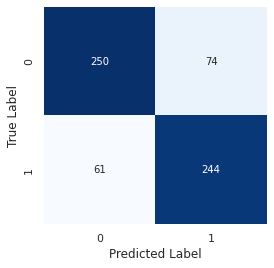

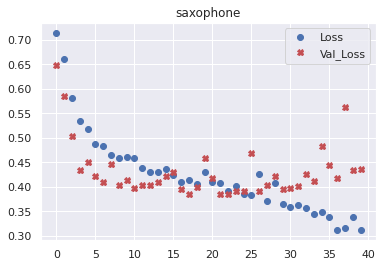

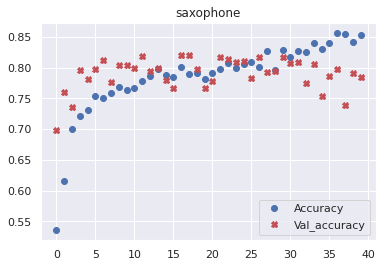


Ejemplo de predicciones:  saxophone
True label:  [0 1 0 0 0 0 0 0 0 1]
Predicted:   [[0.27218235 0.8656164  0.00729352 0.00824827 0.8604163  0.02234653
  0.36027783 0.2874847  0.2625179  0.57207716]]
Model: "sequential_575"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_135 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_815 (Dropout)       (None, 250)               0         
                                                                 
 dense_1150 (Dense)          (None, 40)                10040     
                                                                 
 dense_1151 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
___________________________________________

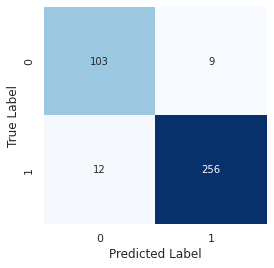

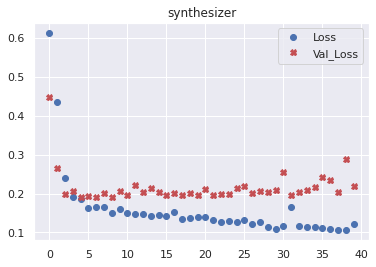

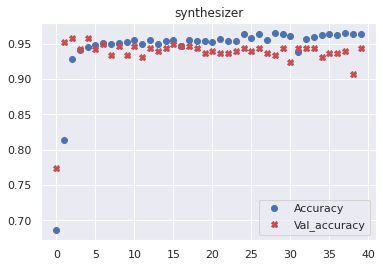


Ejemplo de predicciones:  synthesizer
True label:  [1 1 1 1 1 0 1 1 1 1]
Predicted:   [[0.2069642  0.9847098  0.99340856 0.9365319  0.99055254 0.07731757
  0.9932173  0.9963971  0.99348664 0.99075246]]
Model: "sequential_576"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_136 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_816 (Dropout)       (None, 250)               0         
                                                                 
 dense_1152 (Dense)          (None, 40)                10040     
                                                                 
 dense_1153 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_________________________________________

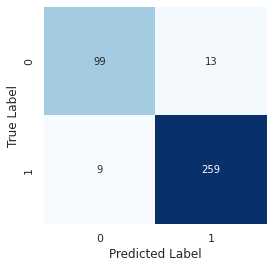

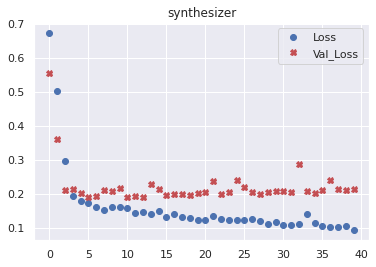

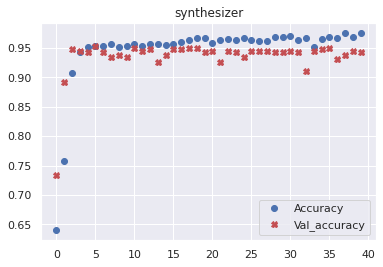


Ejemplo de predicciones:  synthesizer
True label:  [1 1 1 1 1 0 1 1 1 1]
Predicted:   [[0.7873154  0.9949181  0.9894414  0.91469353 0.99050355 0.06857669
  0.99437535 0.9950453  0.9939336  0.9938082 ]]
Model: "sequential_577"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_137 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_817 (Dropout)       (None, 250)               0         
                                                                 
 dense_1154 (Dense)          (None, 40)                10040     
                                                                 
 dense_1155 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_________________________________________

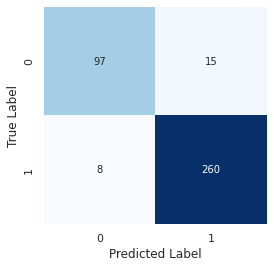

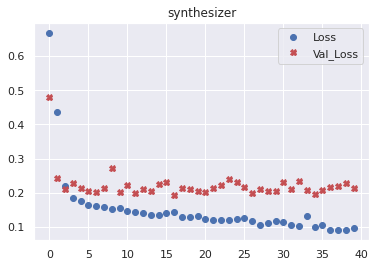

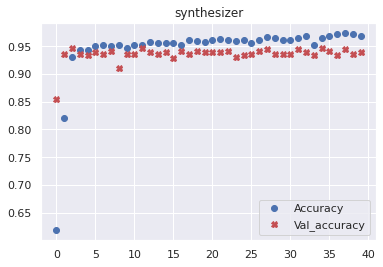


Ejemplo de predicciones:  synthesizer
True label:  [1 1 1 1 1 0 1 1 1 1]
Predicted:   [[0.8204095  0.99250424 0.9944602  0.9747515  0.9886636  0.07287601
  0.9976528  0.9965641  0.99425805 0.995577  ]]
Model: "sequential_578"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_138 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_818 (Dropout)       (None, 250)               0         
                                                                 
 dense_1156 (Dense)          (None, 40)                10040     
                                                                 
 dense_1157 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_________________________________________

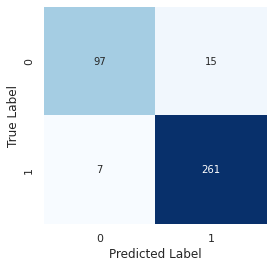

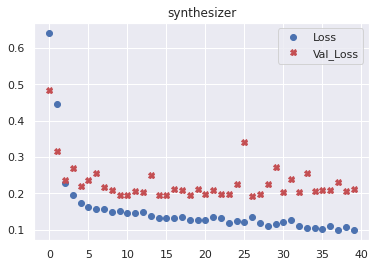

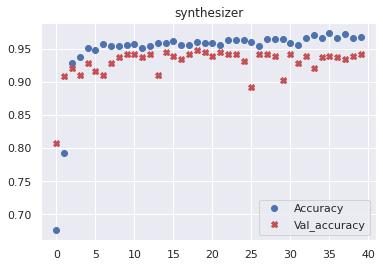


Ejemplo de predicciones:  synthesizer
True label:  [1 1 1 1 1 0 1 1 1 1]
Predicted:   [[0.6503898  0.99153465 0.993986   0.9397217  0.9908732  0.07366193
  0.99313265 0.9943562  0.99453413 0.99309903]]
Model: "sequential_579"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_139 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_819 (Dropout)       (None, 250)               0         
                                                                 
 dense_1158 (Dense)          (None, 40)                10040     
                                                                 
 dense_1159 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_________________________________________

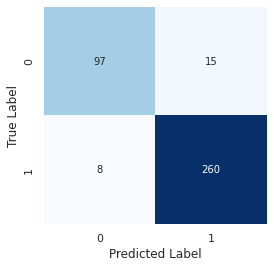

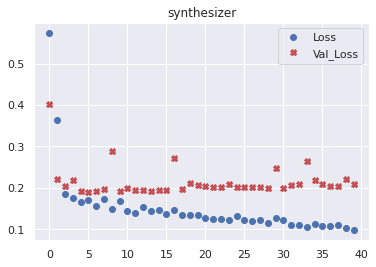

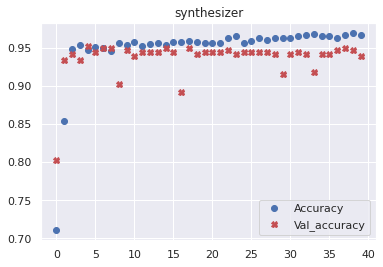


Ejemplo de predicciones:  synthesizer
True label:  [1 1 1 1 1 0 1 1 1 1]
Predicted:   [[0.949559   0.9955356  0.99625444 0.9720176  0.9938834  0.21721682
  0.9952744  0.99558336 0.99518675 0.9949837 ]]
Model: "sequential_580"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_140 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_820 (Dropout)       (None, 250)               0         
                                                                 
 dense_1160 (Dense)          (None, 40)                10040     
                                                                 
 dense_1161 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_________________________________________

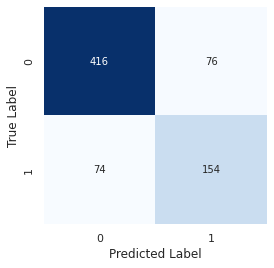

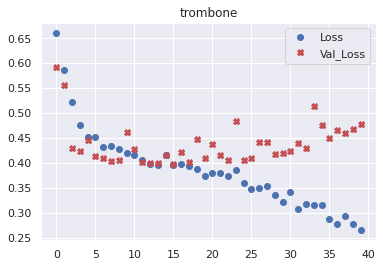

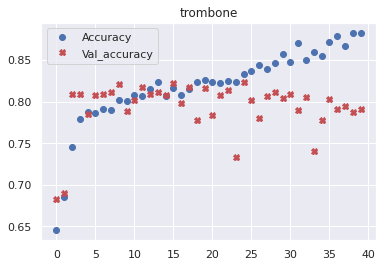


Ejemplo de predicciones:  trombone
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.00129185 0.5293479  0.03923896 0.04255145 0.8088098  0.11207265
  0.11639056 0.0018807  0.17439513 0.00196007]]
Model: "sequential_581"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_141 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_821 (Dropout)       (None, 250)               0         
                                                                 
 dense_1162 (Dense)          (None, 40)                10040     
                                                                 
 dense_1163 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
____________________________________________

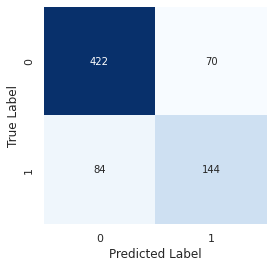

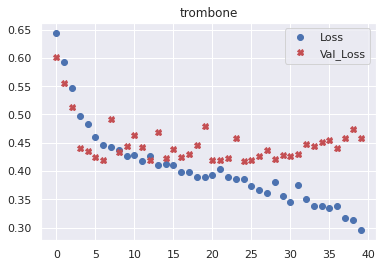

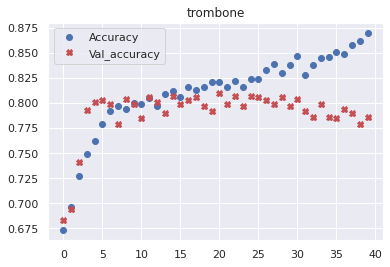


Ejemplo de predicciones:  trombone
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.01365814 0.8207954  0.23605195 0.05629028 0.6745272  0.18202256
  0.13834308 0.00143895 0.07488545 0.00689841]]
Model: "sequential_582"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_142 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_822 (Dropout)       (None, 250)               0         
                                                                 
 dense_1164 (Dense)          (None, 40)                10040     
                                                                 
 dense_1165 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
____________________________________________

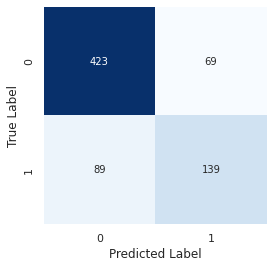

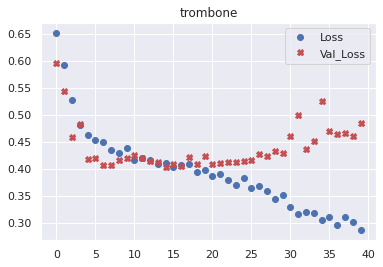

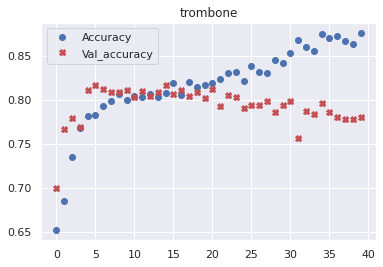


Ejemplo de predicciones:  trombone
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.01472456 0.42009062 0.1435029  0.00855702 0.60020024 0.07007074
  0.6834525  0.00227729 0.04224171 0.00156583]]
Model: "sequential_583"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_143 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_823 (Dropout)       (None, 250)               0         
                                                                 
 dense_1166 (Dense)          (None, 40)                10040     
                                                                 
 dense_1167 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
____________________________________________

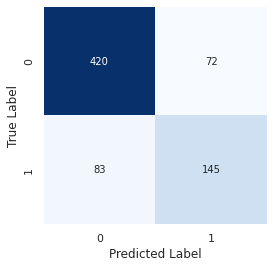

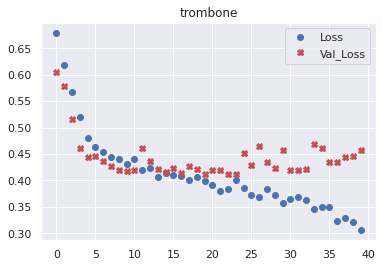

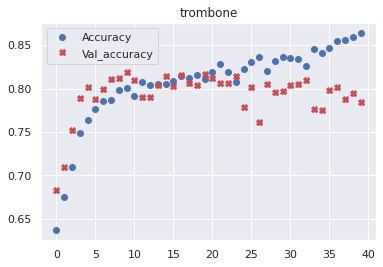


Ejemplo de predicciones:  trombone
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.03756611 0.5681615  0.05737245 0.05299908 0.7805388  0.10085421
  0.14516263 0.00230228 0.09188204 0.00681278]]
Model: "sequential_584"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_144 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_824 (Dropout)       (None, 250)               0         
                                                                 
 dense_1168 (Dense)          (None, 40)                10040     
                                                                 
 dense_1169 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
____________________________________________

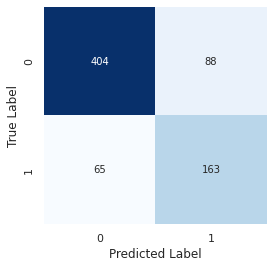

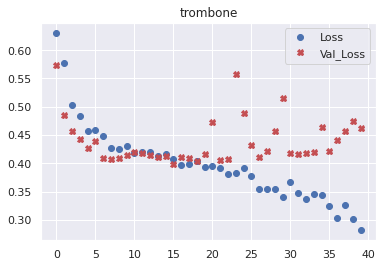

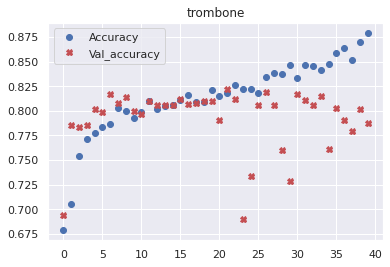


Ejemplo de predicciones:  trombone
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.00912172 0.764116   0.02167262 0.0394274  0.7241938  0.4120351
  0.11971046 0.00117165 0.09115132 0.00288192]]
Model: "sequential_585"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_145 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_825 (Dropout)       (None, 250)               0         
                                                                 
 dense_1170 (Dense)          (None, 40)                10040     
                                                                 
 dense_1171 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_____________________________________________

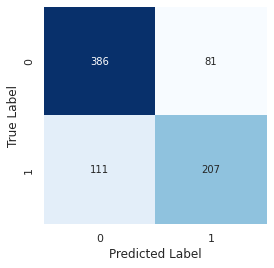

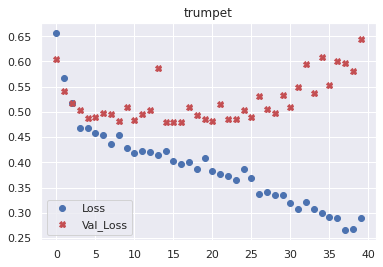

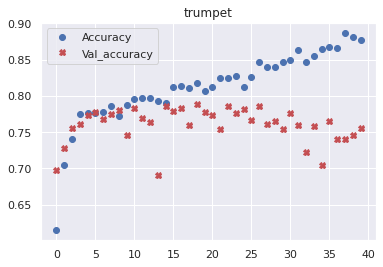


Ejemplo de predicciones:  trumpet
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.00232754 0.01069154 0.02948551 0.21691698 0.9283189  0.68036675
  0.00193918 0.6324001  0.01105294 0.00489994]]
Model: "sequential_586"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_146 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_826 (Dropout)       (None, 250)               0         
                                                                 
 dense_1172 (Dense)          (None, 40)                10040     
                                                                 
 dense_1173 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_____________________________________________

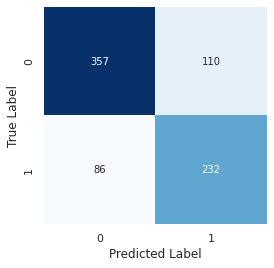

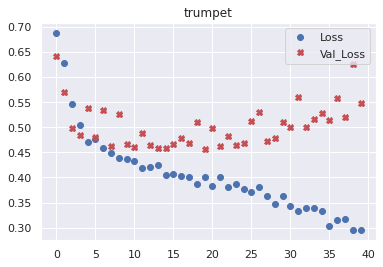

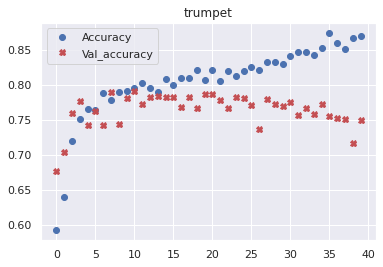


Ejemplo de predicciones:  trumpet
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.08257218 0.07665837 0.03588528 0.09435581 0.9686392  0.31057644
  0.03087356 0.77049494 0.14993547 0.03858149]]
Model: "sequential_587"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_147 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_827 (Dropout)       (None, 250)               0         
                                                                 
 dense_1174 (Dense)          (None, 40)                10040     
                                                                 
 dense_1175 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_____________________________________________

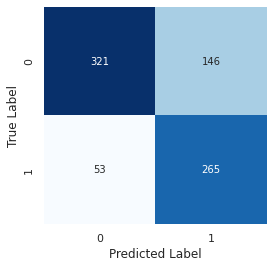

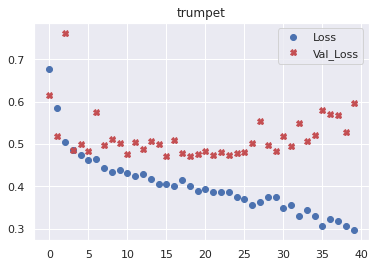

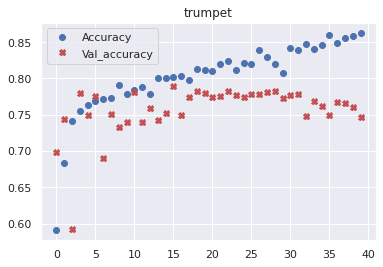


Ejemplo de predicciones:  trumpet
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.25327623 0.27732512 0.16501498 0.40795147 0.9750004  0.76651174
  0.01036948 0.9437481  0.10480446 0.02860606]]
Model: "sequential_588"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_148 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_828 (Dropout)       (None, 250)               0         
                                                                 
 dense_1176 (Dense)          (None, 40)                10040     
                                                                 
 dense_1177 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_____________________________________________

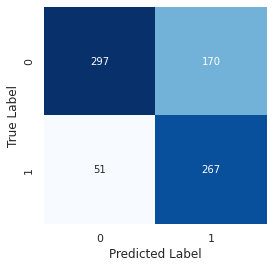

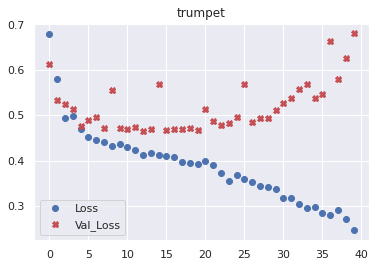

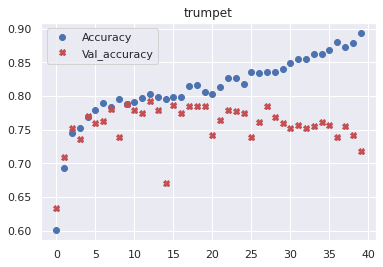


Ejemplo de predicciones:  trumpet
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.42971545 0.67553747 0.04842702 0.34979245 0.97918713 0.914081
  0.03469791 0.9667409  0.1587798  0.04787006]]
Model: "sequential_589"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_149 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_829 (Dropout)       (None, 250)               0         
                                                                 
 dense_1178 (Dense)          (None, 40)                10040     
                                                                 
 dense_1179 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________________________________________

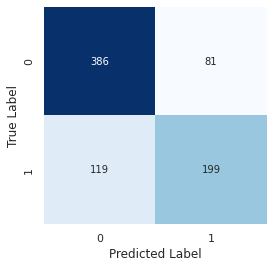

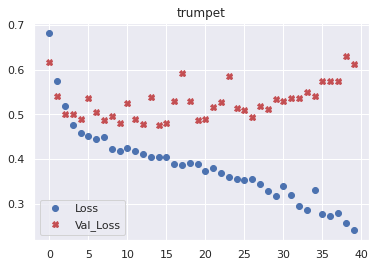

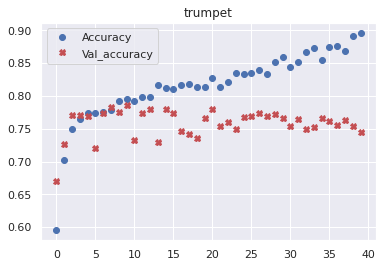


Ejemplo de predicciones:  trumpet
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[8.7604746e-02 8.5876724e-03 4.0361200e-02 1.9901386e-01 9.8095840e-01
  3.2702491e-01 8.7787758e-04 9.4295621e-01 4.0988602e-02 2.7772975e-03]]
Model: "sequential_590"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_150 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_830 (Dropout)       (None, 250)               0         
                                                                 
 dense_1180 (Dense)          (None, 40)                10040     
                                                                 
 dense_1181 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________

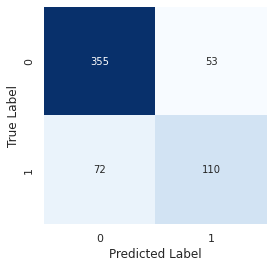

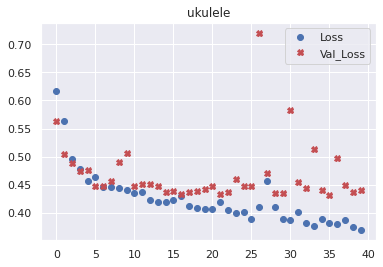

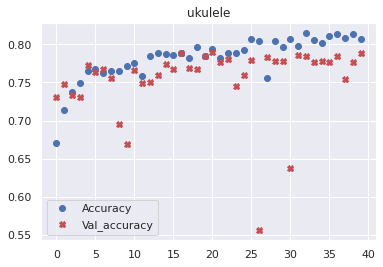


Ejemplo de predicciones:  ukulele
True label:  [1 0 0 0 0 1 0 0 0 0]
Predicted:   [[7.7362573e-01 2.1615556e-02 2.3538347e-02 5.1189046e-02 2.9781675e-01
  3.3861840e-01 6.5679866e-04 9.6990762e-04 1.7706460e-03 4.8083788e-01]]
Model: "sequential_591"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_151 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_831 (Dropout)       (None, 250)               0         
                                                                 
 dense_1182 (Dense)          (None, 40)                10040     
                                                                 
 dense_1183 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________

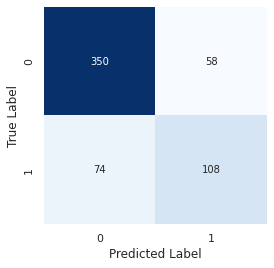

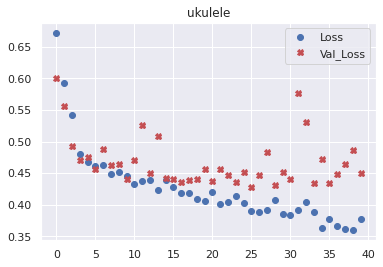

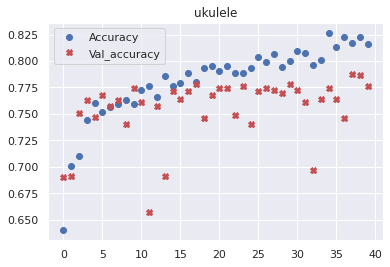


Ejemplo de predicciones:  ukulele
True label:  [1 0 0 0 0 1 0 0 0 0]
Predicted:   [[8.8468546e-01 4.0904386e-03 1.1713178e-02 9.3489692e-02 4.5423546e-01
  4.4359452e-01 1.0925500e-03 5.8197626e-04 2.0947251e-03 3.6587366e-01]]
Model: "sequential_592"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_152 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_832 (Dropout)       (None, 250)               0         
                                                                 
 dense_1184 (Dense)          (None, 40)                10040     
                                                                 
 dense_1185 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________

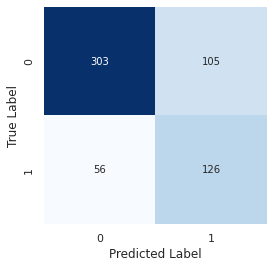

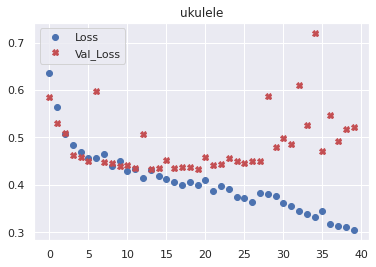

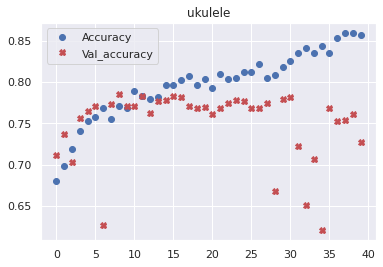


Ejemplo de predicciones:  ukulele
True label:  [1 0 0 0 0 1 0 0 0 0]
Predicted:   [[9.0262049e-01 4.4036042e-02 1.9000812e-02 2.1054158e-01 7.6487976e-01
  4.1118506e-01 1.2034453e-03 5.0071254e-04 1.2824776e-03 3.6179161e-01]]
Model: "sequential_593"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_153 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_833 (Dropout)       (None, 250)               0         
                                                                 
 dense_1186 (Dense)          (None, 40)                10040     
                                                                 
 dense_1187 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________

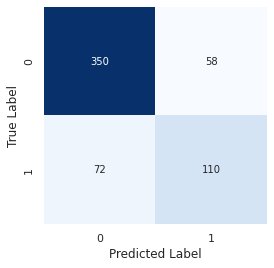

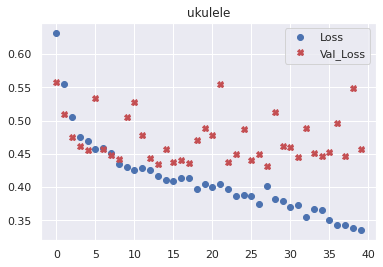

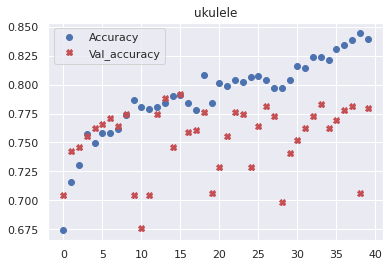


Ejemplo de predicciones:  ukulele
True label:  [1 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.85790455 0.00977989 0.0340614  0.07793647 0.64722097 0.42062667
  0.00099071 0.00121332 0.00155765 0.5268476 ]]
Model: "sequential_594"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_154 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_834 (Dropout)       (None, 250)               0         
                                                                 
 dense_1188 (Dense)          (None, 40)                10040     
                                                                 
 dense_1189 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_____________________________________________

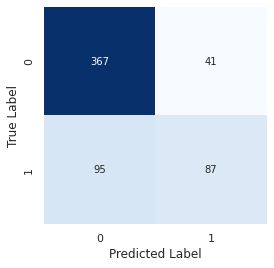

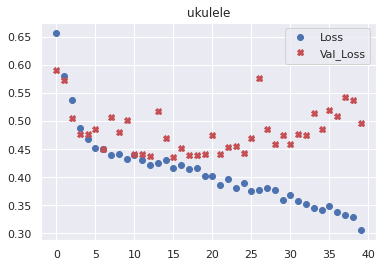

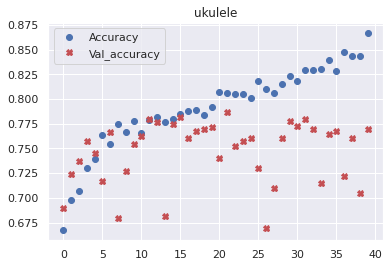


Ejemplo de predicciones:  ukulele
True label:  [1 0 0 0 0 1 0 0 0 0]
Predicted:   [[8.1018531e-01 7.8239357e-03 8.8473801e-03 3.1061482e-02 4.5257959e-01
  2.6180884e-01 3.6972441e-04 7.0634863e-04 8.4228424e-04 2.5093761e-01]]
Model: "sequential_595"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_155 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_835 (Dropout)       (None, 250)               0         
                                                                 
 dense_1190 (Dense)          (None, 40)                10040     
                                                                 
 dense_1191 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________

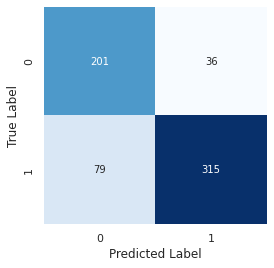

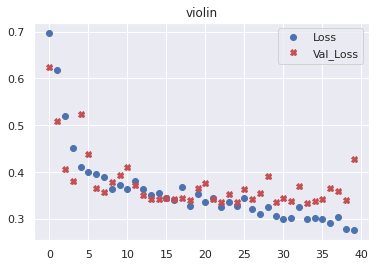

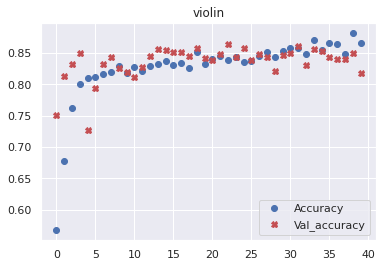


Ejemplo de predicciones:  violin
True label:  [0 0 1 0 0 0 0 0 0 1]
Predicted:   [[0.2571445  0.7615293  0.5876712  0.01263459 0.8622814  0.00174551
  0.00266281 0.00185215 0.00262868 0.8890755 ]]
Model: "sequential_596"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_156 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_836 (Dropout)       (None, 250)               0         
                                                                 
 dense_1192 (Dense)          (None, 40)                10040     
                                                                 
 dense_1193 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
______________________________________________

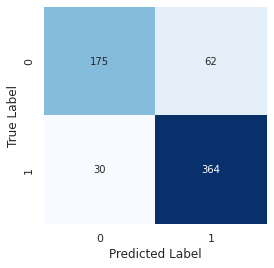

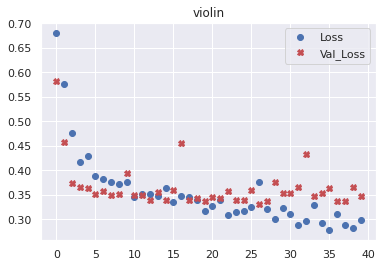

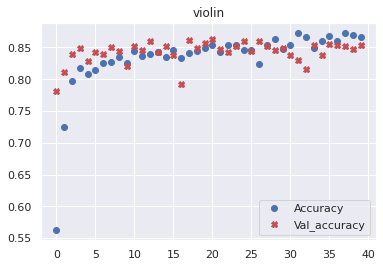


Ejemplo de predicciones:  violin
True label:  [0 0 1 0 0 0 0 0 0 1]
Predicted:   [[0.42754805 0.8129238  0.80719906 0.48452514 0.9594844  0.00216343
  0.00328303 0.00141414 0.00246439 0.9199381 ]]
Model: "sequential_597"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_157 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_837 (Dropout)       (None, 250)               0         
                                                                 
 dense_1194 (Dense)          (None, 40)                10040     
                                                                 
 dense_1195 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
______________________________________________

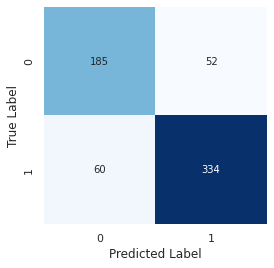

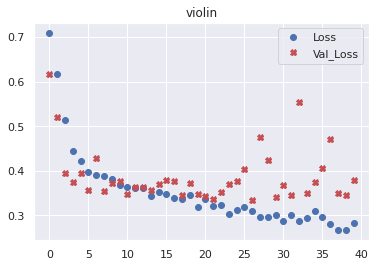

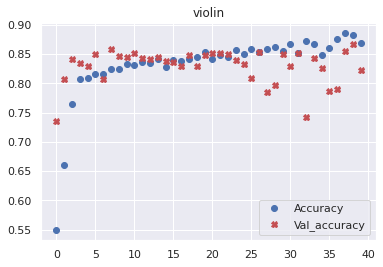


Ejemplo de predicciones:  violin
True label:  [0 0 1 0 0 0 0 0 0 1]
Predicted:   [[0.43413913 0.7731114  0.5313705  0.25912943 0.7961168  0.00136116
  0.00236029 0.00160955 0.00197974 0.72945565]]
Model: "sequential_598"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_158 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_838 (Dropout)       (None, 250)               0         
                                                                 
 dense_1196 (Dense)          (None, 40)                10040     
                                                                 
 dense_1197 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
______________________________________________

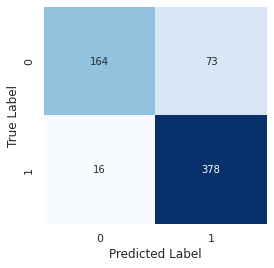

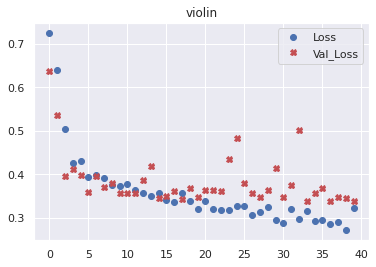

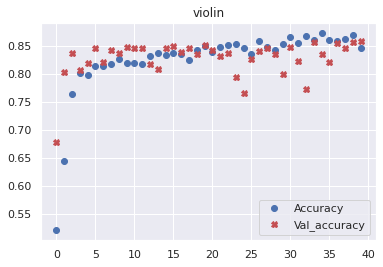


Ejemplo de predicciones:  violin
True label:  [0 0 1 0 0 0 0 0 0 1]
Predicted:   [[0.3353638  0.741816   0.6662195  0.43215787 0.9272414  0.0010613
  0.00404631 0.00094011 0.00588264 0.8916408 ]]
Model: "sequential_599"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_159 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_839 (Dropout)       (None, 250)               0         
                                                                 
 dense_1198 (Dense)          (None, 40)                10040     
                                                                 
 dense_1199 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________________________________________

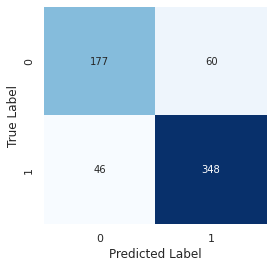

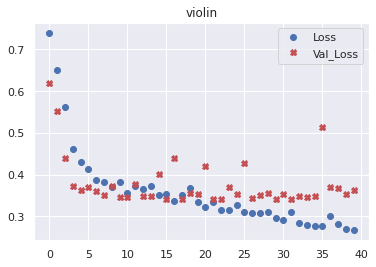

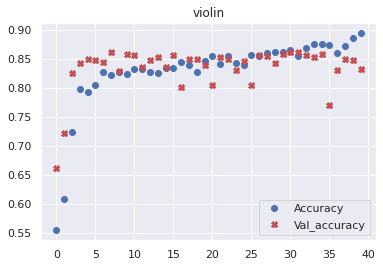


Ejemplo de predicciones:  violin
True label:  [0 0 1 0 0 0 0 0 0 1]
Predicted:   [[0.3344518  0.7242954  0.3795117  0.31874838 0.8525082  0.00223755
  0.00470014 0.00099527 0.00708147 0.84290016]]
Model: "sequential_600"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_160 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_840 (Dropout)       (None, 250)               0         
                                                                 
 dense_1200 (Dense)          (None, 40)                10040     
                                                                 
 dense_1201 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
______________________________________________

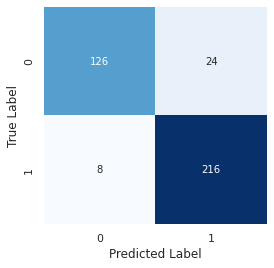

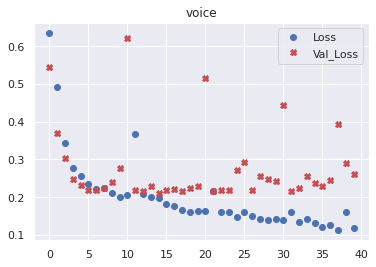

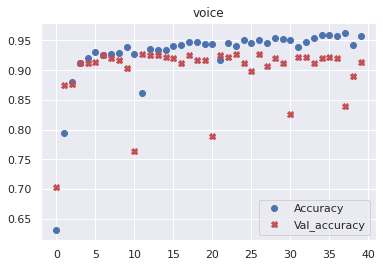


Ejemplo de predicciones:  voice
True label:  [1 0 1 1 1 1 1 0 1 1]
Predicted:   [[0.9948225  0.01520063 0.99836904 0.9965514  0.9986424  0.98954165
  0.99425054 0.01751199 0.98803395 0.9949004 ]]
Model: "sequential_601"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_161 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_841 (Dropout)       (None, 250)               0         
                                                                 
 dense_1202 (Dense)          (None, 40)                10040     
                                                                 
 dense_1203 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________________________________________

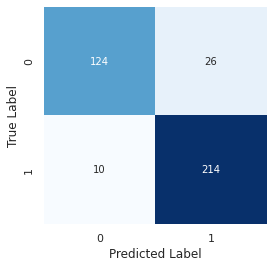

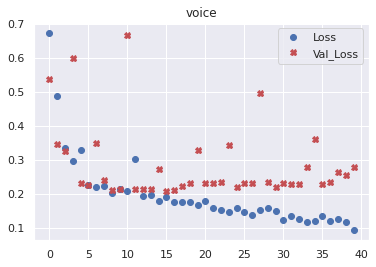

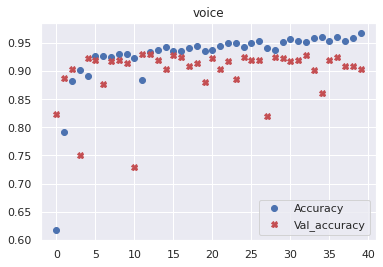


Ejemplo de predicciones:  voice
True label:  [1 0 1 1 1 1 1 0 1 1]
Predicted:   [[0.9968425  0.01590954 0.99894935 0.99760544 0.99917173 0.9928848
  0.9970433  0.00501795 0.97098583 0.9954253 ]]
Model: "sequential_602"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_162 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_842 (Dropout)       (None, 250)               0         
                                                                 
 dense_1204 (Dense)          (None, 40)                10040     
                                                                 
 dense_1205 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
________________________________________________

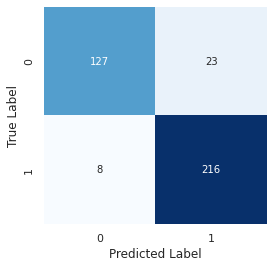

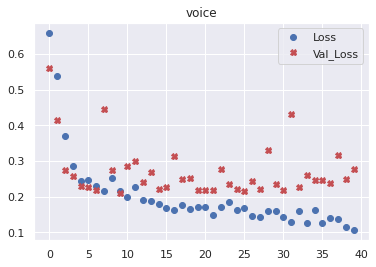

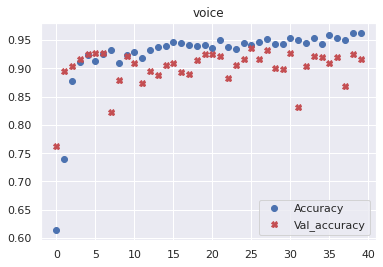


Ejemplo de predicciones:  voice
True label:  [1 0 1 1 1 1 1 0 1 1]
Predicted:   [[0.9977843  0.0109067  0.9993272  0.9987801  0.99930894 0.99655354
  0.9984823  0.00518503 0.9931386  0.99792683]]
Model: "sequential_603"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_163 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_843 (Dropout)       (None, 250)               0         
                                                                 
 dense_1206 (Dense)          (None, 40)                10040     
                                                                 
 dense_1207 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________________________________________

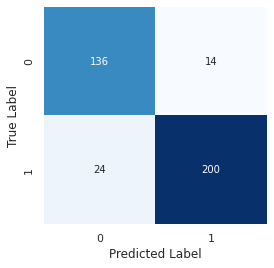

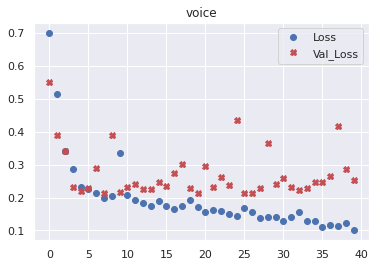

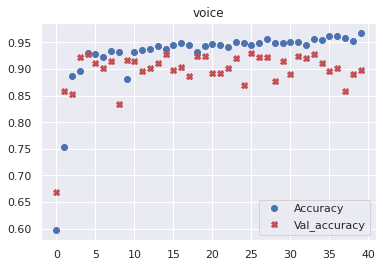


Ejemplo de predicciones:  voice
True label:  [1 0 1 1 1 1 1 0 1 1]
Predicted:   [[0.9896577  0.01187862 0.9984713  0.99822384 0.9978064  0.98297966
  0.99572456 0.00574432 0.93351334 0.99181926]]
Model: "sequential_604"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 simple_rnn_164 (SimpleRNN)  (None, 250)               94750     
                                                                 
 dropout_844 (Dropout)       (None, 250)               0         
                                                                 
 dense_1208 (Dense)          (None, 40)                10040     
                                                                 
 dense_1209 (Dense)          (None, 1)                 41        
                                                                 
Total params: 104,831
Trainable params: 104,831
Non-trainable params: 0
_______________________________________________

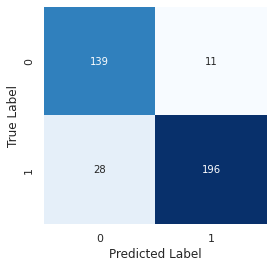

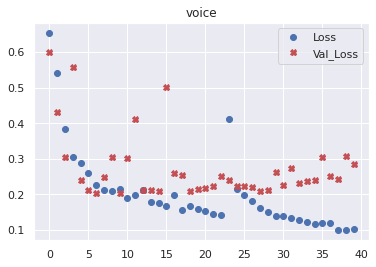

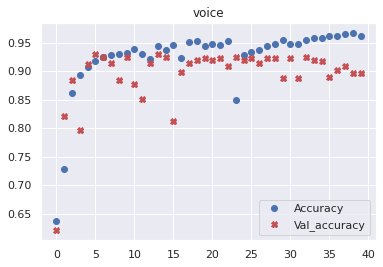


Ejemplo de predicciones:  voice
True label:  [1 0 1 1 1 1 1 0 1 1]
Predicted:   [[0.99758506 0.00601498 0.9986363  0.99650526 0.9982338  0.99643916
  0.99720407 0.00382764 0.966233   0.99744177]]


In [ ]:
## Classification optimizing accuracy
from tensorflow import keras
#import tf.keras.Sequential
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.models import Model
from keras.optimizers import gradient_descent_v2
#from keras.optimizers import SGD
#from tensorflow.keras.optimizers import SGD
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from keras.layers import Input, Dense, SimpleRNN, LSTM
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import average_precision_score
%matplotlib inline

# This dictionary will include the classifiers for each model
models = dict()
histories = dict()
recurrent_simpleRNN_results = dict()

n_realizations = 5

# We'll iterate over all istrument classes, and fit a model for each one
# After training, we'll print a classification report for each instrument
for instrument in class_map:
    
    # A list where we are going to store results of that instrument
    instrument_result_list = []
    
    # A list where we are going to store the threshold that maximizes accuracy for that instrument
    optimal_threshold_list = []

    # Map the instrument name to its column number
    inst_num = class_map[instrument]
    #if inst_num != 0:
    #  continue
    # Several train/test realizations
    for n_realizations_ in range(0,n_realizations):
        
      # Step 1: sub-sample the data
      
      # First, we need to select down to the data for which we have annotations
      # This is what the mask arrays are for
      train_inst = Y_mask_train[:, inst_num]
      test_inst = Y_mask_test[:, inst_num]
      
      # Here, we're using the Y_mask_train array to slice out only the training examples
      # for which we have annotations for the given class
      X_train_inst = X_train[train_inst]
      
      # Step 3: simplify the data by averaging over time  XXXXXXX1
      
      # Let's arrange the data for a sklearn Random Forest model 
      # Instead of having time-varying features, we'll summarize each track by its mean feature vector over time
      #X_train_inst_sklearn = np.mean(X_train_inst, axis=1)
      X_train_inst_sklearn_norm = X_train_inst / 255
      
      # Again, we slice the labels to the annotated examples XXXXXXX2
      # We thresold the label likelihoods at 0.5 to get binary labels
      Y_true_train_inst = Y_true_train[train_inst, inst_num] >= 0.5
      Y_true_train_inst = Y_true_train_inst.round()

      #X_train_inst_sklearn = X_train_inst / 255
      #X_test_inst_sklearn = X_test_inst / 255

      # Repeat the above slicing and dicing but for the test set XXXXXXX2
      X_test_inst = X_test[test_inst]
      #X_test_inst_sklearn = np.mean(X_test_inst, axis=1)
      X_test_inst_sklearn_norm = X_test_inst / 255
      Y_true_test_inst = Y_true_test[test_inst, inst_num] >= 0.5
      Y_true_test_inst = Y_true_test_inst.round()


      # Step 3.
      # Initialize a new classifier

      """
      model = Sequential()
      model.add(Dense(128, activation='relu', input_dim=X_train_inst_sklearn.shape[1]))
      model.add(Dropout(0.5))
      model.add(Dense(32, activation='relu'))
      model.add(Dropout(0.5))
      model.add(Dense(1, activation='sigmoid'))
      """
      #model = Sequential()
      #model.add(SimpleRNN(10, return_sequences=True, return_state=True))
      #model.summary()

      # define the LSTM model

      model = Sequential()
      model.add(SimpleRNN(250, input_shape=(X_train_inst_sklearn_norm.shape[1], X_train_inst_sklearn_norm.shape[2])))
      model.add(Dropout(0.5))
      model.add(Dense(50, activation='relu'))
      model.add(Dense(1, activation='sigmoid'))
      
      sgd = gradient_descent_v2.SGD(learning_rate=0.005, decay=1e-6, momentum=0.9, nesterov=True)

      model.compile(loss='binary_crossentropy',
                    optimizer=sgd,
                    metrics=['accuracy'])

      model.summary()
     
      # Step 4.
      history = model.fit(X_train_inst_sklearn_norm, Y_true_train_inst,
          epochs=40,
          batch_size=128,
          validation_data=(X_test_inst_sklearn_norm, Y_true_test_inst),
          verbose=1)


      # Step 5.
      # Finally, we'll evaluate the model on both train and test
      Y_pred_train = model.predict(X_train_inst_sklearn_norm)


      Y_pred_test = model.predict(X_test_inst_sklearn_norm)
      y_true_ = Y_true_test_inst > 0.5
      #threshold = np.mean(optimal_threshold_list)
      threshold = 0.5
      y_pred_ = Y_pred_test > threshold

      
      
      #Y_pred_train = Y_pred_train.round()
      #Y_pred_test = Y_pred_test.round()
      
      print('-' * 52)
      print(instrument)
      print('\tTRAIN')
      print(classification_report(Y_true_train_inst, Y_pred_train.round()))
      print('\tTEST')
      print(classification_report(Y_true_test_inst, Y_pred_test.round()))

      cm = confusion_matrix(Y_true_test_inst, Y_pred_test.round())
      plt.figure(figsize=(4,4))
      sns.heatmap(cm, annot=True,  fmt='d', cmap=plt.cm.Blues, cbar=False)
      plt.xlabel('Predicted Label')
      plt.ylabel('True Label')
      plt.show()

      plt.figure(1)
      plt.plot((history.history['loss']),'bo',label="Loss")
      plt.plot((history.history['val_loss']),'rX', label="Val_Loss")
      plt.title(instrument)
      plt.legend()
      plt.show()
      plt.figure(2)
      plt.plot((history.history['accuracy']),'bo', label="Accuracy")
      plt.plot((history.history['val_accuracy']),'rX', label="Val_accuracy")
      plt.title(instrument)
      plt.legend()
      plt.show()
      
      print()
      print("Ejemplo de predicciones: ", instrument)
      print("True label: ", np.array(Y_true_test_inst[0:10]).astype(int))
      print("Predicted:  ", Y_pred_test[0:10].T)

      # Store the classifier in our dictionary
      models[instrument] = model
      histories[instrument] = history
      results = dict()
      results["Y_true_train"] = Y_true_train_inst.round()
      results["Y_pred_train"] = (Y_pred_train).T
      results["Y_true_test"] = Y_true_test_inst.round()
      results["Y_pred_test"] = (Y_pred_test).T

      results["Accuracy"] = [accuracy_score(y_true_, y_pred_).round(3), threshold]
      # Store test f1 with format [ F1, threshold_accuracy ]
      results["F1"] = [f1_score(y_true_, y_pred_, zero_division=1).round(3), threshold]
      results["AP"] = average_precision_score(y_true_, Y_pred_test).round(3)
      instrument_result_list.append(results)
      if n_realizations_ == n_realizations-1:
        recurrent_simpleRNN_results[instrument] = instrument_result_list

In [ ]:
## Classification binary  cross entropy
from tensorflow import keras
#import tf.keras.Sequential
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.models import Model
from keras.optimizers import gradient_descent_v2
#from keras.optimizers import SGD
#from tensorflow.keras.optimizers import SGD
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from keras.layers import Input, Dense, SimpleRNN, LSTM
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import average_precision_score
%matplotlib inline

# This dictionary will include the classifiers for each model
models = dict()
histories = dict()
recurrent_LSTM_returnseq_results = dict()



# We'll iterate over all istrument classes, and fit a model for each one
# After training, we'll print a classification report for each instrument
for instrument in class_map:
    
    # A list where we are going to store results of that instrument
    instrument_result_list = []
    
    # A list where we are going to store the threshold that maximizes accuracy for that instrument
    optimal_threshold_list = []

    # Map the instrument name to its column number
    inst_num = class_map[instrument]
    #if inst_num != 0:
    #  continue
    # Several train/test realizations
        
    # Step 1: sub-sample the data
    
    # First, we need to select down to the data for which we have annotations
    # This is what the mask arrays are for
    train_inst = Y_mask_train[:, inst_num]
    test_inst = Y_mask_test[:, inst_num]
    
    # Here, we're using the Y_mask_train array to slice out only the training examples
    # for which we have annotations for the given class
    X_train_inst = X_train[train_inst]
    
    # Step 3: simplify the data by averaging over time  XXXXXXX1
    
    # Let's arrange the data for a sklearn Random Forest model 
    # Instead of having time-varying features, we'll summarize each track by its mean feature vector over time
    #X_train_inst_sklearn = np.mean(X_train_inst, axis=1)
    X_train_inst_sklearn_norm = X_train_inst / 255
    
    # Again, we slice the labels to the annotated examples XXXXXXX2
    # We thresold the label likelihoods at 0.5 to get binary labels
    Y_true_train_inst = Y_true_train[train_inst, inst_num] >= 0.5
    Y_true_train_inst = Y_true_train_inst.round()

    #X_train_inst_sklearn = X_train_inst / 255
    #X_test_inst_sklearn = X_test_inst / 255

    # Repeat the above slicing and dicing but for the test set XXXXXXX2
    X_test_inst = X_test[test_inst]
    #X_test_inst_sklearn = np.mean(X_test_inst, axis=1)
    X_test_inst_sklearn_norm = X_test_inst / 255
    Y_true_test_inst = Y_true_test[test_inst, inst_num] >= 0.5
    Y_true_test_inst = Y_true_test_inst.round()


    # Step 3.
    # Initialize a new classifier

    # define the LSTM model
    model = Sequential()
    model.add(LSTM(250, return_sequences=True, input_shape=(X_train_inst_sklearn_norm.shape[1], X_train_inst_sklearn_norm.shape[2])))
    model.add(Dropout(0.5))
    model.add(Dense(40, activation='relu'))
    #model.add(Dropout(0.5))
    model.add(Dense(1, activation='sigmoid'))
    
    sgd = gradient_descent_v2.SGD(learning_rate=0.005, decay=1e-6, momentum=0.9, nesterov=True)

    model.compile(loss='binary_crossentropy',
                  optimizer=sgd,
                  metrics=['accuracy'])

    model.summary()

    
    # Step 4.
    history = model.fit(X_train_inst_sklearn_norm, Y_true_train_inst,
        epochs=40,
        batch_size=128,
        validation_data=(X_test_inst_sklearn_norm, Y_true_test_inst),
        verbose=1)


    # Step 5.
    # Finally, we'll evaluate the model on both train and test
    Y_pred_train = model.predict(X_train_inst_sklearn_norm)


    Y_pred_test = model.predict(X_test_inst_sklearn_norm)
    y_true_ = Y_true_test_inst > 0.5
    #threshold = np.mean(optimal_threshold_list)
    threshold = 0.5
    y_pred_ = Y_pred_test > threshold

    
    
    #Y_pred_train = Y_pred_train.round()
    #Y_pred_test = Y_pred_test.round()
    
    print('-' * 52)
    print(instrument)
    print('\tTRAIN')
    print(classification_report(Y_true_train_inst, Y_pred_train.round()))
    print('\tTEST')
    print(classification_report(Y_true_test_inst, Y_pred_test.round()))

    cm = confusion_matrix(Y_true_test_inst, Y_pred_test.round())
    plt.figure(figsize=(4,4))
    sns.heatmap(cm, annot=True,  fmt='d', cmap=plt.cm.Blues, cbar=False)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.show()

    plt.figure(1)
    plt.plot((history.history['loss']),'bo',label="Loss")
    plt.plot((history.history['val_loss']),'rX', label="Val_Loss")
    plt.title(instrument)
    plt.legend()
    plt.show()
    plt.figure(2)
    plt.plot((history.history['accuracy']),'bo', label="Accuracy")
    plt.plot((history.history['val_accuracy']),'rX', label="Val_accuracy")
    plt.title(instrument)
    plt.legend()
    plt.show()
    
    print()
    print("Ejemplo de predicciones: ", instrument)
    print("True label: ", np.array(Y_true_test_inst[0:10]).astype(int))
    print("Predicted:  ", Y_pred_test[0:10].T)

    # Store the classifier in our dictionary
    models[instrument] = model
    histories[instrument] = history
    results = dict()
    results["Y_true_train"] = Y_true_train_inst.round()
    results["Y_pred_train"] = (Y_pred_train).T
    results["Y_true_test"] = Y_true_test_inst.round()
    results["Y_pred_test"] = (Y_pred_test).T

    results["Accuracy"] = [accuracy_score(y_true_, y_pred_).round(3), threshold]
    # Store test f1 with format [ F1, threshold_accuracy ]
    results["F1"] = [f1_score(y_true_, y_pred_, zero_division=1).round(3), threshold]
    results["AP"] = average_precision_score(y_true_, Y_pred_test).round(3)
    
    recurrent_LSTM_returnseq_results[instrument] = results

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm (LSTM)                 (None, 10, 250)           379000    
                                                                 
 dropout (Dropout)           (None, 10, 250)           0         
                                                                 
 dense (Dense)               (None, 10, 40)            10040     
                                                                 
 dense_1 (Dense)             (None, 10, 1)             41        
                                                                 
Total params: 389,081
Trainable params: 389,081
Non-trainable params: 0
_________________________________________________________________
Epoch 1/40


ValueError: ignored

#### LSTM

Model: "sequential_605"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_440 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_845 (Dropout)       (None, 250)               0         
                                                                 
 dense_1210 (Dense)          (None, 50)                12550     
                                                                 
 dense_1211 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_________________________________________________________________
Epoch 1/40
12/12 [==============================] - 3s 162ms/step - loss: 0.5977 - accuracy: 0.6999 - val_loss: 0.5264 - val_accuracy: 0.7862
Epoch 2/40
12/12 [==================

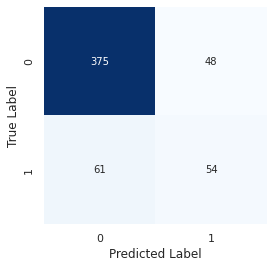

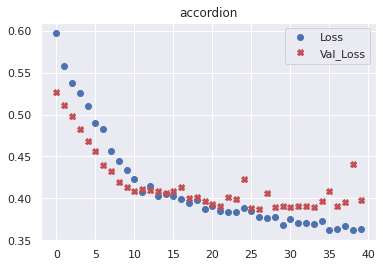

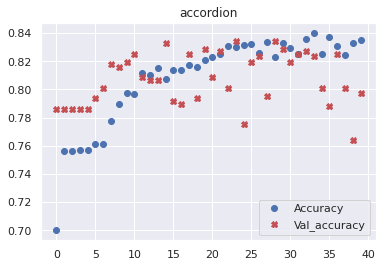


Ejemplo de predicciones:  accordion
True label:  [0 0 0 0 0 0 0 0 0 0]
Predicted:   [[0.110159   0.42941904 0.00874464 0.01569628 0.00696677 0.33700335
  0.3839251  0.0492024  0.01045769 0.05913405]]
Model: "sequential_606"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_441 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_846 (Dropout)       (None, 250)               0         
                                                                 
 dense_1212 (Dense)          (None, 50)                12550     
                                                                 
 dense_1213 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
___________________________________________

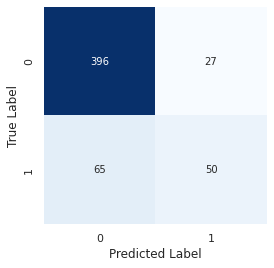

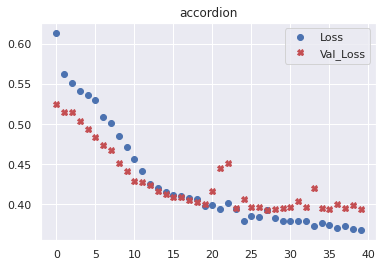

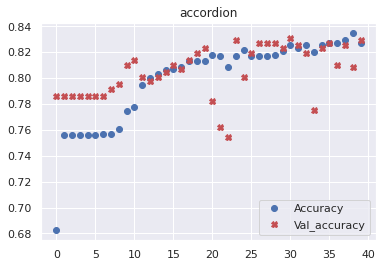


Ejemplo de predicciones:  accordion
True label:  [0 0 0 0 0 0 0 0 0 0]
Predicted:   [[0.10025906 0.3875176  0.01154515 0.01521758 0.00917256 0.23542766
  0.2654016  0.06451511 0.01031905 0.04641729]]
Model: "sequential_607"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_442 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_847 (Dropout)       (None, 250)               0         
                                                                 
 dense_1214 (Dense)          (None, 50)                12550     
                                                                 
 dense_1215 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
___________________________________________

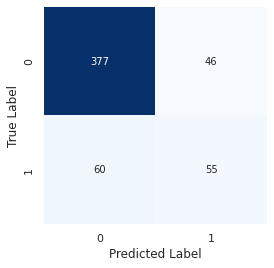

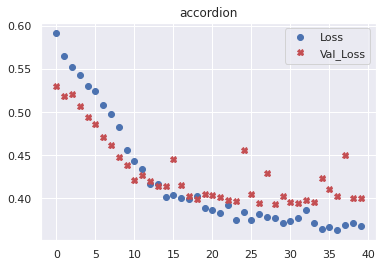

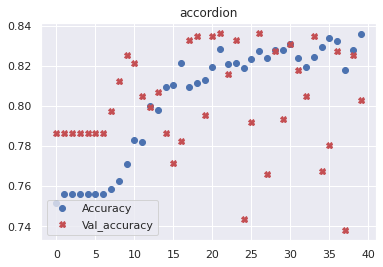


Ejemplo de predicciones:  accordion
True label:  [0 0 0 0 0 0 0 0 0 0]
Predicted:   [[0.11247948 0.4318316  0.01021606 0.01558409 0.00623584 0.27541664
  0.35651207 0.03907532 0.01091931 0.04553375]]
Model: "sequential_608"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_443 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_848 (Dropout)       (None, 250)               0         
                                                                 
 dense_1216 (Dense)          (None, 50)                12550     
                                                                 
 dense_1217 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
___________________________________________

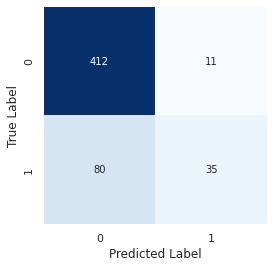

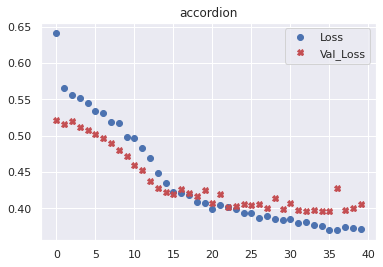

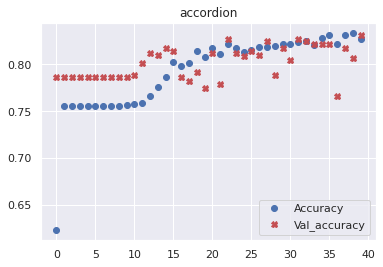


Ejemplo de predicciones:  accordion
True label:  [0 0 0 0 0 0 0 0 0 0]
Predicted:   [[0.07044069 0.21990964 0.00562951 0.00964501 0.0042107  0.14427964
  0.17994803 0.03135246 0.0088654  0.02870762]]
Model: "sequential_609"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_444 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_849 (Dropout)       (None, 250)               0         
                                                                 
 dense_1218 (Dense)          (None, 50)                12550     
                                                                 
 dense_1219 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
___________________________________________

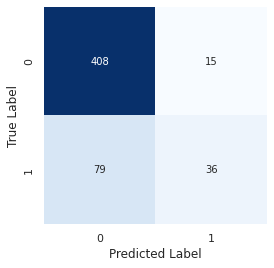

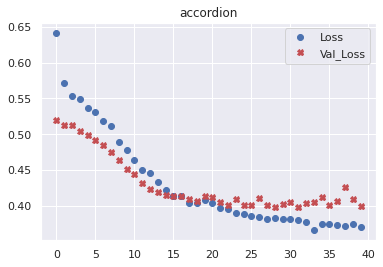

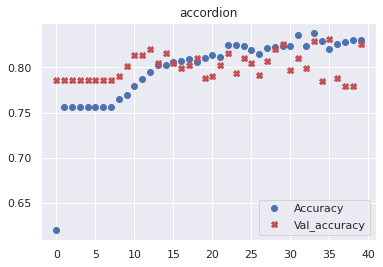


Ejemplo de predicciones:  accordion
True label:  [0 0 0 0 0 0 0 0 0 0]
Predicted:   [[0.06765603 0.2812824  0.00727155 0.01111644 0.00646352 0.18254119
  0.22264142 0.0377792  0.01036799 0.03386199]]
Model: "sequential_610"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_445 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_850 (Dropout)       (None, 250)               0         
                                                                 
 dense_1220 (Dense)          (None, 50)                12550     
                                                                 
 dense_1221 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
___________________________________________

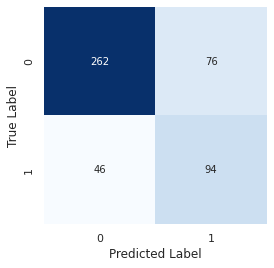

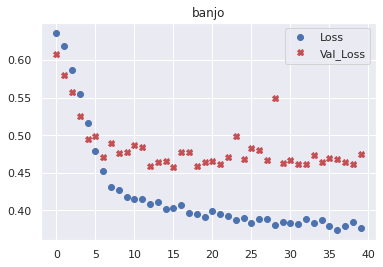

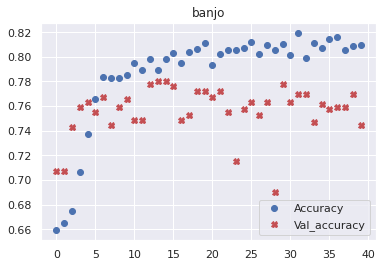


Ejemplo de predicciones:  banjo
True label:  [0 0 1 0 1 0 1 0 0 1]
Predicted:   [[0.09392335 0.01032709 0.6714461  0.39428848 0.02427761 0.32474148
  0.7166845  0.00618773 0.01596797 0.34058344]]
Model: "sequential_611"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_446 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_851 (Dropout)       (None, 250)               0         
                                                                 
 dense_1222 (Dense)          (None, 50)                12550     
                                                                 
 dense_1223 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

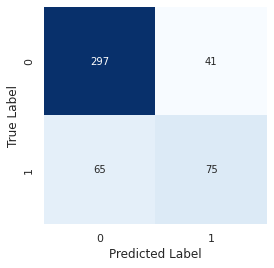

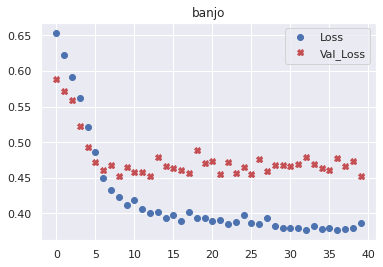

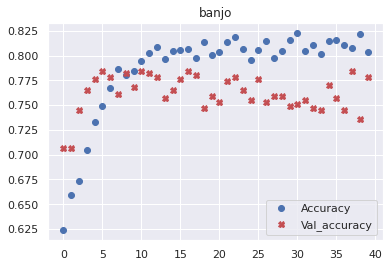


Ejemplo de predicciones:  banjo
True label:  [0 0 1 0 1 0 1 0 0 1]
Predicted:   [[0.08531587 0.0086371  0.54397607 0.28968564 0.01301646 0.18702027
  0.58151084 0.00370316 0.01217207 0.22223602]]
Model: "sequential_612"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_447 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_852 (Dropout)       (None, 250)               0         
                                                                 
 dense_1224 (Dense)          (None, 50)                12550     
                                                                 
 dense_1225 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

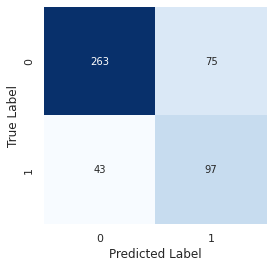

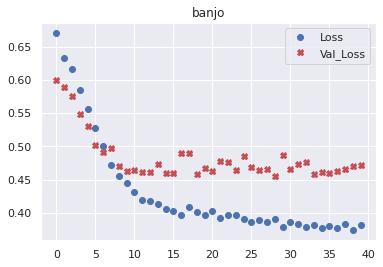

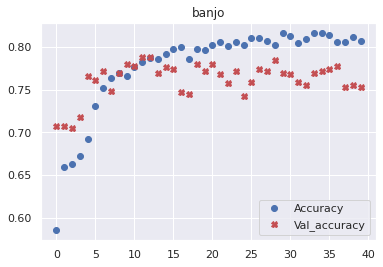


Ejemplo de predicciones:  banjo
True label:  [0 0 1 0 1 0 1 0 0 1]
Predicted:   [[0.1273348  0.00980872 0.71323127 0.37768468 0.01873238 0.28536263
  0.72690845 0.00466819 0.01930859 0.41776443]]
Model: "sequential_613"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_448 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_853 (Dropout)       (None, 250)               0         
                                                                 
 dense_1226 (Dense)          (None, 50)                12550     
                                                                 
 dense_1227 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

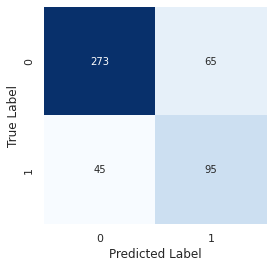

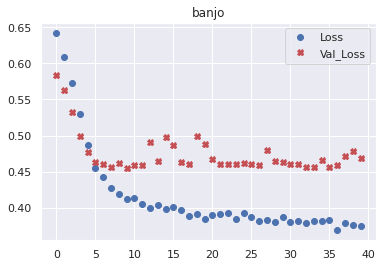

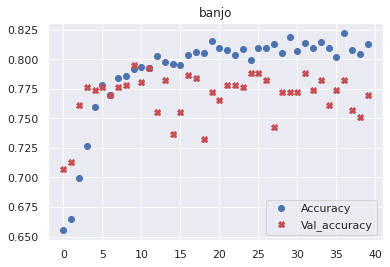


Ejemplo de predicciones:  banjo
True label:  [0 0 1 0 1 0 1 0 0 1]
Predicted:   [[0.09091947 0.0062951  0.6704437  0.36357567 0.01572052 0.34703198
  0.70989025 0.00386115 0.01305676 0.2339552 ]]
Model: "sequential_614"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_449 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_854 (Dropout)       (None, 250)               0         
                                                                 
 dense_1228 (Dense)          (None, 50)                12550     
                                                                 
 dense_1229 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

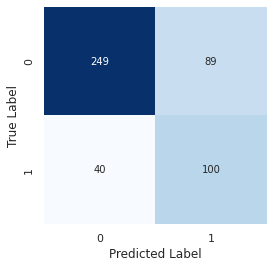

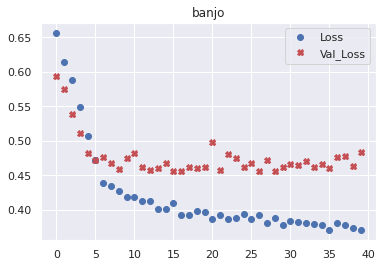

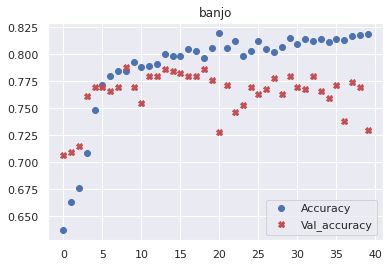


Ejemplo de predicciones:  banjo
True label:  [0 0 1 0 1 0 1 0 0 1]
Predicted:   [[0.11495044 0.01333686 0.72093767 0.48121914 0.02604361 0.40673918
  0.7137802  0.00479894 0.02005395 0.36219004]]
Model: "sequential_615"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_450 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_855 (Dropout)       (None, 250)               0         
                                                                 
 dense_1230 (Dense)          (None, 50)                12550     
                                                                 
 dense_1231 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

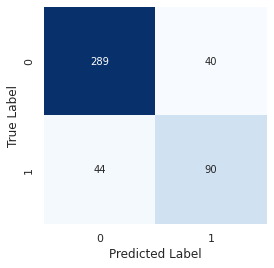

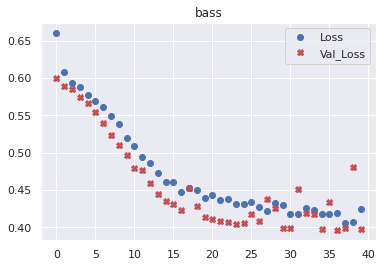

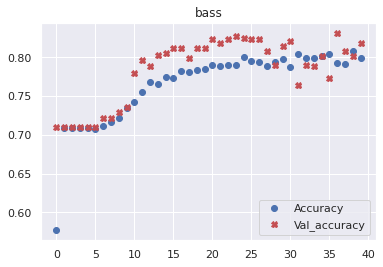


Ejemplo de predicciones:  bass
True label:  [1 1 0 1 1 0 1 0 0 0]
Predicted:   [[0.74062204 0.5881103  0.5481406  0.7888407  0.5349653  0.7365282
  0.8299483  0.14104895 0.10116287 0.02201507]]
Model: "sequential_616"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_451 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_856 (Dropout)       (None, 250)               0         
                                                                 
 dense_1232 (Dense)          (None, 50)                12550     
                                                                 
 dense_1233 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_________________________________________________

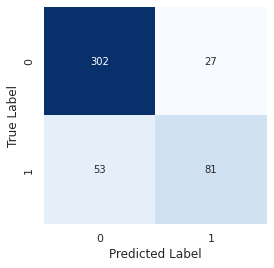

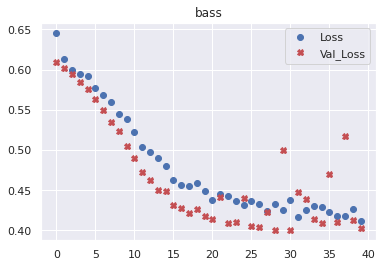

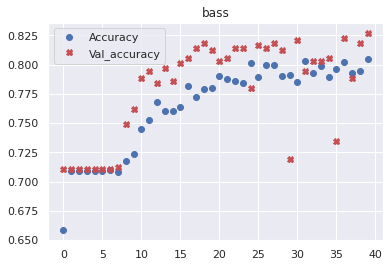


Ejemplo de predicciones:  bass
True label:  [1 1 0 1 1 0 1 0 0 0]
Predicted:   [[0.65351933 0.4995335  0.4838625  0.76941144 0.3207491  0.71856713
  0.82122475 0.04957578 0.05048361 0.02779963]]
Model: "sequential_617"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_452 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_857 (Dropout)       (None, 250)               0         
                                                                 
 dense_1234 (Dense)          (None, 50)                12550     
                                                                 
 dense_1235 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
________________________________________________

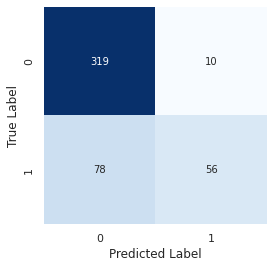

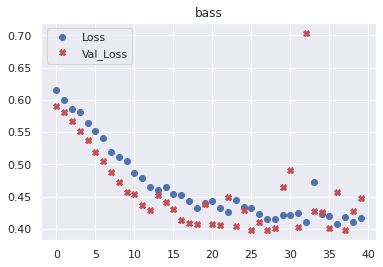

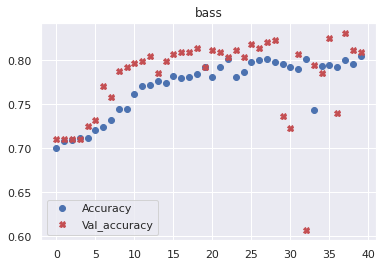


Ejemplo de predicciones:  bass
True label:  [1 1 0 1 1 0 1 0 0 0]
Predicted:   [[0.55279875 0.41881716 0.3342935  0.6658919  0.19866493 0.5887962
  0.7585393  0.03523389 0.0210383  0.0141135 ]]
Model: "sequential_618"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_453 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_858 (Dropout)       (None, 250)               0         
                                                                 
 dense_1236 (Dense)          (None, 50)                12550     
                                                                 
 dense_1237 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_________________________________________________

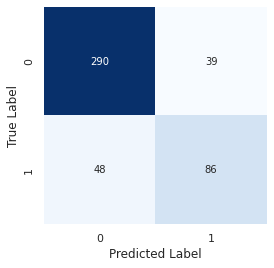

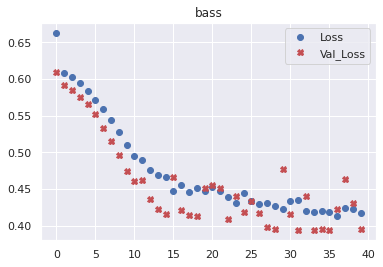

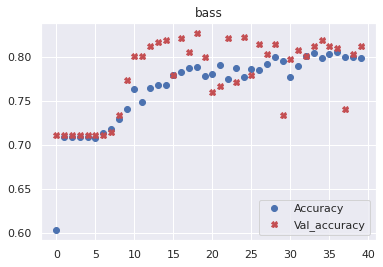


Ejemplo de predicciones:  bass
True label:  [1 1 0 1 1 0 1 0 0 0]
Predicted:   [[0.7037139  0.5860017  0.45832264 0.7566778  0.38420168 0.7764863
  0.8488867  0.10749882 0.0467566  0.0273427 ]]
Model: "sequential_619"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_454 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_859 (Dropout)       (None, 250)               0         
                                                                 
 dense_1238 (Dense)          (None, 50)                12550     
                                                                 
 dense_1239 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_________________________________________________

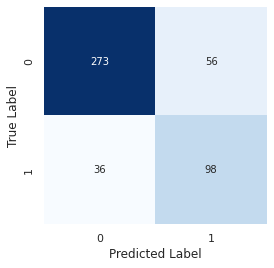

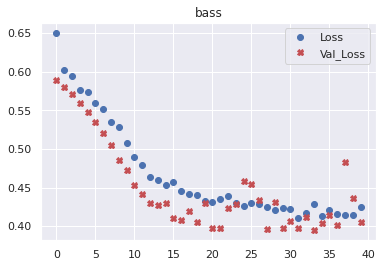

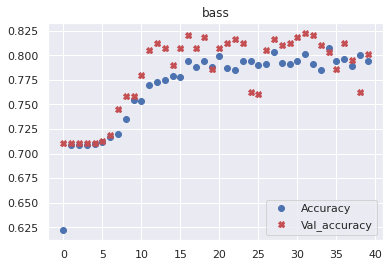


Ejemplo de predicciones:  bass
True label:  [1 1 0 1 1 0 1 0 0 0]
Predicted:   [[0.7754853  0.67646563 0.6411743  0.8050309  0.57316726 0.8176201
  0.8633539  0.23454535 0.07590368 0.04055114]]
Model: "sequential_620"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_455 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_860 (Dropout)       (None, 250)               0         
                                                                 
 dense_1240 (Dense)          (None, 50)                12550     
                                                                 
 dense_1241 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_________________________________________________

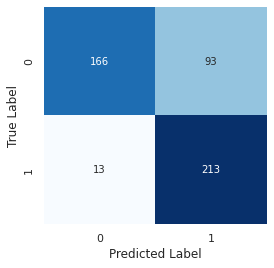

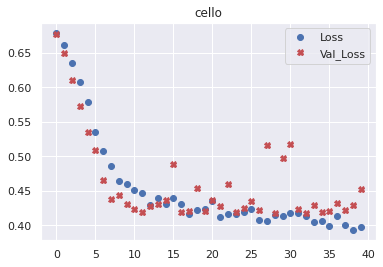

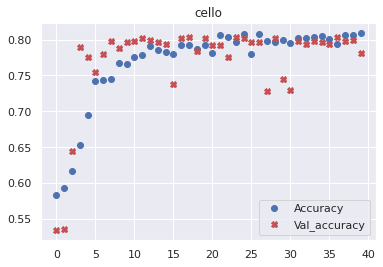


Ejemplo de predicciones:  cello
True label:  [0 0 0 1 0 0 0 0 0 0]
Predicted:   [[0.0161268  0.02821193 0.894628   0.6602377  0.00375682 0.00216309
  0.00256029 0.70015925 0.00300219 0.35204488]]
Model: "sequential_621"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_456 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_861 (Dropout)       (None, 250)               0         
                                                                 
 dense_1242 (Dense)          (None, 50)                12550     
                                                                 
 dense_1243 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

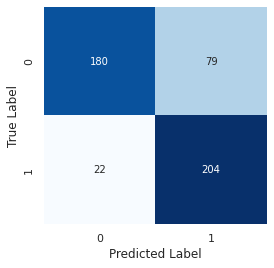

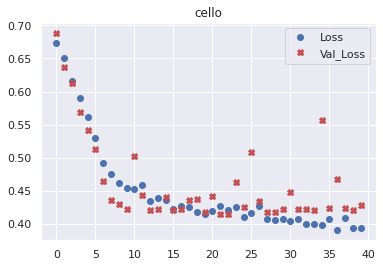

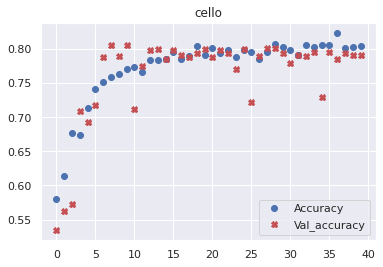


Ejemplo de predicciones:  cello
True label:  [0 0 0 1 0 0 0 0 0 0]
Predicted:   [[0.01185889 0.01807228 0.89713854 0.5781347  0.00305238 0.00162238
  0.00239476 0.6270664  0.00264839 0.22495954]]
Model: "sequential_622"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_457 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_862 (Dropout)       (None, 250)               0         
                                                                 
 dense_1244 (Dense)          (None, 50)                12550     
                                                                 
 dense_1245 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

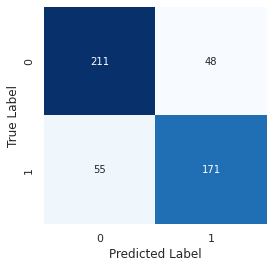

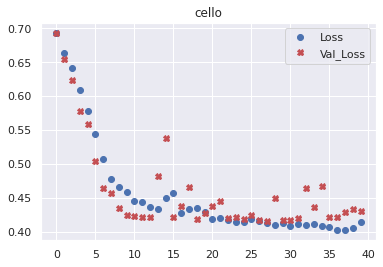

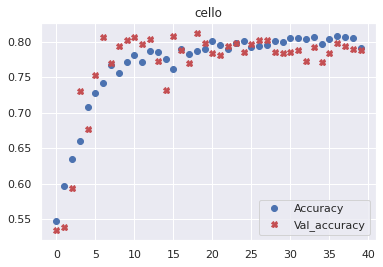


Ejemplo de predicciones:  cello
True label:  [0 0 0 1 0 0 0 0 0 0]
Predicted:   [[0.00844654 0.01064705 0.8650978  0.36963853 0.00354139 0.00220331
  0.00300254 0.41247854 0.00295861 0.09234758]]
Model: "sequential_623"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_458 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_863 (Dropout)       (None, 250)               0         
                                                                 
 dense_1246 (Dense)          (None, 50)                12550     
                                                                 
 dense_1247 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

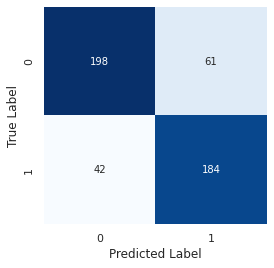

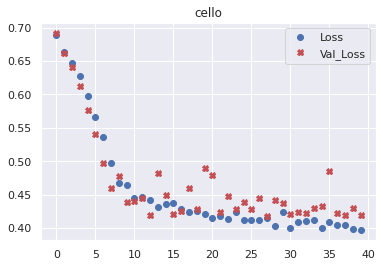

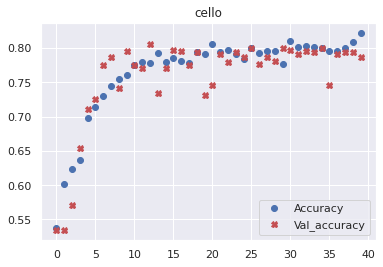


Ejemplo de predicciones:  cello
True label:  [0 0 0 1 0 0 0 0 0 0]
Predicted:   [[0.00965047 0.01364271 0.87211245 0.44048497 0.00405838 0.00249192
  0.003256   0.48418066 0.00296045 0.1552888 ]]
Model: "sequential_624"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_459 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_864 (Dropout)       (None, 250)               0         
                                                                 
 dense_1248 (Dense)          (None, 50)                12550     
                                                                 
 dense_1249 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

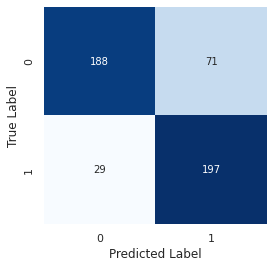

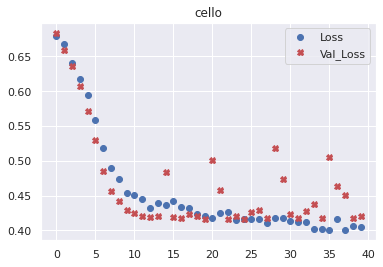

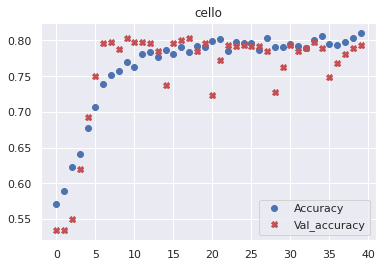


Ejemplo de predicciones:  cello
True label:  [0 0 0 1 0 0 0 0 0 0]
Predicted:   [[0.01443102 0.01476258 0.9007883  0.5531836  0.00437916 0.00284003
  0.00311131 0.59530836 0.00282201 0.20164345]]
Model: "sequential_625"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_460 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_865 (Dropout)       (None, 250)               0         
                                                                 
 dense_1250 (Dense)          (None, 50)                12550     
                                                                 
 dense_1251 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

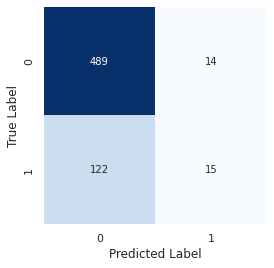

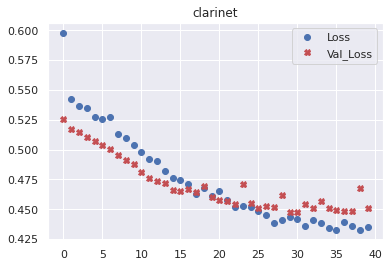

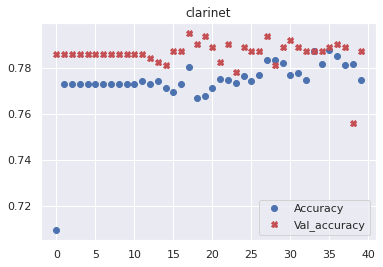


Ejemplo de predicciones:  clarinet
True label:  [1 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.5620578  0.11347011 0.19103402 0.05127041 0.4007807  0.0065147
  0.30599993 0.02042191 0.14269182 0.09694754]]
Model: "sequential_626"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_461 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_866 (Dropout)       (None, 250)               0         
                                                                 
 dense_1252 (Dense)          (None, 50)                12550     
                                                                 
 dense_1253 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_____________________________________________

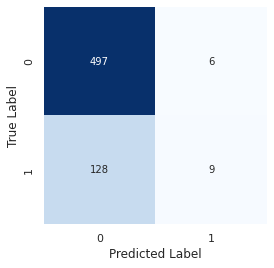

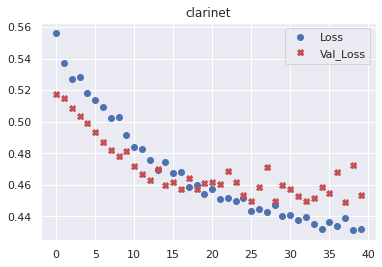

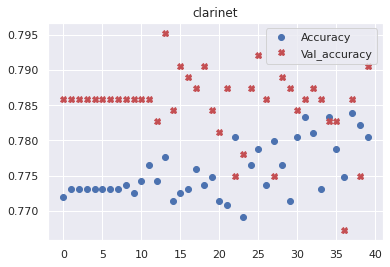


Ejemplo de predicciones:  clarinet
True label:  [1 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.5741953  0.1194599  0.21893716 0.07013791 0.3696804  0.00393806
  0.37180737 0.01194644 0.19747692 0.12054358]]
Model: "sequential_627"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_462 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_867 (Dropout)       (None, 250)               0         
                                                                 
 dense_1254 (Dense)          (None, 50)                12550     
                                                                 
 dense_1255 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
____________________________________________

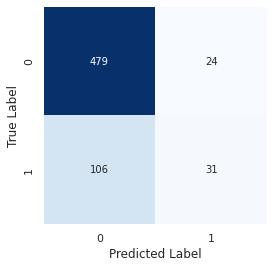

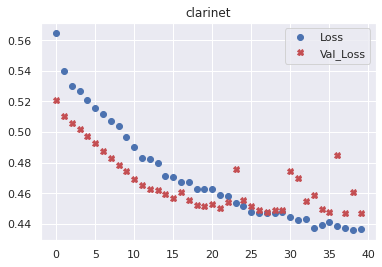

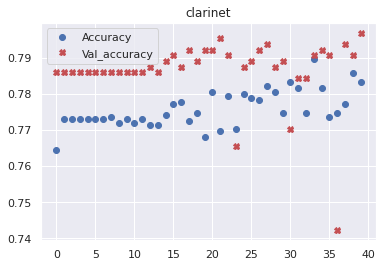


Ejemplo de predicciones:  clarinet
True label:  [1 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.6000028  0.14324538 0.27814367 0.11625557 0.46344215 0.00656547
  0.42282432 0.01672691 0.28417894 0.17670354]]
Model: "sequential_628"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_463 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_868 (Dropout)       (None, 250)               0         
                                                                 
 dense_1256 (Dense)          (None, 50)                12550     
                                                                 
 dense_1257 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
____________________________________________

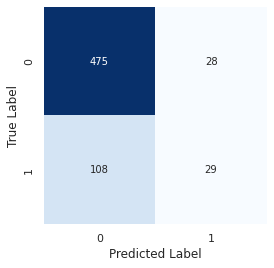

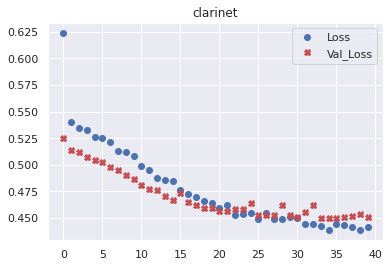

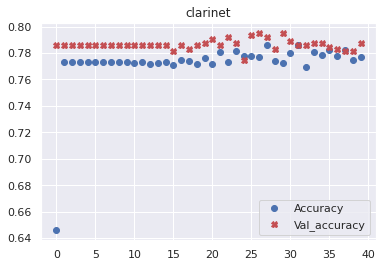


Ejemplo de predicciones:  clarinet
True label:  [1 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.5919932  0.23243646 0.29042098 0.14693812 0.4592034  0.00494384
  0.40828487 0.01978387 0.35914043 0.2271664 ]]
Model: "sequential_629"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_464 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_869 (Dropout)       (None, 250)               0         
                                                                 
 dense_1258 (Dense)          (None, 50)                12550     
                                                                 
 dense_1259 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
____________________________________________

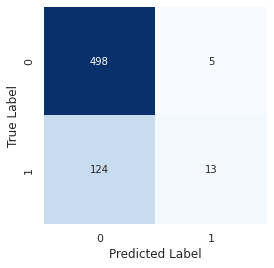

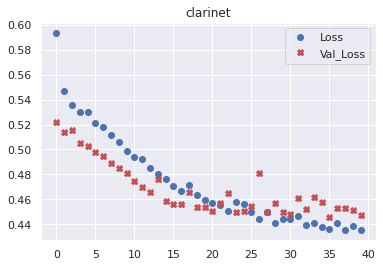

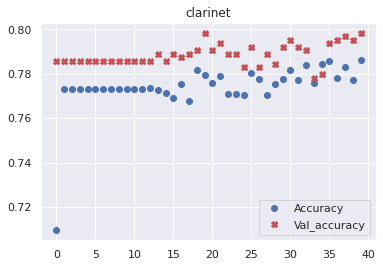


Ejemplo de predicciones:  clarinet
True label:  [1 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.52690184 0.21589214 0.311091   0.10958815 0.46089056 0.00466578
  0.38906854 0.01223122 0.32144195 0.21598125]]
Model: "sequential_630"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_465 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_870 (Dropout)       (None, 250)               0         
                                                                 
 dense_1260 (Dense)          (None, 50)                12550     
                                                                 
 dense_1261 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
____________________________________________

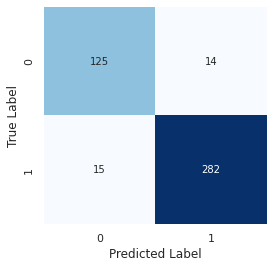

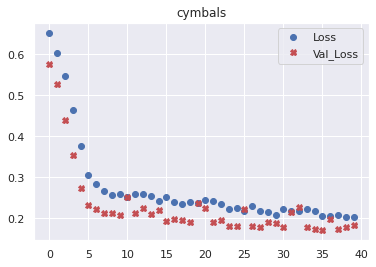

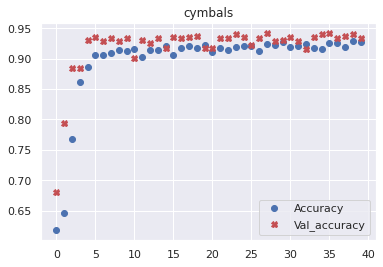


Ejemplo de predicciones:  cymbals
True label:  [1 1 1 1 1 0 1 0 0 0]
Predicted:   [[0.987978   0.9930381  0.86956793 0.993129   0.9673699  0.89183867
  0.9905426  0.01125845 0.00584877 0.01051631]]
Model: "sequential_631"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_466 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_871 (Dropout)       (None, 250)               0         
                                                                 
 dense_1262 (Dense)          (None, 50)                12550     
                                                                 
 dense_1263 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_____________________________________________

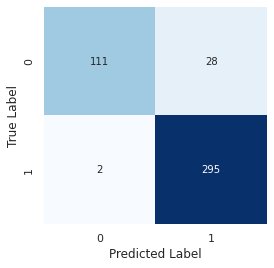

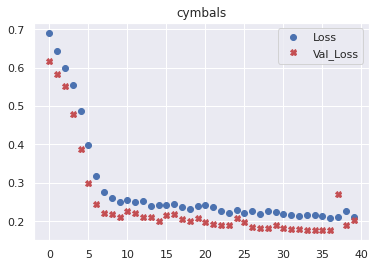

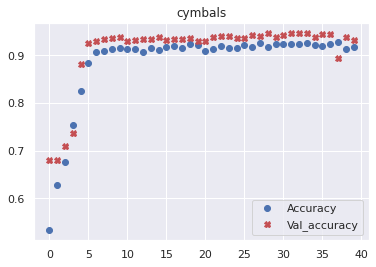


Ejemplo de predicciones:  cymbals
True label:  [1 1 1 1 1 0 1 0 0 0]
Predicted:   [[0.98762894 0.99178326 0.96754396 0.99140584 0.98129547 0.9720743
  0.98816633 0.04445991 0.01160132 0.03732608]]
Model: "sequential_632"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_467 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_872 (Dropout)       (None, 250)               0         
                                                                 
 dense_1264 (Dense)          (None, 50)                12550     
                                                                 
 dense_1265 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
______________________________________________

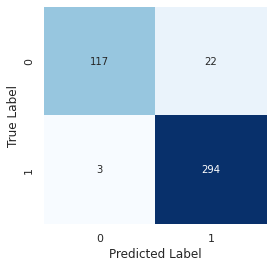

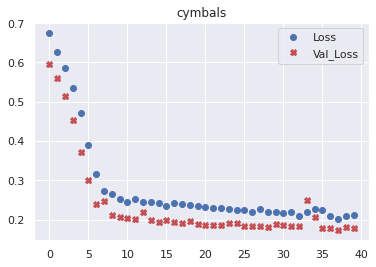

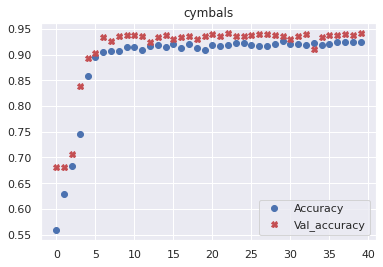


Ejemplo de predicciones:  cymbals
True label:  [1 1 1 1 1 0 1 0 0 0]
Predicted:   [[0.9895315  0.99372935 0.96499014 0.99329233 0.9791915  0.9668095
  0.9905992  0.0197585  0.00600541 0.01239821]]
Model: "sequential_633"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_468 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_873 (Dropout)       (None, 250)               0         
                                                                 
 dense_1266 (Dense)          (None, 50)                12550     
                                                                 
 dense_1267 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
______________________________________________

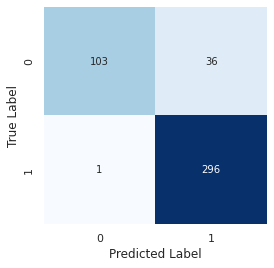

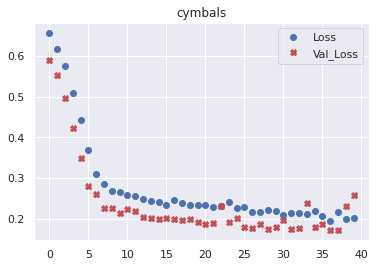

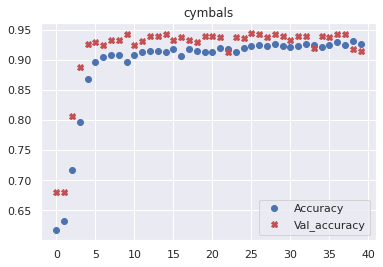


Ejemplo de predicciones:  cymbals
True label:  [1 1 1 1 1 0 1 0 0 0]
Predicted:   [[0.993299   0.99472624 0.98303497 0.99486995 0.9885988  0.980393
  0.993171   0.13902122 0.00746113 0.03101749]]
Model: "sequential_634"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_469 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_874 (Dropout)       (None, 250)               0         
                                                                 
 dense_1268 (Dense)          (None, 50)                12550     
                                                                 
 dense_1269 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

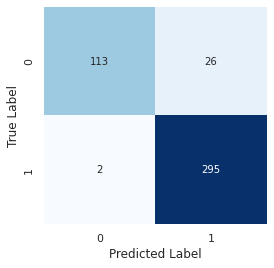

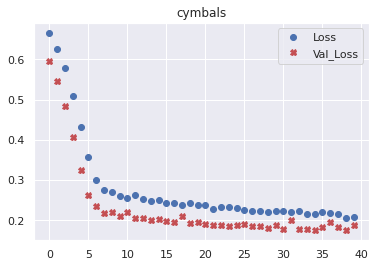

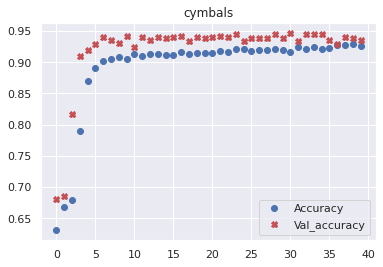


Ejemplo de predicciones:  cymbals
True label:  [1 1 1 1 1 0 1 0 0 0]
Predicted:   [[0.9870674  0.991148   0.9659001  0.9908923  0.9826539  0.9589407
  0.98825455 0.02927885 0.00695121 0.02418996]]
Model: "sequential_635"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_470 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_875 (Dropout)       (None, 250)               0         
                                                                 
 dense_1270 (Dense)          (None, 50)                12550     
                                                                 
 dense_1271 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
______________________________________________

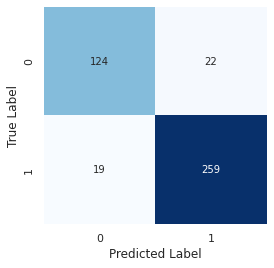

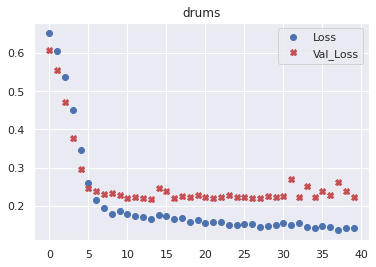

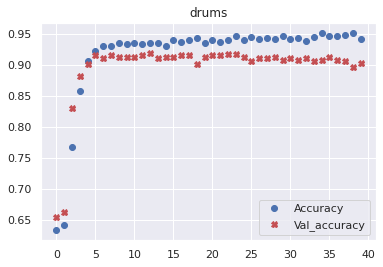


Ejemplo de predicciones:  drums
True label:  [1 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.64198846 0.05146929 0.00572441 0.99479914 0.9977324  0.9983199
  0.99739575 0.998852   0.9981499  0.9971706 ]]
Model: "sequential_636"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_471 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_876 (Dropout)       (None, 250)               0         
                                                                 
 dense_1272 (Dense)          (None, 50)                12550     
                                                                 
 dense_1273 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
________________________________________________

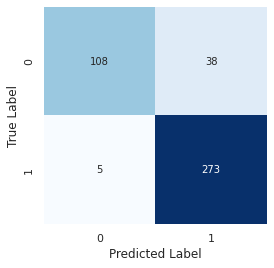

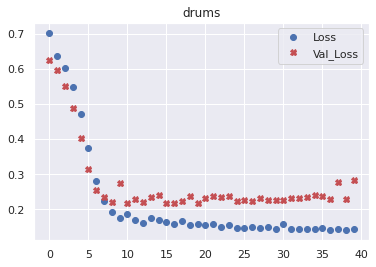

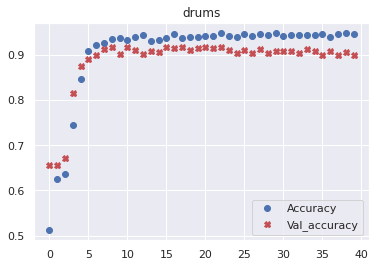


Ejemplo de predicciones:  drums
True label:  [1 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.9385731  0.31968457 0.00562286 0.9964168  0.9977756  0.9979571
  0.99781716 0.9983747  0.9982529  0.9975446 ]]
Model: "sequential_637"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_472 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_877 (Dropout)       (None, 250)               0         
                                                                 
 dense_1274 (Dense)          (None, 50)                12550     
                                                                 
 dense_1275 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
________________________________________________

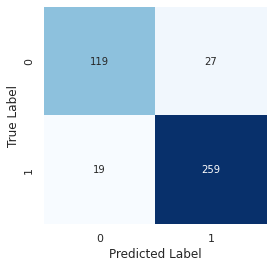

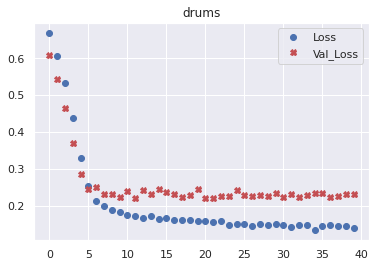

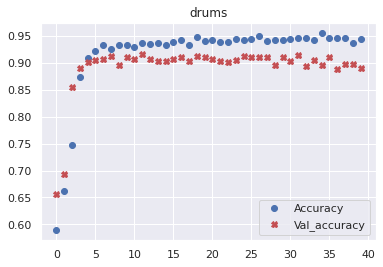


Ejemplo de predicciones:  drums
True label:  [1 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.75966126 0.06544085 0.00508441 0.9959496  0.9975364  0.99818856
  0.9979638  0.99856335 0.9982621  0.9979023 ]]
Model: "sequential_638"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_473 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_878 (Dropout)       (None, 250)               0         
                                                                 
 dense_1276 (Dense)          (None, 50)                12550     
                                                                 
 dense_1277 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

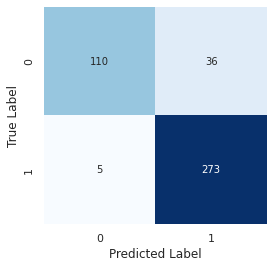

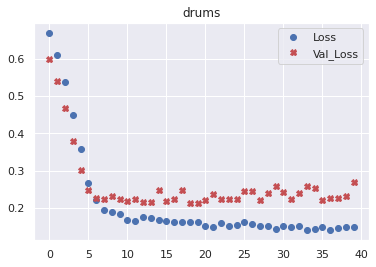

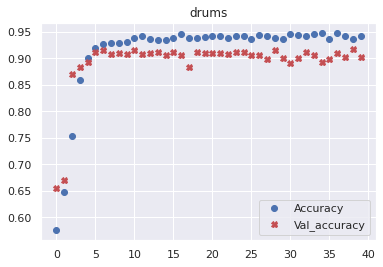


Ejemplo de predicciones:  drums
True label:  [1 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.94751465 0.2223575  0.00647189 0.9972588  0.99819416 0.9985629
  0.99846494 0.9988418  0.99854726 0.99782264]]
Model: "sequential_639"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_474 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_879 (Dropout)       (None, 250)               0         
                                                                 
 dense_1278 (Dense)          (None, 50)                12550     
                                                                 
 dense_1279 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
________________________________________________

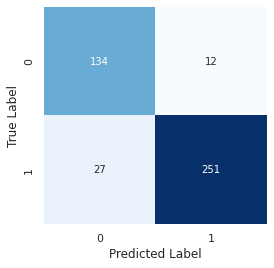

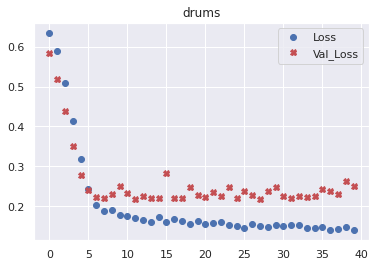

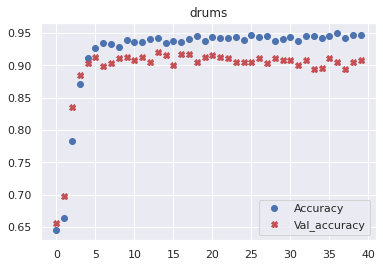


Ejemplo de predicciones:  drums
True label:  [1 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.53177214 0.04185865 0.00381742 0.9933035  0.99662626 0.9977404
  0.9967347  0.99821496 0.9975642  0.99717736]]
Model: "sequential_640"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_475 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_880 (Dropout)       (None, 250)               0         
                                                                 
 dense_1280 (Dense)          (None, 50)                12550     
                                                                 
 dense_1281 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
________________________________________________

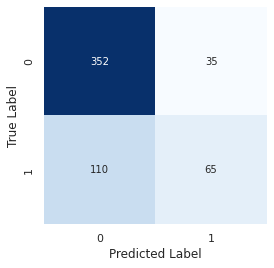

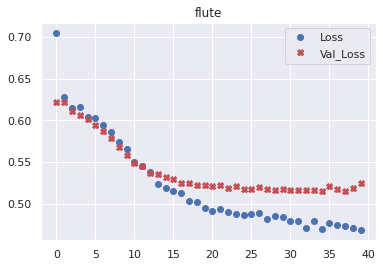

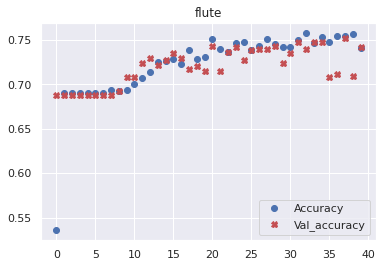


Ejemplo de predicciones:  flute
True label:  [0 0 1 0 0 0 1 0 0 0]
Predicted:   [[0.47253576 0.3295651  0.45165285 0.5071565  0.5112093  0.21626411
  0.5621744  0.51620907 0.34989896 0.02762421]]
Model: "sequential_641"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_476 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_881 (Dropout)       (None, 250)               0         
                                                                 
 dense_1282 (Dense)          (None, 50)                12550     
                                                                 
 dense_1283 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

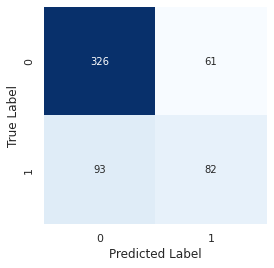

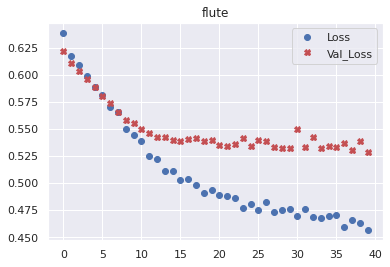

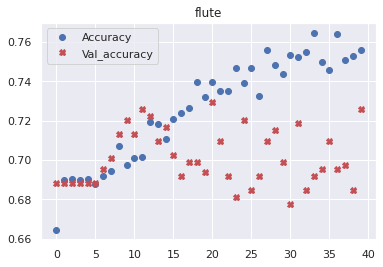


Ejemplo de predicciones:  flute
True label:  [0 0 1 0 0 0 1 0 0 0]
Predicted:   [[0.5553296  0.3890644  0.5338232  0.6058086  0.57969373 0.334326
  0.6058317  0.60873884 0.2668013  0.01754018]]
Model: "sequential_642"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_477 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_882 (Dropout)       (None, 250)               0         
                                                                 
 dense_1284 (Dense)          (None, 50)                12550     
                                                                 
 dense_1285 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_________________________________________________

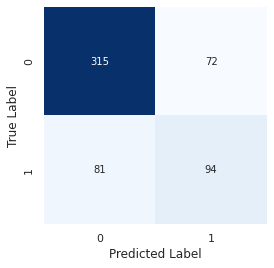

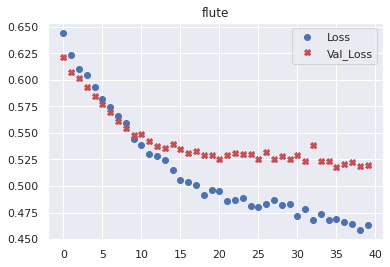

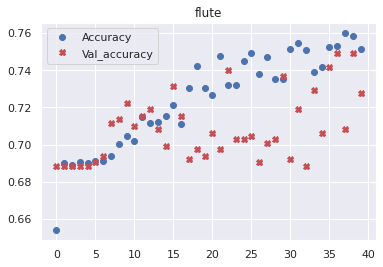


Ejemplo de predicciones:  flute
True label:  [0 0 1 0 0 0 1 0 0 0]
Predicted:   [[0.5522571  0.33816132 0.5567968  0.5662698  0.6125983  0.28788564
  0.6023493  0.6014112  0.3792884  0.02186474]]
Model: "sequential_643"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_478 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_883 (Dropout)       (None, 250)               0         
                                                                 
 dense_1286 (Dense)          (None, 50)                12550     
                                                                 
 dense_1287 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

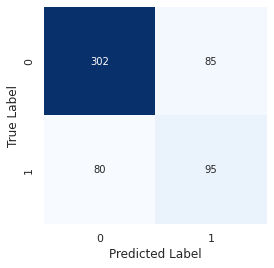

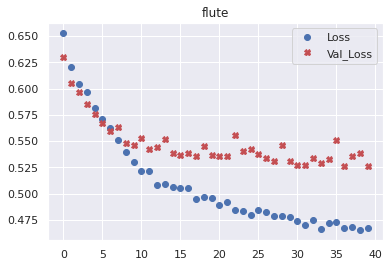

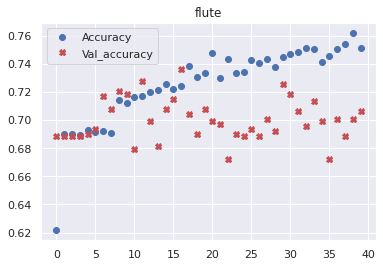


Ejemplo de predicciones:  flute
True label:  [0 0 1 0 0 0 1 0 0 0]
Predicted:   [[0.5599208  0.4300527  0.58905065 0.63422334 0.5697552  0.40099084
  0.63555473 0.6246358  0.40383682 0.03112546]]
Model: "sequential_644"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_479 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_884 (Dropout)       (None, 250)               0         
                                                                 
 dense_1288 (Dense)          (None, 50)                12550     
                                                                 
 dense_1289 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

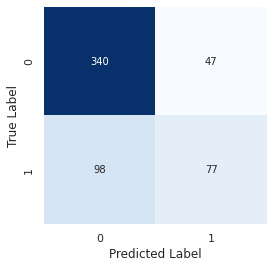

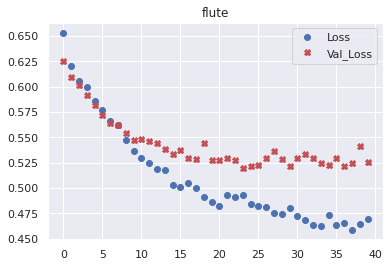

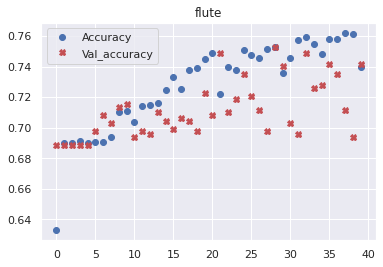


Ejemplo de predicciones:  flute
True label:  [0 0 1 0 0 0 1 0 0 0]
Predicted:   [[0.51949584 0.30153212 0.47282064 0.5629941  0.5335724  0.29718184
  0.5783356  0.5895243  0.3694391  0.0185076 ]]
Model: "sequential_645"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_480 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_885 (Dropout)       (None, 250)               0         
                                                                 
 dense_1290 (Dense)          (None, 50)                12550     
                                                                 
 dense_1291 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

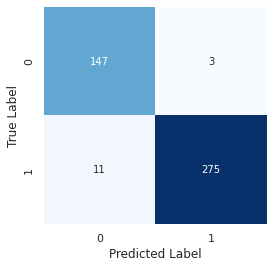

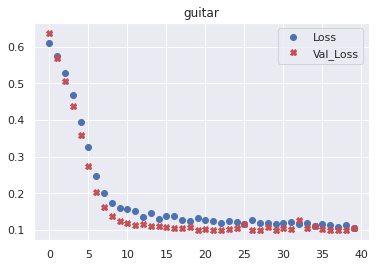

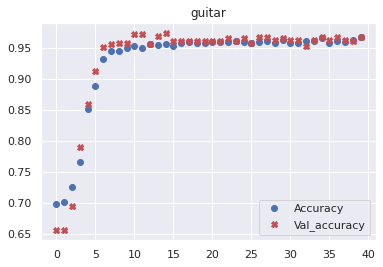


Ejemplo de predicciones:  guitar
True label:  [0 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.0117416  0.16667183 0.00759613 0.94917613 0.9856107  0.8266322
  0.95187664 0.99689984 0.9879573  0.9938758 ]]
Model: "sequential_646"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_481 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_886 (Dropout)       (None, 250)               0         
                                                                 
 dense_1292 (Dense)          (None, 50)                12550     
                                                                 
 dense_1293 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

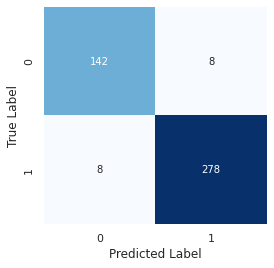

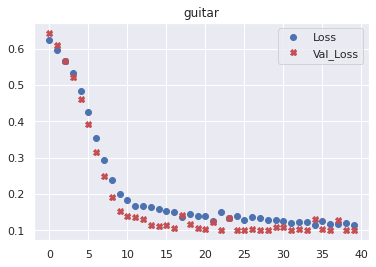

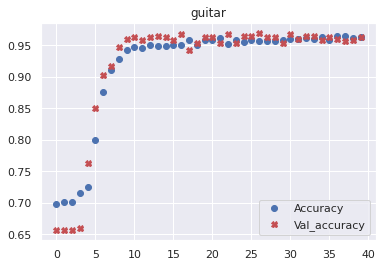


Ejemplo de predicciones:  guitar
True label:  [0 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.01522855 0.08717737 0.01774024 0.96818405 0.988364   0.8393591
  0.9707127  0.9980751  0.9892452  0.9948885 ]]
Model: "sequential_647"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_482 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_887 (Dropout)       (None, 250)               0         
                                                                 
 dense_1294 (Dense)          (None, 50)                12550     
                                                                 
 dense_1295 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

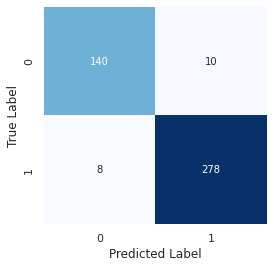

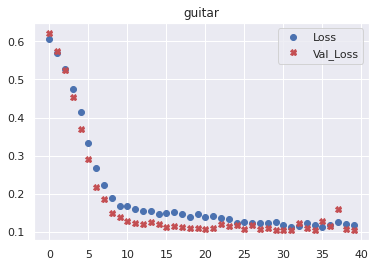

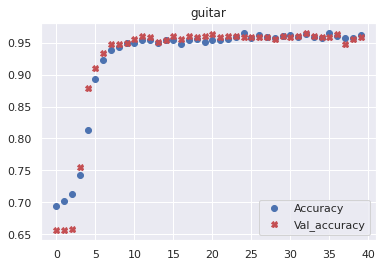


Ejemplo de predicciones:  guitar
True label:  [0 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.01650948 0.34158546 0.01942647 0.9821454  0.9897407  0.8700662
  0.97404397 0.99765706 0.99363387 0.9957327 ]]
Model: "sequential_648"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_483 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_888 (Dropout)       (None, 250)               0         
                                                                 
 dense_1296 (Dense)          (None, 50)                12550     
                                                                 
 dense_1297 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

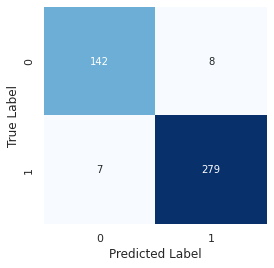

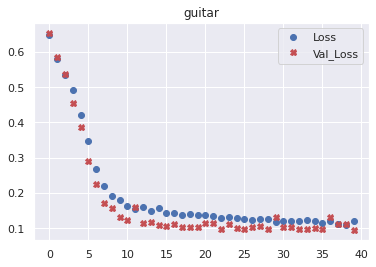

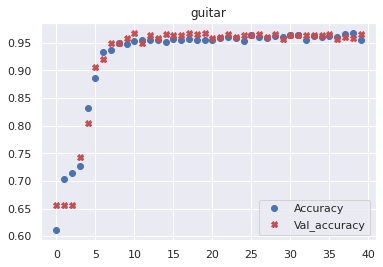


Ejemplo de predicciones:  guitar
True label:  [0 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.01720447 0.13958322 0.01507432 0.9848     0.9930322  0.91400945
  0.9859065  0.9975574  0.9936633  0.9959371 ]]
Model: "sequential_649"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_484 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_889 (Dropout)       (None, 250)               0         
                                                                 
 dense_1298 (Dense)          (None, 50)                12550     
                                                                 
 dense_1299 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
______________________________________________

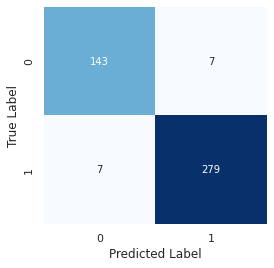

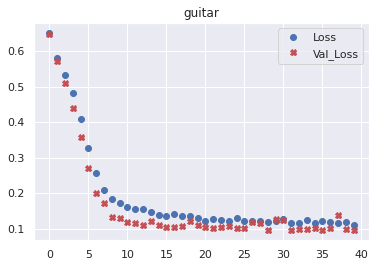

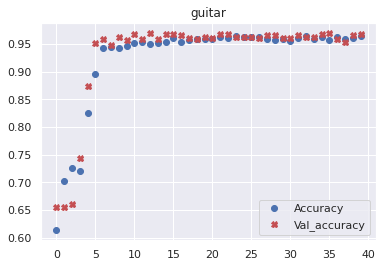


Ejemplo de predicciones:  guitar
True label:  [0 0 0 1 1 1 1 1 1 1]
Predicted:   [[0.01681207 0.16452308 0.02354049 0.9732239  0.9867235  0.8823321
  0.9776788  0.9982162  0.992863   0.9951238 ]]
Model: "sequential_650"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_485 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_890 (Dropout)       (None, 250)               0         
                                                                 
 dense_1300 (Dense)          (None, 50)                12550     
                                                                 
 dense_1301 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

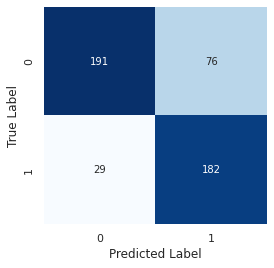

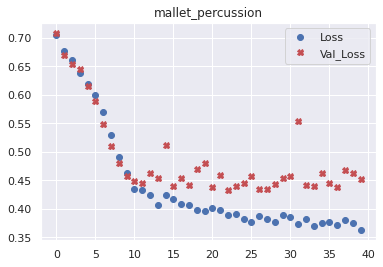

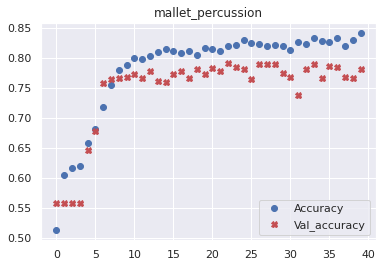


Ejemplo de predicciones:  mallet_percussion
True label:  [0 1 0 0 1 1 0 0 0 0]
Predicted:   [[0.87803936 0.90263456 0.17123802 0.13988867 0.89997804 0.7919359
  0.02560607 0.02388536 0.02180811 0.02891739]]
Model: "sequential_651"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_486 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_891 (Dropout)       (None, 250)               0         
                                                                 
 dense_1302 (Dense)          (None, 50)                12550     
                                                                 
 dense_1303 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
____________________________________

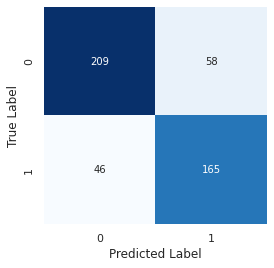

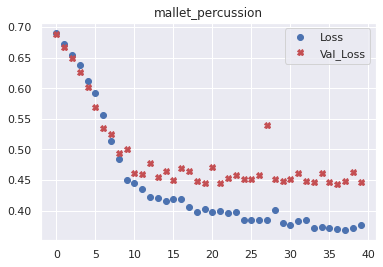

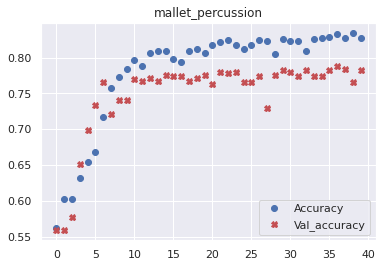


Ejemplo de predicciones:  mallet_percussion
True label:  [0 1 0 0 1 1 0 0 0 0]
Predicted:   [[0.8160645  0.88338965 0.16253221 0.10653216 0.8616051  0.77718925
  0.01333195 0.010167   0.01081199 0.00922074]]
Model: "sequential_652"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_487 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_892 (Dropout)       (None, 250)               0         
                                                                 
 dense_1304 (Dense)          (None, 50)                12550     
                                                                 
 dense_1305 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
___________________________________

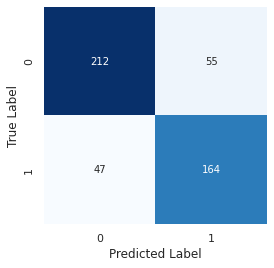

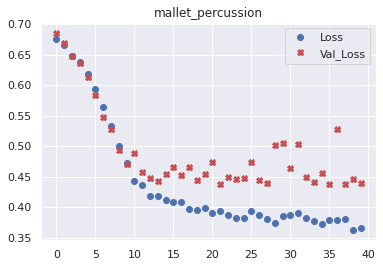

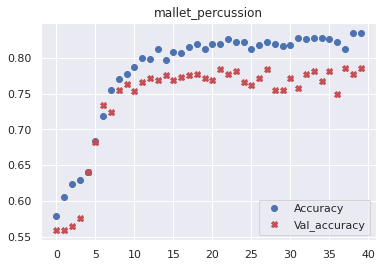


Ejemplo de predicciones:  mallet_percussion
True label:  [0 1 0 0 1 1 0 0 0 0]
Predicted:   [[0.7223059  0.8667994  0.09742399 0.075216   0.84533453 0.7525636
  0.00830723 0.01146524 0.00973052 0.00856493]]
Model: "sequential_653"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_488 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_893 (Dropout)       (None, 250)               0         
                                                                 
 dense_1306 (Dense)          (None, 50)                12550     
                                                                 
 dense_1307 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
____________________________________

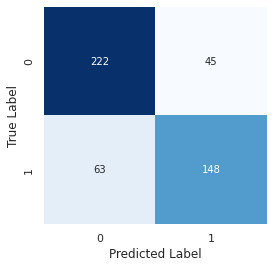

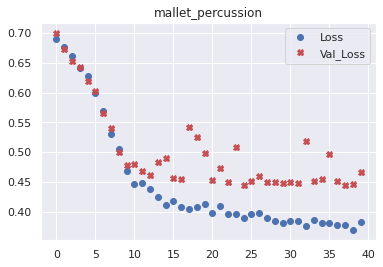

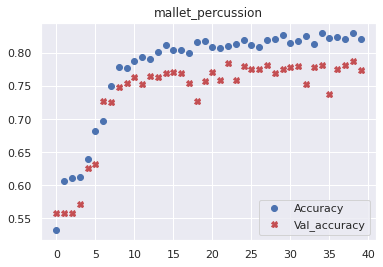


Ejemplo de predicciones:  mallet_percussion
True label:  [0 1 0 0 1 1 0 0 0 0]
Predicted:   [[0.8013254  0.8101587  0.07244013 0.04481136 0.849549   0.67189556
  0.00989641 0.01033837 0.00795437 0.00803616]]
Model: "sequential_654"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_489 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_894 (Dropout)       (None, 250)               0         
                                                                 
 dense_1308 (Dense)          (None, 50)                12550     
                                                                 
 dense_1309 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
___________________________________

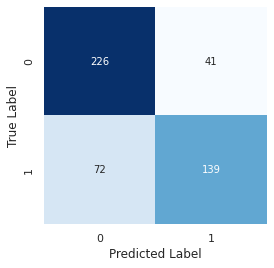

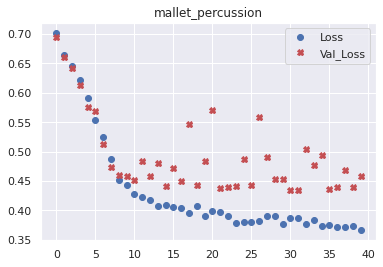

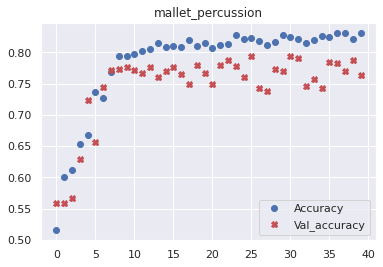


Ejemplo de predicciones:  mallet_percussion
True label:  [0 1 0 0 1 1 0 0 0 0]
Predicted:   [[0.7374774  0.86160785 0.08518997 0.06062571 0.8238662  0.6740772
  0.00792146 0.01007582 0.00938891 0.00735619]]
Model: "sequential_655"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_490 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_895 (Dropout)       (None, 250)               0         
                                                                 
 dense_1310 (Dense)          (None, 50)                12550     
                                                                 
 dense_1311 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
____________________________________

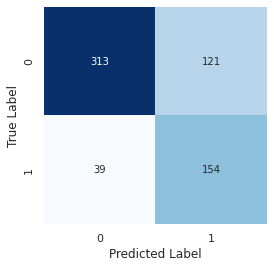

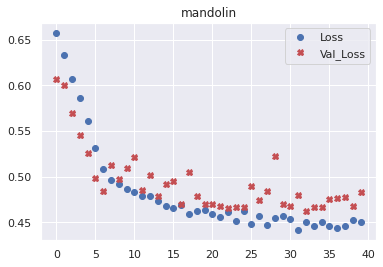

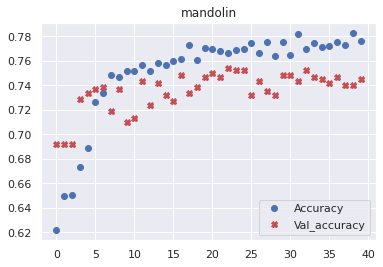


Ejemplo de predicciones:  mandolin
True label:  [0 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.03124029 0.7350171  0.07323871 0.30182055 0.4267277  0.63971
  0.6562875  0.17472963 0.0281228  0.01238202]]
Model: "sequential_656"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_491 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_896 (Dropout)       (None, 250)               0         
                                                                 
 dense_1312 (Dense)          (None, 50)                12550     
                                                                 
 dense_1313 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

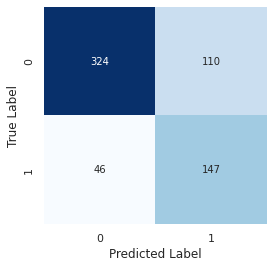

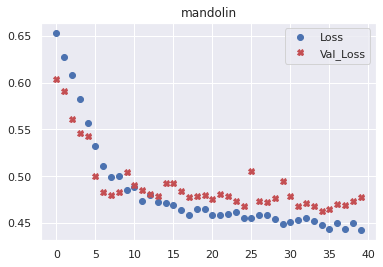

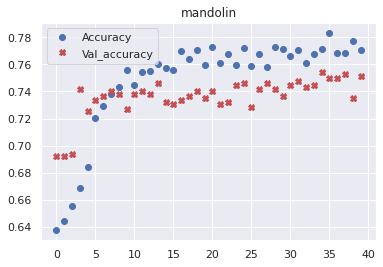


Ejemplo de predicciones:  mandolin
True label:  [0 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.02614442 0.7636396  0.10350709 0.22375116 0.3608037  0.5960737
  0.61881274 0.11449969 0.03230366 0.01352236]]
Model: "sequential_657"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_492 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_897 (Dropout)       (None, 250)               0         
                                                                 
 dense_1314 (Dense)          (None, 50)                12550     
                                                                 
 dense_1315 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_____________________________________________

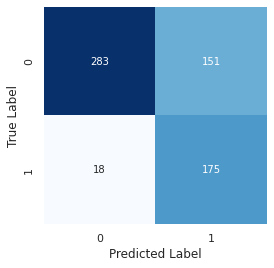

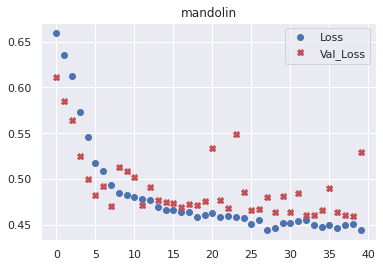

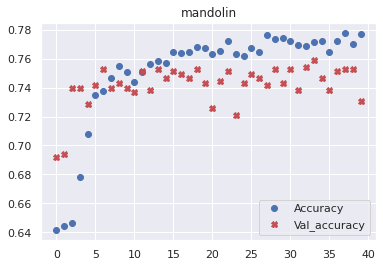


Ejemplo de predicciones:  mandolin
True label:  [0 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.07846018 0.7974464  0.27056286 0.41058043 0.52549165 0.7033282
  0.73222023 0.20600715 0.04251459 0.02625717]]
Model: "sequential_658"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_493 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_898 (Dropout)       (None, 250)               0         
                                                                 
 dense_1316 (Dense)          (None, 50)                12550     
                                                                 
 dense_1317 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_____________________________________________

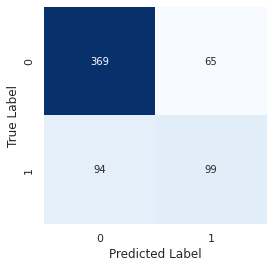

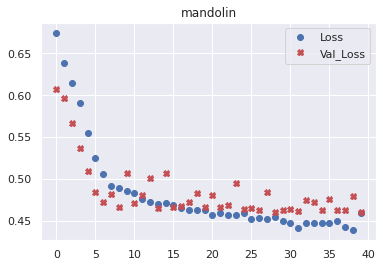

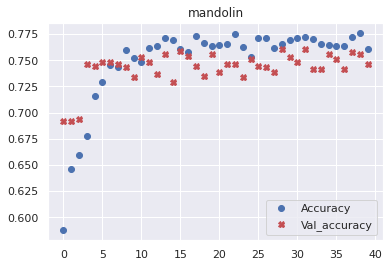


Ejemplo de predicciones:  mandolin
True label:  [0 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.0242585  0.6362221  0.03527392 0.12028902 0.22102492 0.38905132
  0.46861616 0.05263313 0.0175832  0.01573648]]
Model: "sequential_659"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_494 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_899 (Dropout)       (None, 250)               0         
                                                                 
 dense_1318 (Dense)          (None, 50)                12550     
                                                                 
 dense_1319 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
____________________________________________

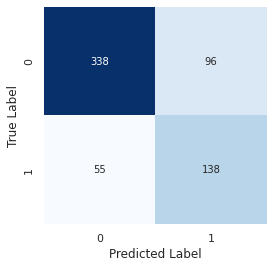

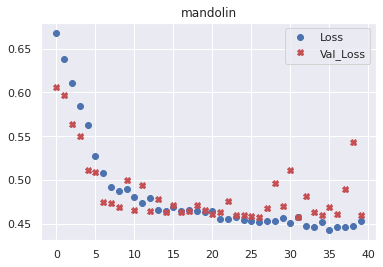

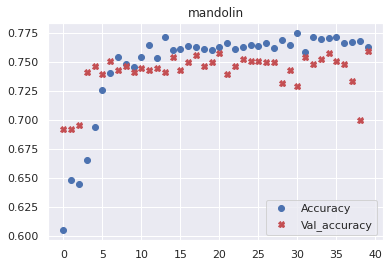


Ejemplo de predicciones:  mandolin
True label:  [0 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.03636406 0.7044516  0.11961684 0.23066683 0.3349379  0.53929704
  0.59071404 0.10782177 0.02223592 0.01297464]]
Model: "sequential_660"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_495 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_900 (Dropout)       (None, 250)               0         
                                                                 
 dense_1320 (Dense)          (None, 50)                12550     
                                                                 
 dense_1321 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
____________________________________________

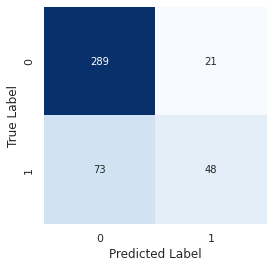

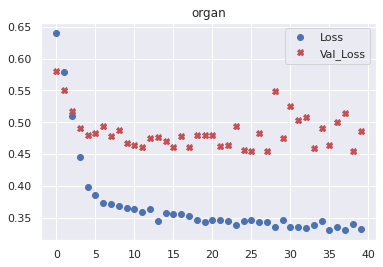

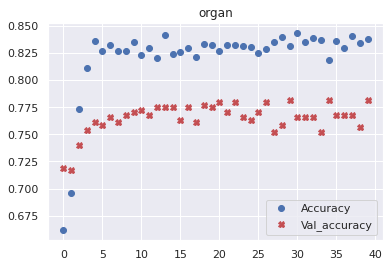


Ejemplo de predicciones:  organ
True label:  [0 0 0 1 0 1 0 0 0 0]
Predicted:   [[0.01534445 0.60512775 0.2633472  0.21038072 0.01532949 0.5669044
  0.00751382 0.01178956 0.00562161 0.0070834 ]]
Model: "sequential_661"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_496 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_901 (Dropout)       (None, 250)               0         
                                                                 
 dense_1322 (Dense)          (None, 50)                12550     
                                                                 
 dense_1323 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
________________________________________________

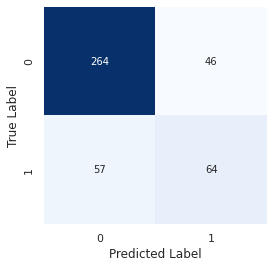

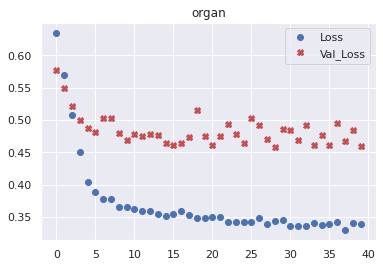

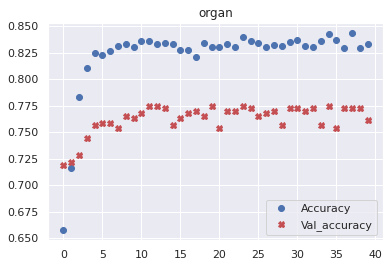


Ejemplo de predicciones:  organ
True label:  [0 0 0 1 0 1 0 0 0 0]
Predicted:   [[0.03149568 0.76987237 0.40754285 0.33447114 0.02393108 0.70404536
  0.00925586 0.02788743 0.01686781 0.01531394]]
Model: "sequential_662"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_497 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_902 (Dropout)       (None, 250)               0         
                                                                 
 dense_1324 (Dense)          (None, 50)                12550     
                                                                 
 dense_1325 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

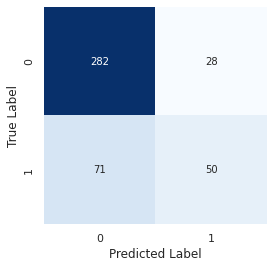

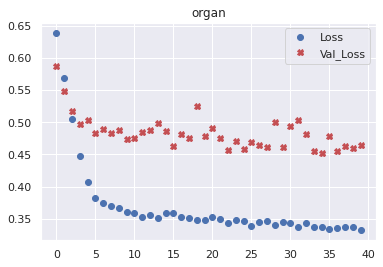

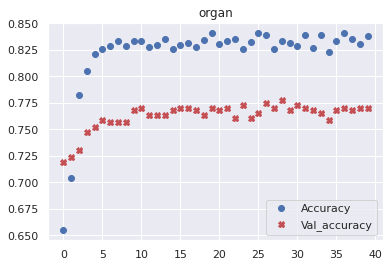


Ejemplo de predicciones:  organ
True label:  [0 0 0 1 0 1 0 0 0 0]
Predicted:   [[0.02763904 0.71443385 0.2890195  0.22649357 0.01804789 0.53096306
  0.01278058 0.01933349 0.00938932 0.00951819]]
Model: "sequential_663"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_498 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_903 (Dropout)       (None, 250)               0         
                                                                 
 dense_1326 (Dense)          (None, 50)                12550     
                                                                 
 dense_1327 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

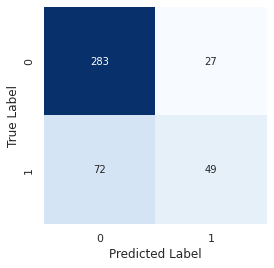

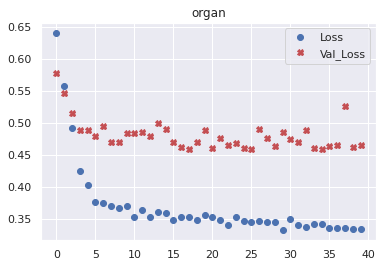

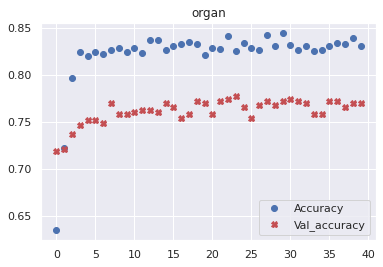


Ejemplo de predicciones:  organ
True label:  [0 0 0 1 0 1 0 0 0 0]
Predicted:   [[0.02393235 0.7164102  0.2807866  0.2514504  0.02079144 0.58005524
  0.01108335 0.02035827 0.01022818 0.00949797]]
Model: "sequential_664"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_499 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_904 (Dropout)       (None, 250)               0         
                                                                 
 dense_1328 (Dense)          (None, 50)                12550     
                                                                 
 dense_1329 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

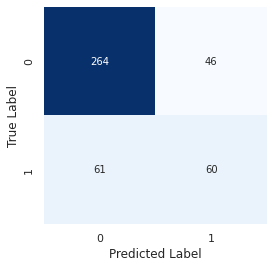

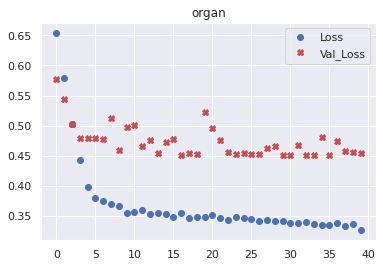

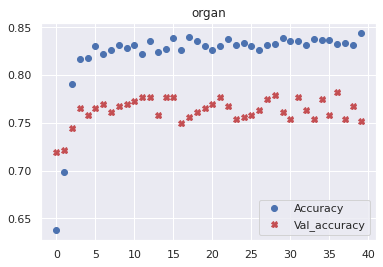


Ejemplo de predicciones:  organ
True label:  [0 0 0 1 0 1 0 0 0 0]
Predicted:   [[0.03727703 0.7514746  0.37563965 0.33146134 0.01969973 0.67946714
  0.01571532 0.02661221 0.01345556 0.01445089]]
Model: "sequential_665"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_500 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_905 (Dropout)       (None, 250)               0         
                                                                 
 dense_1330 (Dense)          (None, 50)                12550     
                                                                 
 dense_1331 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

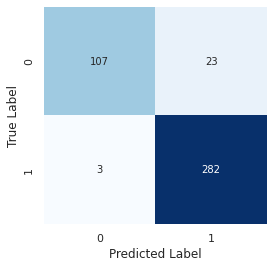

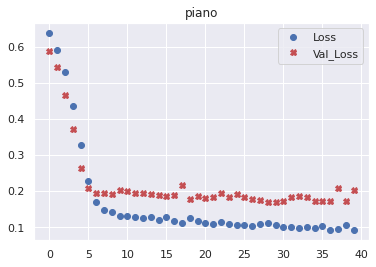

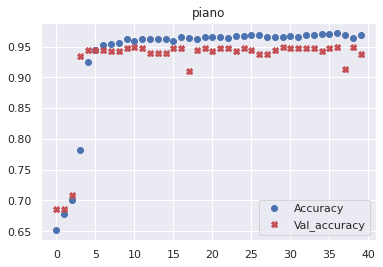


Ejemplo de predicciones:  piano
True label:  [0 0 0 0 0 0 0 1 0 0]
Predicted:   [[0.01516049 0.05343797 0.09360989 0.07324916 0.00881753 0.00304288
  0.02676839 0.8075958  0.94941515 0.00560848]]
Model: "sequential_666"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_501 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_906 (Dropout)       (None, 250)               0         
                                                                 
 dense_1332 (Dense)          (None, 50)                12550     
                                                                 
 dense_1333 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

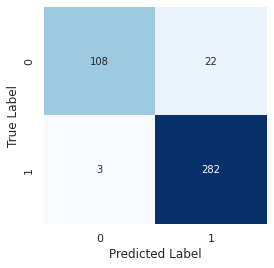

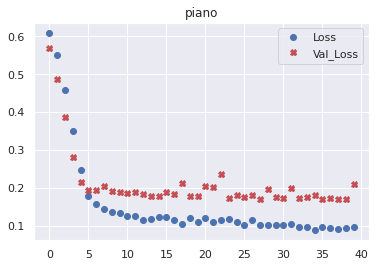

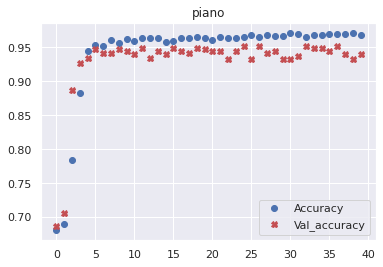


Ejemplo de predicciones:  piano
True label:  [0 0 0 0 0 0 0 1 0 0]
Predicted:   [[0.01163727 0.05833655 0.14048618 0.0706993  0.00650681 0.00295809
  0.01441304 0.86047506 0.9541718  0.00574009]]
Model: "sequential_667"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_502 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_907 (Dropout)       (None, 250)               0         
                                                                 
 dense_1334 (Dense)          (None, 50)                12550     
                                                                 
 dense_1335 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

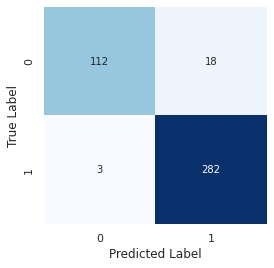

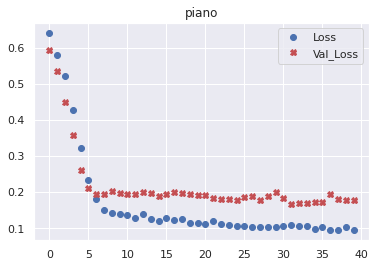

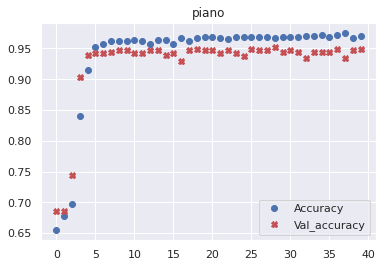


Ejemplo de predicciones:  piano
True label:  [0 0 0 0 0 0 0 1 0 0]
Predicted:   [[0.00845647 0.0162904  0.03413122 0.05062232 0.00742918 0.0037313
  0.01459284 0.68138725 0.9099875  0.00592794]]
Model: "sequential_668"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_503 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_908 (Dropout)       (None, 250)               0         
                                                                 
 dense_1336 (Dense)          (None, 50)                12550     
                                                                 
 dense_1337 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
________________________________________________

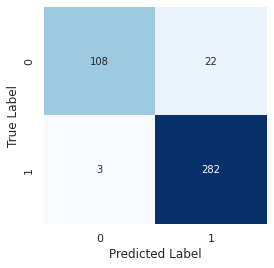

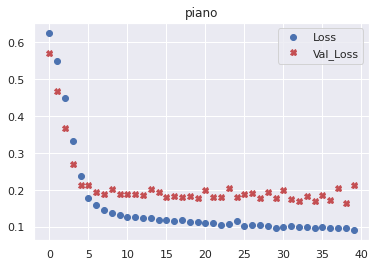

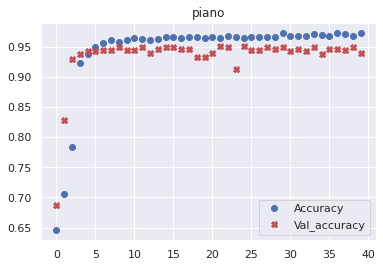


Ejemplo de predicciones:  piano
True label:  [0 0 0 0 0 0 0 1 0 0]
Predicted:   [[0.01652254 0.04272038 0.06620694 0.12008926 0.01066713 0.00366621
  0.04169206 0.8927695  0.9601742  0.00634831]]
Model: "sequential_669"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_504 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_909 (Dropout)       (None, 250)               0         
                                                                 
 dense_1338 (Dense)          (None, 50)                12550     
                                                                 
 dense_1339 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

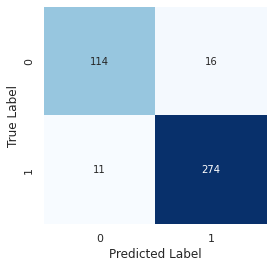

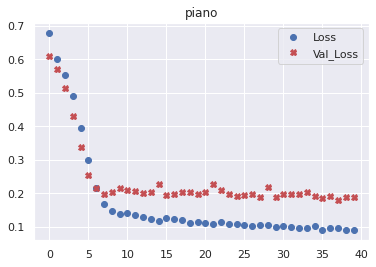

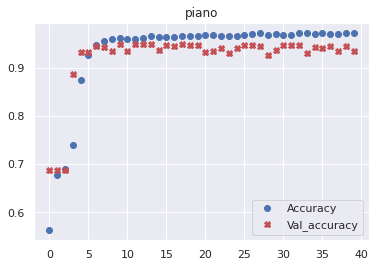


Ejemplo de predicciones:  piano
True label:  [0 0 0 0 0 0 0 1 0 0]
Predicted:   [[0.00437185 0.00496583 0.00798602 0.00887933 0.00279508 0.00186755
  0.00611308 0.11964262 0.8369709  0.00326285]]
Model: "sequential_670"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_505 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_910 (Dropout)       (None, 250)               0         
                                                                 
 dense_1340 (Dense)          (None, 50)                12550     
                                                                 
 dense_1341 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

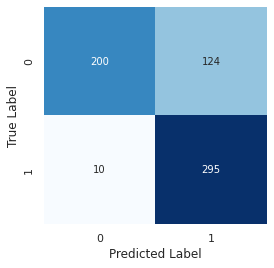

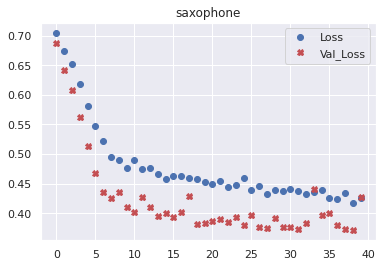

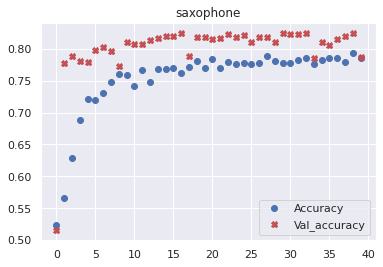


Ejemplo de predicciones:  saxophone
True label:  [0 1 0 0 0 0 0 0 0 1]
Predicted:   [[0.52681774 0.92207646 0.10574865 0.17523535 0.8136293  0.09623864
  0.37179485 0.47358516 0.54773897 0.8061325 ]]
Model: "sequential_671"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_506 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_911 (Dropout)       (None, 250)               0         
                                                                 
 dense_1342 (Dense)          (None, 50)                12550     
                                                                 
 dense_1343 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
___________________________________________

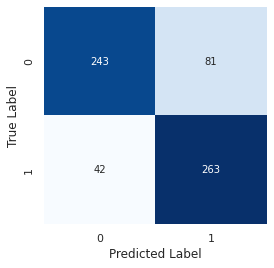

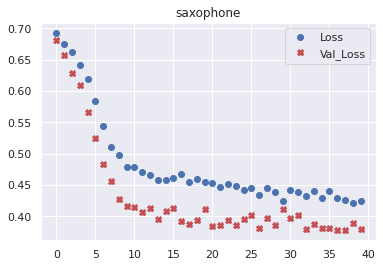

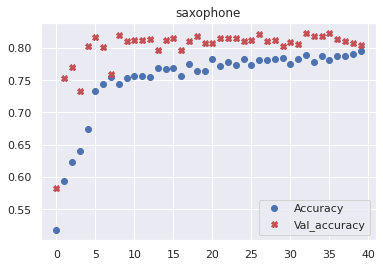


Ejemplo de predicciones:  saxophone
True label:  [0 1 0 0 0 0 0 0 0 1]
Predicted:   [[0.36359903 0.90179896 0.06051243 0.06518801 0.6648448  0.04243838
  0.15551229 0.31735316 0.36675113 0.6003568 ]]
Model: "sequential_672"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_507 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_912 (Dropout)       (None, 250)               0         
                                                                 
 dense_1344 (Dense)          (None, 50)                12550     
                                                                 
 dense_1345 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
___________________________________________

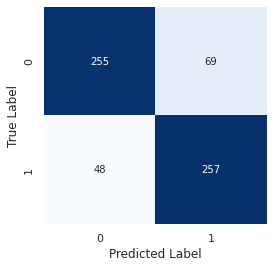

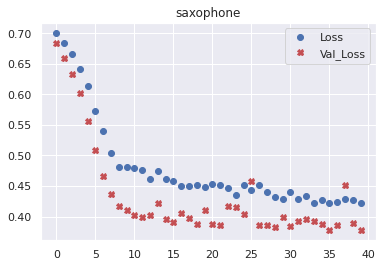

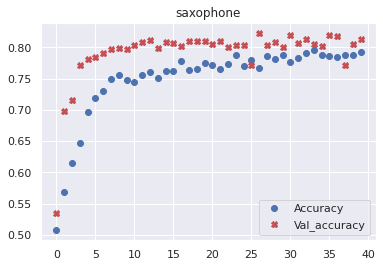


Ejemplo de predicciones:  saxophone
True label:  [0 1 0 0 0 0 0 0 0 1]
Predicted:   [[0.34960756 0.8529436  0.06091866 0.18693395 0.61904085 0.04300786
  0.15324274 0.28494665 0.42069006 0.62692046]]
Model: "sequential_673"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_508 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_913 (Dropout)       (None, 250)               0         
                                                                 
 dense_1346 (Dense)          (None, 50)                12550     
                                                                 
 dense_1347 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
___________________________________________

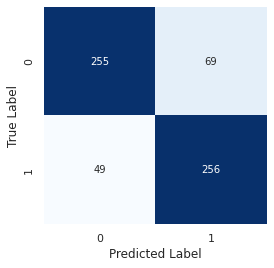

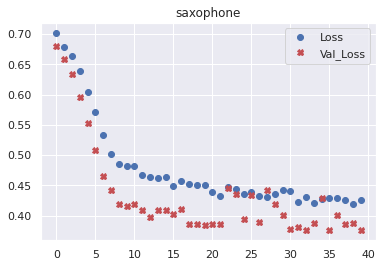

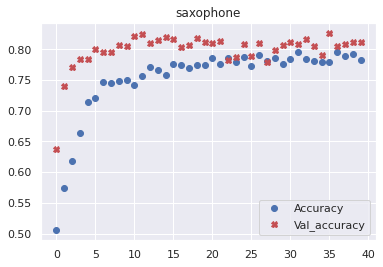


Ejemplo de predicciones:  saxophone
True label:  [0 1 0 0 0 0 0 0 0 1]
Predicted:   [[0.33673579 0.87167484 0.03219531 0.14892605 0.6213368  0.04543584
  0.16942173 0.27421877 0.36511683 0.6212126 ]]
Model: "sequential_674"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_509 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_914 (Dropout)       (None, 250)               0         
                                                                 
 dense_1348 (Dense)          (None, 50)                12550     
                                                                 
 dense_1349 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
___________________________________________

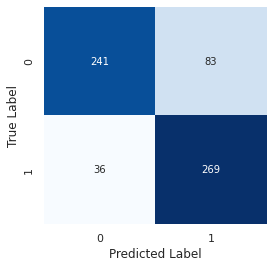

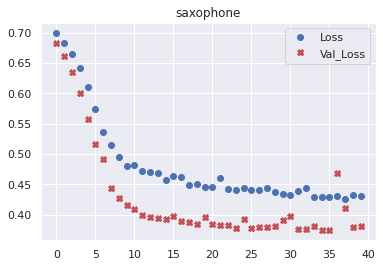

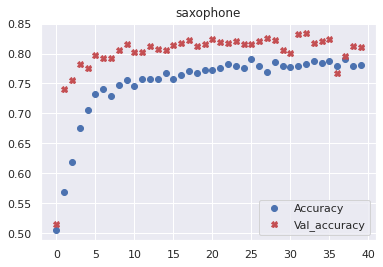


Ejemplo de predicciones:  saxophone
True label:  [0 1 0 0 0 0 0 0 0 1]
Predicted:   [[0.3231679  0.8826128  0.05068737 0.16281562 0.6733348  0.05478282
  0.22858334 0.3930119  0.46888733 0.64371675]]
Model: "sequential_675"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_510 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_915 (Dropout)       (None, 250)               0         
                                                                 
 dense_1350 (Dense)          (None, 50)                12550     
                                                                 
 dense_1351 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
___________________________________________

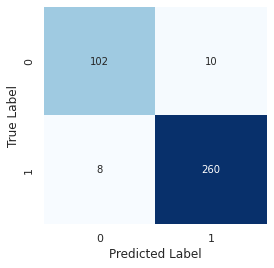

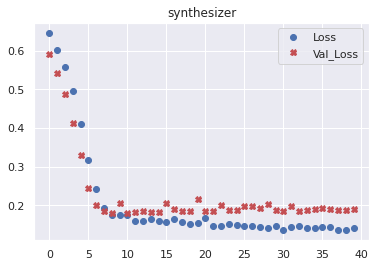

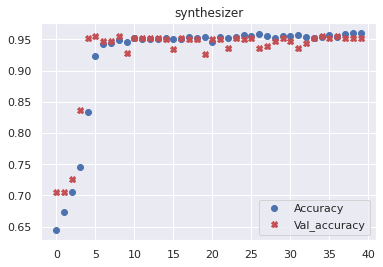


Ejemplo de predicciones:  synthesizer
True label:  [1 1 1 1 1 0 1 1 1 1]
Predicted:   [[0.6349289  0.9912298  0.99395424 0.9341931  0.98535293 0.09455769
  0.99364614 0.9910657  0.99668854 0.9869207 ]]
Model: "sequential_676"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_511 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_916 (Dropout)       (None, 250)               0         
                                                                 
 dense_1352 (Dense)          (None, 50)                12550     
                                                                 
 dense_1353 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_________________________________________

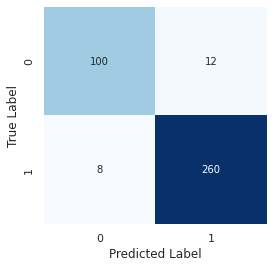

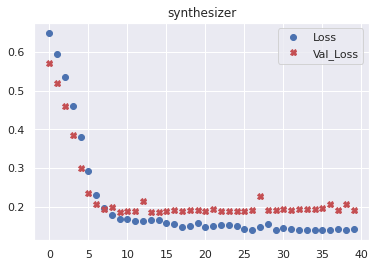

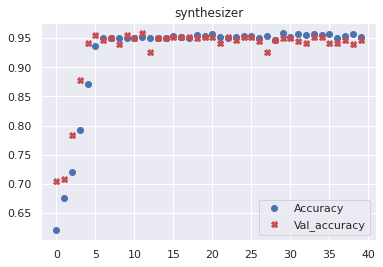


Ejemplo de predicciones:  synthesizer
True label:  [1 1 1 1 1 0 1 1 1 1]
Predicted:   [[0.6135605  0.9924816  0.99612314 0.93948543 0.9870651  0.12741004
  0.9945614  0.99148726 0.997517   0.98962945]]
Model: "sequential_677"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_512 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_917 (Dropout)       (None, 250)               0         
                                                                 
 dense_1354 (Dense)          (None, 50)                12550     
                                                                 
 dense_1355 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_________________________________________

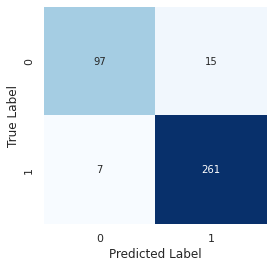

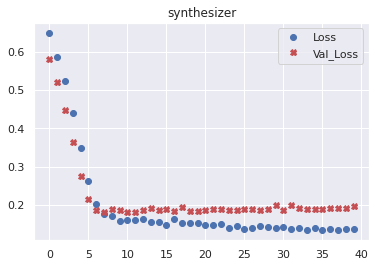

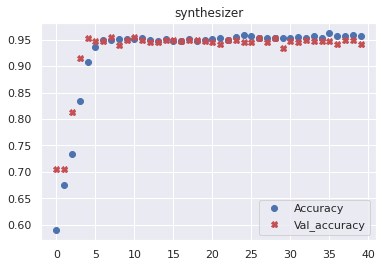


Ejemplo de predicciones:  synthesizer
True label:  [1 1 1 1 1 0 1 1 1 1]
Predicted:   [[0.758329   0.99309057 0.9951133  0.9737241  0.98993367 0.29819554
  0.99493533 0.9926173  0.99664164 0.98952943]]
Model: "sequential_678"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_513 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_918 (Dropout)       (None, 250)               0         
                                                                 
 dense_1356 (Dense)          (None, 50)                12550     
                                                                 
 dense_1357 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_________________________________________

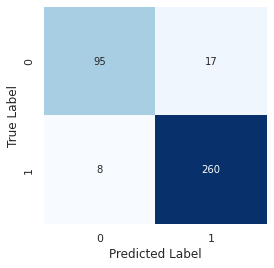

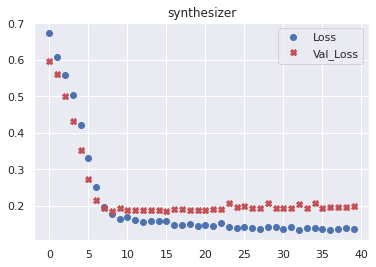

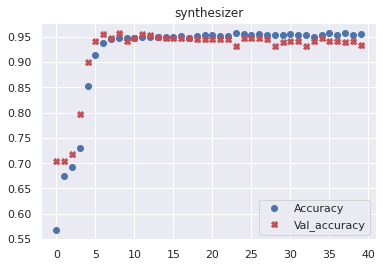


Ejemplo de predicciones:  synthesizer
True label:  [1 1 1 1 1 0 1 1 1 1]
Predicted:   [[0.9166809  0.99246454 0.99579084 0.97399884 0.98995346 0.34545308
  0.9953685  0.99190736 0.9967244  0.99073094]]
Model: "sequential_679"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_514 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_919 (Dropout)       (None, 250)               0         
                                                                 
 dense_1358 (Dense)          (None, 50)                12550     
                                                                 
 dense_1359 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_________________________________________

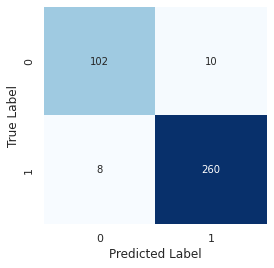

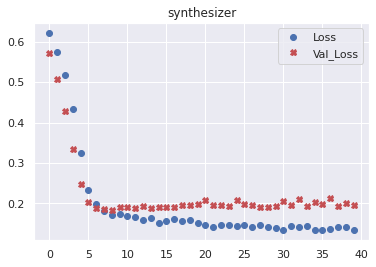

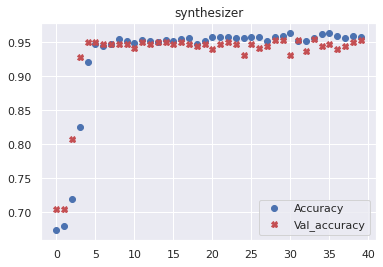


Ejemplo de predicciones:  synthesizer
True label:  [1 1 1 1 1 0 1 1 1 1]
Predicted:   [[0.5418917  0.9920981  0.9948019  0.93036056 0.98725176 0.14812031
  0.9935813  0.9935509  0.9973519  0.99080396]]
Model: "sequential_680"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_515 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_920 (Dropout)       (None, 250)               0         
                                                                 
 dense_1360 (Dense)          (None, 50)                12550     
                                                                 
 dense_1361 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_________________________________________

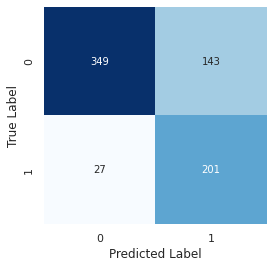

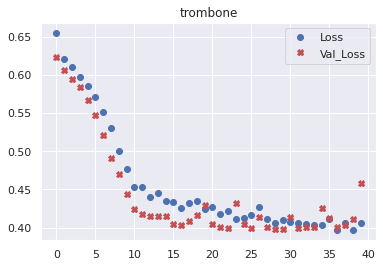

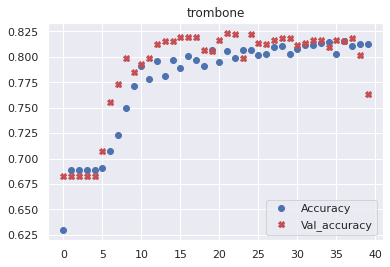


Ejemplo de predicciones:  trombone
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.14264925 0.65418077 0.32895145 0.29843894 0.78846306 0.6564673
  0.48088992 0.00878189 0.34705713 0.0107494 ]]
Model: "sequential_681"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_516 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_921 (Dropout)       (None, 250)               0         
                                                                 
 dense_1362 (Dense)          (None, 50)                12550     
                                                                 
 dense_1363 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_____________________________________________

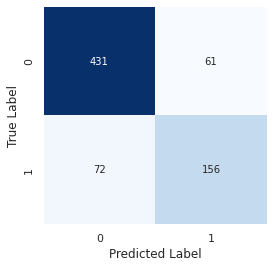

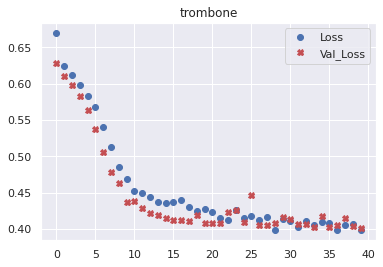

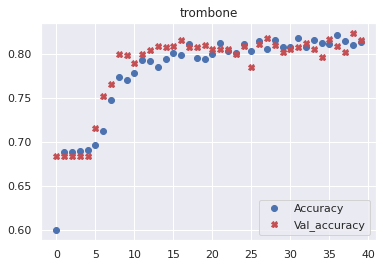


Ejemplo de predicciones:  trombone
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.06169397 0.3319229  0.10539836 0.08773621 0.67469484 0.35041362
  0.29519695 0.00731712 0.12278094 0.00681406]]
Model: "sequential_682"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_517 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_922 (Dropout)       (None, 250)               0         
                                                                 
 dense_1364 (Dense)          (None, 50)                12550     
                                                                 
 dense_1365 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
____________________________________________

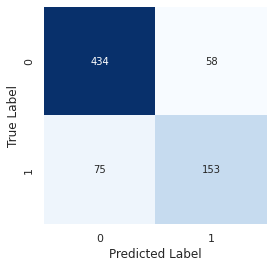

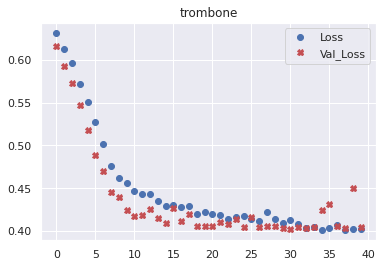

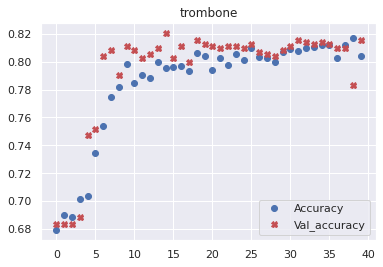


Ejemplo de predicciones:  trombone
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.06447584 0.4120426  0.12190802 0.0703062  0.7235909  0.34759468
  0.19121568 0.00597432 0.12965138 0.00472684]]
Model: "sequential_683"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_518 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_923 (Dropout)       (None, 250)               0         
                                                                 
 dense_1366 (Dense)          (None, 50)                12550     
                                                                 
 dense_1367 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
____________________________________________

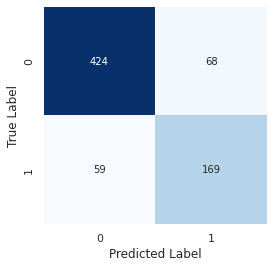

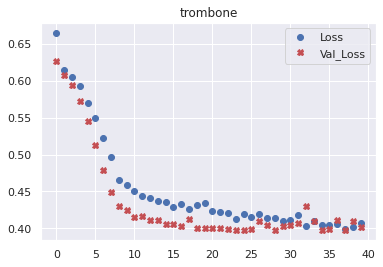

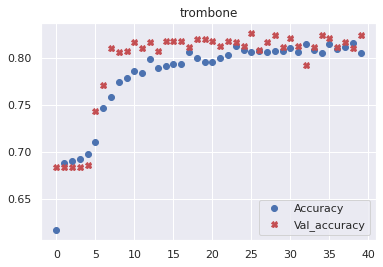


Ejemplo de predicciones:  trombone
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.07095303 0.4325118  0.1718663  0.11434548 0.7211342  0.3666042
  0.28708258 0.00594475 0.15605947 0.00519086]]
Model: "sequential_684"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_519 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_924 (Dropout)       (None, 250)               0         
                                                                 
 dense_1368 (Dense)          (None, 50)                12550     
                                                                 
 dense_1369 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_____________________________________________

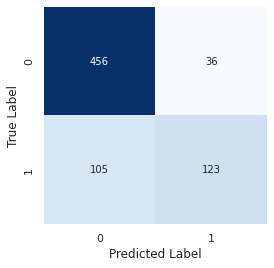

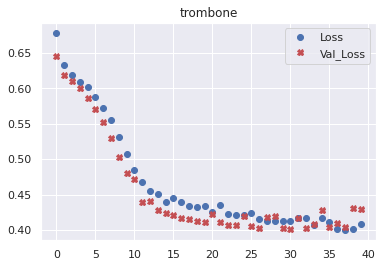

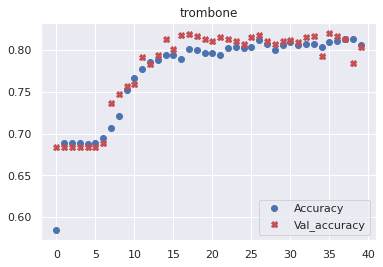


Ejemplo de predicciones:  trombone
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.03903395 0.24109666 0.09366847 0.04980642 0.54284453 0.19320714
  0.20152825 0.00552003 0.06002668 0.00725942]]
Model: "sequential_685"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_520 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_925 (Dropout)       (None, 250)               0         
                                                                 
 dense_1370 (Dense)          (None, 50)                12550     
                                                                 
 dense_1371 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
____________________________________________

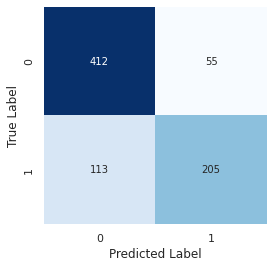

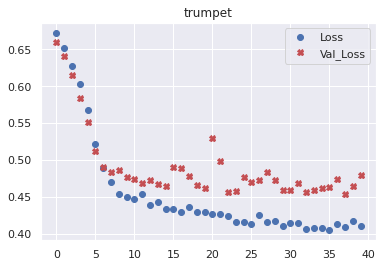

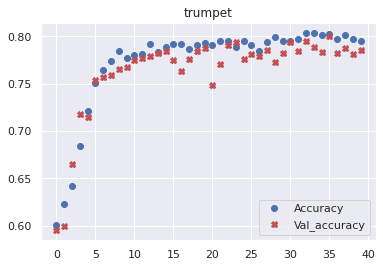


Ejemplo de predicciones:  trumpet
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.11127152 0.0812111  0.17782953 0.1711565  0.7951705  0.21133262
  0.01497415 0.27957392 0.05444388 0.0513758 ]]
Model: "sequential_686"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_521 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_926 (Dropout)       (None, 250)               0         
                                                                 
 dense_1372 (Dense)          (None, 50)                12550     
                                                                 
 dense_1373 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_____________________________________________

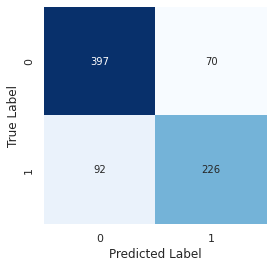

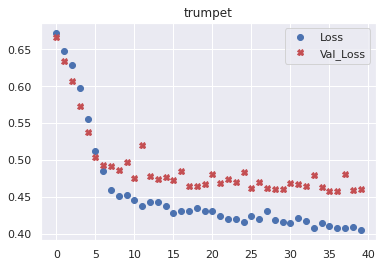

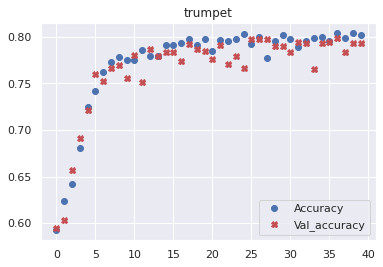


Ejemplo de predicciones:  trumpet
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.28009945 0.09748274 0.24193309 0.27560812 0.8332425  0.31817368
  0.01679465 0.31421158 0.09322237 0.09764778]]
Model: "sequential_687"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_522 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_927 (Dropout)       (None, 250)               0         
                                                                 
 dense_1374 (Dense)          (None, 50)                12550     
                                                                 
 dense_1375 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_____________________________________________

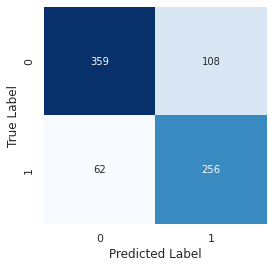

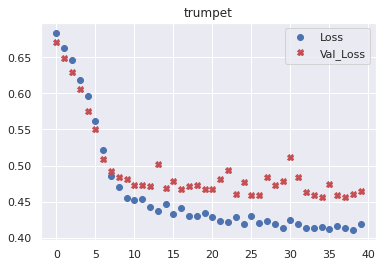

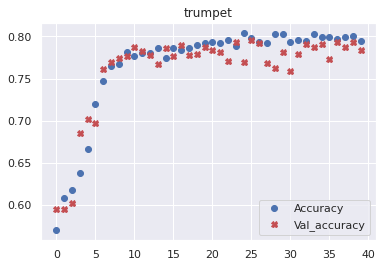


Ejemplo de predicciones:  trumpet
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.41926432 0.21015975 0.35633716 0.43844387 0.8774899  0.5525569
  0.02945749 0.49687856 0.15458141 0.18004312]]
Model: "sequential_688"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_523 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_928 (Dropout)       (None, 250)               0         
                                                                 
 dense_1376 (Dense)          (None, 50)                12550     
                                                                 
 dense_1377 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
______________________________________________

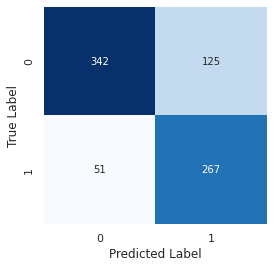

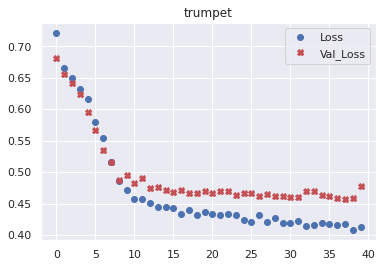

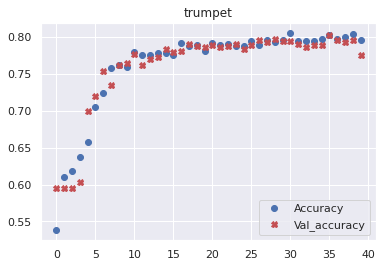


Ejemplo de predicciones:  trumpet
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.3819482  0.2670315  0.34377068 0.490175   0.88460386 0.5694675
  0.03924633 0.54944134 0.23493043 0.28388786]]
Model: "sequential_689"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_524 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_929 (Dropout)       (None, 250)               0         
                                                                 
 dense_1378 (Dense)          (None, 50)                12550     
                                                                 
 dense_1379 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
______________________________________________

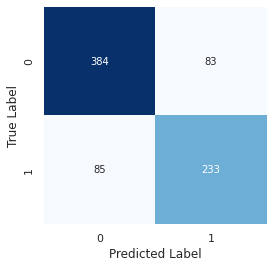

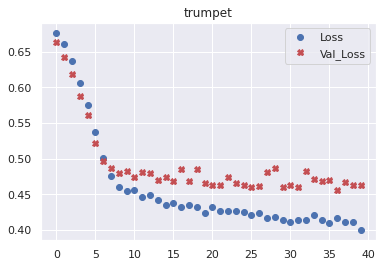

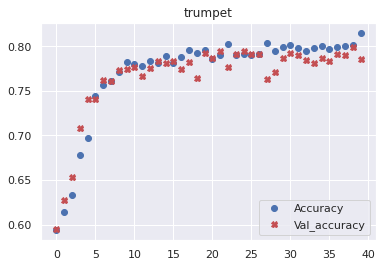


Ejemplo de predicciones:  trumpet
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [[0.27016795 0.09984455 0.25805098 0.30910656 0.86534226 0.35386786
  0.01815378 0.38888684 0.0805159  0.17145775]]
Model: "sequential_690"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_525 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_930 (Dropout)       (None, 250)               0         
                                                                 
 dense_1380 (Dense)          (None, 50)                12550     
                                                                 
 dense_1381 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_____________________________________________

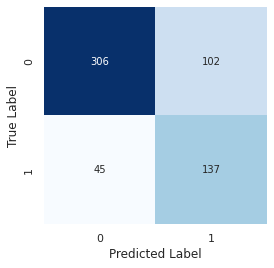

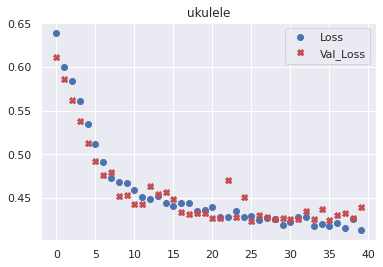

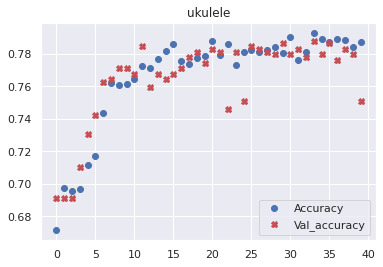


Ejemplo de predicciones:  ukulele
True label:  [1 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.8075537  0.0225866  0.0651084  0.16929601 0.50211215 0.56217587
  0.0046941  0.00644145 0.00771176 0.47319555]]
Model: "sequential_691"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_526 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_931 (Dropout)       (None, 250)               0         
                                                                 
 dense_1382 (Dense)          (None, 50)                12550     
                                                                 
 dense_1383 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_____________________________________________

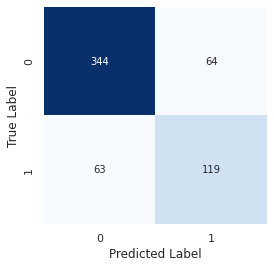

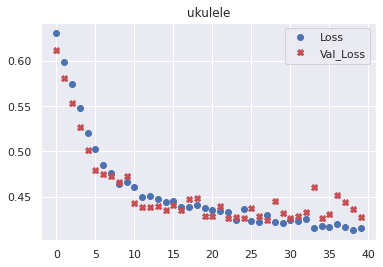

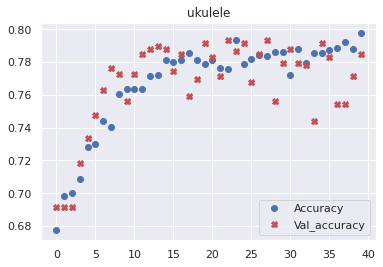


Ejemplo de predicciones:  ukulele
True label:  [1 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.76909316 0.02149945 0.03512285 0.06516832 0.3659509  0.44342375
  0.00300741 0.00321308 0.00526281 0.48213506]]
Model: "sequential_692"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_527 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_932 (Dropout)       (None, 250)               0         
                                                                 
 dense_1384 (Dense)          (None, 50)                12550     
                                                                 
 dense_1385 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_____________________________________________

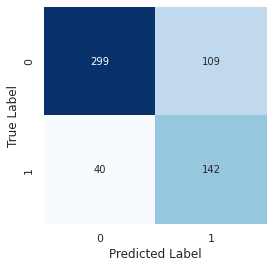

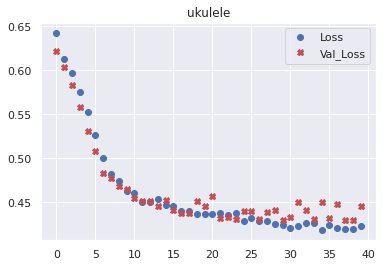

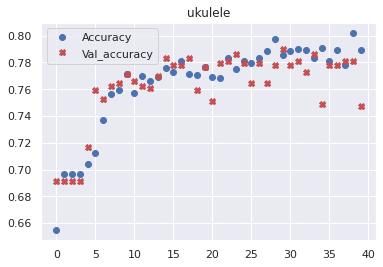


Ejemplo de predicciones:  ukulele
True label:  [1 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.77539045 0.02519838 0.0720499  0.11000838 0.50217867 0.57339454
  0.00418921 0.0046972  0.00710389 0.59785354]]
Model: "sequential_693"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_528 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_933 (Dropout)       (None, 250)               0         
                                                                 
 dense_1386 (Dense)          (None, 50)                12550     
                                                                 
 dense_1387 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_____________________________________________

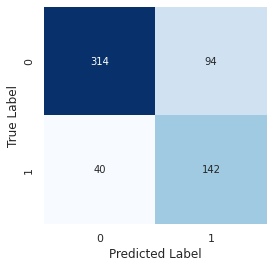

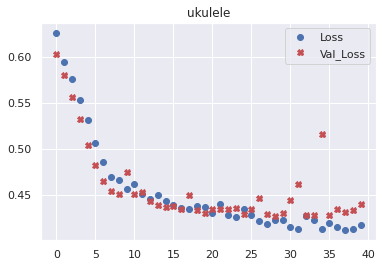

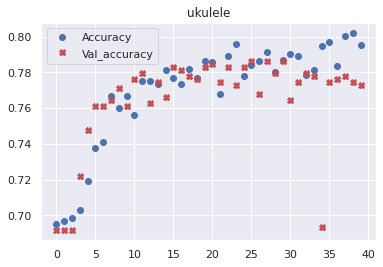


Ejemplo de predicciones:  ukulele
True label:  [1 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.8172004  0.0228634  0.05327559 0.10574034 0.4721077  0.5414071
  0.00401558 0.00421862 0.00618965 0.45646778]]
Model: "sequential_694"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_529 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_934 (Dropout)       (None, 250)               0         
                                                                 
 dense_1388 (Dense)          (None, 50)                12550     
                                                                 
 dense_1389 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
______________________________________________

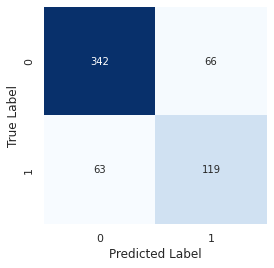

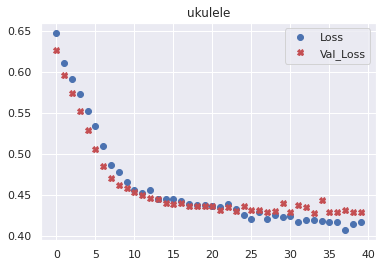

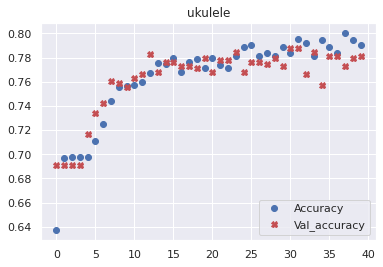


Ejemplo de predicciones:  ukulele
True label:  [1 0 0 0 0 1 0 0 0 0]
Predicted:   [[0.7428584  0.01761219 0.03050017 0.0811647  0.36136255 0.41157824
  0.00243183 0.00268004 0.00407091 0.4626966 ]]
Model: "sequential_695"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_530 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_935 (Dropout)       (None, 250)               0         
                                                                 
 dense_1390 (Dense)          (None, 50)                12550     
                                                                 
 dense_1391 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_____________________________________________

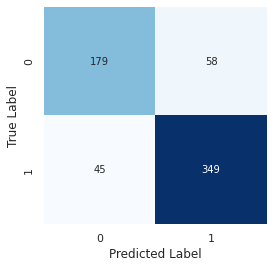

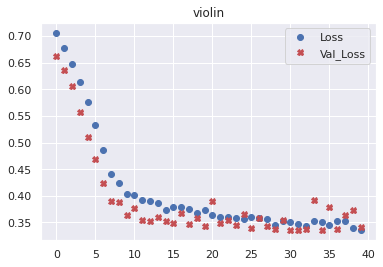

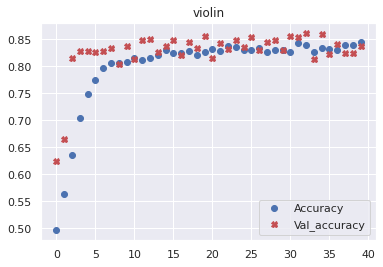


Ejemplo de predicciones:  violin
True label:  [0 0 1 0 0 0 0 0 0 1]
Predicted:   [[0.30571023 0.85586005 0.72606146 0.21594366 0.90073633 0.00720004
  0.00763078 0.00521425 0.01921655 0.84798515]]
Model: "sequential_696"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_531 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_936 (Dropout)       (None, 250)               0         
                                                                 
 dense_1392 (Dense)          (None, 50)                12550     
                                                                 
 dense_1393 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
______________________________________________

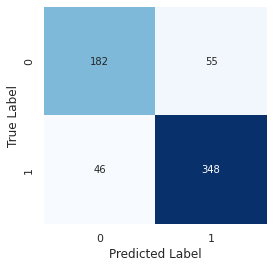

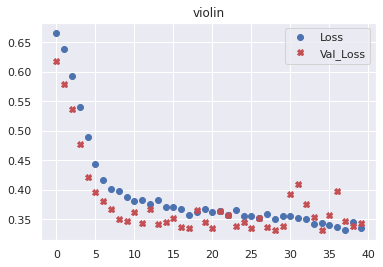

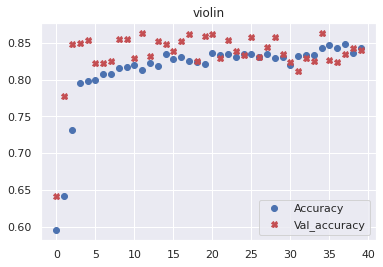


Ejemplo de predicciones:  violin
True label:  [0 0 1 0 0 0 0 0 0 1]
Predicted:   [[0.25237566 0.8253284  0.758729   0.13343328 0.8781289  0.00592589
  0.00703858 0.00389203 0.01500353 0.84988457]]
Model: "sequential_697"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_532 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_937 (Dropout)       (None, 250)               0         
                                                                 
 dense_1394 (Dense)          (None, 50)                12550     
                                                                 
 dense_1395 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
______________________________________________

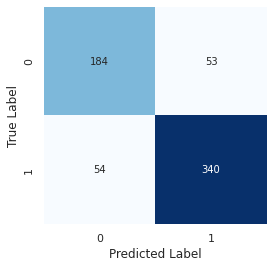

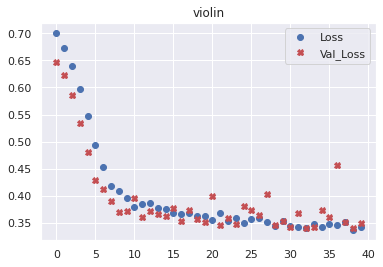

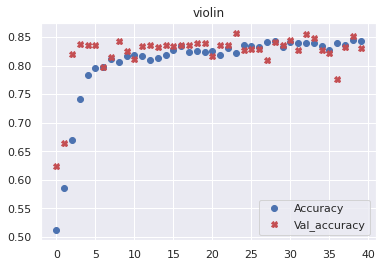


Ejemplo de predicciones:  violin
True label:  [0 0 1 0 0 0 0 0 0 1]
Predicted:   [[0.30751592 0.7923907  0.72956324 0.20981784 0.8635899  0.00630607
  0.00784925 0.00391277 0.01681556 0.82253724]]
Model: "sequential_698"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_533 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_938 (Dropout)       (None, 250)               0         
                                                                 
 dense_1396 (Dense)          (None, 50)                12550     
                                                                 
 dense_1397 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
______________________________________________

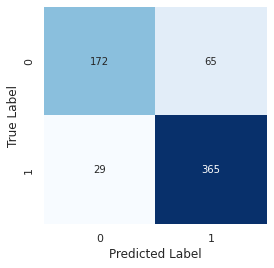

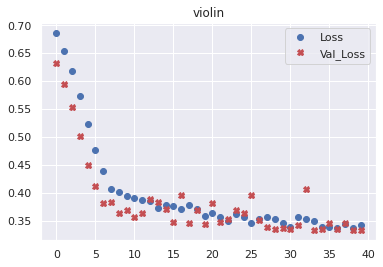

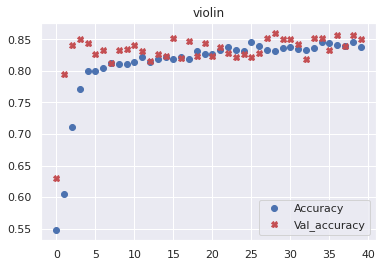


Ejemplo de predicciones:  violin
True label:  [0 0 1 0 0 0 0 0 0 1]
Predicted:   [[0.43312484 0.84390306 0.78745365 0.3020615  0.87587124 0.00776419
  0.00783512 0.00448326 0.02805317 0.8916617 ]]
Model: "sequential_699"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_534 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_939 (Dropout)       (None, 250)               0         
                                                                 
 dense_1398 (Dense)          (None, 50)                12550     
                                                                 
 dense_1399 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
______________________________________________

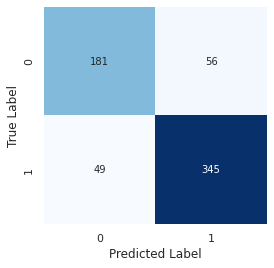

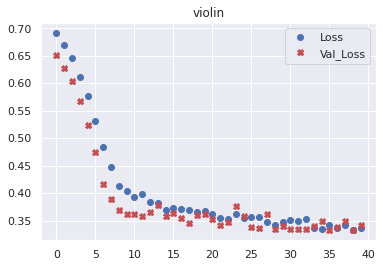

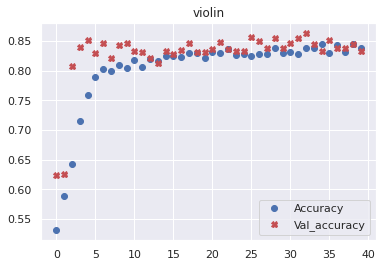


Ejemplo de predicciones:  violin
True label:  [0 0 1 0 0 0 0 0 0 1]
Predicted:   [[0.31264228 0.78393805 0.69456726 0.27819246 0.88839036 0.00409499
  0.00667524 0.00283764 0.01338979 0.82592857]]
Model: "sequential_700"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_535 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_940 (Dropout)       (None, 250)               0         
                                                                 
 dense_1400 (Dense)          (None, 50)                12550     
                                                                 
 dense_1401 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
______________________________________________

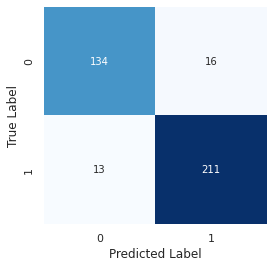

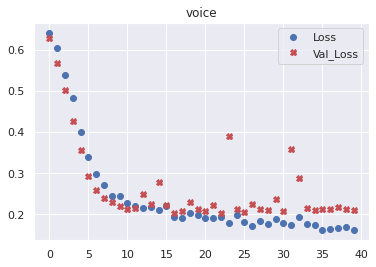

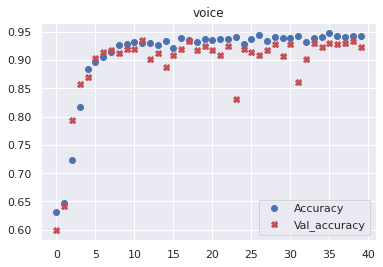


Ejemplo de predicciones:  voice
True label:  [1 0 1 1 1 1 1 0 1 1]
Predicted:   [[0.9258301  0.01297564 0.9960194  0.9894549  0.9949964  0.9772774
  0.99668187 0.01269398 0.98223937 0.98459816]]
Model: "sequential_701"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_536 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_941 (Dropout)       (None, 250)               0         
                                                                 
 dense_1402 (Dense)          (None, 50)                12550     
                                                                 
 dense_1403 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
________________________________________________

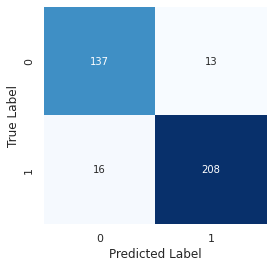

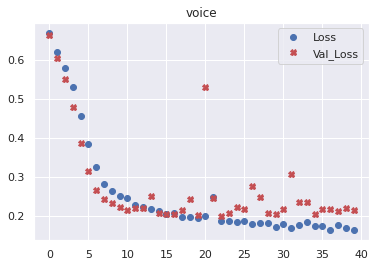

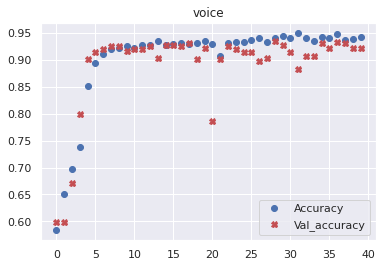


Ejemplo de predicciones:  voice
True label:  [1 0 1 1 1 1 1 0 1 1]
Predicted:   [[0.9278994  0.01071245 0.99565697 0.9862629  0.9931901  0.9769111
  0.99634993 0.0070363  0.96714014 0.97947824]]
Model: "sequential_702"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_537 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_942 (Dropout)       (None, 250)               0         
                                                                 
 dense_1404 (Dense)          (None, 50)                12550     
                                                                 
 dense_1405 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
________________________________________________

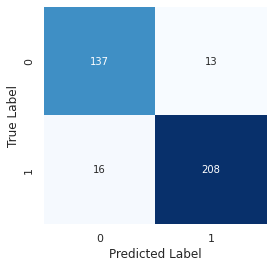

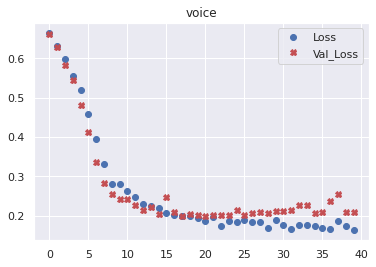

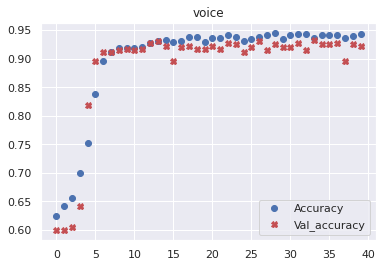


Ejemplo de predicciones:  voice
True label:  [1 0 1 1 1 1 1 0 1 1]
Predicted:   [[0.8625278  0.01444404 0.9937773  0.9870985  0.9916549  0.95618737
  0.99489886 0.00563278 0.947797   0.9795472 ]]
Model: "sequential_703"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_538 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_943 (Dropout)       (None, 250)               0         
                                                                 
 dense_1406 (Dense)          (None, 50)                12550     
                                                                 
 dense_1407 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
_______________________________________________

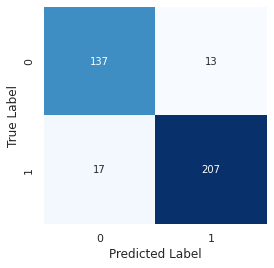

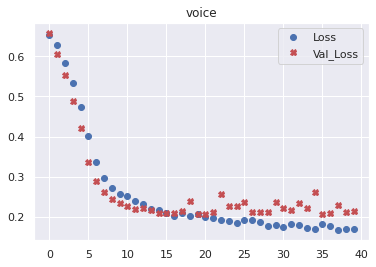

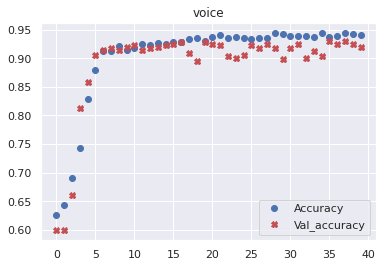


Ejemplo de predicciones:  voice
True label:  [1 0 1 1 1 1 1 0 1 1]
Predicted:   [[0.87166846 0.00736981 0.9912983  0.9756717  0.98785865 0.9232945
  0.99294394 0.00629155 0.9392479  0.96788645]]
Model: "sequential_704"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 lstm_539 (LSTM)             (None, 250)               379000    
                                                                 
 dropout_944 (Dropout)       (None, 250)               0         
                                                                 
 dense_1408 (Dense)          (None, 50)                12550     
                                                                 
 dense_1409 (Dense)          (None, 1)                 51        
                                                                 
Total params: 391,601
Trainable params: 391,601
Non-trainable params: 0
________________________________________________

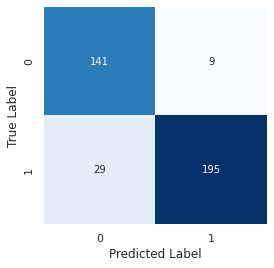

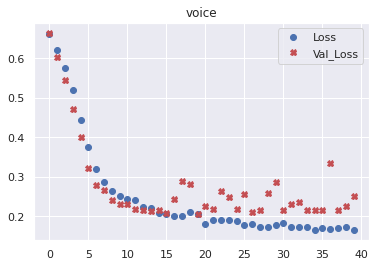

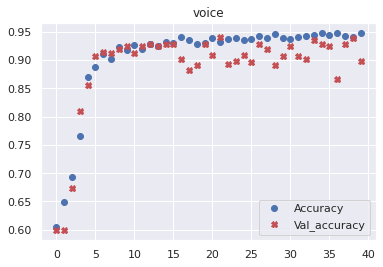


Ejemplo de predicciones:  voice
True label:  [1 0 1 1 1 1 1 0 1 1]
Predicted:   [[0.74210835 0.00726268 0.9941195  0.9833686  0.9919669  0.90994436
  0.99420434 0.00843844 0.9421696  0.96659285]]


In [ ]:
## Classification optimizing accuracy
from tensorflow import keras
#import tf.keras.Sequential
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.models import Model
from keras.optimizers import gradient_descent_v2
#from keras.optimizers import SGD
#from tensorflow.keras.optimizers import SGD
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from keras.layers import Input, Dense, SimpleRNN, LSTM
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import average_precision_score
%matplotlib inline

# This dictionary will include the classifiers for each model
models = dict()
histories = dict()
recurrent_LSTM_results = dict()

n_realizations = 5

# We'll iterate over all istrument classes, and fit a model for each one
# After training, we'll print a classification report for each instrument
for instrument in class_map:
    
    # A list where we are going to store results of that instrument
    instrument_result_list = []
    
    # A list where we are going to store the threshold that maximizes accuracy for that instrument
    optimal_threshold_list = []

    # Map the instrument name to its column number
    inst_num = class_map[instrument]
    #if inst_num != 0:
    #  continue
    # Several train/test realizations
    for n_realizations_ in range(0,n_realizations):
        
      # Step 1: sub-sample the data
      
      # First, we need to select down to the data for which we have annotations
      # This is what the mask arrays are for
      train_inst = Y_mask_train[:, inst_num]
      test_inst = Y_mask_test[:, inst_num]
      
      # Here, we're using the Y_mask_train array to slice out only the training examples
      # for which we have annotations for the given class
      X_train_inst = X_train[train_inst]
      
      # Step 3: simplify the data by averaging over time  XXXXXXX1
      
      # Let's arrange the data for a sklearn Random Forest model 
      # Instead of having time-varying features, we'll summarize each track by its mean feature vector over time
      #X_train_inst_sklearn = np.mean(X_train_inst, axis=1)
      X_train_inst_sklearn_norm = X_train_inst / 255
      
      # Again, we slice the labels to the annotated examples XXXXXXX2
      # We thresold the label likelihoods at 0.5 to get binary labels
      Y_true_train_inst = Y_true_train[train_inst, inst_num] >= 0.5
      Y_true_train_inst = Y_true_train_inst.round()

      #X_train_inst_sklearn = X_train_inst / 255
      #X_test_inst_sklearn = X_test_inst / 255

      # Repeat the above slicing and dicing but for the test set XXXXXXX2
      X_test_inst = X_test[test_inst]
      #X_test_inst_sklearn = np.mean(X_test_inst, axis=1)
      X_test_inst_sklearn_norm = X_test_inst / 255
      Y_true_test_inst = Y_true_test[test_inst, inst_num] >= 0.5
      Y_true_test_inst = Y_true_test_inst.round()


      # Step 3.
      # Initialize a new classifier

      # define the LSTM model
      model = Sequential()
      model.add(LSTM(250, input_shape=(X_train_inst_sklearn_norm.shape[1], X_train_inst_sklearn_norm.shape[2])))
      model.add(Dropout(0.5))
      model.add(Dense(50, activation='relu'))
      model.add(Dense(1, activation='sigmoid'))
      
      sgd = gradient_descent_v2.SGD(learning_rate=0.005, decay=1e-6, momentum=0.9, nesterov=True)

      model.compile(loss='binary_crossentropy',
                    optimizer=sgd,
                    metrics=['accuracy'])

      model.summary()

      
      # Step 4.
      history = model.fit(X_train_inst_sklearn_norm, Y_true_train_inst,
          epochs=40,
          batch_size=128,
          validation_data=(X_test_inst_sklearn_norm, Y_true_test_inst),
          verbose=1)


      # Step 5.
      # Finally, we'll evaluate the model on both train and test
      Y_pred_train = model.predict(X_train_inst_sklearn_norm)


      Y_pred_test = model.predict(X_test_inst_sklearn_norm)
      y_true_ = Y_true_test_inst > 0.5
      #threshold = np.mean(optimal_threshold_list)
      threshold = 0.5
      y_pred_ = Y_pred_test > threshold

      
      
      #Y_pred_train = Y_pred_train.round()
      #Y_pred_test = Y_pred_test.round()
      
      print('-' * 52)
      print(instrument)
      print('\tTRAIN')
      print(classification_report(Y_true_train_inst, Y_pred_train.round()))
      print('\tTEST')
      print(classification_report(Y_true_test_inst, Y_pred_test.round()))

      cm = confusion_matrix(Y_true_test_inst, Y_pred_test.round())
      plt.figure(figsize=(4,4))
      sns.heatmap(cm, annot=True,  fmt='d', cmap=plt.cm.Blues, cbar=False)
      plt.xlabel('Predicted Label')
      plt.ylabel('True Label')
      plt.show()

      plt.figure(1)
      plt.plot((history.history['loss']),'bo',label="Loss")
      plt.plot((history.history['val_loss']),'rX', label="Val_Loss")
      plt.title(instrument)
      plt.legend()
      plt.show()
      plt.figure(2)
      plt.plot((history.history['accuracy']),'bo', label="Accuracy")
      plt.plot((history.history['val_accuracy']),'rX', label="Val_accuracy")
      plt.title(instrument)
      plt.legend()
      plt.show()
      
      print()
      print("Ejemplo de predicciones: ", instrument)
      print("True label: ", np.array(Y_true_test_inst[0:10]).astype(int))
      print("Predicted:  ", Y_pred_test[0:10].T)

      # Store the classifier in our dictionary
      models[instrument] = model
      histories[instrument] = history
      results = dict()
      results["Y_true_train"] = Y_true_train_inst.round()
      results["Y_pred_train"] = (Y_pred_train).T
      results["Y_true_test"] = Y_true_test_inst.round()
      results["Y_pred_test"] = (Y_pred_test).T

      results["Accuracy"] = [accuracy_score(y_true_, y_pred_).round(3), threshold]
      # Store test f1 with format [ F1, threshold_accuracy ]
      results["F1"] = [f1_score(y_true_, y_pred_, zero_division=1).round(3), threshold]
      results["AP"] = average_precision_score(y_true_, Y_pred_test).round(3)
      instrument_result_list.append(results)
      if n_realizations_ == n_realizations-1:
        recurrent_LSTM_results[instrument] = instrument_result_list

In [ ]:
## Classification optimizing accuracy
from tensorflow import keras
#import tf.keras.Sequential
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.models import Model
from keras.optimizers import gradient_descent_v2
#from keras.optimizers import SGD
#from tensorflow.keras.optimizers import SGD
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
from keras.layers import Input, Dense, SimpleRNN, LSTM
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import average_precision_score
%matplotlib inline

# This dictionary will include the classifiers for each model
models = dict()
histories = dict()
recurrent_LSTM_returnseq_results = dict()



# We'll iterate over all istrument classes, and fit a model for each one
# After training, we'll print a classification report for each instrument
for instrument in class_map:
    
    # A list where we are going to store results of that instrument
    instrument_result_list = []
    
    # A list where we are going to store the threshold that maximizes accuracy for that instrument
    optimal_threshold_list = []

    # Map the instrument name to its column number
    inst_num = class_map[instrument]
    #if inst_num != 0:
    #  continue
    # Several train/test realizations
        
    # Step 1: sub-sample the data
    
    # First, we need to select down to the data for which we have annotations
    # This is what the mask arrays are for
    train_inst = Y_mask_train[:, inst_num]
    test_inst = Y_mask_test[:, inst_num]
    
    # Here, we're using the Y_mask_train array to slice out only the training examples
    # for which we have annotations for the given class
    X_train_inst = X_train[train_inst]
    
    # Step 3: simplify the data by averaging over time  XXXXXXX1
    
    # Let's arrange the data for a sklearn Random Forest model 
    # Instead of having time-varying features, we'll summarize each track by its mean feature vector over time
    #X_train_inst_sklearn = np.mean(X_train_inst, axis=1)
    X_train_inst_sklearn_norm = X_train_inst / 255
    
    # Again, we slice the labels to the annotated examples XXXXXXX2
    # We thresold the label likelihoods at 0.5 to get binary labels
    Y_true_train_inst = Y_true_train[train_inst, inst_num] >= 0.5
    Y_true_train_inst = Y_true_train_inst.round()

    #X_train_inst_sklearn = X_train_inst / 255
    #X_test_inst_sklearn = X_test_inst / 255

    # Repeat the above slicing and dicing but for the test set XXXXXXX2
    X_test_inst = X_test[test_inst]
    #X_test_inst_sklearn = np.mean(X_test_inst, axis=1)
    X_test_inst_sklearn_norm = X_test_inst / 255
    Y_true_test_inst = Y_true_test[test_inst, inst_num] >= 0.5
    Y_true_test_inst = Y_true_test_inst.round()


    # Step 3.
    # Initialize a new classifier

    # define the LSTM model
    model = Sequential()
    model.add(LSTM(250, input_shape=(X_train_inst_sklearn_norm.shape[1], X_train_inst_sklearn_norm.shape[2])))
    model.add(Dropout(0.5))
    model.add(Dense(10, activation='relu'))
    #model.add(Dropout(0.5))
    model.add(Dense(1, activation='sigmoid'))
    
    sgd = gradient_descent_v2.SGD(learning_rate=0.005, decay=1e-6, momentum=0.9, nesterov=True)

    model.compile(loss='binary_crossentropy',
                  optimizer=sgd,
                  metrics=['accuracy'])

    model.summary()

    
    # Step 4.
    history = model.fit(X_train_inst_sklearn_norm, Y_true_train_inst,
        epochs=40,
        batch_size=128,
        validation_data=(X_test_inst_sklearn_norm, Y_true_test_inst),
        verbose=1)


    # Step 5.
    # Finally, we'll evaluate the model on both train and test
    Y_pred_train = model.predict(X_train_inst_sklearn_norm)


    Y_pred_test = model.predict(X_test_inst_sklearn_norm)
    y_true_ = Y_true_test_inst > 0.5
    #threshold = np.mean(optimal_threshold_list)
    threshold = 0.5
    y_pred_ = Y_pred_test > threshold

    
    
    #Y_pred_train = Y_pred_train.round()
    #Y_pred_test = Y_pred_test.round()
    
    print('-' * 52)
    print(instrument)
    print('\tTRAIN')
    print(classification_report(Y_true_train_inst, Y_pred_train.round()))
    print('\tTEST')
    print(classification_report(Y_true_test_inst, Y_pred_test.round()))

    cm = confusion_matrix(Y_true_test_inst, Y_pred_test.round())
    plt.figure(figsize=(4,4))
    sns.heatmap(cm, annot=True,  fmt='d', cmap=plt.cm.Blues, cbar=False)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.show()

    plt.figure(1)
    plt.plot((history.history['loss']),'bo',label="Loss")
    plt.plot((history.history['val_loss']),'rX', label="Val_Loss")
    plt.title(instrument)
    plt.legend()
    plt.show()
    plt.figure(2)
    plt.plot((history.history['accuracy']),'bo', label="Accuracy")
    plt.plot((history.history['val_accuracy']),'rX', label="Val_accuracy")
    plt.title(instrument)
    plt.legend()
    plt.show()
    
    print()
    print("Ejemplo de predicciones: ", instrument)
    print("True label: ", np.array(Y_true_test_inst[0:10]).astype(int))
    print("Predicted:  ", Y_pred_test[0:10].T)

    # Store the classifier in our dictionary
    models[instrument] = model
    histories[instrument] = history
    results = dict()
    results["Y_true_train"] = Y_true_train_inst.round()
    results["Y_pred_train"] = (Y_pred_train).T
    results["Y_true_test"] = Y_true_test_inst.round()
    results["Y_pred_test"] = (Y_pred_test).T

    results["Accuracy"] = [accuracy_score(y_true_, y_pred_).round(3), threshold]
    # Store test f1 with format [ F1, threshold_accuracy ]
    results["F1"] = [f1_score(y_true_, y_pred_, zero_division=1).round(3), threshold]
    results["AP"] = average_precision_score(y_true_, Y_pred_test).round(3)
    
    recurrent_LSTM_returnseq_results[instrument] = results

## **4- Attention**

The objective of this section is to train a model to learn when the instruments are playing within the sample clip. An example of this would be the following image, extracted from the paper [*Siddharth Gururani, Mohit Sharma, Alexander Lerch, "An Attention Mechanism for Musical Instrument Recognition" 2019.*]

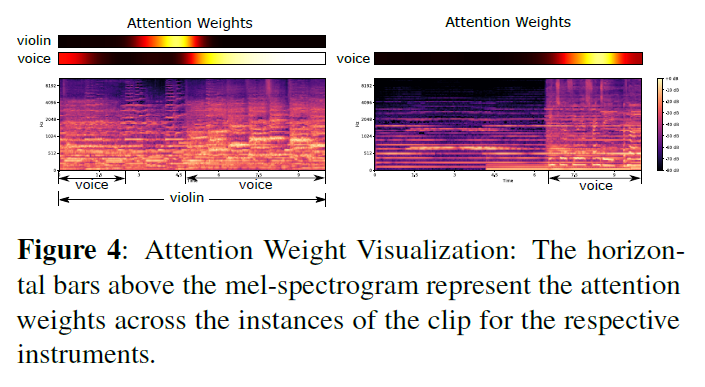

In the image on the left we can see the attention weights of the violin and the voice. The model has detected a voice source in the first seconds of the clip and about the end. (Black weights means absence of the instrument). And, for the violin, it has been detected in the middle of the clip, because that is the section where the violin is the predominant instrument.

In [ ]:
compute_metrics_1result(attention_pruebas_results)

mAP: 0.8021499999999999
F1:  0.7531500000000001
Acc: 0.8201


In [ ]:
## ATTENTION using all 10 seconds!
from tensorflow import keras
#import tf.keras.Sequential
from keras.models import Sequential
from keras.layers import Dense, Dropout
from keras.models import Model
from keras.optimizers import gradient_descent_v2
#from keras.optimizers import SGD
#from tensorflow.keras.optimizers import SGD
from sklearn import preprocessing
from sklearn.metrics import confusion_matrix
import seaborn as sns
import matplotlib.pyplot as plt
%matplotlib inline

from pandas import read_csv
import numpy as np
import scipy as sc
from keras import Model
from keras.layers import Layer
import keras.backend as K
from keras.layers import Input, Dense, SimpleRNN
from sklearn.preprocessing import MinMaxScaler
from keras.models import Sequential
from keras.metrics import mean_squared_error
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import average_precision_score

from numpy import array
from numpy import random
from numpy import dot
from scipy.special import softmax
import tensorflow as tf

# This dictionary will include the classifiers for each model
models_ = dict()
histories = dict()
#attention_results_under = dict()
#attention_results_over = dict()
#attention_only_results = dict()
#attention_results = dict()
attention_pruebas_results = dict()

# We'll iterate over all istrument classes, and fit a model for each one
# After training, we'll print a classification report for each instrument
for instrument in class_map:
    
    # Map the instrument name to its column number
    inst_num = class_map[instrument]
        
    # Step 1: sub-sample the data
    
    # First, we need to select down to the data for which we have annotations
    # This is what the mask arrays are for
    train_inst = Y_mask_train[:, inst_num]
    test_inst = Y_mask_test[:, inst_num]
    
    # Here, we're using the Y_mask_train array to slice out only the training examples
    # for which we have annotations for the given class
    X_train_inst = X_train[train_inst]
    
    # Step 3: simplify the data by averaging over time  XXXXXXX1
    
    # Instead of having time-varying features, we'll summarize each track by its mean feature vector over time
    # X_train_inst_sklearn = np.mean(X_train_inst, axis=1)
    # Reshape the 10*128 VGG features to a 1280 elements vector
    X_train_inst_sklearn = X_train_inst.reshape((X_train_inst.shape[0],X_train_inst.shape[1]*X_train_inst.shape[2]))
    
    
    # Again, we slice the labels to the annotated examples XXXXXXX2
    # We thresold the label likelihoods at 0.5 to get binary labels
    Y_true_train_inst = Y_true_train[train_inst, inst_num] >= 0.5
    #Y_true_train_inst = Y_true_train[train_inst, inst_num] 

    """
    #balanced_indices = get_balanced_indeces_undersample(Y_true_train_inst)
    balanced_indices = get_balanced_indeces_oversample(Y_true_train_inst)
    

    # Downsample most common class
    Y_true_train_inst = Y_true_train_inst[balanced_indices] 
    X_train_inst = X_train_inst[balanced_indices] 
    """
    
    # Repeat the above slicing and dicing but for the test set XXXXXXX2
    X_test_inst = X_test[test_inst]
    #X_test_inst_sklearn = np.mean(X_test_inst, axis=1)
    X_test_inst_sklearn = X_test_inst.reshape((X_test_inst.shape[0],X_test_inst.shape[1]*X_test_inst.shape[2]))
    Y_true_test_inst = Y_true_test[test_inst, inst_num] >= 0.5
    #Y_true_test_inst = Y_true_test[test_inst, inst_num]


    

    ### Normalize input data for the Network
    X_train_inst_sklearn_norm = X_train_inst / 255
    X_test_inst_sklearn_norm = X_test_inst / 255

    print(X_train_inst.shape)
    print(X_train_inst_sklearn_norm.shape)

    from keras.layers import Attention
    from keras.layers import MultiHeadAttention

    from tensorflow.keras import models, layers
    #sequence_length = 10
    

    model_input = layers.Input(shape=(10,128))

    queries = layers.Dense(128, activation="relu")(model_input)
    keys = layers.Dense(128, activation="relu")(model_input)
    values = layers.Dense(128, activation="relu")(model_input)

    attention, attention_score = layers.Attention()(
        [queries, keys, values], 
        return_attention_scores=True
    )
    flatten = layers.Flatten()(attention)
    dense = layers.Dense(1, activation="sigmoid")(flatten)

    model = models.Model(model_input, dense)
    model.summary()

    attention_model = models.Model(model_input, attention)
    attention_score_model = models.Model(model_input, attention_score)

    sgd = gradient_descent_v2.SGD(learning_rate=0.005, decay=1e-6, momentum=0.7, nesterov=True)

    model.compile(loss='binary_crossentropy',
                  optimizer=sgd,
                  metrics=['accuracy'])


  
    

    history = model.fit(X_train_inst_sklearn_norm, Y_true_train_inst, 
                                  epochs=60, 
                                  batch_size=64,
                                  validation_data=(X_test_inst_sklearn_norm, Y_true_test_inst), 
                                  verbose=2)

    
    # Finally, we'll evaluate the model on both train and test
    Y_pred_train = model.predict(X_train_inst_sklearn_norm)
    Y_pred_test = model.predict(X_test_inst_sklearn_norm)

    y_true_ = Y_true_test_inst > 0.5
    threshold = 0.5
    y_pred_ = Y_pred_test > threshold

    

    # Store the classifier in our dictionary
    models_[instrument] = model
    histories[instrument] = history
    results = dict()
    results["Y_true_train"] = Y_true_train_inst
    results["Y_pred_train"] = (Y_pred_train).T
    results["Y_true_test"] = Y_true_test_inst
    results["Y_pred_test"] = (Y_pred_test).T
    # Store test accuracy with format [ Accuracy, threshold_accuracy ]
    results["Accuracy"] = [accuracy_score(y_true_, y_pred_).round(3), threshold]
    # Store test f1 with format [ F1, threshold_accuracy ]
    results["F1"] = [f1_score(y_true_, y_pred_, zero_division=1).round(3), threshold]
    results["AP"] = average_precision_score(y_true_, Y_pred_test).round(3)

    results["attention_model"] = models.Model(model_input, attention)
    results["attention_score_model"] = models.Model(model_input, attention_score)
    
    #attention_results[instrument] = results
    #attention_only_results[instrument] = results
    attention_pruebas_results[instrument] = results

(1533, 10, 128)
(1533, 10, 128)
Model: "model_60"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_21 (InputLayer)          [(None, 10, 128)]    0           []                               
                                                                                                  
 dense_80 (Dense)               (None, 10, 128)      16512       ['input_21[0][0]']               
                                                                                                  
 dense_81 (Dense)               (None, 10, 128)      16512       ['input_21[0][0]']               
                                                                                                  
 dense_82 (Dense)               (None, 10, 128)      16512       ['input_21[0][0]']               
                                                           

1/1 [==============================] - 0s 49ms/step


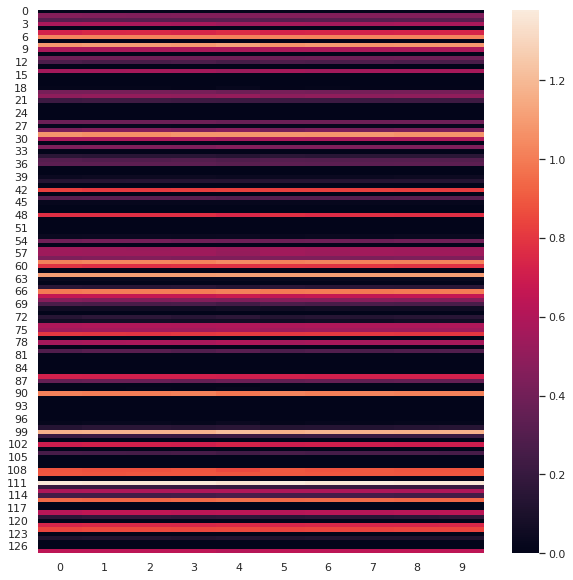

(10, 128)
Raw  [0.28426808 0.2858582  0.28600186 0.28483936 0.28568822 0.28394508
 0.2844668  0.28375685 0.2843626  0.2848068 ]
Normalized:  [0.22771804 0.9360149  1.         0.48218507 0.8602947  0.08384442
 0.31623524 0.         0.26982608 0.46767557]


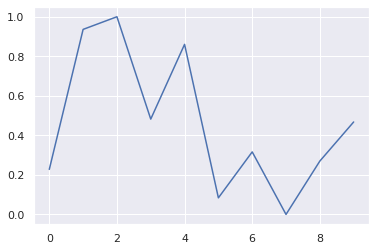

In [ ]:
import random
def plot_attention(sample,model):
    import seaborn as sns
    import matplotlib.pylab as plt

    
    
    sample = np.array([sample])
    """
    plt.figure(figsize=(10,10))
    #plt.subplot(1, 2, 1)
    attention_score = attention_score_model.predict(sample)[0]
    plt.imshow(attention_score, cmap="inferno")
    plt.show()
    """
    attention_model = model
    #plt.subplot(1, 2, 2)
    plt.figure(1,figsize=(10,10))
    attention = attention_model.predict(sample)[0]
    ax = sns.heatmap(attention.T)
    plt.show()
    """
    plt.imshow(attention.T
               , cmap="inferno"
               #, aspect="auto"
               )"""
    print(attention.shape)
    #print(attention[:,5])
    print("Raw ",np.mean(attention,axis=1))
    at_mean = np.mean(attention,axis=1)
    at_mean = at_mean - min(at_mean)
    at_mean = at_mean/max(at_mean)
    print("Normalized: ", at_mean)
    
    plt.show()
    plt.close()
    plt.figure(2)
    plt.plot(at_mean
               #, cmap="inferno"
               #, aspect="auto"
               )

def plot_instruments(sample):
  #indices = []
  instruments = []
  for i in range(0,20):
    if Y_true[sample,i] > 0.5:
      keys = [k for k, v in class_map.items() if v == i]
      #indices.append(i)
      instruments.append(keys[0])
  print(instruments)
  
  
#sample = random.choice(x_train)
#plot_attention(sample)

number = X_test_inst_sklearn_norm.shape[0]
index_sample = random.randint(0,number)
index_sample = 158
sample = X_test_inst_sklearn_norm[index_sample]
plot_attention(sample,attention_pruebas_results["voice"]["attention_model"])

In [ ]:
instrument = "voice"
inst_num = class_map[instrument]

query_indexes = []

for i in range(0,20000):
  if Y_true[i, inst_num] == 1 and len(Y_true[i][Y_true[i]>0.5]) > 1:
    query_indexes.append(i)

print("Samples length: ",len(query_indexes))
sample = random.choice(query_indexes)
print(sample)
print(sample_key[sample])
#print(sample_key[14280])
# Sample 14280 contains voice during all 10 seconds excepting seconds from 2 to 6


Samples length:  73
1282
012045_42240


In [ ]:
index_sample = 14280
index_sample = random.choice(query_indexes)
print(index_sample)
print(sample_key[index_sample])
plot_instruments(index_sample)


10903
083188_46080
['drums', 'voice']


VOICE
1/1 [==============================] - 0s 36ms/step
(10, 128)
Raw  [0.27371666 0.27392828 0.27321517 0.27358818 0.27382615 0.2737242
 0.27391613 0.27396712 0.27384987 0.27368808]
Normalized:  [0.6669177  0.94835716 0.         0.49605644 0.8125322  0.67694503
 0.9321866  1.         0.8440807  0.6289089 ]


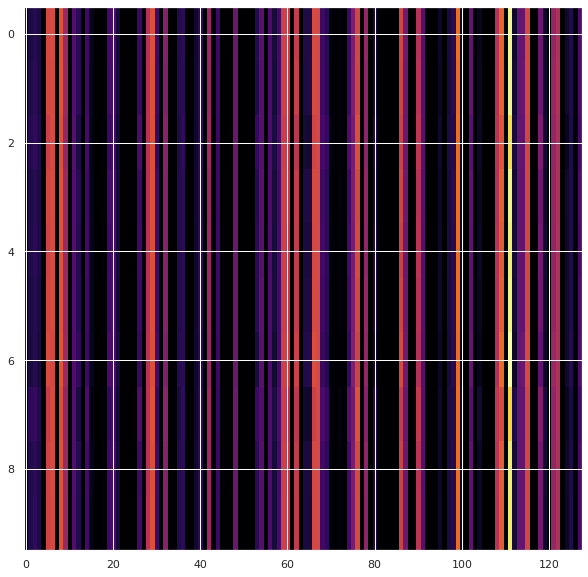

DRUMS


1/1 [==============================] - 0s 217ms/step
(10, 128)
Raw  [0.28332895 0.2846774  0.28591242 0.28628284 0.28413537 0.284644
 0.28350204 0.2870779  0.28591207 0.2875003 ]
Normalized:  [0.         0.32326192 0.61933887 0.70813835 0.19332413 0.31526002
 0.04149549 0.8987404  0.6192531  1.        ]


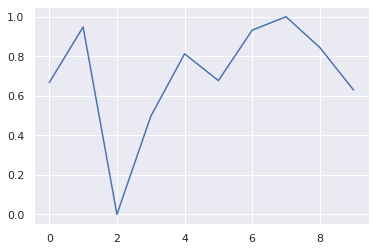

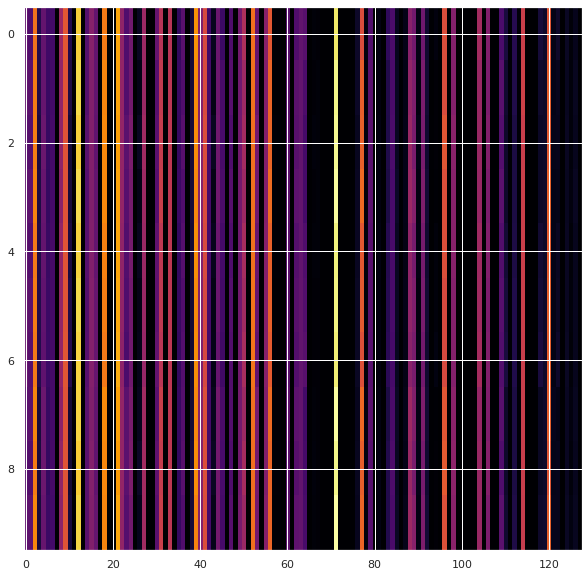

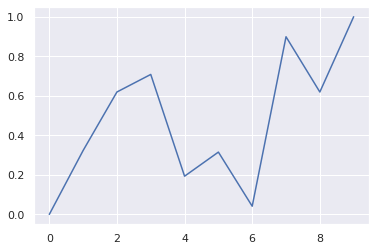

In [ ]:
sample = X[index_sample]/255
print("VOICE")
plot_attention(sample,attention_pruebas_results["voice"]["attention_model"])
print("DRUMS")
plot_attention(sample,attention_pruebas_results["drums"]["attention_model"])
#print("synthesizer")
#plot_attention(sample,attention_pruebas_results["synthesizer"]["attention_model"])

12097
093684_157440
1/1 [==============================] - 0s 16ms/step
(10, 128)
Raw  [0.37132812 0.37177038 0.3711064  0.3710139  0.37099773 0.3710186
 0.37056166 0.3714096  0.37097397 0.37097353]
Normalized:  [0.63410425 1.         0.45066324 0.37415552 0.3607673  0.37802652
 0.         0.7015139  0.34111643 0.34074658]


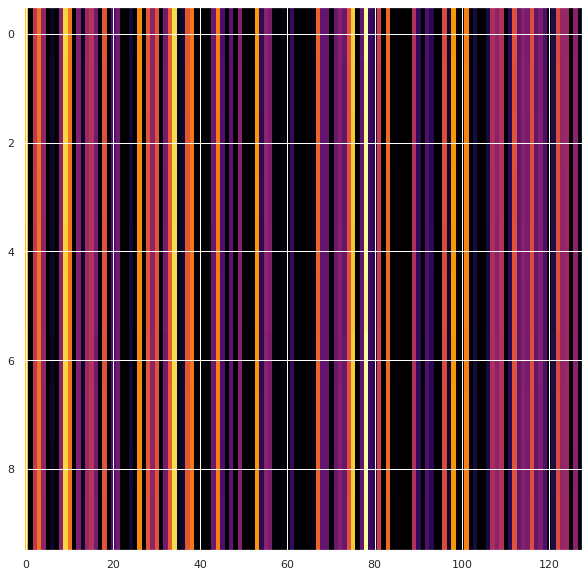

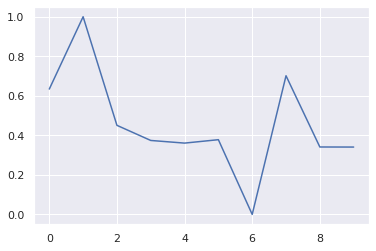

In [ ]:
index_sample = 14280
index_sample = random.choice(query_indexes)
print(index_sample)
print(sample_key[index_sample])
sample = X[index_sample]/255
plot_attention(sample)

1/1 [==============================] - 0s 30ms/step
(10, 128)
1/1 [==============================] - 0s 33ms/step


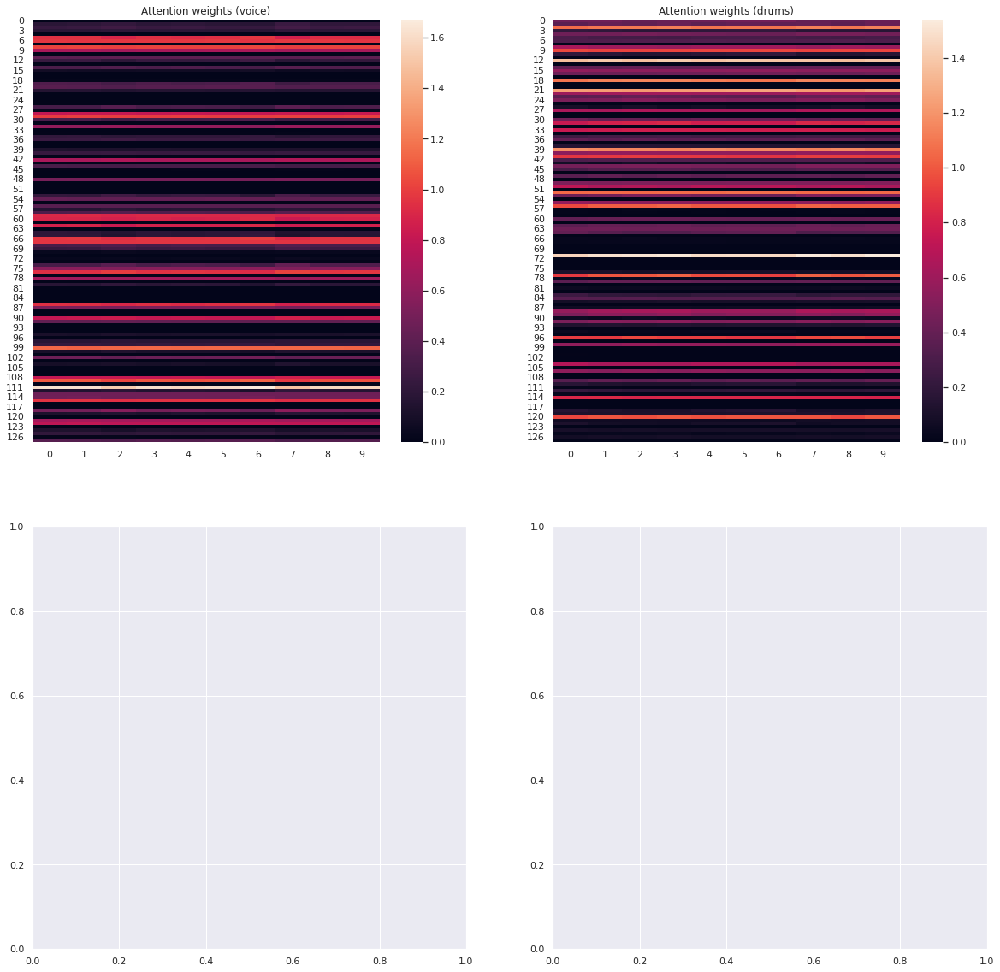

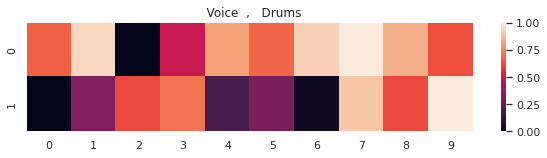

In [ ]:
import seaborn as sns
import matplotlib.pylab as plt


attention_model = attention_pruebas_results["voice"]["attention_model"]
index_sample = X[10903]/255
sample = np.array([index_sample])



fig,axes = plt.subplots(nrows=2,ncols=2,sharex=False,sharey=False,figsize=(20,20))
#axes[x,y].set_title(keys)
#print(keys)
attention = attention_model.predict(sample)[0]
sns.heatmap(attention.T,ax=axes[0,0])
axes[0,0].set_title("Attention weights (voice)")
"""
sns.heatmap(attention.T, annot=True,  fmt='d', 
            #cmap=plt.cm.Blues, 
            #cbar=False, 
            ax=axes[0,0])
"""



"""
plt.figure(figsize=(10,10))
#plt.subplot(1, 2, 1)
attention_score = attention_score_model.predict(sample)[0]
plt.imshow(attention_score, cmap="inferno")
plt.show()

#attention_model = model

plt.subplot(1, 2, 2)
plt.figure(1,figsize=(10,10))
attention = attention_model.predict(sample)[0]
ax = sns.heatmap(attention.T)
plt.show()
"""
"""
plt.imshow(attention.T
            , cmap="inferno"
            #, aspect="auto"
            )"""
print(attention.shape)
#print(attention[:,5])
#print("Raw ",np.mean(attention,axis=1))
at_mean_voice = np.mean(attention,axis=1)
at_mean_voice = at_mean_voice - min(at_mean_voice)
at_mean_voice = at_mean_voice/max(at_mean_voice)
"""
#print("Normalized: ", at_mean_voice)

plt.show()
plt.close()
plt.figure(2)
plt.plot(at_mean_voice
            #, cmap="inferno"
            #, aspect="auto"
            )
"""


attention_model = attention_pruebas_results["drums"]["attention_model"]
attention = attention_model.predict(sample)[0]

#fig,axes = plt.subplots(nrows=2,ncols=2,sharex=False,sharey=False,figsize=(20,20))
#axes[x,y].set_title(keys)
#print(keys)
sns.heatmap(attention.T,ax=axes[0,1])
axes[0,1].set_title("Attention weights (drums)")


######################
#sns.heatmap(at_mean_voice)

at_mean_drums = np.mean(attention,axis=1)
at_mean_drums = at_mean_drums - min(at_mean_drums)
at_mean_drums = at_mean_drums/max(at_mean_drums)

at_tuple = [at_mean_voice,at_mean_drums]
#sns.heatmap(at_tuple)
plt.figure(2,figsize=(10, 2))
ax = sns.heatmap(at_tuple,square=False)
#ax.set_size(10,5)
ax.set_title("    Voice  ,   Drums  ")
#ax.set(ylabel=["Voice","Drums"])
plt.show()

## **5- BEST MODELS**

Plots our model instrument-wise f1-score

Best F1 models
accordion :  Attention  ->  0.552
banjo :  Attention  ->  0.637
bass :  Attention  ->  0.693
cello :  LSTM  ->  0.79
clarinet :  Attention  ->  0.476
cymbals :  FFN  ->  0.962
drums :  CNN_threshold_acc  ->  0.936
flute :  Attention  ->  0.58
guitar :  Attention  ->  0.976
mallet_percussion :  FFN_mean_vector  ->  0.766
mandolin :  CNN_undersampling  ->  0.642
organ :  CNN_oversampling  ->  0.583
piano :  Attention  ->  0.964
saxophone :  FFN_mean_vector  ->  0.827
synthesizer :  CNN_threshold_acc  ->  0.968
trombone :  FFN_mean_vector  ->  0.71
trumpet :  FFN_mean_vector  ->  0.749
ukulele :  FFN  ->  0.66
violin :  CNN_threshold_acc  ->  0.887
voice :  Attention  ->  0.947


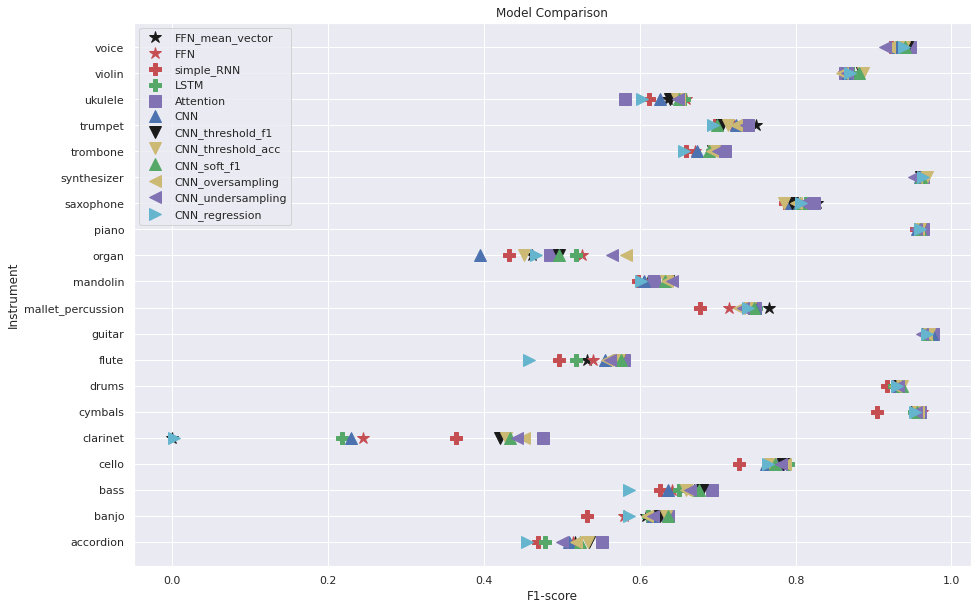

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import average_precision_score

def f1_to_list(results, n_experiments):
  
  final_list = []
  for instrument in class_map:
    inst_num = class_map[instrument]
    
    #acc_list = []
    #AP_list = []
    F1_list = []
    for t in range (0,n_experiments):
      if n_experiments == 1:
        result = results[instrument]
      else:
        result = results[instrument][t]
      Y_true = result["Y_true_test"].round()
      Y_pred = result["Y_pred_test"][0]
      y_pred_ = Y_pred > 0.5

      #acc_list.append(accuracy_score(Y_true, y_pred_).round(3))
      F1_list.append(f1_score(Y_true, y_pred_, zero_division=1).round(3))
      #AP_list.append(average_precision_score(Y_true, Y_pred).round(3))
    #inst_dict["Accuracy"] = acc_list
    #inst_dict["F1"] = F1_list
    #inst_dict["AP"] = AP_list
    #inst_dict["Accuracy"] = np.mean(acc_list)
    #inst_dict["F1"] = np.mean(F1_list)
    #inst_dict["AP"] = np.mean(AP_list)
    final_list.append(np.mean(F1_list).round(3))
  
  return final_list

accuracy_FFN_mean_vector = f1_to_list(classification_accuracy_results, 5)
accuracy_FFN = f1_to_list(classification_accuracy_results_10s, 5)
accuracy_simple_RNN = f1_to_list(recurrent_simpleRNN_results, 5)
accuracy_LSTM = f1_to_list(recurrent_LSTM_results, 5)
accuracy_attention = f1_to_list(attention_pruebas_results, 1)
accuracy_CNN = f1_to_list(CNN_results, 4)
accuracy_CNN_threshold_f1 = f1_to_list(CNN_f1_thresholding_results, 4)
accuracy_CNN_threshold_accuracy = f1_to_list(CNN_thresholding_results, 4)
accuracy_CNN_soft_f1 = f1_to_list(CNN_f1_results, 4)
accuracy_CNN_oversampling = f1_to_list(CNN_oversample_results, 4)
accuracy_CNN_unersampling = f1_to_list(CNN_undersample_results, 4)
accuracy_CNN_regression = f1_to_list(CNN_reg_results, 5)

import pandas as pd
import seaborn as sns

def compare(list1, list2, list3, list4, list5, list6, list7, list8, list9, list10, list11, list12):
  #df = pd.DataFrame()
  print("Best F1 models")
  for instrument in class_map:
    inst_num = class_map[instrument]
    maximum = max(list1[inst_num], list2[inst_num], list3[inst_num], list4[inst_num], list5[inst_num], list6[inst_num], list7[inst_num], list8[inst_num], list9[inst_num], list10[inst_num], list11[inst_num], list12[inst_num])
    name = ""
    #df[instrument] = [list1[inst_num], list2[inst_num], list3[inst_num], list4[inst_num], list5[inst_num], list6[inst_num]]
    if maximum == list1[inst_num]:
      name = "FFN_mean_vector"     
    elif maximum == list2[inst_num]:
      name = "FFN"
    elif maximum == list3[inst_num]:
      name = "simple_RNN"
    elif maximum == list4[inst_num]:
      name = "LSTM"
    elif maximum == list5[inst_num]:
      name = "Attention"
    elif maximum == list6[inst_num]:
      name = "CNN"
    elif maximum == list7[inst_num]:
      name = "CNN_threshold_f1"
    elif maximum == list8[inst_num]:
      name = "CNN_threshold_acc"
    elif maximum == list9[inst_num]:
      name = "CNN_soft_f1"
    elif maximum == list10[inst_num]:
      name = "CNN_oversampling"
    elif maximum == list11[inst_num]:
      name = "CNN_undersampling"
    elif maximum == list12[inst_num]:
      name = "CNN_regression"
    
    print(instrument, ": ", name, " -> ", maximum)


  import matplotlib.pyplot as plt
  import numpy as np




  #################
  plt.figure(figsize=(15,10))
  sns.set(style="darkgrid")
  plt.plot(list1, list(class_map.keys()),'k*', label="FFN_mean_vector", markersize=12)
  plt.plot(list2, list(class_map.keys()),'r*', label="FFN", markersize=12)
  plt.plot(list3, list(class_map.keys()),'rP', label="simple_RNN", markersize=12)
  plt.plot(list4, list(class_map.keys()),'gP', label="LSTM", markersize=12)
  plt.plot(list5, list(class_map.keys()),'ms', label="Attention", markersize=12)
  plt.plot(list6, list(class_map.keys()),'b^', label="CNN", markersize=12)
  plt.plot(list7, list(class_map.keys()),'kv', label="CNN_threshold_f1", markersize=12)
  plt.plot(list8, list(class_map.keys()),'yv', label="CNN_threshold_acc", markersize=12)
  plt.plot(list9, list(class_map.keys()),'g^', label="CNN_soft_f1", markersize=12)
  plt.plot(list10, list(class_map.keys()),'y<', label="CNN_oversampling", markersize=12)
  plt.plot(list11, list(class_map.keys()),'m<', label="CNN_undersampling", markersize=12)
  plt.plot(list12, list(class_map.keys()),'c>', label="CNN_regression", markersize=12)

  
  plt.xlabel("F1-score")
  plt.ylabel('Instrument')
  plt.title("Model Comparison")
  plt.legend()
  plt.show()

compare(accuracy_FFN_mean_vector,accuracy_FFN ,accuracy_simple_RNN ,accuracy_LSTM ,accuracy_attention ,accuracy_CNN ,accuracy_CNN_threshold_f1 ,accuracy_CNN_threshold_accuracy ,accuracy_CNN_soft_f1 ,accuracy_CNN_oversampling ,accuracy_CNN_unersampling ,accuracy_CNN_regression)


Plots our model instrument-wise accuracy

Best ACCURACY models
accordion :  CNN_regression  ->  0.825
banjo :  FFN_mean_vector  ->  0.781
bass :  Attention  ->  0.834
cello :  FFN_mean_vector  ->  0.797
clarinet :  LSTM  ->  0.792
cymbals :  FFN  ->  0.947
drums :  CNN_threshold_acc  ->  0.913
flute :  Attention  ->  0.753
guitar :  Attention  ->  0.968
mallet_percussion :  FFN_mean_vector  ->  0.788
mandolin :  FFN  ->  0.751
organ :  CNN_threshold_f1  ->  0.772
piano :  Attention  ->  0.949
saxophone :  FFN_mean_vector  ->  0.823
synthesizer :  CNN_threshold_acc  ->  0.954
trombone :  FFN_mean_vector  ->  0.821
trumpet :  FFN_mean_vector  ->  0.793
ukulele :  Attention  ->  0.785
violin :  CNN_threshold_acc  ->  0.851
voice :  Attention  ->  0.936


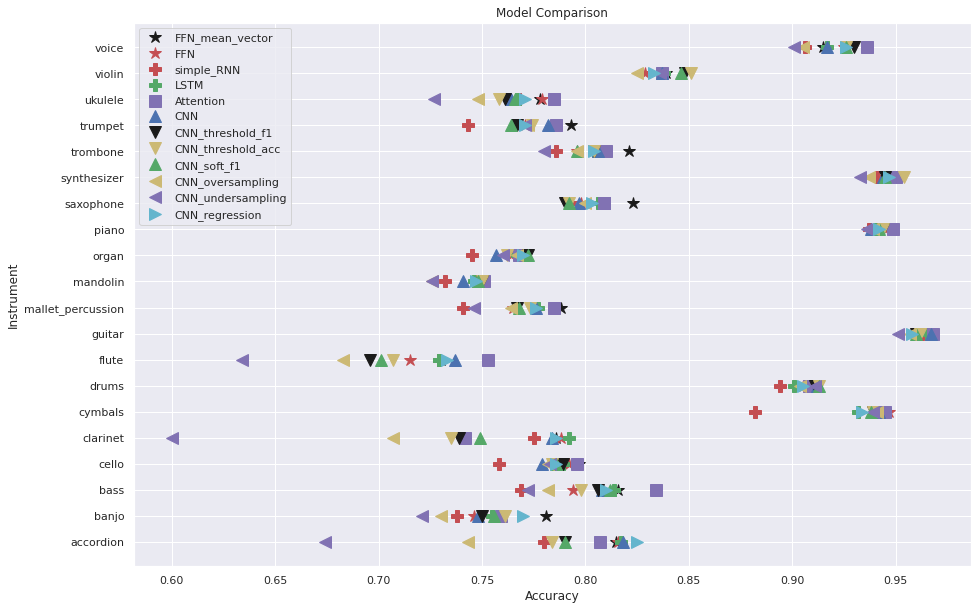

In [ ]:
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import average_precision_score

def accuracy_to_list(results, n_experiments):
  
  final_list = []
  for instrument in class_map:
    inst_num = class_map[instrument]
    
    acc_list = []
    #AP_list = []
    #F1_list = []
    for t in range (0,n_experiments):
      if n_experiments == 1:
        result = results[instrument]
      else:
        result = results[instrument][t]
      Y_true = result["Y_true_test"].round()
      Y_pred = result["Y_pred_test"][0]
      y_pred_ = Y_pred > 0.5

      acc_list.append(accuracy_score(Y_true, y_pred_).round(3))
      #F1_list.append(f1_score(Y_true, y_pred_, zero_division=1).round(3))
      #AP_list.append(average_precision_score(Y_true, Y_pred).round(3))
    #inst_dict["Accuracy"] = acc_list
    #inst_dict["F1"] = F1_list
    #inst_dict["AP"] = AP_list
    #inst_dict["Accuracy"] = np.mean(acc_list)
    #inst_dict["F1"] = np.mean(F1_list)
    #inst_dict["AP"] = np.mean(AP_list)
    final_list.append(np.mean(acc_list).round(3))
  
  return final_list

accuracy_FFN_mean_vector = accuracy_to_list(classification_accuracy_results, 5)
accuracy_FFN = accuracy_to_list(classification_accuracy_results_10s, 5)
accuracy_simple_RNN = accuracy_to_list(recurrent_simpleRNN_results, 5)
accuracy_LSTM = accuracy_to_list(recurrent_LSTM_results, 5)
accuracy_attention = accuracy_to_list(attention_pruebas_results, 1)
accuracy_CNN = accuracy_to_list(CNN_results, 4)
accuracy_CNN_threshold_f1 = accuracy_to_list(CNN_f1_thresholding_results, 4)
accuracy_CNN_threshold_accuracy = accuracy_to_list(CNN_thresholding_results, 4)
accuracy_CNN_soft_f1 = accuracy_to_list(CNN_f1_results, 4)
accuracy_CNN_oversampling = accuracy_to_list(CNN_oversample_results, 4)
accuracy_CNN_unersampling = accuracy_to_list(CNN_undersample_results, 4)
accuracy_CNN_regression = accuracy_to_list(CNN_reg_results, 5)

import pandas as pd
import seaborn as sns

def compare(list1, list2, list3, list4, list5, list6, list7, list8, list9, list10, list11, list12):
  #df = pd.DataFrame()
  print("Best ACCURACY models")
  for instrument in class_map:
    inst_num = class_map[instrument]
    maximum = max(list1[inst_num], list2[inst_num], list3[inst_num], list4[inst_num], list5[inst_num], list6[inst_num], list7[inst_num], list8[inst_num], list9[inst_num], list10[inst_num], list11[inst_num], list12[inst_num])
    name = ""
    #df[instrument] = [list1[inst_num], list2[inst_num], list3[inst_num], list4[inst_num], list5[inst_num], list6[inst_num]]
    if maximum == list1[inst_num]:
      name = "FFN_mean_vector"     
    elif maximum == list2[inst_num]:
      name = "FFN"
    elif maximum == list3[inst_num]:
      name = "simple_RNN"
    elif maximum == list4[inst_num]:
      name = "LSTM"
    elif maximum == list5[inst_num]:
      name = "Attention"
    elif maximum == list6[inst_num]:
      name = "CNN"
    elif maximum == list7[inst_num]:
      name = "CNN_threshold_f1"
    elif maximum == list8[inst_num]:
      name = "CNN_threshold_acc"
    elif maximum == list9[inst_num]:
      name = "CNN_soft_f1"
    elif maximum == list10[inst_num]:
      name = "CNN_oversampling"
    elif maximum == list11[inst_num]:
      name = "CNN_undersampling"
    elif maximum == list12[inst_num]:
      name = "CNN_regression"
    
    print(instrument, ": ", name, " -> ", maximum)


  import matplotlib.pyplot as plt
  import numpy as np




  #################
  plt.figure(figsize=(15,10))
  sns.set(style="darkgrid")
  plt.plot(list1, list(class_map.keys()),'k*', label="FFN_mean_vector", markersize=12)
  plt.plot(list2, list(class_map.keys()),'r*', label="FFN", markersize=12)
  plt.plot(list3, list(class_map.keys()),'rP', label="simple_RNN", markersize=12)
  plt.plot(list4, list(class_map.keys()),'gP', label="LSTM", markersize=12)
  plt.plot(list5, list(class_map.keys()),'ms', label="Attention", markersize=12)
  plt.plot(list6, list(class_map.keys()),'b^', label="CNN", markersize=12)
  plt.plot(list7, list(class_map.keys()),'kv', label="CNN_threshold_f1", markersize=12)
  plt.plot(list8, list(class_map.keys()),'yv', label="CNN_threshold_acc", markersize=12)
  plt.plot(list9, list(class_map.keys()),'g^', label="CNN_soft_f1", markersize=12)
  plt.plot(list10, list(class_map.keys()),'y<', label="CNN_oversampling", markersize=12)
  plt.plot(list11, list(class_map.keys()),'m<', label="CNN_undersampling", markersize=12)
  plt.plot(list12, list(class_map.keys()),'c>', label="CNN_regression", markersize=12)

  
  plt.xlabel("Accuracy")
  plt.ylabel('Instrument')
  plt.title("Model Comparison")
  plt.legend()
  plt.show()

compare(accuracy_FFN_mean_vector,accuracy_FFN ,accuracy_simple_RNN ,accuracy_LSTM ,accuracy_attention ,accuracy_CNN ,accuracy_CNN_threshold_f1 ,accuracy_CNN_threshold_accuracy ,accuracy_CNN_soft_f1 ,accuracy_CNN_oversampling ,accuracy_CNN_unersampling ,accuracy_CNN_regression)


Plot our model mAP and overall F1-score

In [ ]:
compute_mAP(CNN_results,3).round(3)


mAP: 0.7951666666666666


0.795

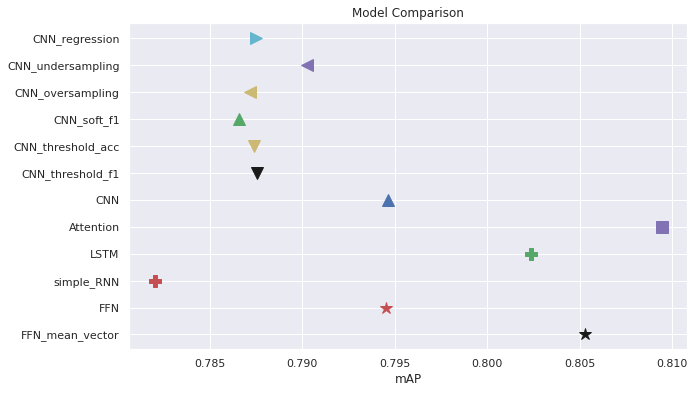

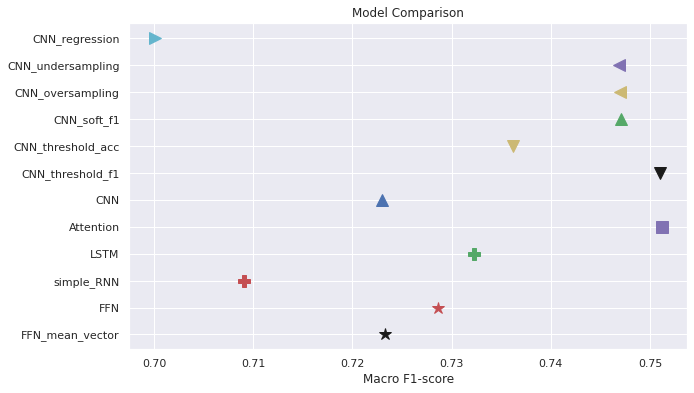

In [ ]:
def compute_mAP(results,n_experiments):
  AP = []
  for instrument in class_map:
    AP_ = []
    for t in range (0,n_experiments):
      if n_experiments == 1:
        AP_.append(results[instrument]["AP"])
      else: 
        AP_.append(results[instrument][t]["AP"])
    AP.append(np.mean(AP_))
  #print("mAP:", np.mean(AP))
  return np.mean(AP)

def compute_F1(results,n_experiments):
  F1 = []
  for instrument in class_map:
    F1_ = []
    for t in range (0,n_experiments):
      if n_experiments == 1:
        F1_.append(results[instrument]["F1"][0])
      else: 
        F1_.append(results[instrument][t]["F1"][0])
    F1.append(np.mean(F1_))
  #print("F1:", np.mean(F1))
  return np.mean(F1)

map1 = compute_mAP(classification_accuracy_results, 5)
map2 = compute_mAP(classification_accuracy_results_10s, 5)
map3 = compute_mAP(recurrent_simpleRNN_results, 5)
map4 = compute_mAP(recurrent_LSTM_results, 5)
map5 = compute_mAP(attention_pruebas_results, 1)
map6 = compute_mAP(CNN_results, 4)
map7 = compute_mAP(CNN_f1_thresholding_results, 4)
map8 = compute_mAP(CNN_thresholding_results, 4)
map9 = compute_mAP(CNN_f1_results, 4)
map10 = compute_mAP(CNN_oversample_results, 4)
map11 = compute_mAP(CNN_undersample_results, 4)
map12 = compute_mAP(CNN_reg_results, 5)

f1 = compute_F1(classification_accuracy_results, 5)
f2 = compute_F1(classification_accuracy_results_10s, 5)
f3 = compute_F1(recurrent_simpleRNN_results, 5)
f4 = compute_F1(recurrent_LSTM_results, 5)
f5 = compute_F1(attention_pruebas_results, 1)
f6 = compute_F1(CNN_results, 4)
f7 = compute_F1(CNN_f1_thresholding_results, 4)
f8 = compute_F1(CNN_thresholding_results, 4)
f9 = compute_F1(CNN_f1_results, 4)
f10 = compute_F1(CNN_oversample_results, 4)
f11 = compute_F1(CNN_undersample_results, 4)
f12 = compute_F1(CNN_reg_results, 5)

import matplotlib.pyplot as plt
import numpy as np
import seaborn as sns




#################
plt.figure(figsize=(10,6))
sns.set(style="darkgrid")
plt.plot(map1, ["FFN_mean_vector"],'k*', label="FFN_mean_vector", markersize=12)
plt.plot(map2, ["FFN"],'r*', label="FFN", markersize=12)
plt.plot(map3, ["simple_RNN"],'rP', label="simple_RNN", markersize=12)
plt.plot(map4, ["LSTM"],'gP', label="LSTM", markersize=12)
plt.plot(map5, ["Attention"],'ms', label="Attention", markersize=12)
plt.plot(map6, ["CNN"],'b^', label="CNN", markersize=12)
plt.plot(map7, ["CNN_threshold_f1"],'kv', label="CNN_threshold_f1", markersize=12)
plt.plot(map8, ["CNN_threshold_acc"],'yv', label="CNN_threshold_acc", markersize=12)
plt.plot(map9, ["CNN_soft_f1"],'g^', label="CNN_soft_f1", markersize=12)
plt.plot(map10, ["CNN_oversampling"],'y<', label="CNN_oversampling", markersize=12)
plt.plot(map11, ["CNN_undersampling"],'m<', label="CNN_undersampling", markersize=12)
plt.plot(map12, ["CNN_regression"],'c>', label="CNN_regression", markersize=12)


plt.xlabel("mAP")
#plt.ylabel('Instrument')
plt.title("Model Comparison")
#plt.legend()
plt.show()

#################
plt.figure(figsize=(10,6))
sns.set(style="darkgrid")
plt.plot(f1, ["FFN_mean_vector"],'k*', label="FFN_mean_vector", markersize=12)
plt.plot(f2, ["FFN"],'r*', label="FFN", markersize=12)
plt.plot(f3, ["simple_RNN"],'rP', label="simple_RNN", markersize=12)
plt.plot(f4, ["LSTM"],'gP', label="LSTM", markersize=12)
plt.plot(f5, ["Attention"],'ms', label="Attention", markersize=12)
plt.plot(f6, ["CNN"],'b^', label="CNN", markersize=12)
plt.plot(f7, ["CNN_threshold_f1"],'kv', label="CNN_threshold_f1", markersize=12)
plt.plot(f8, ["CNN_threshold_acc"],'yv', label="CNN_threshold_acc", markersize=12)
plt.plot(f9, ["CNN_soft_f1"],'g^', label="CNN_soft_f1", markersize=12)
plt.plot(f10, ["CNN_oversampling"],'y<', label="CNN_oversampling", markersize=12)
plt.plot(f11, ["CNN_undersampling"],'m<', label="CNN_undersampling", markersize=12)
plt.plot(f12, ["CNN_regression"],'c>', label="CNN_regression", markersize=12)


plt.xlabel("Macro F1-score")
#plt.ylabel('Instrument')
plt.title("Model Comparison")
#plt.legend()
plt.show()

In [ ]:
def compute_F1(results,n_experiments):
  F1 = []
  for instrument in class_map:
    F1_ = []
    for t in range (0,n_experiments):
      if n_experiments == 1:
        F1_.append(results[instrument]["F1"][0])
      else: 
        F1_.append(results[instrument][t]["F1"][0])
    F1.append(np.mean(F1_))
  print("F1:", np.mean(F1))
  return np.mean(F1)

compute_F1(attention_pruebas_results,1)

F1: 0.7512


0.7512

Plot state-of-the-art F1 score and mAP

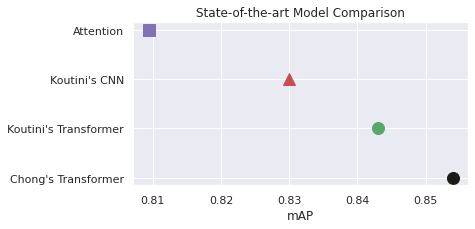

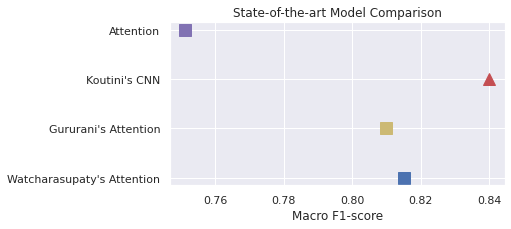

In [ ]:

# mAP

plt.figure(figsize=(6,3))
"""
plt.plot(0.854, ["Attention"], 'kP', label="Chong's Transformer", markersize=12)
plt.plot(0.843, ["Attention"], 'g*', label="Koutini's Transformer", markersize=12)
plt.plot(0.83,  ["Attention"],'r^', label="Koutini's CNN", markersize=12)
plt.plot(0.8094, ["Attention"], 'ms', label="Attention", markersize=12)

"""
plt.plot(0.854, ["Chong's Transformer"], 'ko', label="Chong's Transformer", markersize=12)
plt.plot(0.843, ["Koutini's Transformer"], 'go', label="Koutini's Transformer", markersize=12)
plt.plot(0.83, ["Koutini's CNN"], 'r^', label="Koutini's CNN", markersize=12)
plt.plot(0.8094, ["Attention"], 'ms', label="Attention", markersize=12)

plt.xlabel("mAP")
#plt.ylabel('Instrument')
plt.title("State-of-the-art Model Comparison")
#plt.legend()
plt.show()


plt.figure(figsize=(6,3))
plt.plot(0.815, ["Watcharasupaty's Attention"], 'bs', label="CNN_threshold_f1", markersize=12)
plt.plot(0.81, ["Gururani's Attention"], 'ys', label="Gururani's Attention", markersize=12)
plt.plot(0.84, ["Koutini's CNN"], 'r^', label="Koutini's CNN", markersize=12)
plt.plot(0.7512, ["Attention"], 'ms', label="Attention", markersize=12)

plt.xlabel("Macro F1-score")
#plt.ylabel('Instrument')
plt.title("State-of-the-art Model Comparison")
#plt.legend()
plt.show()

In [ ]:
accuracy_to_list(attention_pruebas_results,1)

[0.807,
 0.759,
 0.834,
 0.796,
 0.742,
 0.945,
 0.908,
 0.753,
 0.968,
 0.785,
 0.751,
 0.768,
 0.949,
 0.809,
 0.95,
 0.81,
 0.786,
 0.785,
 0.837,
 0.936]

In [ ]:
mm["voice"]["AP"]

[0.974, 0.979, 0.98, 0.976]

In [ ]:
# Plot F1


{'whiskers': [<matplotlib.lines.Line2D at 0x7f26cd3158b0>,
 'caps': [<matplotlib.lines.Line2D at 0x7f26cd3152e0>,
 'boxes': [<matplotlib.lines.Line2D at 0x7f26cd3155b0>],
 'medians': [<matplotlib.lines.Line2D at 0x7f26f04972b0>],
 'fliers': [<matplotlib.lines.Line2D at 0x7f26f0497550>],
 'means': []}

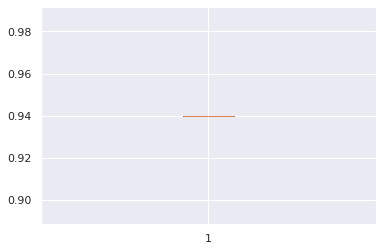

In [ ]:
plt.boxplot(mm["voice"]["F1"])

In [ ]:
# pruebaS
from sklearn.metrics import accuracy_score
from sklearn.metrics import f1_score
from sklearn.metrics import average_precision_score

"""
for instrument in class_map:
  

regression_results["voice"]["Y_pred_test"]
y_true_ = regression_results[instrument]["Y_true_test"].round()
Y_pred_test = regression_results[instrument]["Y_pred_test"][0]
y_pred_ = Y_pred_test > 0.5
#results["Accuracy"] = [accuracy_score(y_true_, y_pred_).round(3), threshold]
# Store test f1 with format [ F1, threshold_accuracy ]
#results["F1"] = [f1_score(y_true_, y_pred_, zero_division=1).round(3), threshold]
#results["AP"] = average_precision_score(y_true_, Y_pred_test).round(3)
print(accuracy_score(y_true_, y_pred_).round(3))
print(f1_score(y_true_, y_pred_, zero_division=1).round(3))
print(average_precision_score(y_true_, Y_pred_test).round(3))

results["Accuracy"] = [accuracy_score(y_true_, y_pred_).round(3), threshold]
# Store test f1 with format [ F1, threshold_accuracy ]
results["F1"] = [f1_score(y_true_, y_pred_, zero_division=1).round(3), threshold]
results["AP"] = average_precision_score(y_true_, Y_pred_test).round(3)
"""

def metrics_to_dict(results, n_experiments):
  result_dict = dict()

  for instrument in class_map:
    inst_num = class_map[instrument]
    inst_dict = dict()
    acc_list = []
    AP_list = []
    F1_list = []
    for t in range n_experiments:
      result = results[instrument][t]
      Y_true = result["Y_true_test"].round()
      Y_pred = result["Y_pred_test"][0]
      y_pred_ = Y_pred > 0.5

      acc_list.append(accuracy_score(Y_true, y_pred_).round(3))
      F1_list.append(f1_score(Y_true, y_pred_, zero_division=1).round(3))
      AP_list.append(average_precision_score(Y_true, Y_pred).round(3))
    inst_dict["Accuracy"] = acc_list
    inst_dict["F1"] = F1_list
    inst_dict["AP"] = AP_list
    result_dict[instrument] = inst_dict
  
  return result_dict

def get_accuracy(results, name):


  total = 0
  aciertos_total = 0
  accuracy_list = []
  for instrument in class_map:
    inst_num = class_map[instrument]
    result = results[instrument]
    aciertos_inst = 0
    total_inst = 0
    Y_true = result["Y_true_test"].round()
    if name == "RANDOM FOREST":
      Y_pred = result["Y_pred_test"].round()
    else:
      Y_pred = result["Y_pred_test"][0].round()

    #print(Y_true.shape[0])
    for i in range(0,Y_true.shape[0]):
      if Y_true[i] == Y_pred[i]:
        aciertos_total += 1
        aciertos_inst += 1
      total += 1
      total_inst += 1
    
    acc = round(aciertos_inst/total_inst,4)
    print("Accuracy ", instrument, ": ", acc)
    accuracy_list.append(acc)
  
  acc = round(aciertos_total/total,4)
  print("MEAN ACCURACY ", name, ": ", acc)
  print()
  print()
  return accuracy_list


accuracy_FFN_mean_vector = accuracy_to_list(classification_accuracy_results, 5)
accuracy_FFN = accuracy_to_list(classification_accuracy_results_10s, 5)
accuracy_simple_RNN = accuracy_to_list(recurrent_simpleRNN_results, 5)
accuracy_LSTM = accuracy_to_list(recurrent_LSTM_results, 5)
accuracy_attention = accuracy_to_list(attention_pruebas_results, 1)
accuracy_CNN = accuracy_to_list(CNN_results, 4)
accuracy_CNN_threshold_f1 = accuracy_to_list(CNN_f1_thresholding_results, 4)
accuracy_CNN_threshold_accuracy = accuracy_to_list(CNN_thresholding_results, 4)
accuracy_CNN_soft_f1 = accuracy_to_list(CNN_f1_results, 4)
accuracy_CNN_oversampling = accuracy_to_list(CNN_oversample_results, 4)
accuracy_CNN_unersampling = accuracy_to_list(CNN_undersample_results, 4)
accuracy_CNN_regression = accuracy_to_list(CNN_reg_results, 5)

import pandas as pd
import seaborn as sns

def compare(list1, list2, list3, list4, list5, list6, list7, list8, list9, list10, list11, list12):
  #df = pd.DataFrame()
  for instrument in class_map:
    inst_num = class_map[instrument]
    maximum = max(list1[inst_num], list2[inst_num], list3[inst_num], list4[inst_num], list5[inst_num], list6[inst_num], list7[inst_num], list8[inst_num], list9[inst_num], list10[inst_num], list11[inst_num], list12[inst_num])
    name = ""
    #df[instrument] = [list1[inst_num], list2[inst_num], list3[inst_num], list4[inst_num], list5[inst_num], list6[inst_num]]
    if maximum == list1[inst_num]:
      name = "FFN_mean_vector"
    elif maximum == list2[inst_num]:
      name = "FFN"
    elif maximum == list3[inst_num]:
      name = "simple_RNN"
    elif maximum == list4[inst_num]:
      name = "LSTM"
    elif maximum == list5[inst_num]:
      name = "Attention"
    elif maximum == list6[inst_num]:
      name = "CNN"
    elif maximum == list7[inst_num]:
      name = "CNN_threshold_f1"
    elif maximum == list8[inst_num]:
      name = "CNN_threshold_acc"
    elif maximum == list9[inst_num]:
      name = "CNN_soft_f1"
    elif maximum == list10[inst_num]:
      name = "CNN_oversampling"
    elif maximum == list11[inst_num]:
      name = "CNN_undersampling"
    elif maximum == list12[inst_num]:
      name = "CNN_regression"
    
    print(instrument, ": ", name, " -> ", maximum)


  import matplotlib.pyplot as plt
  import numpy as np




  #################
  plt.figure(figsize=(15,10))
  sns.set(style="darkgrid")
  plt.plot(list1, list(class_map.keys()),'k*', label="FFN_mean_vector", markersize=12)
  plt.plot(list2, list(class_map.keys()),'r*', label="FFN", markersize=12)
  plt.plot(list3, list(class_map.keys()),'go', label="simple_RNN", markersize=12)
  plt.plot(list4, list(class_map.keys()),'yo', label="LSTM", markersize=12)
  plt.plot(list5, list(class_map.keys()),'mo', label="Attention", markersize=12)
  plt.plot(list6, list(class_map.keys()),'b^', label="CNN", markersize=12)
  plt.plot(list7, list(class_map.keys()),'r^', label="CNN_threshold_f1", markersize=12)
  plt.plot(list8, list(class_map.keys()),'y^', label="CNN_threshold_acc", markersize=12)
  plt.plot(list9, list(class_map.keys()),'y^', label="CNN_soft_f1", markersize=12)
  plt.plot(list10, list(class_map.keys()),'y^', label="CNN_oversampling", markersize=12)
  plt.plot(list11, list(class_map.keys()),'y^', label="CNN_undersampling", markersize=12)
  plt.plot(list12, list(class_map.keys()),'y^', label="CNN_regression", markersize=12)

  
  plt.xlabel("Accuracy")
  plt.ylabel('Instrument')
  plt.title("Model Comparison")
  plt.legend()
  plt.show()

compare(accuracy_FFN_mean_vector,accuracy_FFN ,accuracy_simple_RNN ,accuracy_LSTM ,accuracy_attention ,accuracy_CNN ,accuracy_CNN_threshold_f1 ,accuracy_CNN_threshold_accuracy ,accuracy_CNN_soft_f1 ,accuracy_CNN_oversampling ,accuracy_CNN_unersampling ,accuracy_CNN_regression)


SyntaxError: ignored

Accuracy  accordion :  0.816
Accuracy  banjo :  0.7803
Accuracy  bass :  0.8056
Accuracy  cello :  0.8021
Accuracy  clarinet :  0.7859
Accuracy  cymbals :  0.9404
Accuracy  drums :  0.9127
Accuracy  flute :  0.7295
Accuracy  guitar :  0.961
Accuracy  mallet_percussion :  0.7657
Accuracy  mandolin :  0.7464
Accuracy  organ :  0.7726
Accuracy  piano :  0.9446
Accuracy  saxophone :  0.8124
Accuracy  synthesizer :  0.9526
Accuracy  trombone :  0.8097
Accuracy  trumpet :  0.7847
Accuracy  ukulele :  0.7746
Accuracy  violin :  0.8447
Accuracy  voice :  0.9198
MEAN ACCURACY  REGRESSION :  0.8238


Accuracy  accordion :  0.8271
Accuracy  banjo :  0.7678
Accuracy  bass :  0.7819
Accuracy  cello :  0.7959
Accuracy  clarinet :  0.7859
Accuracy  cymbals :  0.9289
Accuracy  drums :  0.9175
Accuracy  flute :  0.7117
Accuracy  guitar :  0.9564
Accuracy  mallet_percussion :  0.7887
Accuracy  mandolin :  0.7512
Accuracy  organ :  0.7633
Accuracy  piano :  0.947
Accuracy  saxophone :  0.8076
Accuracy  s

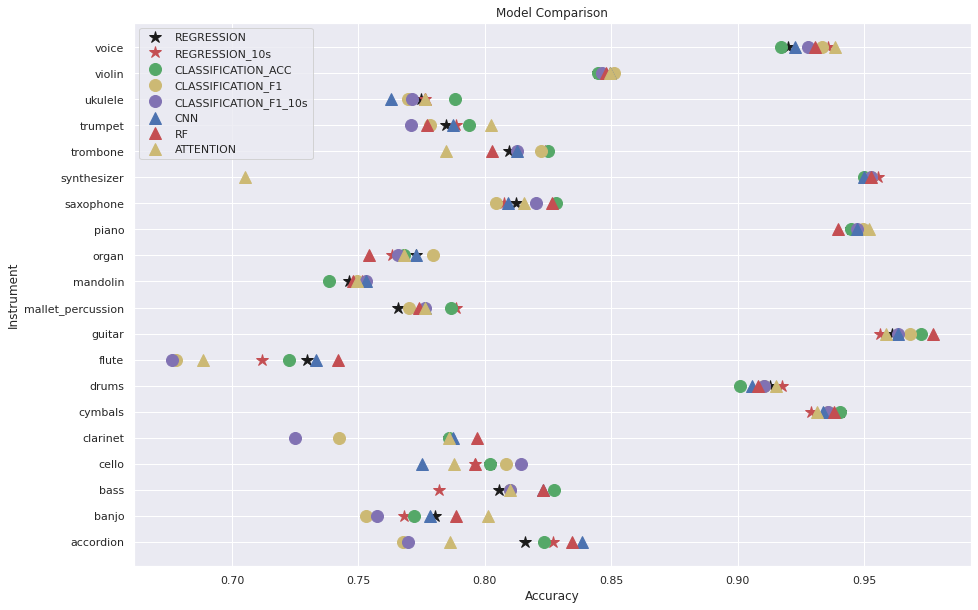

In [ ]:
def get_accuracy(results, name):
  total = 0
  aciertos_total = 0
  accuracy_list = []
  for instrument in class_map:
    inst_num = class_map[instrument]
    result = results[instrument]
    aciertos_inst = 0
    total_inst = 0
    Y_true = result["Y_true_test"].round()
    if name == "RANDOM FOREST":
      Y_pred = result["Y_pred_test"].round()
    else:
      Y_pred = result["Y_pred_test"][0].round()

    #print(Y_true.shape[0])
    for i in range(0,Y_true.shape[0]):
      if Y_true[i] == Y_pred[i]:
        aciertos_total += 1
        aciertos_inst += 1
      total += 1
      total_inst += 1
    
    acc = round(aciertos_inst/total_inst,4)
    print("Accuracy ", instrument, ": ", acc)
    accuracy_list.append(acc)
  
  acc = round(aciertos_total/total,4)
  print("MEAN ACCURACY ", name, ": ", acc)
  print()
  print()
  return accuracy_list


accuracy_regression = get_accuracy(regression_results, "REGRESSION")
accuracy_regression_10s = get_accuracy(regression_results_10s, "REGRESSION_10s")
accuracy_classification_ac = get_accuracy(classification_accuracy_results, "CLASSIFICATION_ACC")
accuracy_classification_f1 = get_accuracy(classification_f1_results, "CLASSIFICATION_F1")
accuracy_classification_f1_10s = get_accuracy(classification_f1_results_10s, "CLASSIFICATION_F1_10s")
accuracy_CNN = get_accuracy(CNN_results, "CNN")
accuracy_RF = get_accuracy(RF_results, "RANDOM FOREST")
accuracy_attention = get_accuracy(attention_results, "ATTENTION")

import pandas as pd
import seaborn as sns

def compare(list1, list2, list3, list4, list5, list6, list7, list8):
  #df = pd.DataFrame()
  for instrument in class_map:
    inst_num = class_map[instrument]
    maximum = max(list1[inst_num], list2[inst_num], list3[inst_num], list4[inst_num], list5[inst_num], list6[inst_num], list7[inst_num], list8[inst_num])
    name = ""
    #df[instrument] = [list1[inst_num], list2[inst_num], list3[inst_num], list4[inst_num], list5[inst_num], list6[inst_num]]
    if maximum == list1[inst_num]:
      name = "REGRESSION"
    elif maximum == list2[inst_num]:
      name = "REGRESSION_10s"
    elif maximum == list3[inst_num]:
      name = "CLASSIFICATION_ACC"
    elif maximum == list4[inst_num]:
      name = "CLASSIFICATION_F1"
    elif maximum == list5[inst_num]:
      name = "CLASSIFICATION_F1_10s"
    elif maximum == list6[inst_num]:
      name = "CNN"
    elif maximum == list7[inst_num]:
      name = "RF"
    elif maximum == list8[inst_num]:
      name = "ATTENTION"
    
    print(instrument, ": ", name, " -> ", maximum)


  import matplotlib.pyplot as plt
  import numpy as np




  #################
  plt.figure(figsize=(15,10))
  sns.set(style="darkgrid")
  plt.plot(list1, list(class_map.keys()),'k*', label="REGRESSION", markersize=12)
  plt.plot(list2, list(class_map.keys()),'r*', label="REGRESSION_10s", markersize=12)
  plt.plot(list3, list(class_map.keys()),'go', label="CLASSIFICATION_ACC", markersize=12)
  plt.plot(list4, list(class_map.keys()),'yo', label="CLASSIFICATION_F1", markersize=12)
  plt.plot(list5, list(class_map.keys()),'mo', label="CLASSIFICATION_F1_10s", markersize=12)
  plt.plot(list6, list(class_map.keys()),'b^', label="CNN", markersize=12)
  plt.plot(list7, list(class_map.keys()),'r^', label="RF", markersize=12)
  plt.plot(list8, list(class_map.keys()),'y^', label="ATTENTION", markersize=12)

  
  plt.xlabel("Accuracy")
  plt.ylabel('Instrument')
  plt.title("Model Comparison")
  plt.legend()
  plt.show()


compare( accuracy_regression, accuracy_regression_10s, accuracy_classification_ac, accuracy_classification_f1, accuracy_classification_f1_10s, accuracy_CNN, accuracy_RF, accuracy_attention)

Accuracy  accordion :  0.7286
Accuracy  banjo :  0.749
Accuracy  bass :  0.7624
Accuracy  cello :  0.8124
Accuracy  clarinet :  0.7031
Accuracy  cymbals :  0.9427
Accuracy  drums :  0.9151
Accuracy  flute :  0.6459
Accuracy  guitar :  0.9335
Accuracy  mallet_percussion :  0.7657
Accuracy  mandolin :  0.7496
Accuracy  organ :  0.7564
Accuracy  piano :  0.9229
Accuracy  saxophone :  0.8188
Accuracy  synthesizer :  0.9421
Accuracy  trombone :  0.825
Accuracy  trumpet :  0.7847
Accuracy  ukulele :  0.7458
Accuracy  violin :  0.8447
Accuracy  voice :  0.9171
MEAN ACCURACY  ATTENTION_under :  0.804


Accuracy  accordion :  0.7862
Accuracy  banjo :  0.8013
Accuracy  bass :  0.8099
Accuracy  cello :  0.7876
Accuracy  clarinet :  0.7859
Accuracy  cymbals :  0.9312
Accuracy  drums :  0.9151
Accuracy  flute :  0.6886
Accuracy  guitar :  0.9587
Accuracy  mallet_percussion :  0.7762
Accuracy  mandolin :  0.7496
Accuracy  organ :  0.768
Accuracy  piano :  0.9518
Accuracy  saxophone :  0.8156
Accurac

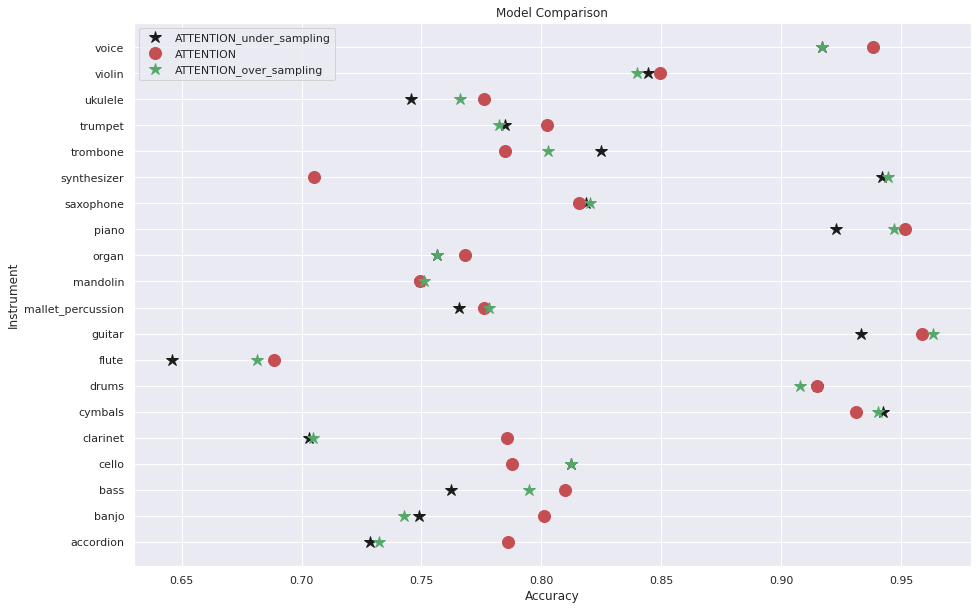

In [ ]:
accuracy_attention_under = get_accuracy(attention_results_under, "ATTENTION_under")
accuracy_attention = get_accuracy(attention_results, "ATTENTION")
accuracy_attention_over = get_accuracy(attention_results_over, "ATTENTION_over")

list1 = accuracy_attention_under
list2 = accuracy_attention
list3 = accuracy_attention_over

for instrument in class_map:
    inst_num = class_map[instrument]
    result = attention_results[instrument]
    Y_true = result["Y_true_test"].round()
    majority_class = max(len(Y_true[Y_true == 1]),len(Y_true[Y_true == 0]))
    minority_class = min(len(Y_true[Y_true == 1]),len(Y_true[Y_true == 0]))
    maximum = max(list1[inst_num], list2[inst_num], list3[inst_num])
    name = ""
    if maximum == list1[inst_num]:
      name = "ATTENTION_under"
    elif maximum == list2[inst_num]:
      name = "ATTENTION"
    elif maximum == list3[inst_num]:
      name = "ATTENTION_over"
    
    print(instrument, ": ", name, " -> ", maximum, "         ",np.round(majority_class/minority_class,2))


import matplotlib.pyplot as plt
import numpy as np




#################
plt.figure(figsize=(15,10))
sns.set(style="darkgrid")
plt.plot(list1, list(class_map.keys()),'k*', label="ATTENTION_under_sampling", markersize=12)
plt.plot(list2, list(class_map.keys()),'ro', label="ATTENTION", markersize=12)
plt.plot(list3, list(class_map.keys()),'g*', label="ATTENTION_over_sampling", markersize=12)


plt.xlabel("Accuracy")
plt.ylabel('Instrument')
plt.title("Model Comparison")
plt.legend()
plt.show()



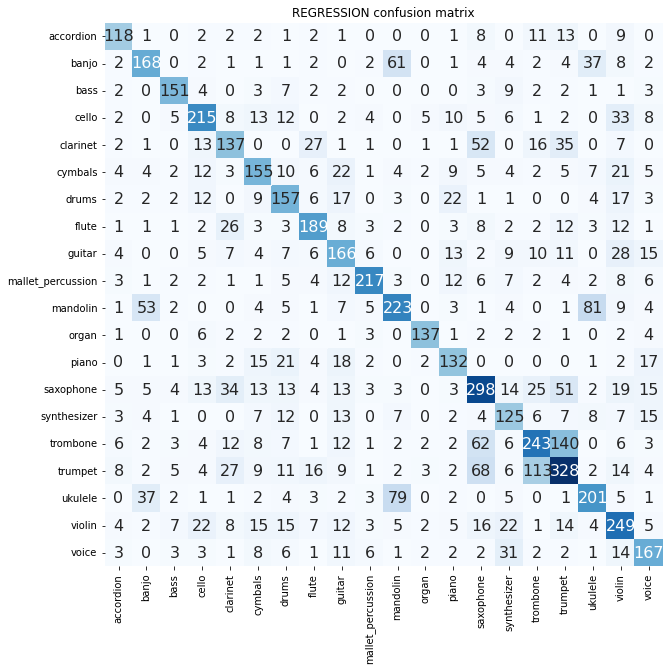

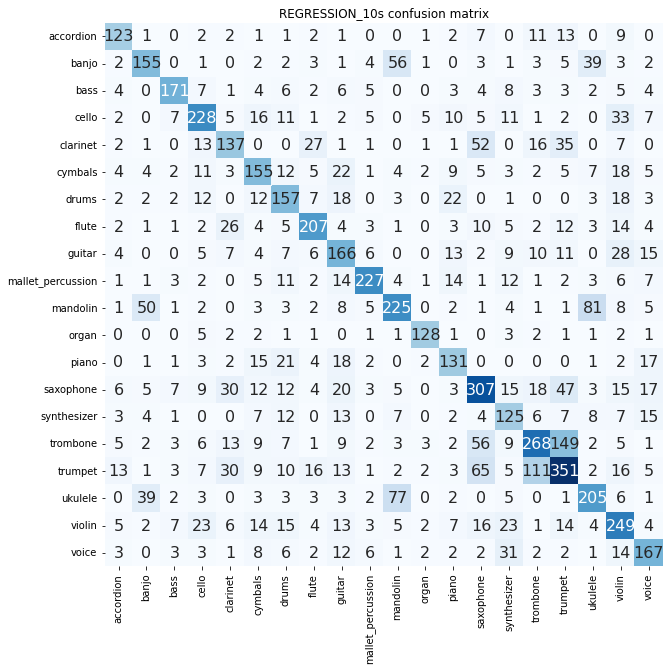

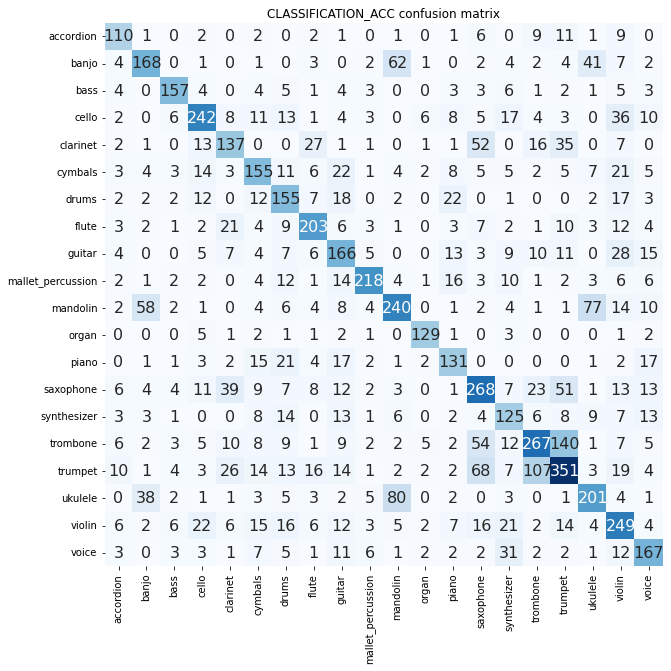

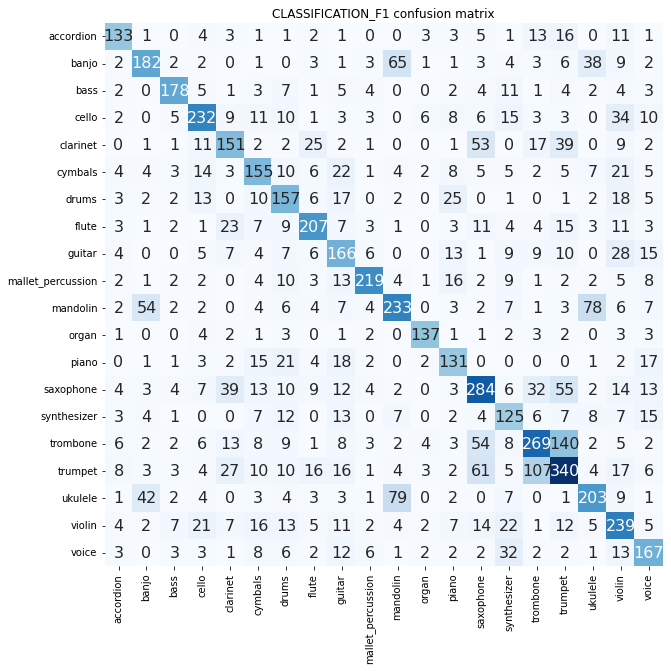

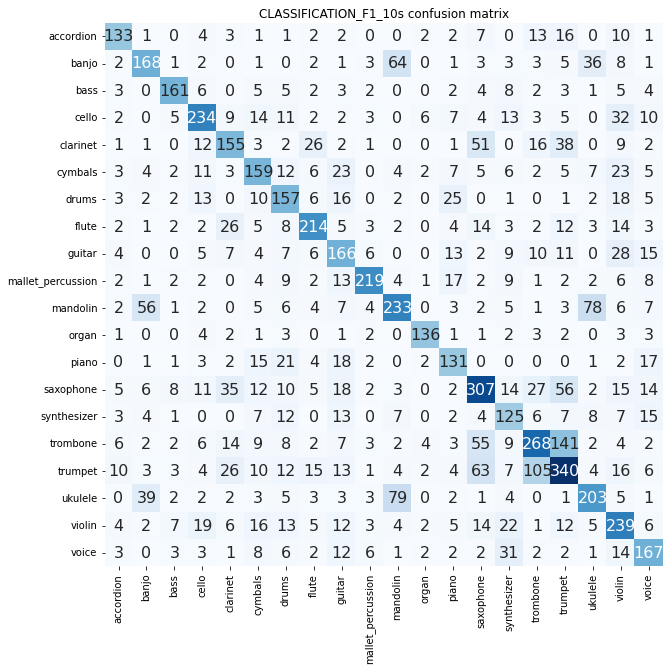

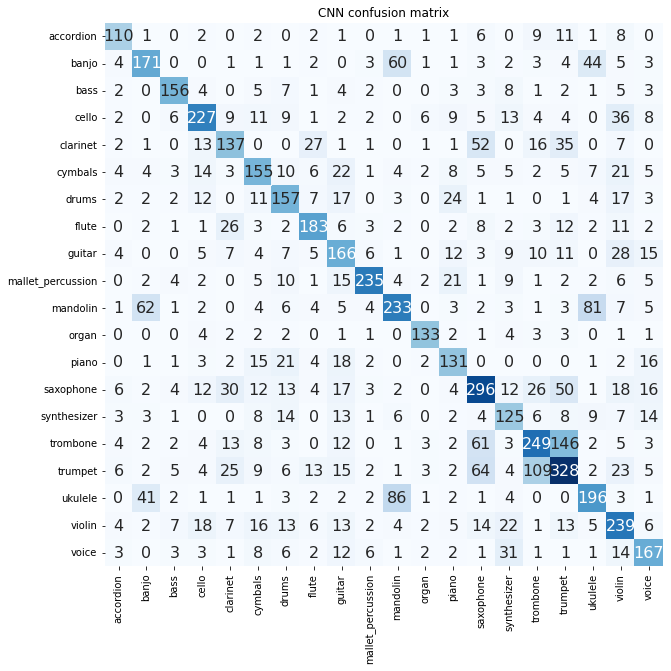

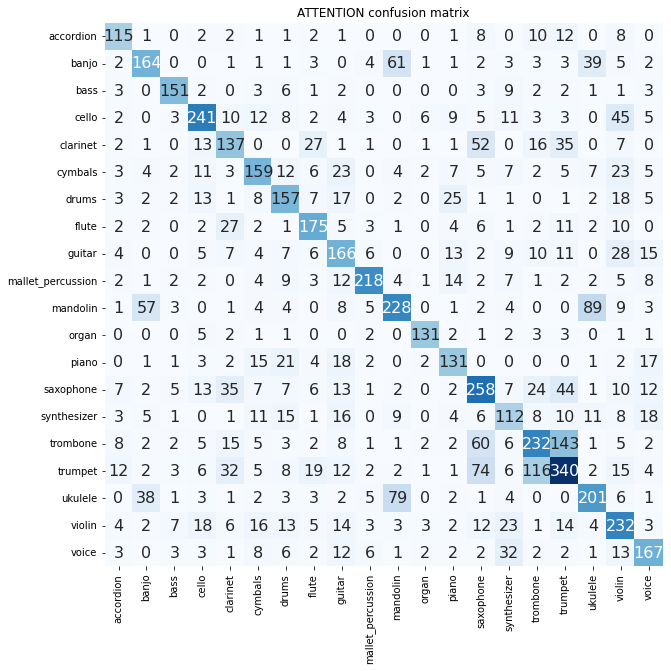

In [ ]:
def print_confussion_matrix(model_results, title):
  #20 x 20 confusion matrix
  conf_matrix = np.zeros((Y_true_test.shape[1],Y_true_test.shape[1]))

  for instrument in class_map:
      
      # Map the instrument name to its column number
      inst_num = class_map[instrument]

      keys = [k for k, v in class_map.items() if v == inst_num]
      result = model_results[keys[0]]
      Y_pred_test_inst = result["Y_pred_test"][0].round()
      
      count = 0
      
      for i in range(0,Y_true_test.shape[0]):

        if Y_true_test[i,inst_num] != 0.5:

          if Y_true_test[i,inst_num].round() == Y_pred_test_inst[count]:
            #print("ACIERTO")
            #conf_matrix[inst_num,inst_num] += 1
            continue
          else:
            #print("FALLO")
            conf_matrix[inst_num,inst_num] += 1
            for m in range(0,20):
              if (m != inst_num) and (Y_true_test[i,m] > 0.5):
                conf_matrix[inst_num,m] += 1

          
          count += 1  

  import seaborn as sn
  import pandas as pd
  import matplotlib.pyplot as plt

  #conf_matrix = track_errors_multilabel()

  df_cm = pd.DataFrame(conf_matrix, class_map.keys(), class_map.keys())
  plt.figure(figsize=(10,10))
  plt.title(title)
  #sn.set(font_scale=1.4) # for label size
  sn.heatmap(df_cm, annot=True, annot_kws={"size": 16}, fmt='g', cmap=plt.cm.Blues, cbar=False) # font size
  #cmap=plt.cm.Blues,

  plt.show()     
     

print_confussion_matrix(regression_results, "REGRESSION confusion matrix")
print_confussion_matrix(regression_results_10s, "REGRESSION_10s confusion matrix")
print_confussion_matrix(classification_accuracy_results, "CLASSIFICATION_ACC confusion matrix")
print_confussion_matrix(classification_f1_results, "CLASSIFICATION_F1 confusion matrix")
print_confussion_matrix(classification_f1_results_10s, "CLASSIFICATION_F1_10s confusion matrix")
print_confussion_matrix(CNN_results, "CNN confusion matrix")
#print_confussion_matrix(RF_results, "RF confusion matrix")
print_confussion_matrix(attention_results, "ATTENTION confusion matrix")




When analyzing the general confussion matrix, we have to consider at which family or sub-family of instruments belongs our target instrument.

1.   **Wind Family:**
*   Trumpet (Brass), Trombone (Brass)
*   Accordion, Organ
*   Clarinet (Woodwind), Flute (Woodwind), Saxophone (Woodwind)


2.   **Percusion  Family:**
*   Drums, Cymbals, Mallet percussion

3.   **String Family**
*   Guitar, Bass, Piano
*   Violin (Violin), Cello (Violin)

*   Mandolin (Lute), Banjo (Lute), Ukulele (Lute)


4. **Others:**
*   Synthesizer
*   Voice

In [ ]:
def get_marginal_accuracy(results, name, inst_1, inst_2):
  
  acierto_0 = 0
  acierto_05 = 0
  acierto_1 = 0

  total_0 = 0
  total_05 = 0
  total_1 = 0

  inst_num_1 = class_map[inst_1]
  inst_num_2 = class_map[inst_2]
  result = results[inst_1]
  
  Y_true = result["Y_true_test"].round()
  if name == "RANDOM FOREST":
    Y_pred = result["Y_pred_test"].round()
  else:
    Y_pred = result["Y_pred_test"][0].round()

  # Counts the number of labeled samples of the target instrument, so we can map Y_true and Y_true_inst indexes
  count_pred = 0
      
  for i in range(0,Y_true_test.shape[0]):

    if Y_true_test[i,inst_num_1] != 0.5:

      if Y_true_test[i,inst_num_1].round() == Y_pred[count_pred]:
        #print("ACIERTO")
        if Y_true_test[i,inst_num_2] == 0:
          acierto_0 += 1
        elif Y_true_test[i,inst_num_2] == 0.5:
          acierto_05 += 1
        elif Y_true_test[i,inst_num_2] == 1:
          acierto_1 += 1
        
      # Increase counters
      if Y_true_test[i,inst_num_2] == 0:
        total_0 += 1
      elif Y_true_test[i,inst_num_2] == 0.5:
        total_05 += 1
      elif Y_true_test[i,inst_num_2] == 1:
        total_1 += 1
      
      count_pred += 1  

  print(inst_1, " Accuracy when ", inst_2, " is 0:   ", round(acierto_0/total_0,4))
  print(inst_1, " Accuracy when ", inst_2, " is 0.5: ", round(acierto_05/total_05,4))
  print(inst_1, " Accuracy when ", inst_2, " is 1:   ", round(acierto_1/total_1,4))
  #print(inst_2, " class distribution: 0:",total_0, "   0.5:",total_05, "     1:",total_1)
  print("  0:",total_0)
  print("0.5:",total_05)
  print("  1:",total_1)

  import seaborn as sn
  import pandas as pd
  import matplotlib.pyplot as plt

  list1 = [round(acierto_0/total_0,4), round(acierto_05/total_05,4), round(acierto_1/total_1,4)]
  plt.figure()
  sn.set(style="darkgrid")
  #plt.plot(list1, list(class_map.keys()),'k*', label="REGRESSION", markersize=12)
  plt.plot(list(["0", "0.5", "1"]), list1, 'r*', markersize=12)



  plt.xlabel("filtered by " + inst_2 + " labels")
  plt.ylabel('Accuracy')
  plt.title(inst_1 + " Accuracy")
  plt.show()



trombone  Accuracy when  trumpet  is 0:    0.9253
trombone  Accuracy when  trumpet  is 0.5:  0.9403
trombone  Accuracy when  trumpet  is 1:    0.6776
  0: 174
0.5: 201
  1: 152


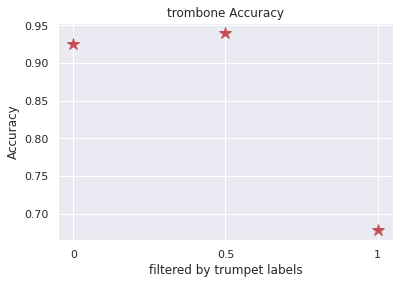

trumpet  Accuracy when  trombone  is 0:    0.8462
trumpet  Accuracy when  trombone  is 0.5:  0.8158
trumpet  Accuracy when  trombone  is 1:    0.8018
  0: 182
0.5: 266
  1: 111


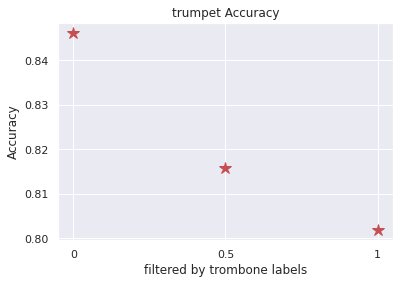

In [ ]:
get_marginal_accuracy(regression_results, "REGRESSION", "trombone", "trumpet")
get_marginal_accuracy(regression_results, "REGRESSION", "trumpet", "trombone")

trombone  Accuracy when  trumpet  is 0:    0.9253
trombone  Accuracy when  trumpet  is 0.5:  0.9403
trombone  Accuracy when  trumpet  is 1:    0.6776
  0: 174
0.5: 201
  1: 152


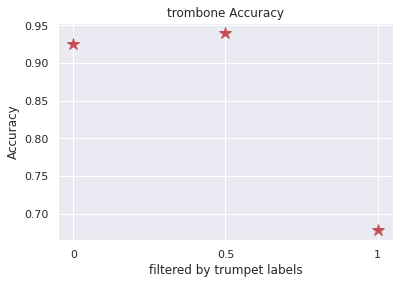

trombone  Accuracy when  saxophone  is 0:    0.8421
trombone  Accuracy when  saxophone  is 0.5:  0.8202
trombone  Accuracy when  saxophone  is 1:    0.75
  0: 19
0.5: 595
  1: 68


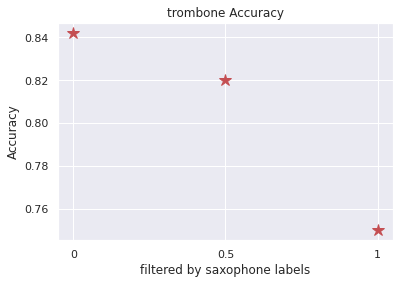

trombone  Accuracy when  synthesizer  is 0:    0.9
trombone  Accuracy when  synthesizer  is 0.5:  0.8009
trombone  Accuracy when  synthesizer  is 1:    1.0
  0: 10
0.5: 673
  1: 24


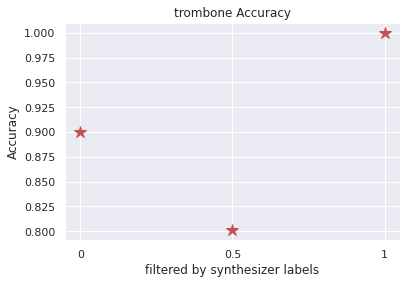

In [ ]:
get_marginal_accuracy(regression_results, "REGRESSION", "trombone", "trumpet")
get_marginal_accuracy(regression_results, "REGRESSION", "trombone", "saxophone")
get_marginal_accuracy(regression_results, "REGRESSION", "trombone", "synthesizer")

## **Random Forest**

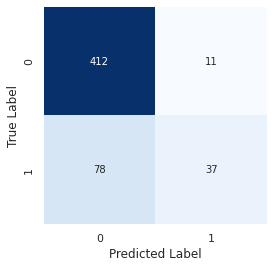


Ejemplo de predicciones:  accordion
True label:  [0 0 0 0 0 0 0 0 0 0]
Predicted:   [0. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
----------------------------------------------------
accordion
	TRAIN
              precision    recall  f1-score   support

       False       0.96      1.00      0.98      1159
        True       1.00      0.88      0.94       374

    accuracy                           0.97      1533
   macro avg       0.98      0.94      0.96      1533
weighted avg       0.97      0.97      0.97      1533

	TEST
              precision    recall  f1-score   support

         0.0       0.84      0.97      0.90       423
         1.0       0.77      0.32      0.45       115

    accuracy                           0.83       538
   macro avg       0.81      0.65      0.68       538
weighted avg       0.83      0.83      0.81       538



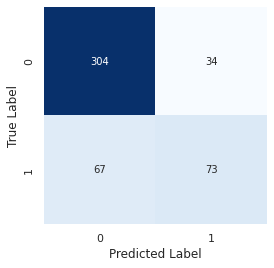


Ejemplo de predicciones:  banjo
True label:  [0 0 1 0 1 0 1 0 0 1]
Predicted:   [0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
----------------------------------------------------
banjo
	TRAIN
              precision    recall  f1-score   support

       False       0.98      0.98      0.98      1148
        True       0.97      0.97      0.97       592

    accuracy                           0.98      1740
   macro avg       0.98      0.97      0.98      1740
weighted avg       0.98      0.98      0.98      1740

	TEST
              precision    recall  f1-score   support

         0.0       0.82      0.90      0.86       338
         1.0       0.68      0.52      0.59       140

    accuracy                           0.79       478
   macro avg       0.75      0.71      0.72       478
weighted avg       0.78      0.79      0.78       478



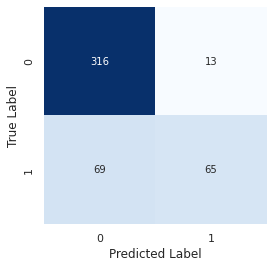


Ejemplo de predicciones:  bass
True label:  [1 1 0 1 1 0 1 0 0 0]
Predicted:   [1. 0. 0. 1. 0. 1. 1. 0. 0. 0.]
----------------------------------------------------
bass
	TRAIN
              precision    recall  f1-score   support

       False       0.97      0.99      0.98      1010
        True       0.96      0.93      0.95       415

    accuracy                           0.97      1425
   macro avg       0.97      0.96      0.96      1425
weighted avg       0.97      0.97      0.97      1425

	TEST
              precision    recall  f1-score   support

         0.0       0.82      0.96      0.89       329
         1.0       0.83      0.49      0.61       134

    accuracy                           0.82       463
   macro avg       0.83      0.72      0.75       463
weighted avg       0.82      0.82      0.81       463



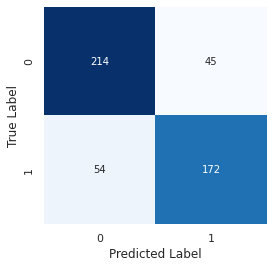


Ejemplo de predicciones:  cello
True label:  [0 0 0 1 0 0 0 0 0 0]
Predicted:   [0. 0. 1. 0. 0. 0. 0. 0. 0. 0.]
----------------------------------------------------
cello
	TRAIN
              precision    recall  f1-score   support

       False       0.99      0.96      0.97       866
        True       0.95      0.98      0.96       598

    accuracy                           0.97      1464
   macro avg       0.97      0.97      0.97      1464
weighted avg       0.97      0.97      0.97      1464

	TEST
              precision    recall  f1-score   support

         0.0       0.80      0.83      0.81       259
         1.0       0.79      0.76      0.78       226

    accuracy                           0.80       485
   macro avg       0.80      0.79      0.79       485
weighted avg       0.80      0.80      0.80       485



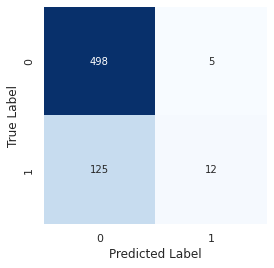


Ejemplo de predicciones:  clarinet
True label:  [1 0 0 0 1 0 0 0 0 0]
Predicted:   [1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
----------------------------------------------------
clarinet
	TRAIN
              precision    recall  f1-score   support

       False       0.92      1.00      0.96      1349
        True       1.00      0.70      0.82       396

    accuracy                           0.93      1745
   macro avg       0.96      0.85      0.89      1745
weighted avg       0.94      0.93      0.93      1745

	TEST
              precision    recall  f1-score   support

         0.0       0.80      0.99      0.88       503
         1.0       0.71      0.09      0.16       137

    accuracy                           0.80       640
   macro avg       0.75      0.54      0.52       640
weighted avg       0.78      0.80      0.73       640



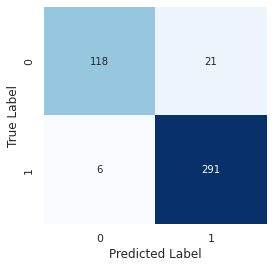


Ejemplo de predicciones:  cymbals
True label:  [1 1 1 1 1 0 1 0 0 0]
Predicted:   [1. 1. 1. 1. 1. 1. 1. 0. 0. 0.]
----------------------------------------------------
cymbals
	TRAIN
              precision    recall  f1-score   support

       False       1.00      0.90      0.95       485
        True       0.94      1.00      0.97       814

    accuracy                           0.96      1299
   macro avg       0.97      0.95      0.96      1299
weighted avg       0.97      0.96      0.96      1299

	TEST
              precision    recall  f1-score   support

         0.0       0.95      0.85      0.90       139
         1.0       0.93      0.98      0.96       297

    accuracy                           0.94       436
   macro avg       0.94      0.91      0.93       436
weighted avg       0.94      0.94      0.94       436



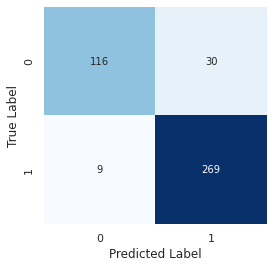


Ejemplo de predicciones:  drums
True label:  [1 0 0 1 1 1 1 1 1 1]
Predicted:   [1. 0. 0. 1. 1. 1. 1. 1. 1. 1.]
----------------------------------------------------
drums
	TRAIN
              precision    recall  f1-score   support

       False       1.00      0.95      0.98       495
        True       0.97      1.00      0.99       828

    accuracy                           0.98      1323
   macro avg       0.99      0.98      0.98      1323
weighted avg       0.98      0.98      0.98      1323

	TEST
              precision    recall  f1-score   support

         0.0       0.93      0.79      0.86       146
         1.0       0.90      0.97      0.93       278

    accuracy                           0.91       424
   macro avg       0.91      0.88      0.89       424
weighted avg       0.91      0.91      0.91       424



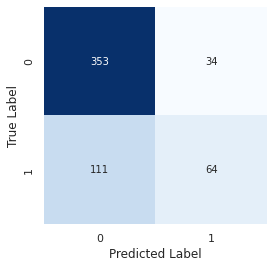


Ejemplo de predicciones:  flute
True label:  [0 0 1 0 0 0 1 0 0 0]
Predicted:   [0. 0. 1. 0. 1. 0. 0. 0. 0. 0.]
----------------------------------------------------
flute
	TRAIN
              precision    recall  f1-score   support

       False       0.97      0.99      0.98      1050
        True       0.98      0.94      0.96       472

    accuracy                           0.98      1522
   macro avg       0.98      0.97      0.97      1522
weighted avg       0.98      0.98      0.98      1522

	TEST
              precision    recall  f1-score   support

         0.0       0.76      0.91      0.83       387
         1.0       0.65      0.37      0.47       175

    accuracy                           0.74       562
   macro avg       0.71      0.64      0.65       562
weighted avg       0.73      0.74      0.72       562



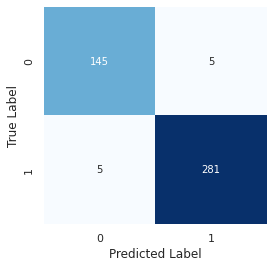


Ejemplo de predicciones:  guitar
True label:  [0 0 0 1 1 1 1 1 1 1]
Predicted:   [0. 0. 0. 1. 1. 1. 1. 1. 1. 1.]
----------------------------------------------------
guitar
	TRAIN
              precision    recall  f1-score   support

       False       1.00      0.95      0.98       362
        True       0.98      1.00      0.99       852

    accuracy                           0.99      1214
   macro avg       0.99      0.98      0.98      1214
weighted avg       0.99      0.99      0.99      1214

	TEST
              precision    recall  f1-score   support

         0.0       0.97      0.97      0.97       150
         1.0       0.98      0.98      0.98       286

    accuracy                           0.98       436
   macro avg       0.97      0.97      0.97       436
weighted avg       0.98      0.98      0.98       436



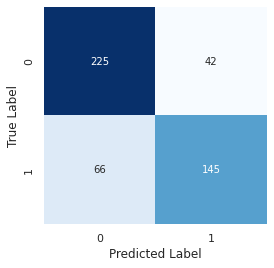


Ejemplo de predicciones:  mallet_percussion
True label:  [0 1 0 0 1 1 0 0 0 0]
Predicted:   [1. 1. 0. 0. 1. 1. 0. 0. 0. 0.]
----------------------------------------------------
mallet_percussion
	TRAIN
              precision    recall  f1-score   support

       False       1.00      0.95      0.97       802
        True       0.93      1.00      0.96       522

    accuracy                           0.97      1324
   macro avg       0.96      0.97      0.97      1324
weighted avg       0.97      0.97      0.97      1324

	TEST
              precision    recall  f1-score   support

         0.0       0.77      0.84      0.81       267
         1.0       0.78      0.69      0.73       211

    accuracy                           0.77       478
   macro avg       0.77      0.76      0.77       478
weighted avg       0.77      0.77      0.77       478



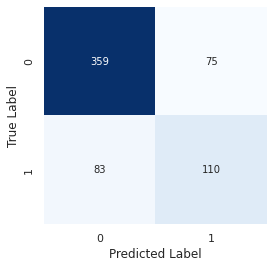


Ejemplo de predicciones:  mandolin
True label:  [0 0 0 0 0 1 0 0 0 0]
Predicted:   [0. 1. 0. 0. 0. 1. 1. 0. 0. 0.]
----------------------------------------------------
mandolin
	TRAIN
              precision    recall  f1-score   support

       False       0.97      0.96      0.97      1185
        True       0.93      0.95      0.94       652

    accuracy                           0.96      1837
   macro avg       0.95      0.96      0.95      1837
weighted avg       0.96      0.96      0.96      1837

	TEST
              precision    recall  f1-score   support

         0.0       0.81      0.83      0.82       434
         1.0       0.59      0.57      0.58       193

    accuracy                           0.75       627
   macro avg       0.70      0.70      0.70       627
weighted avg       0.75      0.75      0.75       627



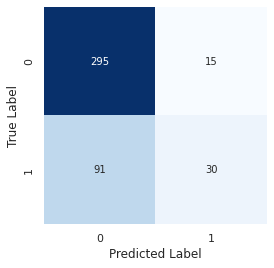


Ejemplo de predicciones:  organ
True label:  [0 0 0 1 0 1 0 0 0 0]
Predicted:   [0. 1. 0. 0. 0. 0. 0. 0. 0. 0.]
----------------------------------------------------
organ
	TRAIN
              precision    recall  f1-score   support

       False       0.97      1.00      0.98       977
        True       1.00      0.93      0.96       482

    accuracy                           0.98      1459
   macro avg       0.98      0.96      0.97      1459
weighted avg       0.98      0.98      0.98      1459

	TEST
              precision    recall  f1-score   support

         0.0       0.76      0.95      0.85       310
         1.0       0.67      0.25      0.36       121

    accuracy                           0.75       431
   macro avg       0.72      0.60      0.60       431
weighted avg       0.74      0.75      0.71       431



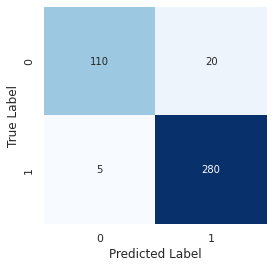


Ejemplo de predicciones:  piano
True label:  [0 0 0 0 0 0 0 1 0 0]
Predicted:   [0. 0. 0. 0. 0. 0. 0. 0. 1. 0.]
----------------------------------------------------
piano
	TRAIN
              precision    recall  f1-score   support

       False       1.00      0.96      0.98       420
        True       0.98      1.00      0.99       885

    accuracy                           0.99      1305
   macro avg       0.99      0.98      0.99      1305
weighted avg       0.99      0.99      0.99      1305

	TEST
              precision    recall  f1-score   support

         0.0       0.96      0.85      0.90       130
         1.0       0.93      0.98      0.96       285

    accuracy                           0.94       415
   macro avg       0.94      0.91      0.93       415
weighted avg       0.94      0.94      0.94       415



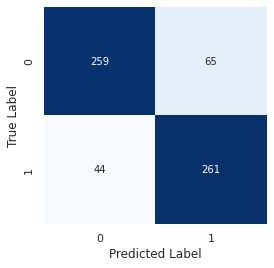


Ejemplo de predicciones:  saxophone
True label:  [0 1 0 0 0 0 0 0 0 1]
Predicted:   [0. 1. 0. 0. 1. 0. 0. 0. 0. 1.]
----------------------------------------------------
saxophone
	TRAIN
              precision    recall  f1-score   support

       False       0.99      0.94      0.97       906
        True       0.94      0.99      0.96       830

    accuracy                           0.96      1736
   macro avg       0.97      0.97      0.96      1736
weighted avg       0.97      0.96      0.96      1736

	TEST
              precision    recall  f1-score   support

         0.0       0.85      0.80      0.83       324
         1.0       0.80      0.86      0.83       305

    accuracy                           0.83       629
   macro avg       0.83      0.83      0.83       629
weighted avg       0.83      0.83      0.83       629



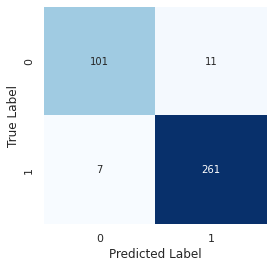


Ejemplo de predicciones:  synthesizer
True label:  [1 1 1 1 1 0 1 1 1 1]
Predicted:   [1. 1. 1. 1. 1. 0. 1. 1. 1. 1.]
----------------------------------------------------
synthesizer
	TRAIN
              precision    recall  f1-score   support

       False       0.99      0.95      0.97       399
        True       0.98      1.00      0.99       823

    accuracy                           0.98      1222
   macro avg       0.99      0.98      0.98      1222
weighted avg       0.98      0.98      0.98      1222

	TEST
              precision    recall  f1-score   support

         0.0       0.94      0.90      0.92       112
         1.0       0.96      0.97      0.97       268

    accuracy                           0.95       380
   macro avg       0.95      0.94      0.94       380
weighted avg       0.95      0.95      0.95       380



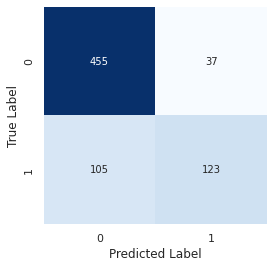


Ejemplo de predicciones:  trombone
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [0. 0. 0. 0. 1. 0. 0. 0. 0. 0.]
----------------------------------------------------
trombone
	TRAIN
              precision    recall  f1-score   support

       False       0.95      0.98      0.97      1405
        True       0.95      0.89      0.92       635

    accuracy                           0.95      2040
   macro avg       0.95      0.94      0.94      2040
weighted avg       0.95      0.95      0.95      2040

	TEST
              precision    recall  f1-score   support

         0.0       0.81      0.92      0.87       492
         1.0       0.77      0.54      0.63       228

    accuracy                           0.80       720
   macro avg       0.79      0.73      0.75       720
weighted avg       0.80      0.80      0.79       720



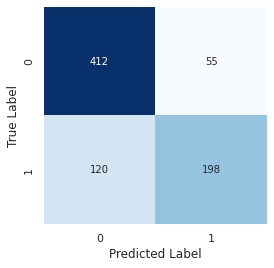


Ejemplo de predicciones:  trumpet
True label:  [0 0 0 0 1 0 0 0 0 0]
Predicted:   [0. 0. 0. 1. 1. 1. 0. 0. 0. 0.]
----------------------------------------------------
trumpet
	TRAIN
              precision    recall  f1-score   support

       False       0.97      0.97      0.97      1303
        True       0.96      0.95      0.95       828

    accuracy                           0.96      2131
   macro avg       0.96      0.96      0.96      2131
weighted avg       0.96      0.96      0.96      2131

	TEST
              precision    recall  f1-score   support

         0.0       0.77      0.88      0.82       467
         1.0       0.78      0.62      0.69       318

    accuracy                           0.78       785
   macro avg       0.78      0.75      0.76       785
weighted avg       0.78      0.78      0.77       785



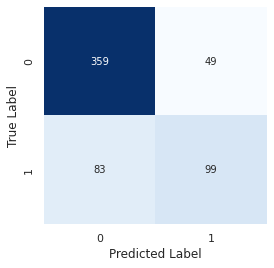


Ejemplo de predicciones:  ukulele
True label:  [1 0 0 0 0 1 0 0 0 0]
Predicted:   [1. 0. 0. 0. 0. 0. 0. 0. 0. 0.]
----------------------------------------------------
ukulele
	TRAIN
              precision    recall  f1-score   support

       False       0.97      0.98      0.98      1279
        True       0.96      0.93      0.94       556

    accuracy                           0.97      1835
   macro avg       0.96      0.95      0.96      1835
weighted avg       0.97      0.97      0.96      1835

	TEST
              precision    recall  f1-score   support

         0.0       0.81      0.88      0.84       408
         1.0       0.67      0.54      0.60       182

    accuracy                           0.78       590
   macro avg       0.74      0.71      0.72       590
weighted avg       0.77      0.78      0.77       590



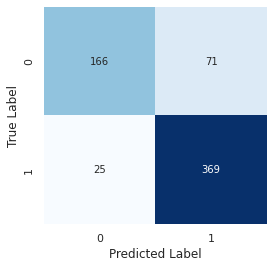


Ejemplo de predicciones:  violin
True label:  [0 0 1 0 0 0 0 0 0 1]
Predicted:   [1. 1. 1. 1. 1. 0. 0. 0. 0. 1.]
----------------------------------------------------
violin
	TRAIN
              precision    recall  f1-score   support

       False       1.00      0.88      0.94       623
        True       0.91      1.00      0.95       779

    accuracy                           0.95      1402
   macro avg       0.96      0.94      0.94      1402
weighted avg       0.95      0.95      0.95      1402

	TEST
              precision    recall  f1-score   support

         0.0       0.87      0.70      0.78       237
         1.0       0.84      0.94      0.88       394

    accuracy                           0.85       631
   macro avg       0.85      0.82      0.83       631
weighted avg       0.85      0.85      0.84       631



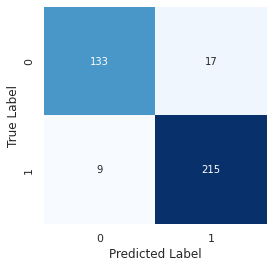


Ejemplo de predicciones:  voice
True label:  [1 0 1 1 1 1 1 0 1 1]
Predicted:   [1. 0. 1. 1. 1. 1. 1. 0. 1. 1.]
----------------------------------------------------
voice
	TRAIN
              precision    recall  f1-score   support

       False       1.00      0.91      0.95       426
        True       0.95      1.00      0.98       764

    accuracy                           0.97      1190
   macro avg       0.97      0.95      0.96      1190
weighted avg       0.97      0.97      0.97      1190

	TEST
              precision    recall  f1-score   support

         0.0       0.94      0.89      0.91       150
         1.0       0.93      0.96      0.94       224

    accuracy                           0.93       374
   macro avg       0.93      0.92      0.93       374
weighted avg       0.93      0.93      0.93       374



In [ ]:
import keras
from keras.utils import to_categorical
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
from sklearn import preprocessing
from keras.optimizers import gradient_descent_v2
from sklearn.metrics import confusion_matrix
import seaborn as sns
#from sklearn.metrics import confusion_matrix
from keras.models import Sequential
from keras.layers import MaxPooling2D, Dropout, Dense, Flatten
from keras.layers import Convolution2D as Conv2D


# This dictionary will include the classifiers for each model
models = dict()
#histories = dict()
RF_results = dict()

# We'll iterate over all istrument classes, and fit a model for each one
# After training, we'll print a classification report for each instrument
for instrument in class_map:
    
    # Map the instrument name to its column number
    inst_num = class_map[instrument]
        
    # Step 1: sub-sample the data
    
    # First, we need to select down to the data for which we have annotations
    # This is what the mask arrays are for
    train_inst = Y_mask_train[:, inst_num]
    test_inst = Y_mask_test[:, inst_num]
    
    # Here, we're using the Y_mask_train array to slice out only the training examples
    # for which we have annotations for the given class
    X_train_inst = X_train[train_inst]
    
    # Step 3: simplify the data by averaging over time  XXXXXXX
    
    # Let's arrange the data for a sklearn Random Forest model 
    # Instead of having time-varying features, we'll summarize each track by its mean feature vector over time
    X_train_inst_sklearn = np.mean(X_train_inst, axis=1)
    
    # Again, we slice the labels to the annotated examples
    # We thresold the label likelihoods at 0.5 to get binary labels
    Y_true_train_inst = Y_true_train[train_inst, inst_num] >= 0.5

    
    # Repeat the above slicing and dicing but for the test set
    X_test_inst = X_test[test_inst]
    X_test_inst_sklearn = np.mean(X_test_inst, axis=1)
    Y_true_test_inst = Y_true_test[test_inst, inst_num] >= 0.5

    # Step 3.
    # Initialize a new classifier
    model = RandomForestClassifier(max_depth=8, n_estimators=100, random_state=0)
    
    # Step 4.
    model.fit(X_train_inst_sklearn, Y_true_train_inst)

    # Step 5.
    # Finally, we'll evaluate the model on both train and test
    Y_pred_train = model.predict(X_train_inst_sklearn)
    Y_pred_test = model.predict(X_test_inst_sklearn)

    Y_true_test_inst = np.round(Y_true_test_inst)
    Y_pred_test = np.round(Y_pred_test)
    #####################
    
    #Y_pred_test_norm = preprocessing.normalize(Y_pred_test)

    #print2(instrument,Y_true_train_inst,Y_pred_train,Y_true_test_inst,Y_pred_test)

    #print('Train Accuracy: ',np.round(history.history['accuracy'][-1],2))
    #print('Test_Accuracy: ',np.round(history.history['val_accuracy'][-1],2))

    # Plot the accuracy curves
    #plt.plot(history.history['mse'],'bo')
    #plt.plot(history.history['val_mse'],'rX')
    #plt.grid()

    cm = confusion_matrix(Y_true_test_inst, Y_pred_test.round())
    plt.figure(figsize=(4,4))
    sns.heatmap(cm, annot=True,  fmt='d', cmap=plt.cm.Blues, cbar=False)
    plt.xlabel('Predicted Label')
    plt.ylabel('True Label')
    plt.show()
    
    print()
    print("Ejemplo de predicciones: ", instrument)
    print("True label: ", np.array(Y_true_test_inst[0:10]).astype(int))
    print("Predicted:  ", Y_pred_test[0:10].T)



    # Store the classifier in our dictionary
    models[instrument] = model
    #histories[instrument] = history
    results = dict()
    results["Y_true_train"] = Y_true_train_inst
    results["Y_pred_train"] = (Y_pred_train).T
    results["Y_true_test"] = Y_true_test_inst
    results["Y_pred_test"] = (Y_pred_test).T
    RF_results[instrument] = results
    #####################

    print('-' * 52)
    print(instrument)
    print('\tTRAIN')
    print(classification_report(Y_true_train_inst, Y_pred_train))
    print('\tTEST')
    print(classification_report(Y_true_test_inst, Y_pred_test))
    
    # Store the classifier in our dictionary
    models[instrument] = model

# Save training/testing results
#np.save('/content/gdrive/MyDrive/MASTER/TFM/RF_results.npy', RF_results)
